# Candidate peaks vs sensitivity

In [2]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

from io import StringIO

import pandas as pd
import seaborn as sns
from IPython.display import display
from tqdm.auto import tqdm

sns.set_style("whitegrid")
import matplotlib.pyplot as plt
import numpy as np
import os
import re
import math
from itertools import product
import glob

# Plots

In [3]:
def plot_sensitivity(t, name, x='CandidatesN', y='CandidatesAL', logx=True, logy=True):
    plt.figure(figsize=(5, 4))
    ax = plt.axes()
    sns.lineplot(data=t[t['Gap'] > 0], x=x, y=y, hue='Gap', estimator=None,
                 palette='tab20',
                 hue_order=list(sorted(t['Gap'].unique())),
                 sort=False,
                 alpha=0.5,
                 ax=ax)
    sns.lineplot(data=t[t['Gap'] == 0], x=x, y=y, hue='Gap', estimator=None,
                 palette='tab20',
                 hue_order=list(sorted(t['Gap'].unique())),
                 sort=False,
                 legend=False,
                 ax=ax)

    sp = detect_sensitivity_triangle(t[t['Gap'] == 0])
    sns.scatterplot(data=t[t.index == sp[0]],
                    x=x, y=y, color='green', s=20,
                    legend=False, ax=ax)
    sns.scatterplot(data=t[t.index == sp[1]],
                    x=x, y=y, color='red', s=40,
                    legend=False, ax=ax)
    sns.scatterplot(data=t[t.index == sp[2]],
                    x=x, y=y, color='blue', s=20,
                    legend=False, ax=ax)

    if logx:
        ax.set(xscale='log')
    if logy:
        ax.set(yscale='log')
    ax.set_title(name)
    if len(t['Gap'].unique()) > 1:
        sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()
    return sp

In [4]:
def plot_projections(t, name, sp):
    for y in ['CandidatesN', 'CandidatesAL', 'CandidatesML', 'SignalNoiseRatio', 'SignalControlRatio']:
        if y not in t.columns:
            continue
        print(y)
        plt.figure(figsize=(5, 2))
        ax = plt.axes()
        if sum(t['Gap'] > 0) > 0:
            sns.lineplot(data=t[t['Gap'] > 0], x='SensitivityN', y=y, estimator=None,
                         # marker='o', markersize=3,
                         hue='Gap',
                         hue_order=list(sorted(t['Gap'].unique())),
                         palette='tab20',
                         alpha=0.5,
                         sort=False,
                         ax=ax)
        sns.lineplot(data=t[t['Gap'] == 0], x='SensitivityN', y=y, estimator=None,
                     # marker='o', markersize=3,
                     hue='Gap',
                     hue_order=list(sorted(t['Gap'].unique())),
                     palette='tab20',
                     alpha=1,
                     sort=False,
                     legend=False,
                     ax=ax)

        if sp is not None:
            tt = t[t['Gap'] == 0]
            sns.scatterplot(x=[tt['SensitivityN'].values[sp[0]]], y=[tt[y].values[sp[0]]],
                            color='green', s=20,
                            legend=False, ax=ax)
            sns.scatterplot(x=[tt['SensitivityN'].values[sp[1]]], y=[tt[y].values[sp[1]]],
                            color='red', s=40,
                            legend=False, ax=ax)
            sns.scatterplot(x=[tt['SensitivityN'].values[sp[2]]], y=[tt[y].values[sp[2]]],
                            color='blue', s=20,
                            legend=False, ax=ax)
            if y in ['CandidatesN', 'CandidatesAL', 'CandidatesML']:
                ax.text(tt['SensitivityN'].values[sp[0]], 10,
                        't1=%.2E' % tt['Sensitivity'].values[sp[0]], fontsize=5)
                ax.text(tt['SensitivityN'].values[sp[1]], 100,
                        't2=%.2E' % tt['Sensitivity'].values[sp[1]], fontsize=5)
                ax.text(tt['SensitivityN'].values[sp[2]], 10,
                        't3=%.2E' % tt['Sensitivity'].values[sp[2]], fontsize=5)

        # ax.set(xscale='log')
        ax.set(yscale='log')
        ax.set_title(name)
        if len(t['Gap'].unique()) > 1:
            sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
        plt.tight_layout()
        plt.show()


# Area based triangles

In [5]:
def triangle_signed_square(x1, y1, x2, y2, x3, y3):
    return 0.5 * (x1 * y2 - x2 * y1 + x2 * y3 - x3 * y2 + x3 * y1 - x1 * y3)


def detect_sensitivity_triangle(t):
    im1 = int(len(t) * 0.1)
    im2 = int(len(t) * 0.9)
    ns = np.log1p(t['CandidatesN'].values)
    als = np.log1p(t['CandidatesAL'].values)
    print('Limit', 'Im1', im1, 'Im2', im2)
    max_area = 0
    i1, i2, i3 = -1, -1, -1
    for i in range(im1, im2):
        i1mab = find_sensitivity_max_area_between(ns, als, 0, i, -1)
        i3mab = find_sensitivity_max_area_between(ns, als, i, len(t) - 1, -1)
        print('Checking', 'I', i,  'I1mab', i1mab, 'I3mab', i3mab)
        if i1mab[0] == -1 or i3mab[0] == -1:
            continue
        # we want area to be balanced between parts, geometric mean is better here
        area = math.sqrt(i1mab[1] * i3mab[1])
        if area > max_area:
            max_area = area
            i1, i3, i2 = i1mab[0], i3mab[0], i
    print('Found', 'I1', i1, 'I2', i2, 'I3', i3, max_area)
    if i3 == -1 or i2 == -1 or i1 == -1:
        print("Failed to estimate sensitivity triangle")
        return im1, (im1 + im2) / 2, im2

    # Update i3, i1 points to be closer to i2 for more accurate pivot_gap estimation
    i3mab = find_sensitivity_max_area_between(ns, als, i3, i2, -1)
    if i3mab[0] != -1:
        i3 = i3mab[0]
    i1mab = find_sensitivity_max_area_between(ns, als, i2, i1, -1)
    if i1mab[0] != -1:
        i1 = i1mab[0]
    print('Result', 'I1', i1, 'I2', i2, 'I3', i3, max_area)
    return i1, i2, i3


def find_sensitivity_max_area_between(ns, als, start, end, sign):
    if start > end:
        return find_sensitivity_max_area_between(ns, als, end, start, sign)
    max_i = -1
    max_area = 0
    start_n, start_al = ns[start], als[start]
    end_n, end_al = ns[end], als[end]
    for i in range(start + 1, end):
        n, al = ns[i], als[i]
        area = triangle_signed_square(start_n, start_al, n, al, end_n, end_al)
        if area * sign > 0:
            continue
        area = math.fabs(area)
        if area > max_area:
            max_i, max_area = i, area
    return max_i, max_area

# Bad quality example

In [6]:
t = StringIO('''Sensitivity	Gap	CandidatesN	CandidatesAL
-232.75694274902347	0	0	0.0
-174.5759586629643	0	558	1.3763440860215055
-130.9381579906529	0	304	6.973684210526316
-98.20826045747162	0	438	6.203196347031963
-73.65967698103015	0	697	5.279770444763271
-55.247369087647	0	922	5.3806941431670285
-41.43748542221757	0	1055	6.086255924170616
-31.079583090960625	0	1087	6.86752529898804
-23.31078913852277	0	1121	7.7252453166815345
-17.483918258180086	0	1199	8.38281901584654
-13.113558526148402	0	1093	10.239707227813359
-9.83563379097035	0	842	14.420427553444181
-7.377074031978356	0	573	22.48167539267016
-5.533067052908281	0	463	28.75377969762419
-4.149996445646207	0	440	30.818181818181817
-3.1126444581624413	0	428	32.217289719626166
-2.334593691783448	0	425	32.70823529411765
-1.7510280338708142	0	427	32.95550351288056
-1.3133331021121837	0	430	32.93023255813954
-0.985046386316659	0	435	32.65977011494253
-0.7388197111875019	0	436	32.887614678899084
-0.5541409757161526	0	438	32.901826484018265
-0.41562537695981855	0	439	32.93621867881549
-0.31173376729584396	0	440	32.97954545454545
-0.2338113769262323	0	442	33.171945701357465
-0.1753668216772277	0	447	32.94407158836689
-0.1315313332886934	0	447	33.1834451901566
-0.0986531629600029	0	445	33.58426966292135
-0.07399336963042492	0	448	33.703125
-0.05549765040462448	0	448	33.904017857142854
-0.0416252052828186	0	449	34.02895322939867
-0.03122037964137691	0	450	34.266666666666666
-0.023416391542795068	0	452	34.44911504424779
-0.017563123805156296	0	459	34.145969498910674
-0.013172965494342288	0	462	34.103896103896105
-0.009880191123186603	0	466	33.97639484978541
-0.007410493610768342	0	468	34.07692307692308
-0.0055581329217776155	0	476	33.686974789915965
-0.004168796735922839	0	483	33.445134575569355
-0.0031267453423698974	0	501	32.43313373253493
-0.0023451698548376536	0	518	31.61003861003861
-0.0017589605311031532	0	554	29.839350180505416
-0.0013192827562559918	0	571	29.085814360770577
-9.89508837849151E-4	0	601	27.841930116472547
-7.421667080378249E-4	0	643	26.326594090202178
-5.566513420102179E-4	0	695	24.63597122302158
-4.17508240676817E-4	0	861	20.233449477351915
-3.1314598183408563E-4	0	1028	17.230544747081712
-2.348705878951491E-4	0	1143	15.720909886264216
-1.7616126745461687E-4	0	1258	14.51987281399046
-1.321271957860927E-4	0	1498	12.485313751668892
-9.910008095731906E-5	0	2250	8.73911111111111
-7.432857397236071E-5	0	3287	6.374201399452388
-5.57490655445997E-5	0	3828	5.73380355276907
-4.181377555086358E-5	0	4524	5.134394341290893
-3.13618140275245E-5	0	5680	4.479577464788733
-2.3522472346478055E-5	0	10367	3.0273946175364137
-1.76426881686506E-5	0	13952	2.595900229357798
-1.3232641587645328E-5	0	15610	2.7187700192184496
-9.924950308775668E-6	0	23583	2.4812788873340965
-7.444064586743928E-6	0	31379	2.521782083559068
-5.5833123439034106E-6	0	32872	3.407002920418593
-4.187682195167486E-6	0	40644	3.113842141521504
-3.1409101063227317E-6	0	44859	3.4875275864375044
-2.3557939299655344E-6	0	45015	4.712029323558814
-1.7669289640893004E-6	0	49243	4.614990963182584
-1.3252593634891333E-6	0	49175	4.880406710726995
-9.93991505154174E-7	0	54280	4.9810243183492995
-7.455288674342257E-7	0	54473	5.702017513263452
-5.591730807513807E-7	0	54461	7.103633792989479
-4.1939963413230915E-7	0	54435	7.35245705887756
-3.1456459397859E-7	0	43975	9.575190449118818
-2.3593459729556775E-7	0	43942	9.594169587183105
-1.7695931222574472E-7	0	43920	10.28098816029144
-1.3272575765638577E-7	0	36933	13.960496033357702
-9.954902358000228E-8	0	35473	14.5776506075043
-7.466529685509795E-8	0	30674	17.242061680902392
-5.600161964401068E-8	0	28697	20.178102240652333
-4.2003200078863704E-8	0	24157	24.65335099557064
-3.1503889138923194E-8	0	26633	24.317425750009388
-2.362903371681419E-8	0	17186	58.12463633189806
-1.7722612974171466E-8	0	1	1019909.0
-1.3292588025246626E-8	0	1	1019910.0
-9.969912262172487E-9	0	1	1019910.0
-7.477787645763823E-9	0	1	1019910.0
-5.608605833704039E-9	0	1	1019910.0
-4.206653209212101E-9	0	1	1019910.0
-3.1551390394085834E-9	0	1	1019910.0
-2.3664661342180846E-9	0	1	1019910.0
-1.774933495625198E-9	0	1	1019910.0
-1.3312630459143475E-9	0	1	1019910.0
-9.984944798131023E-10	0	1	1019910.0
-7.48906258065989E-10	0	1	1019910.0
-5.617062434590318E-10	0	1	1019910.0
-4.212995959676681E-10	0	1	1019910.0
-3.15989632711755E-10	0	1	1019910.0
-2.3700342686531634E-10	0	1	1019910.0
-1.7776097229475142E-10	0	1	1019910.0
-1.3332703112825696E-10	0	1	1019910.0
-9.99999999999996E-11	0	1	1019910.0''')
t = pd.read_csv(t, sep='\t')
t['SensitivityN'] = range(len(t))
# For log
t['CandidatesN'] += 1
t['CandidatesAL'] += 1
t.sample(3)

,Sensitivity,Gap,CandidatesN,CandidatesAL,SensitivityN
54,-0.000042,0,4525,6.134394,54
57,-0.000018,0,13953,3.595900,57
59,-0.000010,0,23584,3.481279,59


/tmp/ipykernel_3632833/204427683.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(data=t[t['Gap'] > 0], x=x, y=y, hue='Gap', estimator=None,


Limit Im1 10 Im2 90
Checking I 10 I1mab (1, 3.4529283425293973) I3mab (70, 21.33651624811816)
Checking I 11 I1mab (1, 4.348961372120266) I3mab (70, 21.405805195747668)
Checking I 12 I1mab (1, 5.574708473868617) I3mab (70, 21.673374894151955)
Checking I 13 I1mab (1, 6.272916045843198) I3mab (70, 21.78652357586772)
Checking I 14 I1mab (1, 6.469243211764906) I3mab (70, 21.762179840580075)
Checking I 15 I1mab (1, 6.5940714721842495) I3mab (70, 21.717121070787456)
Checking I 16 I1mab (1, 6.636040938019691) I3mab (70, 21.687877466320053)
Checking I 17 I1mab (1, 6.654817972167059) I3mab (70, 21.625968822742927)
Checking I 18 I1mab (1, 6.650955851186042) I3mab (70, 21.589097932556157)
Checking I 19 I1mab (1, 6.626043100485926) I3mab (70, 21.560468248888007)
Checking I 20 I1mab (1, 6.643904878075184) I3mab (70, 21.51508535386361)
Checking I 21 I1mab (1, 6.643859518961148) I3mab (70, 21.486665641318105)
Checking I 22 I1mab (1, 6.646040030135242) I3mab (70, 21.468670127364888)
Checking I 23 I1mab

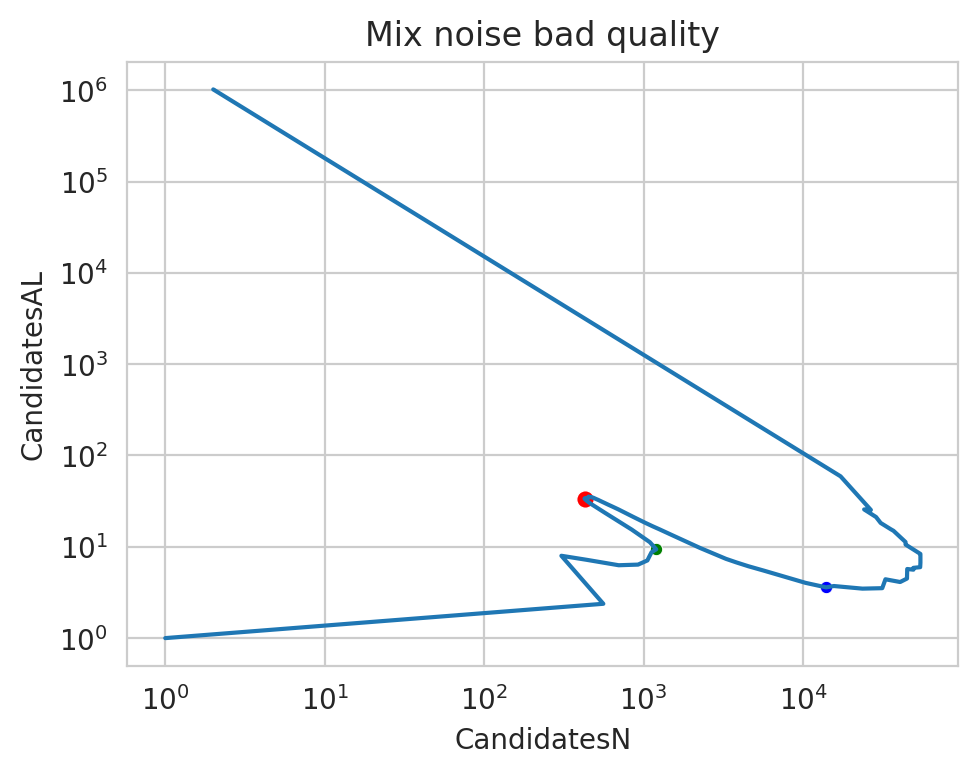

In [7]:
sp = plot_sensitivity(t, 'Mix noise bad quality')

CandidatesN


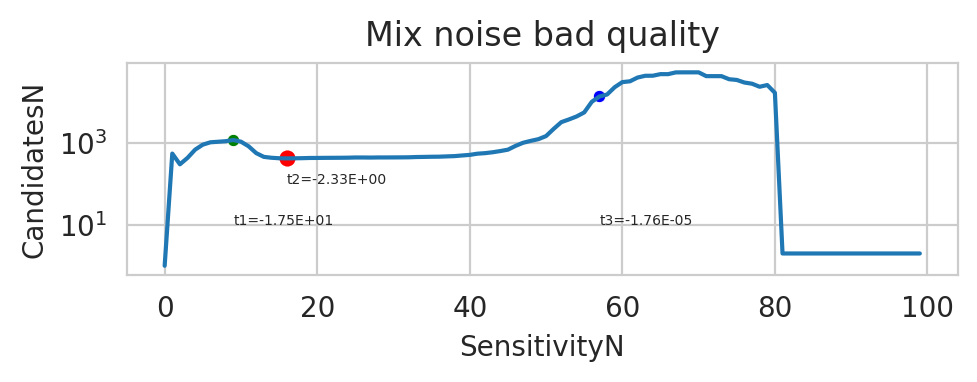

CandidatesAL


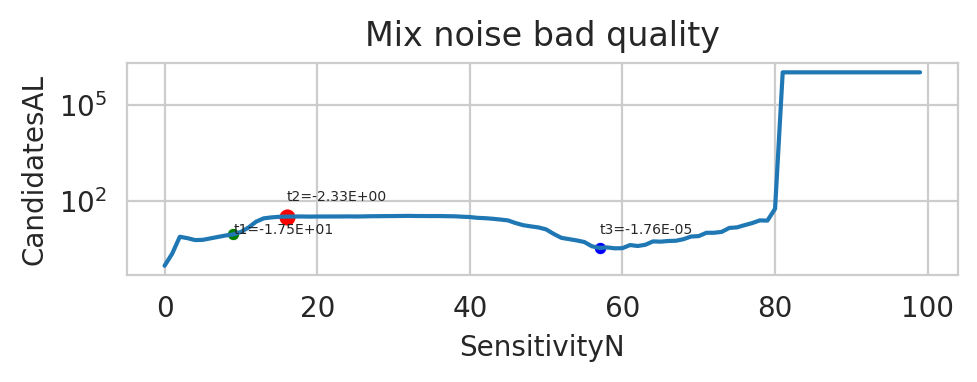

In [8]:
plot_projections(t, 'Mix noise bad quality', sp)

# Peak infos

In [9]:
GSE26320_PATH = os.path.expanduser('~/data/2023_GSE26320')
GSE26320_CELLS = ['GM12878', 'HMEC', 'HSMM', 'K562', 'NHEK', 'NHLF', 'H1', 'Huvec', 'HepG2']
MODIFICATIONS = ['H3K4me3', 'H3K27ac', 'H3K4me1', 'H3K27me3', 'H3K36me3']
GSE26320_REPS = ['rep1', 'rep2']

IMMUNE_PATH = os.path.expanduser('~/data/2023_Immune')
IMMUNE_CELLS = ['CD4ABT', 'TCellBB', 'BCell', 'TCell', 'Monocyte', 'PBMC', 'NK', 'CD34', 'CD4', ]  ## Longest first
IMMUNE_REPS = ['rep1', 'rep2', 'rep3', '']

IMMGEN_PATH = os.path.expanduser('~/data/2024_Immgen')
IMMGEN_CELLS = ['Blood_Monocyte']  ## Longest first
IMMGEN_REPS = ['']

CTCF_PATH = os.path.expanduser('~/data/2024_TFs')
CTCF_CELLS = ['H1']  ## Longest first
CTCF_REPS = ['']


In [10]:
def load_peaks_infos(path, suffix, modifications, cells, replicates):
    ts = []
    vals = {}
    for f in os.listdir(path):
        if not f.endswith(f'{suffix}.txt'):
            continue
        if 'ATAC_seq' in f:
            rep = re.sub('_.*', '', os.path.basename(f))
            cell = re.sub('(SRR[0-9]+_)|(_ATAC.*)', '', os.path.basename(f))
        else:
            cell = next((c for c in cells if c in f), None)
            rep = next((r for r in replicates if r in f), None)
        mod = next((m for m in modifications if m in f), None)
        if cell and mod and rep is not None:
            txt_path = os.path.join(path, f)
            print(txt_path, mod, cell, rep)
            with open(txt_path, 'r') as file:
                txt = file.read().rstrip()
                vals = {}
                for (c, text) in [
                    ('peaks', 'Count'),
                    ('length_mean', 'Mean length'),
                    ('length_median', 'Median length'),
                    ('model_signal', 'Signal mean'),
                    ('model_noise', 'Noise mean'),
                    ('model_signal_to_noise', 'Signal to noise'),
                    ('frip', 'FRIP'),
                    ('log_null_pvals_mean', 'LogNullPVals mean'),
                    ('log_null_pvals_std', 'LogNullPVals std'),
                    ('coverage', 'Treatment coverage'),
                    ('control_coverage', 'Control coverage'),
                    ('control_scale', 'Control scale'),
                    ('beta', 'Beta'),
                    ('min_correlation', 'Min control correlation'),
                    ('coverage_non_zero', 'Coverage >0 %'),
                    ('coverage_max', 'Coverage >0 max'),
                    ('coverage_mean', 'Coverage >0 mean'),
                    ('coverage_median', 'Coverage >0 median'),
                    ('coverage_std', 'Coverage >0 std'),
                    ('roughness', 'Track roughness'),
                    ('autocorrelation_score', 'Autocorrelation score'),
                    ('sensitivity_before_merge', 'Sensitivity beforeMerge'),
                    ('sensitivity_before_merge_idx', 'Sensitivity beforeMerge index'),
                    ('sensitivity_stable', 'Sensitivity stable'),
                    ('sensitivity_stable_idx', 'Sensitivity stable index'),
                    ('sensitivity_before_noise', 'Sensitivity beforeNoise'),
                    ('sensitivity_before_noise_idx', 'Sensitivity beforeNoise index'),
                    ('minimal_additional', 'Minimal additional'),
                    ('minimal_additional_idx', 'Minimal additional index'),
                    ('fragmentation_score', 'Fragmentation score'),
                    ('signal_density', 'Candidates signal density'),
                    ('noise_density', 'Candidates noise density'),
                    ('signal_to_noise', 'Coverage signal to noise'),
                    ('signal_to_control', 'Coverage signal to control'),
                ]:
                    try:
                        x = re.sub('\n(\n|.)*', '', re.sub(f'(.|\n)*{text}: ', '', txt)).replace(',', '')
                        vals[c] = float(x)
                    except Exception as e:
                        print(f'Failed to process {c}: {text}: {x}', e)
                fit_out_up = re.sub('\n(\n|.)*', '',
                                    re.sub('(.|\n)*Out of signal-to-noise range up: ', '', txt)) == 'true'
                vals['fit_out_up'] = fit_out_up
                fit_out_down = re.sub('\n(\n|.)*', '',
                                      re.sub('(.|\n)*Out of signal-to-noise range down: ', '', txt)) == 'true'
                vals['fit_out_down'] = fit_out_down

                ts.append((txt_path, mod, cell, rep, *vals.values()))
    df = pd.DataFrame(ts, columns=['file', 'modification', 'cell', 'replicate', *vals.keys()])
    return df

In [11]:
gse26320_infos = load_peaks_infos(os.path.join(GSE26320_PATH, 'span'), '.peak',
                                  MODIFICATIONS, GSE26320_CELLS, GSE26320_REPS)
gse26320_infos['dataset'] = 'ENCODE'
immune_infos = load_peaks_infos(os.path.join(IMMUNE_PATH, 'span'), '.peak',
                                MODIFICATIONS, IMMUNE_CELLS, IMMUNE_REPS)
immune_infos['dataset'] = 'Roadmap'
immgen_infos = load_peaks_infos(os.path.join(IMMGEN_PATH, 'span'), '.peak',
                                ['ATAC'], IMMGEN_CELLS, IMMGEN_REPS)
immgen_infos['dataset'] = 'Immgen'
ctcf_infos = load_peaks_infos(os.path.join(CTCF_PATH, 'span'), '.peak',
                                ['CTCF'], CTCF_CELLS, CTCF_REPS)
ctcf_infos['dataset'] = 'CTCF'

full_infos = pd.concat([gse26320_infos, immune_infos, immgen_infos, ctcf_infos]).reset_index(drop=True)
# full_infos = pd.concat([gse26320_infos, immune_infos]).reset_index(drop=True)
full_infos.sample(3)

/home/jetbrains/data/2023_GSE26320/span/GSM646415_Huvec_H3K27ac_rep2_100_0.05.peak.txt H3K27ac Huvec rep2
/home/jetbrains/data/2023_GSE26320/span/GSM646345_H1_H3K4me3_rep1_100_0.05.peak.txt H3K4me3 H1 rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646479_NHLF_H3K27me3_rep2_100_0.05.peak.txt H3K27me3 NHLF rep2
/home/jetbrains/data/2023_GSE26320/span/GSM646318_GM12878_H3K27me3_rep1_100_0.05.peak.txt H3K27me3 GM12878 rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646337_H1_H3K27me3_rep1_100_0.05.peak.txt H3K27me3 H1 rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646401_HSMM_H3K4me1_rep2_100_0.05.peak.txt H3K4me1 HSMM rep2
/home/jetbrains/data/2023_GSE26320/span/GSM646421_Huvec_H3K4me1_rep2_100_0.05.peak.txt H3K4me1 Huvec rep2
/home/jetbrains/data/2023_GSE26320/span/GSM646462_NHEK_H3K4me1_rep1_100_0.05.peak.txt H3K4me1 NHEK rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646356_HepG2_H3K27ac_rep2_100_0.05.peak.txt H3K27ac HepG2 rep2
/home/jetbrains/data/2023_GSE26320/span/GSM646467_NHEK

,file,modification,cell,replicate,peaks,length_mean,length_median,model_signal,model_noise,model_signal_to_noise,...,minimal_additional,minimal_additional_idx,fragmentation_score,signal_density,noise_density,signal_to_noise,signal_to_control,fit_out_up,fit_out_down,dataset
119,/home/jetbrains/data/2023_Immune/span/CD4_H3K4...,H3K4me1,CD4,rep1,62684.0,2138.0,1130.0,3.539120,0.629766,5.619739,...,-1.491828,29.0,0.724496,0.038697,0.004118,9.396173,1.0,False,False,Roadmap
136,/home/jetbrains/data/2024_Immgen/span/SRR57994...,ATAC,Blood_Monocyte,SRR5799492,35167.0,339.0,240.0,6.285184,0.961485,6.536955,...,-0.925230,33.0,0.877561,0.076039,0.004172,18.227328,NaN,False,False,Immgen
94,/home/jetbrains/data/2023_Immune/span/CD34_H3K...,H3K27me3,CD34,,45245.0,3350.0,1670.0,2.084025,0.700829,2.973656,...,-2.865933,26.0,0.762154,0.024778,0.004916,5.040054,1.0,False,False,Roadmap


In [12]:
# Remove outliers
OUTLIERS = [
    ('H3K4me3', 'NK', ''),
    ('H3K27me3', 'TCell', ''),
    ('H3K27me3', 'BCell', ''),
]
df_peaks = full_infos.loc[[(m, c, r) not in OUTLIERS
                              for _, (m, c, r) in full_infos[['modification', 'cell', 'replicate']].iterrows()]].copy()

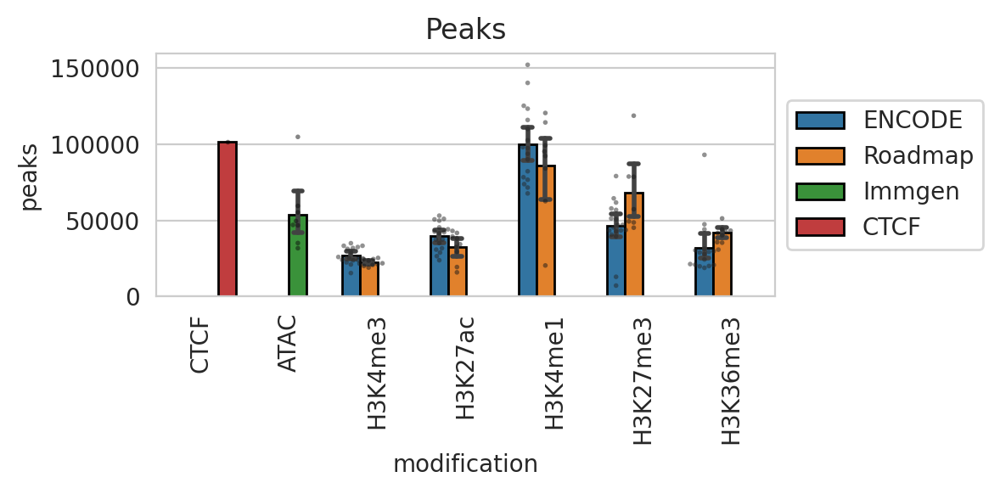

In [13]:
sns.set_style('whitegrid')
plt.figure(figsize=(6, 3))
ax = plt.axes()
sns.barplot(data=df_peaks, x='modification', y='peaks', hue='dataset',
            capsize=.1, errwidth=2, edgecolor="black",
            order=['CTCF', 'ATAC'] + MODIFICATIONS,
            hue_order=['ENCODE', 'Roadmap', 'Immgen', 'CTCF'],
            ax=ax)
sns.swarmplot(data=df_peaks, x='modification', y='peaks', hue='dataset',
              dodge=True, size=2, palette='dark:black', alpha=0.5,
              order=['CTCF', 'ATAC'] + MODIFICATIONS,
              hue_order=['ENCODE', 'Roadmap', 'Immgen', 'CTCF'],
              legend=False,
              ax=ax)
ax.xaxis.set_tick_params(rotation=90)
ax.title.set_text('Peaks')
# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

In [14]:
full_infos[(full_infos['modification'] == 'H3K27me3')].sort_values(by=['peaks'], ascending=False)[
    ['cell', 'replicate', 'peaks']].head(10)

,cell,replicate,peaks
108,TCell,,270439.0
117,BCell,,163411.0
115,NK,,118772.0
3,GM12878,rep1,79122.0
85,PBMC,,78831.0
120,CD4,rep2,78647.0
46,Huvec,rep2,64505.0
83,HepG2,rep1,61764.0
41,HMEC,rep1,57865.0
92,CD4,,57377.0


fit_out_up


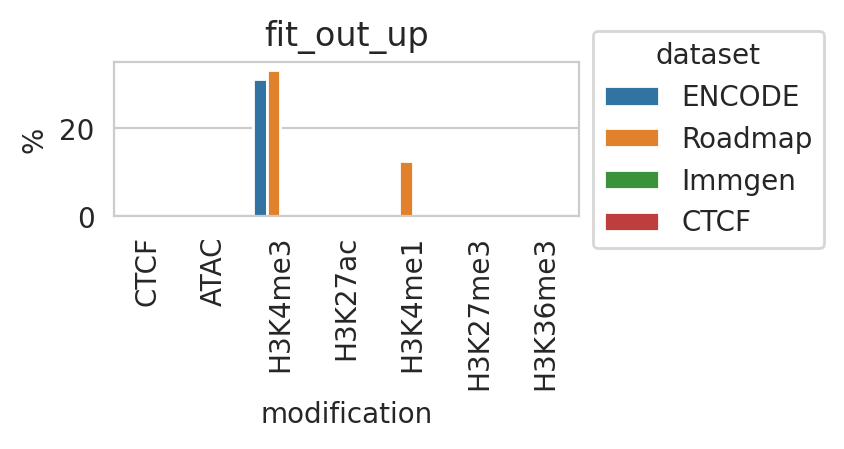

fit_out_down


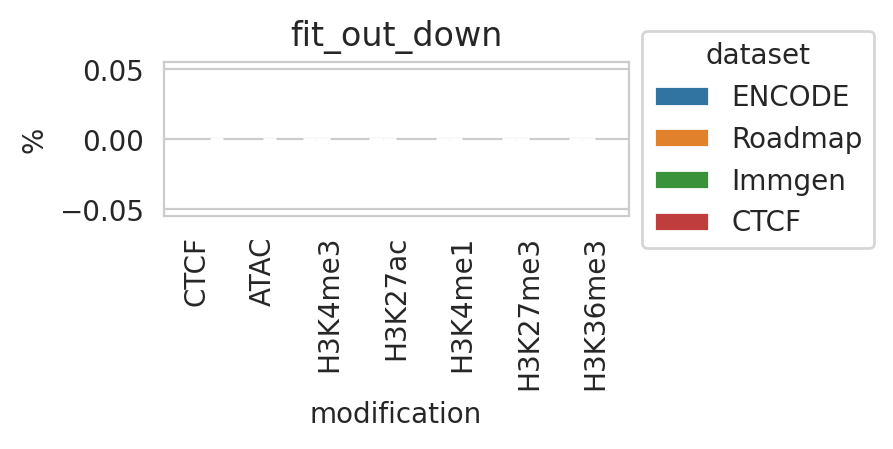

In [15]:
for out in ['fit_out_up', 'fit_out_down']:
    print(out)
    t = full_infos[['dataset', 'modification']].copy()
    t['number'] = [1 if o == True else 0 for o in full_infos[out]]
    t1 = t.groupby(['dataset', 'modification']).sum().reset_index()
    t2 = t.groupby(['dataset', 'modification']).count().reset_index()
    t1['number'] /= t2['number']
    t1['number'] *= 100
    plt.figure(figsize=(3, 1))
    ax = plt.axes()
    sns.barplot(data=t1, x='modification', y='number',
                hue='dataset',
                order=['CTCF', 'ATAC' ] + MODIFICATIONS,
                hue_order=['ENCODE', 'Roadmap', 'Immgen', 'CTCF'],
                ax=ax)
    ax.xaxis.set_tick_params(rotation=90)
    ax.set_ylabel('%')
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
    # plt.tight_layout()
    ax.set_title(f'{out}')
    plt.show()

# Sensitivity

In [16]:
def load_peaks_sensitivity(path, modifications, cells, replicates):
    ts = []
    # print(os.listdir(path))
    for f in tqdm(os.listdir(path)):
        if not f.endswith('.peak.sensitivity.tsv'):
            continue
        if 'ATAC_seq' in f:
            cell = re.sub('(SRR[0-9]+_)|(_ATAC.*)', '', os.path.basename(f))
            rep = re.sub('_.*', '', os.path.basename(f))
        else:
            cell = next((c for c in cells if c in f), None)
            rep = next((r for r in replicates if r in f), None)
        mod = next((m for m in modifications if m in f), None)
        if cell and mod and rep is not None:
            try:
                tsv_path = os.path.join(path, f)
                print(tsv_path, mod, cell, rep)
                t = pd.read_csv(tsv_path, sep='\t')
                t['file'] = tsv_path
                t['modification'] = mod
                t['cell'] = cell
                t['replicate'] = rep
                for g, tg in t.groupby('Gap'):
                    tg = tg.sort_values(by=['Sensitivity']).copy().reset_index(drop=True)
                    tg['SensitivityN'] = range(len(tg))
                    ts.append(tg)
            except Exception as e:
                print(e)
    df = pd.concat(ts).reset_index(drop=True)
    return df


In [17]:
gse26320_sensitivity = load_peaks_sensitivity(GSE26320_PATH + '/span', MODIFICATIONS, GSE26320_CELLS, GSE26320_REPS)
gse26320_sensitivity['dataset'] = 'ENCODE'
immune_sensitivity = load_peaks_sensitivity(IMMUNE_PATH + '/span', MODIFICATIONS, IMMUNE_CELLS, IMMUNE_REPS)
immune_sensitivity['dataset'] = 'Roadmap'
immgen_sensitivity = load_peaks_sensitivity(IMMGEN_PATH + '/span', ['ATAC'], IMMGEN_CELLS, IMMGEN_REPS)
immgen_sensitivity['dataset'] = 'Immgen'
ctcf_sensitivity = load_peaks_sensitivity(CTCF_PATH + '/span', ['CTCF'], CTCF_CELLS, CTCF_REPS)
ctcf_sensitivity['dataset'] = 'CTCF'
full_sensitivity = pd.concat([gse26320_sensitivity, immune_sensitivity, immgen_sensitivity, ctcf_sensitivity]).reset_index(drop=True)
# For log scale
full_sensitivity.fillna(0, inplace=True)
full_sensitivity['CandidatesN'] += 1
full_sensitivity['CandidatesAL'] += 1
full_sensitivity.sample(3)

  0%|          | 0/954 [00:00<?, ?it/s]

/home/jetbrains/data/2023_GSE26320/span/GSM646400_HSMM_H3K4me1_rep1_100_0.05.peak.sensitivity.tsv H3K4me1 HSMM rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646467_NHEK_H3K4me3_rep2_100_0.05.peak.sensitivity.tsv H3K4me3 NHEK rep2
/home/jetbrains/data/2023_GSE26320/span/GSM646476_NHLF_H3K27ac_rep1_100_0.05.peak.sensitivity.tsv H3K27ac NHLF rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646435_K562_H3K27ac_rep2_100_0.05.peak.sensitivity.tsv H3K27ac K562 rep2
/home/jetbrains/data/2023_GSE26320/span/GSM646424_Huvec_H3K4me3_rep1_100_0.05.peak.sensitivity.tsv H3K4me3 Huvec rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646355_HepG2_H3K27ac_rep1_100_0.05.peak.sensitivity.tsv H3K27ac HepG2 rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646380_HMEC_H3K4me1_rep1_100_0.05.peak.sensitivity.tsv H3K4me1 HMEC rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646320_GM12878_H3K36me3_rep1_100_0.05.peak.sensitivity.tsv H3K36me3 GM12878 rep1
/home/jetbrains/data/2023_GSE26320/span/GSM646487_NHLF_H3K4m

  0%|          | 0/517 [00:00<?, ?it/s]

/home/jetbrains/data/2023_Immune/span/BCell_H3K4me3_hg38_ENCFF213VRU_100_0.05.peak.sensitivity.tsv H3K4me3 BCell 
/home/jetbrains/data/2023_Immune/span/CD34_H3K36me3_rep1_hg38_ENCFF785IJG_100_0.05.peak.sensitivity.tsv H3K36me3 CD34 rep1
/home/jetbrains/data/2023_Immune/span/CD34_H3K27me3_hg38_ENCFF987YGU_100_0.05.peak.sensitivity.tsv H3K27me3 CD34 
/home/jetbrains/data/2023_Immune/span/PBMC_H3K4me3_hg38_ENCFF558XUB_100_0.05.peak.sensitivity.tsv H3K4me3 PBMC 
/home/jetbrains/data/2023_Immune/span/CD34_H3K27ac_hg38_ENCFF026YFQ_100_0.05.peak.sensitivity.tsv H3K27ac CD34 
/home/jetbrains/data/2023_Immune/span/Monocyte_H3K36me3_hg38_ENCFF164MUD_100_0.05.peak.sensitivity.tsv H3K36me3 Monocyte 
/home/jetbrains/data/2023_Immune/span/Monocyte_H3K4me1_hg38_ENCFF396RZF_100_0.05.peak.sensitivity.tsv H3K4me1 Monocyte 
/home/jetbrains/data/2023_Immune/span/TCellBB_H3K4me3_rep2_hg38_ENCFF822TCP_100_0.05.peak.sensitivity.tsv H3K4me3 TCellBB rep2
/home/jetbrains/data/2023_Immune/span/CD34_H3K4me3_rep2_

  0%|          | 0/89 [00:00<?, ?it/s]

/home/jetbrains/data/2024_Immgen/span/SRR5799492_Blood_Monocyte_ATAC_seq_100_0.05.peak.sensitivity.tsv ATAC Blood_Monocyte SRR5799492
/home/jetbrains/data/2024_Immgen/span/SRR5799491_Blood_Monocyte_ATAC_seq_100_0.05.peak.sensitivity.tsv ATAC Blood_Monocyte SRR5799491
/home/jetbrains/data/2024_Immgen/span/SRR5799541_Blood_Monocyte_ATAC_seq_100_0.05.peak.sensitivity.tsv ATAC Blood_Monocyte SRR5799541
/home/jetbrains/data/2024_Immgen/span/SRR5799444_Small_Intestine_CD8_T_Cell_ATAC_seq_100_0.05.peak.sensitivity.tsv ATAC Small_Intestine_CD8_T_Cell SRR5799444
/home/jetbrains/data/2024_Immgen/span/SRR5799542_Blood_Monocyte_ATAC_seq_100_0.05.peak.sensitivity.tsv ATAC Blood_Monocyte SRR5799542
/home/jetbrains/data/2024_Immgen/span/SRR5799445_Small_Intestine_CD8_T_Cell_ATAC_seq_100_0.05.peak.sensitivity.tsv ATAC Small_Intestine_CD8_T_Cell SRR5799445
/home/jetbrains/data/2024_Immgen/span/SRR5799493_Blood_Monocyte_ATAC_seq_100_0.05.peak.sensitivity.tsv ATAC Blood_Monocyte SRR5799493
/home/jetbrain

  0%|          | 0/12 [00:00<?, ?it/s]

/home/jetbrains/data/2024_TFs/span/H1_CTCF_hg38_ENCFF767YLK_100_0.05.peak.sensitivity.tsv CTCF H1 


,Sensitivity,Gap,CandidatesN,CandidatesAL,CandidatesML,SignalNoiseRatio,SignalControlRatio,file,modification,cell,replicate,SensitivityN,dataset
16449,-0.072559,10,57850,22.454684,16.0,0.0,0.0,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K27ac,HSMM,rep2,49,ENCODE
58301,-341.387065,3,2,2.000000,1.0,0.0,0.0,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K4me1,Huvec,rep2,1,ENCODE
85345,-0.047877,100,29506,194.546009,50.0,0.0,0.0,/home/jetbrains/data/2023_Immune/span/CD34_H3K...,H3K27me3,CD34,rep2,45,Roadmap


## Examples

Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 0.16309876707091092) I3mab (85, 30.58563233121062)
Checking I 11 I1mab (6, 0.21797731524624797) I3mab (85, 29.770857656693792)
Checking I 12 I1mab (6, 0.26993606322015756) I3mab (85, 29.078286006597466)
Checking I 13 I1mab (6, 0.3161789856893966) I3mab (85, 28.47949290574995)
Checking I 14 I1mab (6, 0.3634498725316765) I3mab (85, 27.8839960529086)
Checking I 15 I1mab (6, 0.4060117445228733) I3mab (85, 27.392399876490103)
Checking I 16 I1mab (6, 0.4507406667989974) I3mab (85, 26.897267771610927)
Checking I 17 I1mab (6, 0.4884831601733928) I3mab (85, 26.44360145077863)
Checking I 18 I1mab (6, 0.5271320859379254) I3mab (85, 26.020707198537096)
Checking I 19 I1mab (6, 0.5701644588362507) I3mab (87, 25.597102493116395)
Checking I 20 I1mab (6, 0.6156419930103916) I3mab (87, 25.171659642009672)
Checking I 21 I1mab (6, 0.6443859441689989) I3mab (87, 24.839242915824883)
Checking I 22 I1mab (6, 0.6873084229080788) I3mab (87, 24.474312177655065)
Checkin

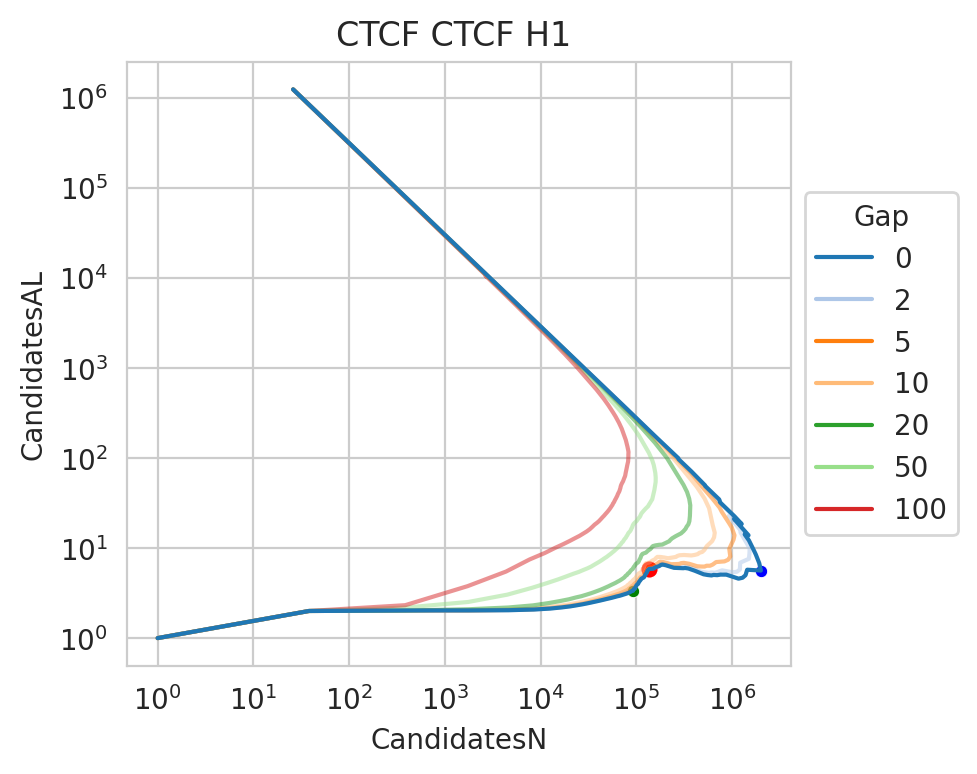

CandidatesN


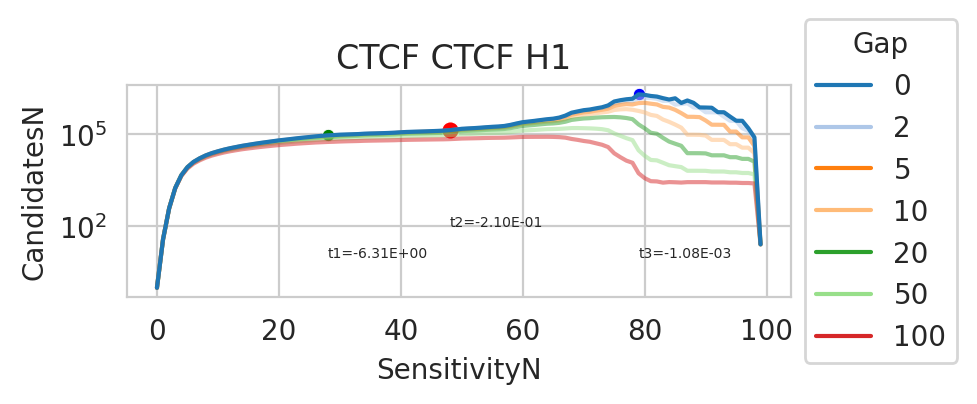

CandidatesAL


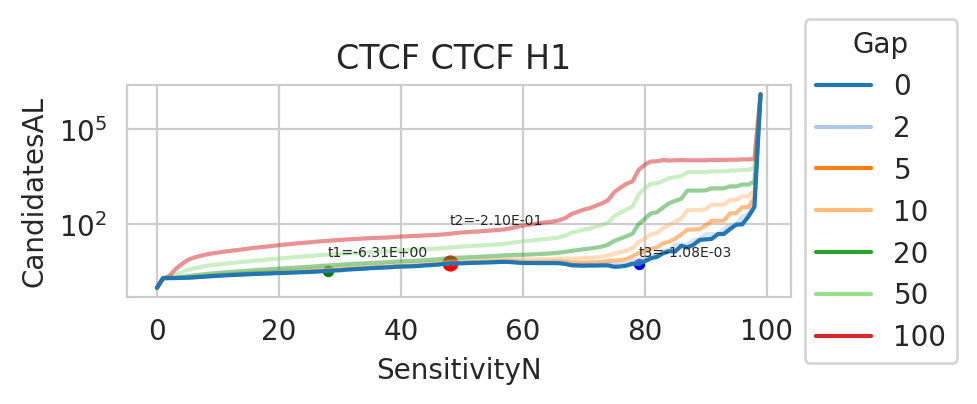

CandidatesML


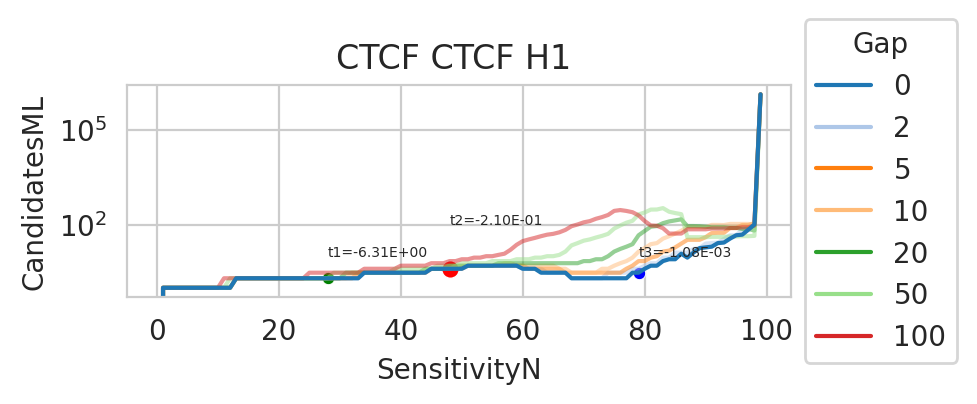

SignalNoiseRatio


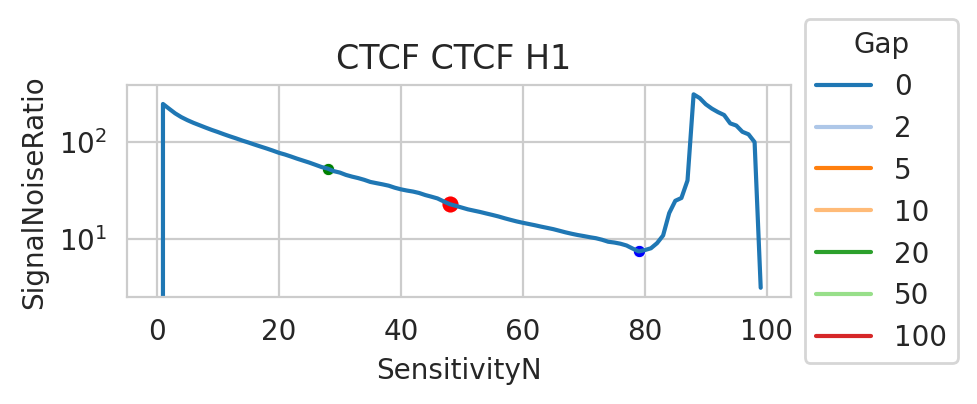

SignalControlRatio


/tmp/ipykernel_3632833/569904019.py:47: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set(yscale='log')


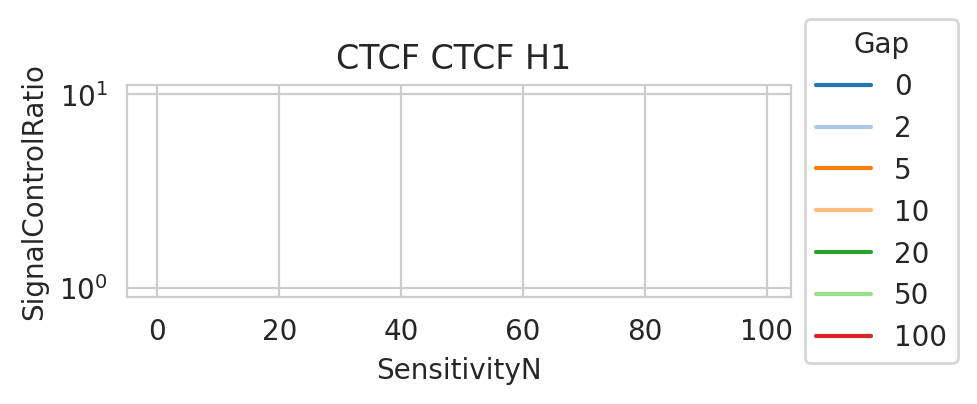

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (74, 36.615241628671555)
Checking I 11 I1mab (10, 0.01176099795501695) I3mab (74, 34.269994204153335)
Checking I 12 I1mab (10, 0.049875515872533915) I3mab (74, 32.48347029553268)
Checking I 13 I1mab (10, 0.06514694261095927) I3mab (75, 31.153271329584015)
Checking I 14 I1mab (10, 0.10425945024857924) I3mab (77, 29.899664421879038)
Checking I 15 I1mab (10, 0.15284332690943125) I3mab (77, 28.680604852555206)
Checking I 16 I1mab (10, 0.19175738791785435) I3mab (77, 27.73013225153349)
Checking I 17 I1mab (10, 0.23352444654542137) I3mab (77, 26.772100855282417)
Checking I 18 I1mab (11, 0.3263939374620538) I3mab (77, 25.884954641231886)
Checking I 19 I1mab (11, 0.5002490866131167) I3mab (77, 25.095030991094546)
Checking I 20 I1mab (11, 0.5871615849951746) I3mab (78, 24.409960004846425)
Checking I 21 I1mab (11, 0.724399744716986) I3mab (78, 23.813530627755327)
Checking I 22 I1mab (11, 0.9323479347817841) I3mab (78, 23.292479803119576)
Chec

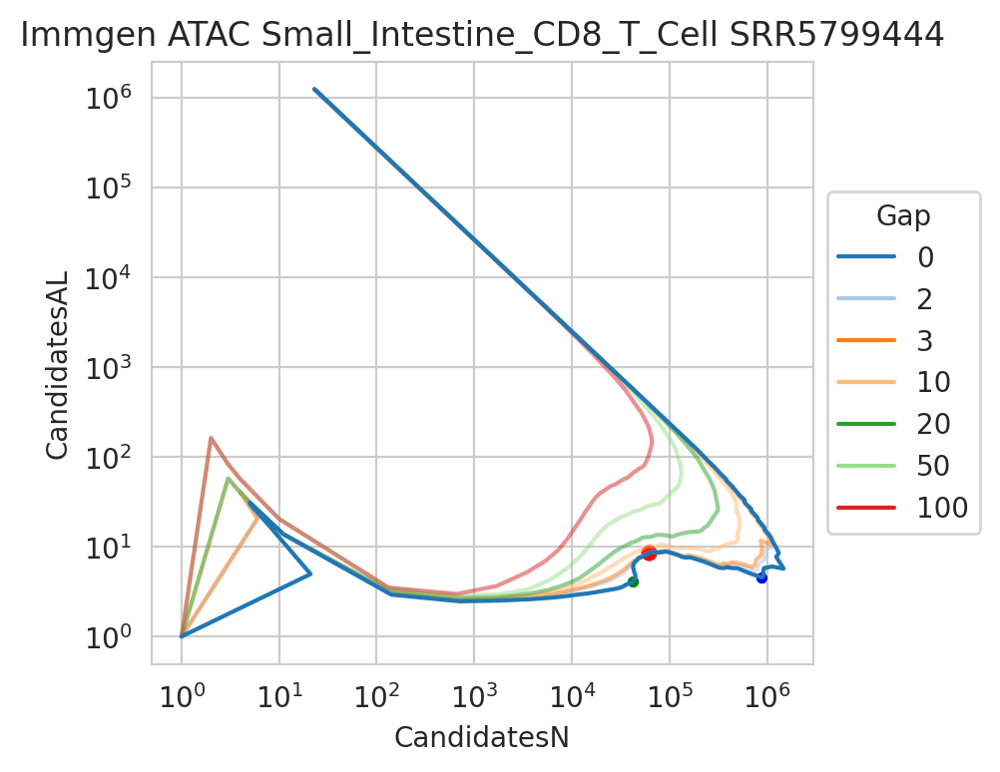

CandidatesN


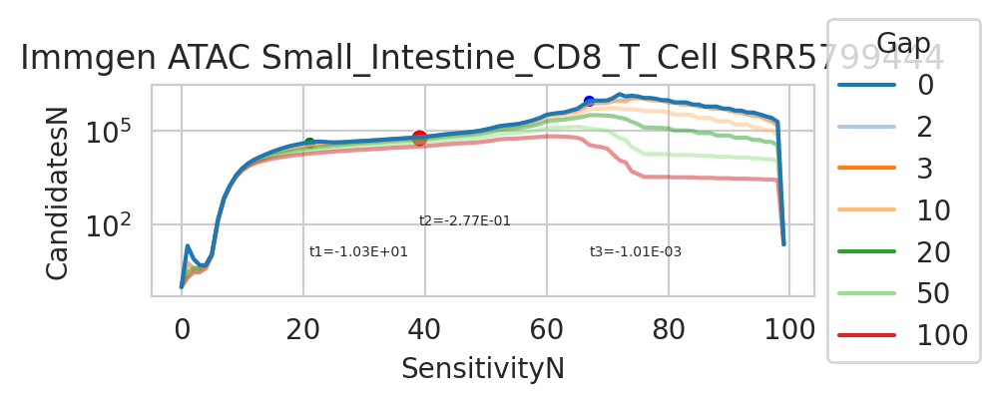

CandidatesAL


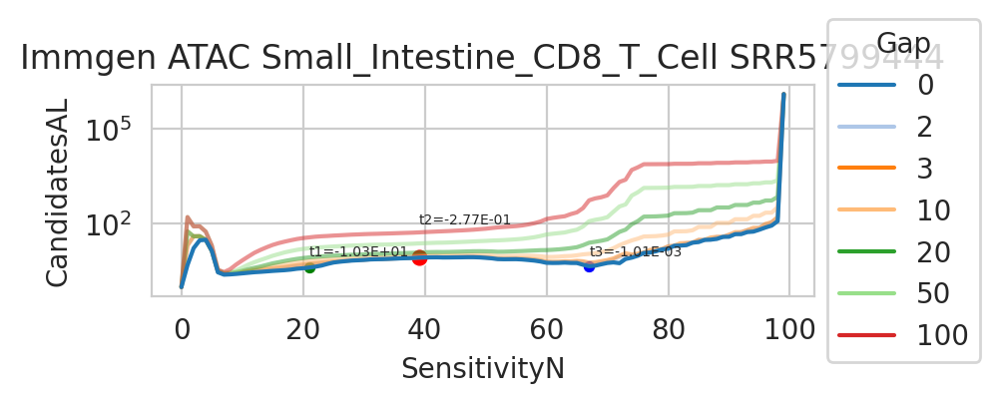

CandidatesML


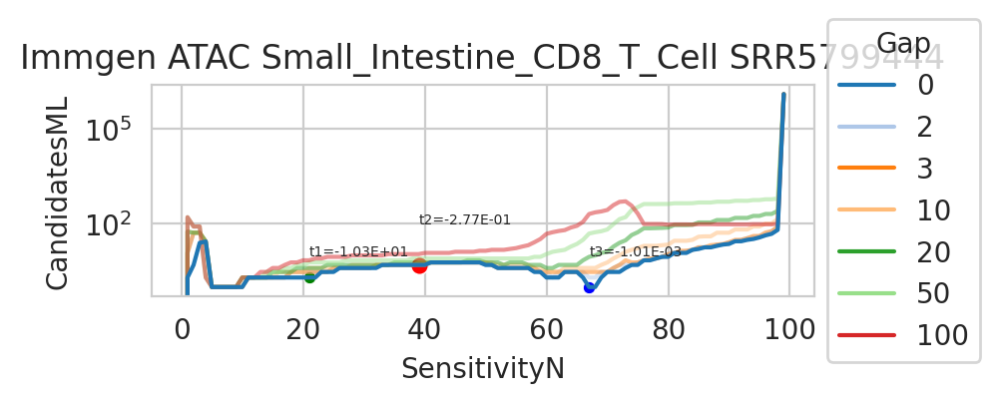

SignalNoiseRatio


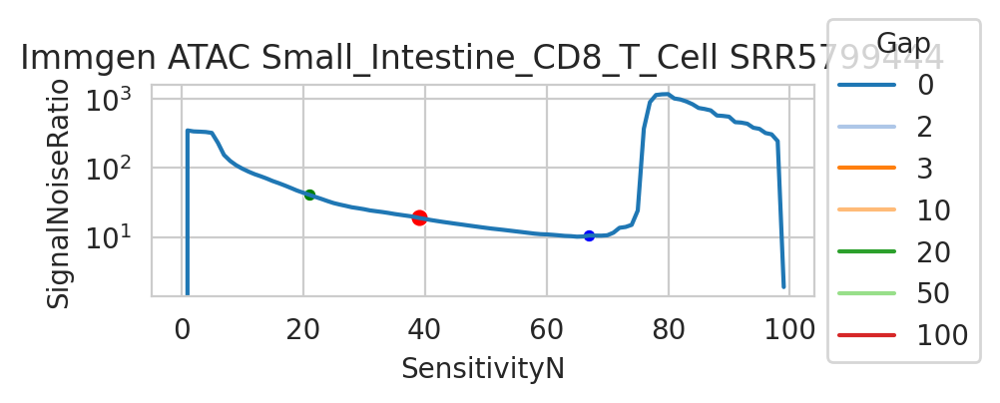

SignalControlRatio


/tmp/ipykernel_3632833/569904019.py:47: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set(yscale='log')


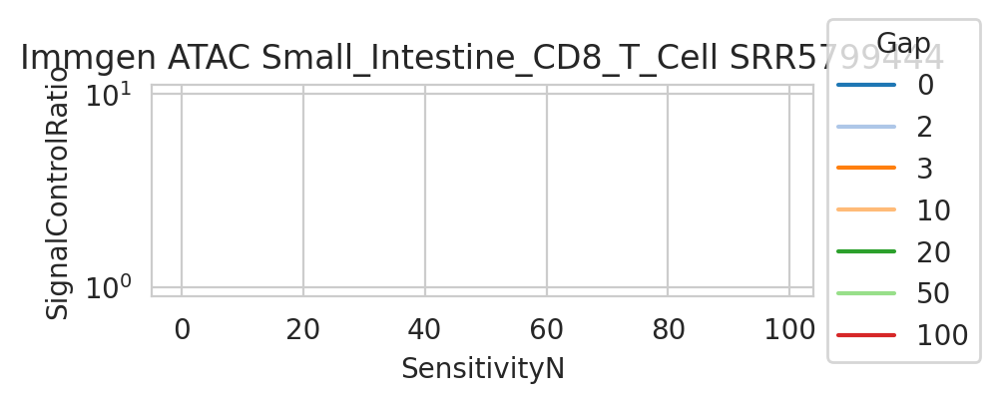

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (65, 49.7872649109209)
Checking I 11 I1mab (-1, 0) I3mab (65, 45.230006180197265)
Checking I 12 I1mab (-1, 0) I3mab (65, 41.023918983691146)
Checking I 13 I1mab (-1, 0) I3mab (65, 38.53387991950234)
Checking I 14 I1mab (-1, 0) I3mab (65, 36.2501579669314)
Checking I 15 I1mab (-1, 0) I3mab (65, 34.13629075254053)
Checking I 16 I1mab (15, 0.020259156897174835) I3mab (66, 32.63907608709361)
Checking I 17 I1mab (15, 0.04150396344023288) I3mab (66, 31.199304847926854)
Checking I 18 I1mab (15, 0.038849267910685104) I3mab (66, 29.669130546155657)
Checking I 19 I1mab (-1, 0) I3mab (66, 27.968024762331623)
Checking I 20 I1mab (-1, 0) I3mab (66, 26.025935807565205)
Checking I 21 I1mab (20, 0.06376251099076807) I3mab (66, 23.85440818716482)
Checking I 22 I1mab (20, 0.23882914776766861) I3mab (70, 21.805531884703782)
Checking I 23 I1mab (20, 0.9678245709755555) I3mab (70, 20.211811722515677)
Checking I 24 I1mab (21, 2.048057821001382) I3mab (71

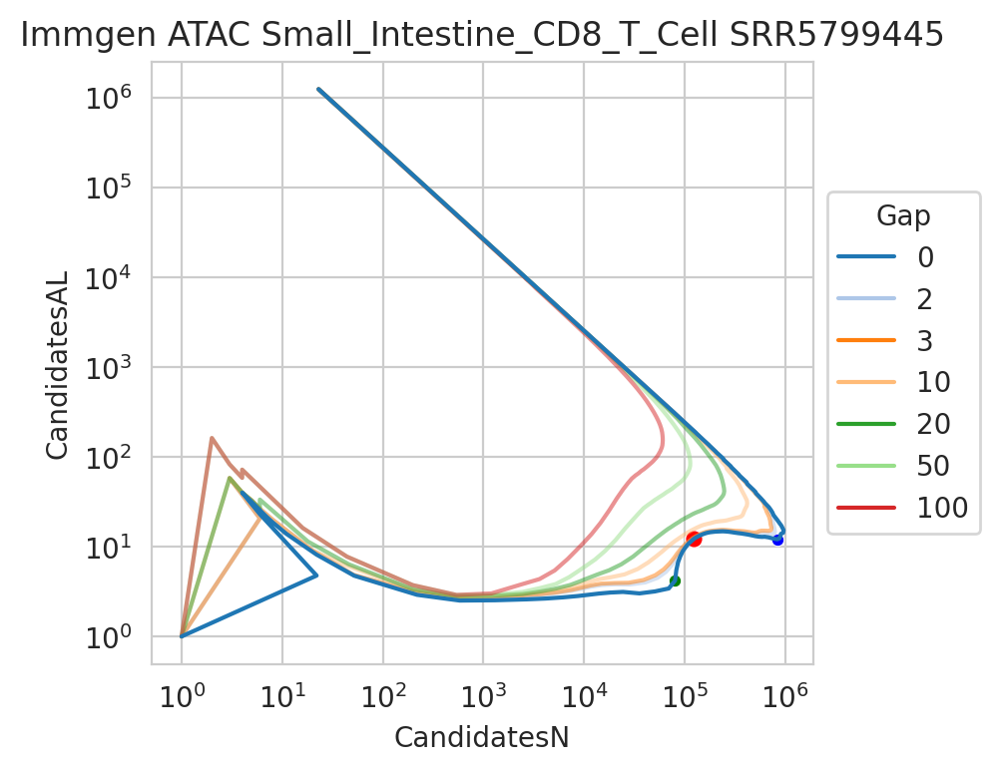

CandidatesN


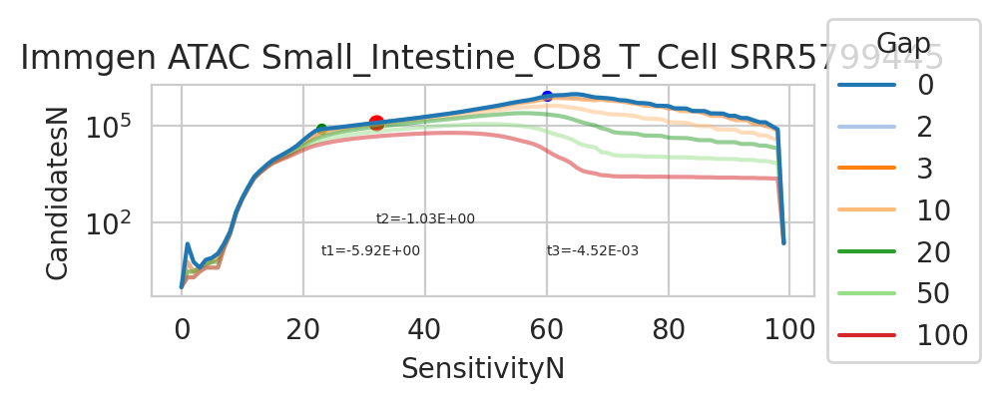

CandidatesAL


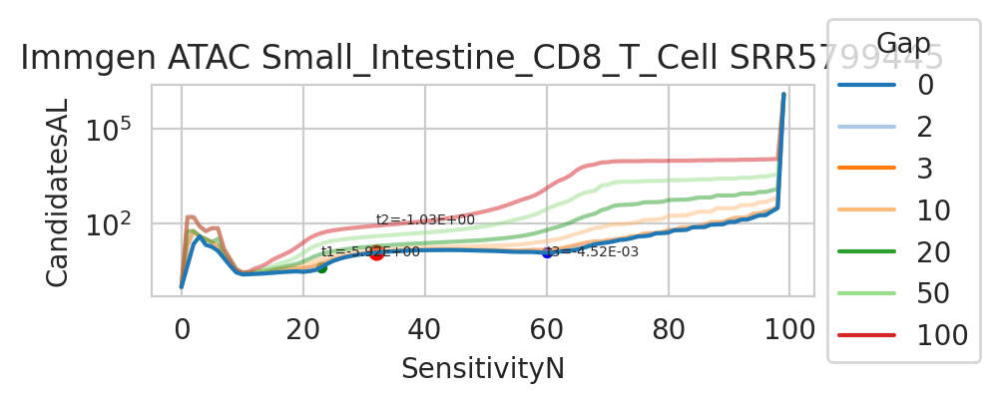

CandidatesML


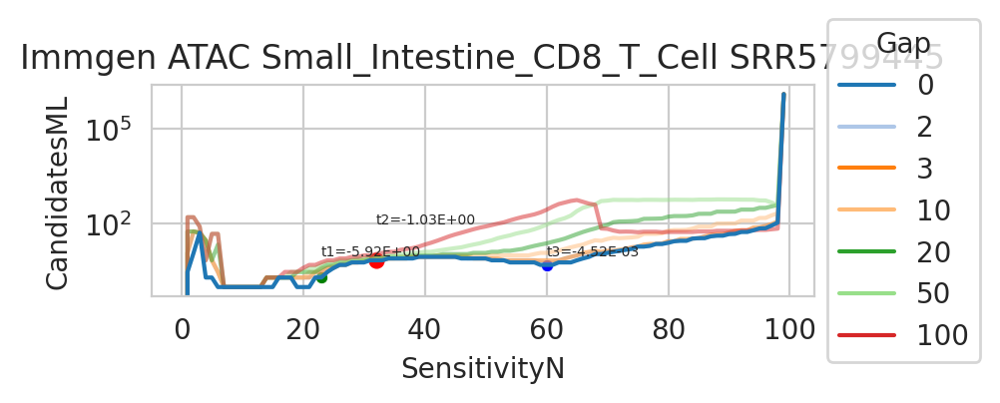

SignalNoiseRatio


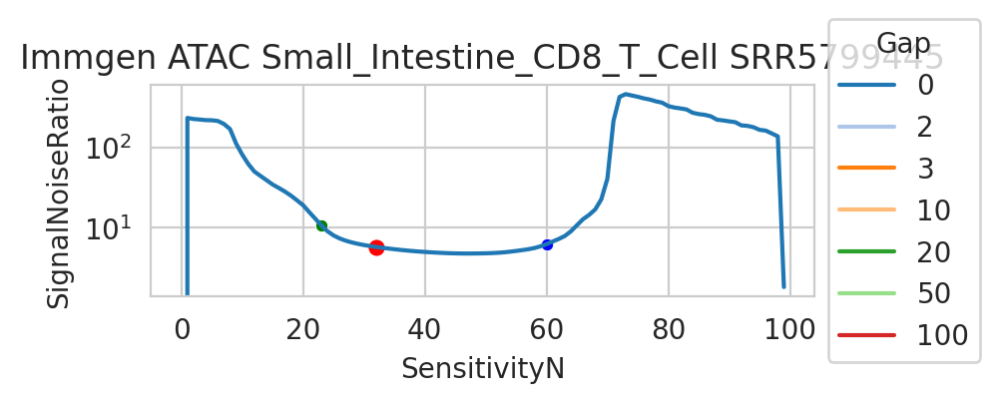

SignalControlRatio


/tmp/ipykernel_3632833/569904019.py:47: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set(yscale='log')


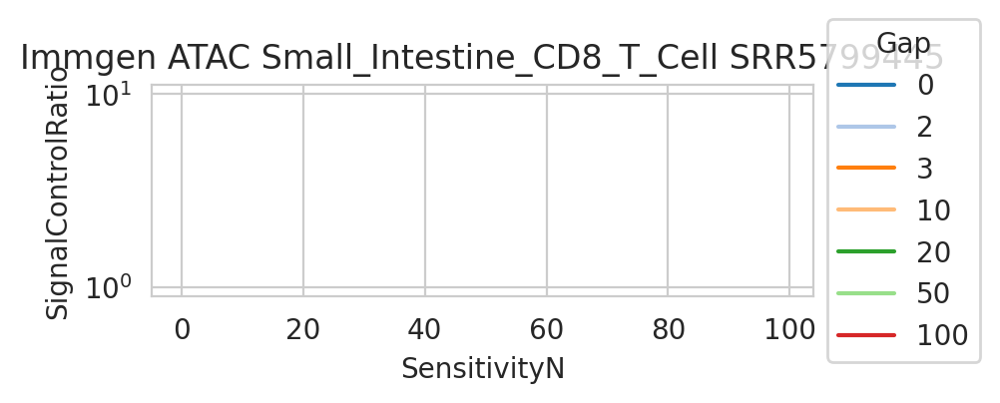

Limit Im1 10 Im2 90
Checking I 10 I1mab (9, 0.0205334869317656) I3mab (86, 35.7990895622186)
Checking I 11 I1mab (9, 0.1089615192861032) I3mab (86, 33.46506630770986)
Checking I 12 I1mab (10, 0.31127953062885705) I3mab (86, 30.663620523870193)
Checking I 13 I1mab (10, 0.43014673323314667) I3mab (86, 29.28108511239529)
Checking I 14 I1mab (10, 0.6940198327985453) I3mab (89, 27.396079859273428)
Checking I 15 I1mab (10, 0.8883211232050565) I3mab (89, 26.184401562502316)
Checking I 16 I1mab (10, 1.1242286488352853) I3mab (89, 25.032024429450516)
Checking I 17 I1mab (10, 1.1907191681080023) I3mab (89, 24.28749539387657)
Checking I 18 I1mab (10, 1.564206435676715) I3mab (89, 23.221815229584877)
Checking I 19 I1mab (10, 1.737408342384473) I3mab (89, 22.507081234127497)
Checking I 20 I1mab (10, 2.033227257046736) I3mab (89, 21.89375716493737)
Checking I 21 I1mab (10, 2.5914246467712094) I3mab (89, 21.433378277487733)
Checking I 22 I1mab (11, 4.082621340407619) I3mab (89, 21.256161988139738)
Ch

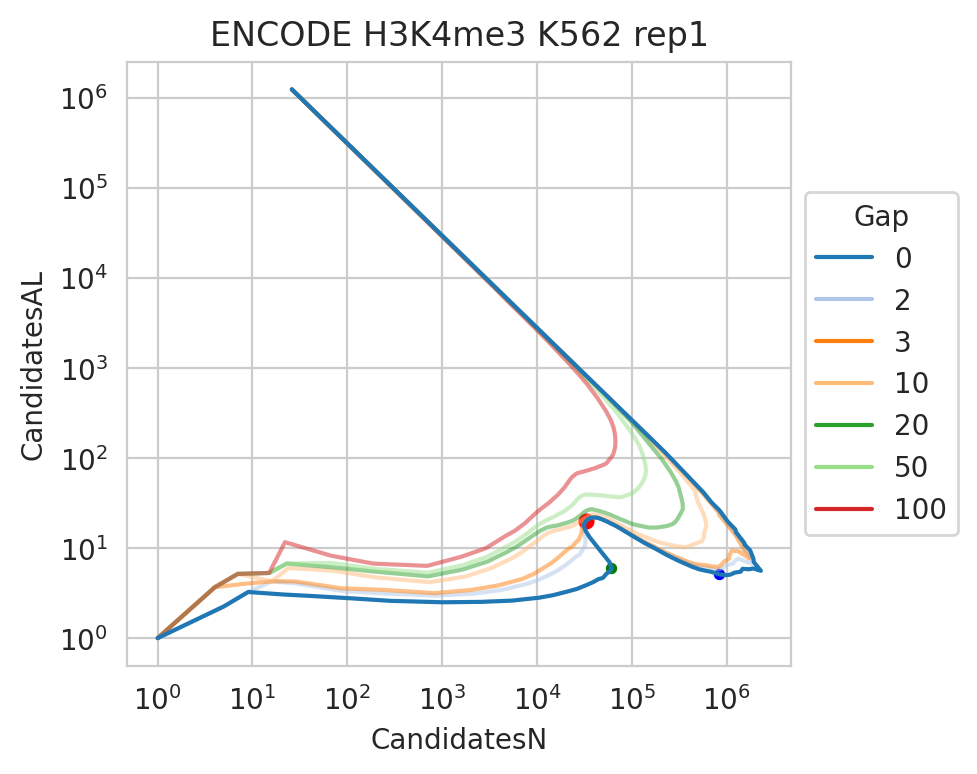

CandidatesN


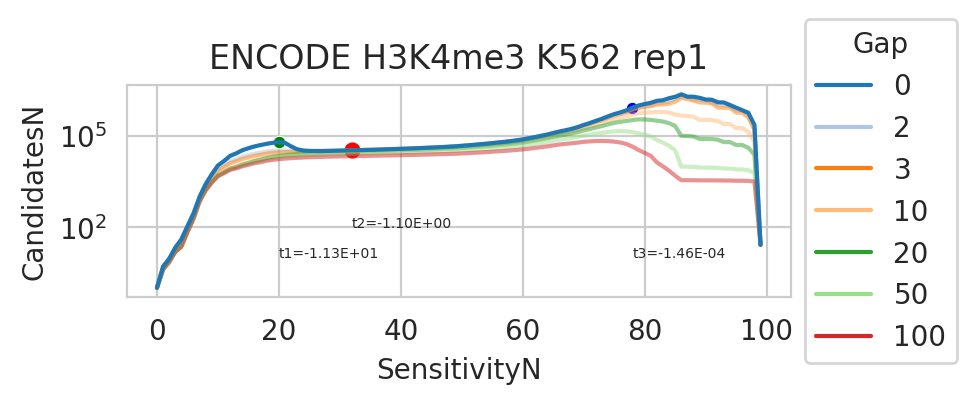

CandidatesAL


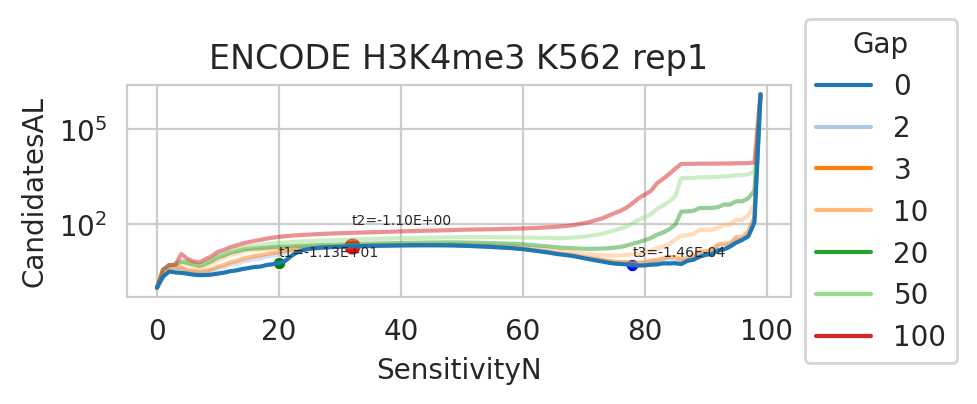

CandidatesML


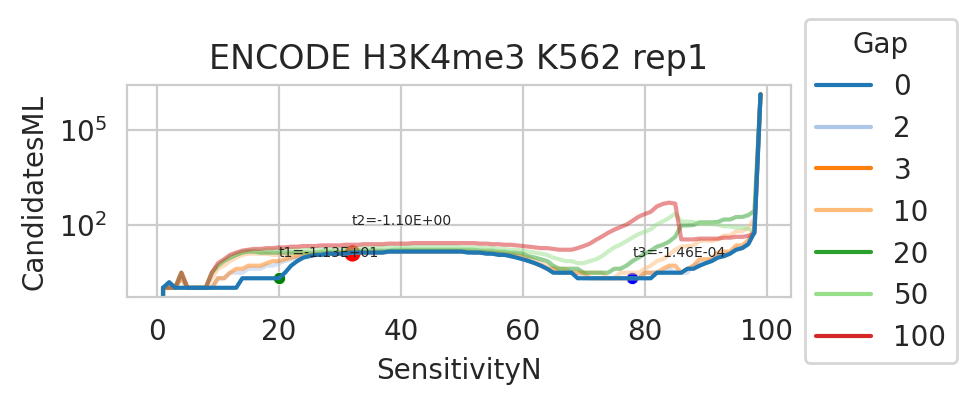

SignalNoiseRatio


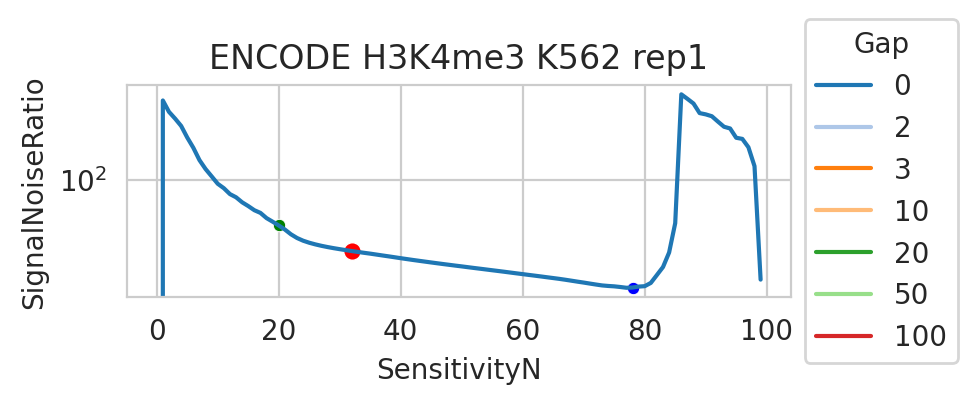

SignalControlRatio


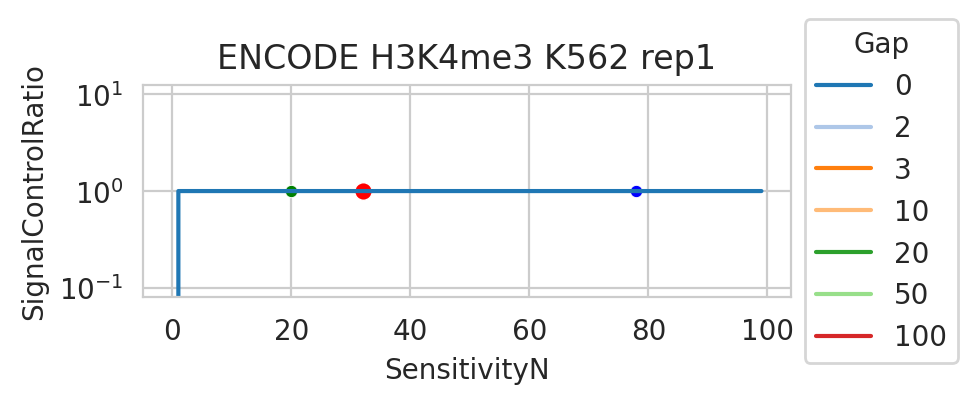

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (86, 35.05734356924206)
Checking I 11 I1mab (10, 0.015881699105418756) I3mab (86, 33.08954772221328)
Checking I 12 I1mab (10, 0.045090666602294605) I3mab (86, 31.70630891310519)
Checking I 13 I1mab (10, 0.07407955852573367) I3mab (86, 30.23190222876653)
Checking I 14 I1mab (10, 0.12002926575275752) I3mab (86, 28.6487380017642)
Checking I 15 I1mab (10, 0.1577338995060119) I3mab (86, 27.382360015853493)
Checking I 16 I1mab (10, 0.2473336607279284) I3mab (86, 26.133842530534963)
Checking I 17 I1mab (10, 0.29122618190072314) I3mab (86, 25.081738393584473)
Checking I 18 I1mab (10, 0.3824053702867627) I3mab (86, 24.05999379572478)
Checking I 19 I1mab (10, 0.37634917984280114) I3mab (92, 23.340708687985924)
Checking I 20 I1mab (11, 0.5611772022986958) I3mab (92, 22.384170040283408)
Checking I 21 I1mab (11, 0.6175366396427815) I3mab (92, 21.65509611235524)
Checking I 22 I1mab (11, 0.7387949844722984) I3mab (92, 20.99143813784447)
Checking I

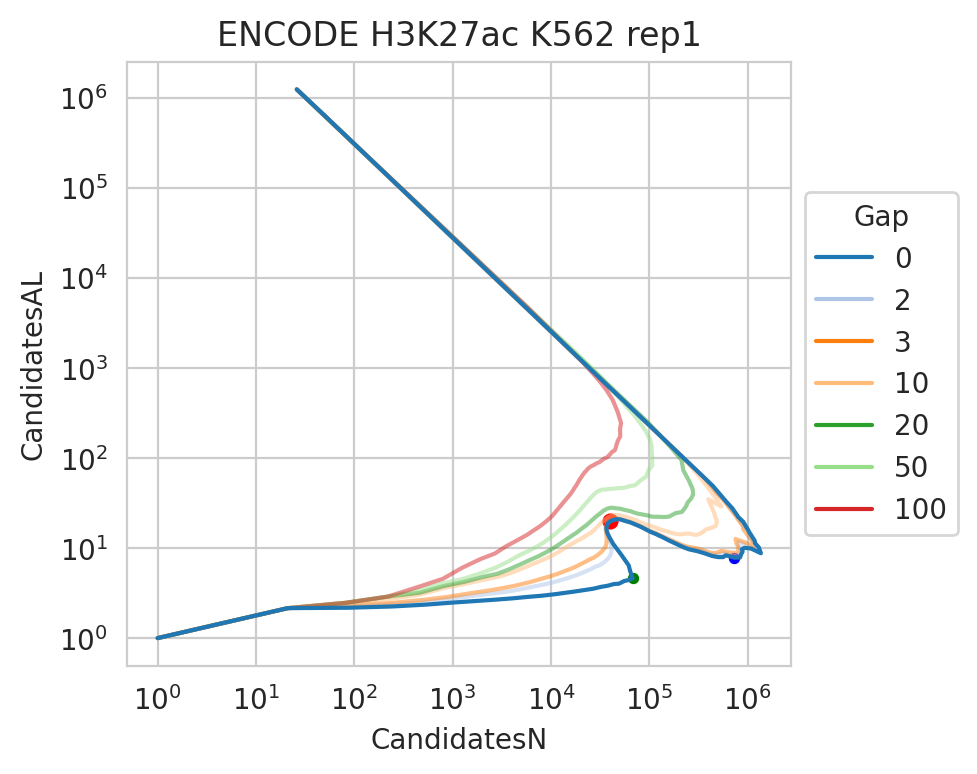

CandidatesN


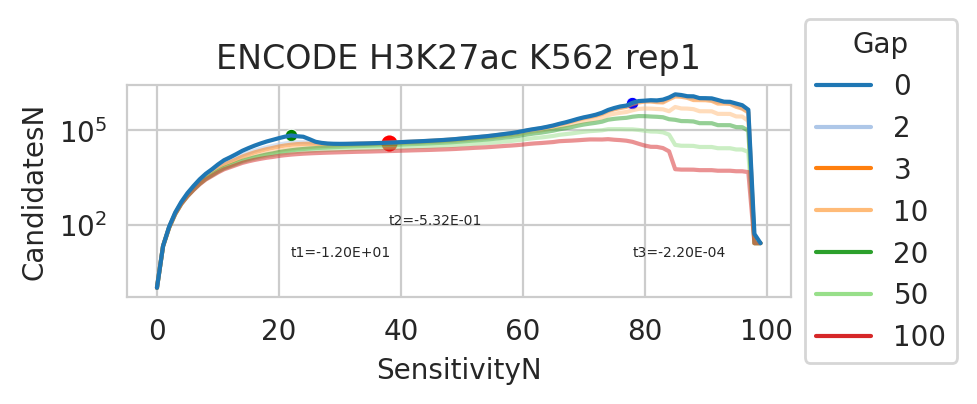

CandidatesAL


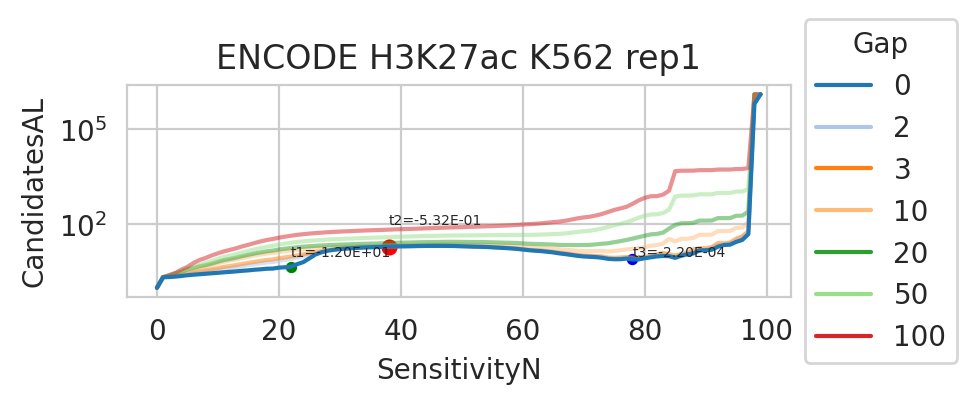

CandidatesML


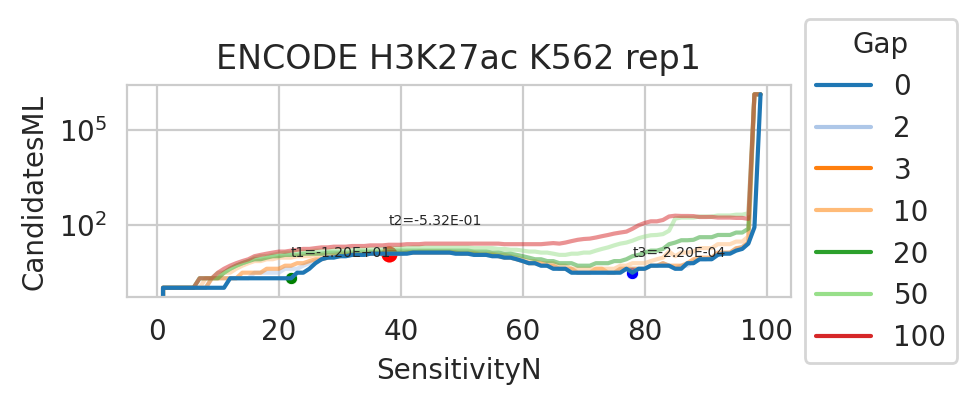

SignalNoiseRatio


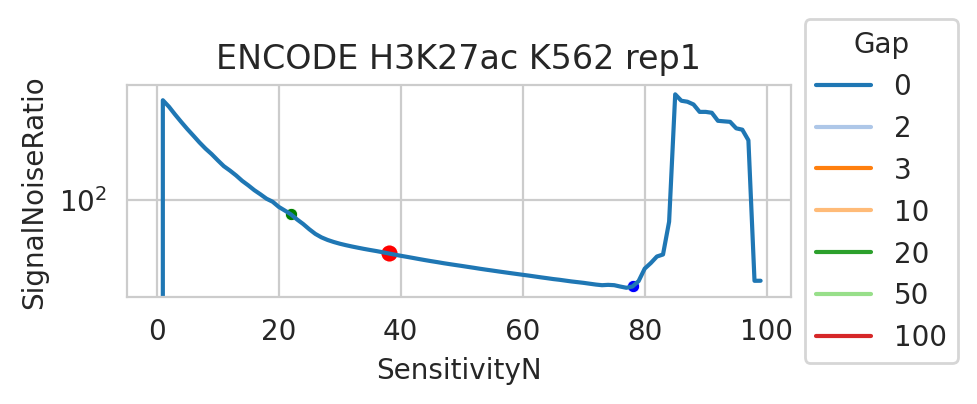

SignalControlRatio


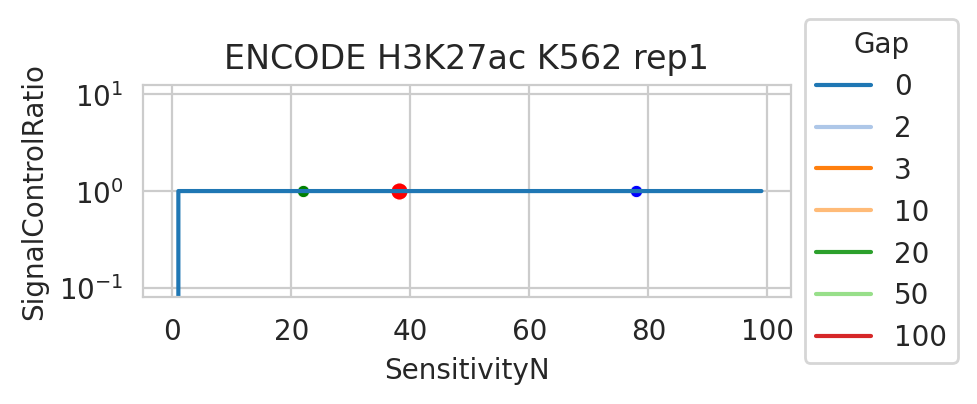

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (66, 59.392414132983205)
Checking I 11 I1mab (-1, 0) I3mab (66, 57.539995778252994)
Checking I 12 I1mab (11, 0.011149603121167972) I3mab (66, 56.65180582854257)
Checking I 13 I1mab (-1, 0) I3mab (67, 56.17378044919012)
Checking I 14 I1mab (-1, 0) I3mab (67, 54.56151991090755)
Checking I 15 I1mab (-1, 0) I3mab (67, 50.981793026121984)
Checking I 16 I1mab (-1, 0) I3mab (67, 44.32477484216182)
Checking I 17 I1mab (-1, 0) I3mab (68, 36.5262194247241)
Checking I 18 I1mab (17, 0.17364148949425773) I3mab (68, 29.577748954014552)
Checking I 19 I1mab (17, 1.1584260567454803) I3mab (69, 23.871910582127697)
Checking I 20 I1mab (18, 3.1488530377915183) I3mab (70, 19.348163604679044)
Checking I 21 I1mab (18, 5.390883880995002) I3mab (70, 16.129994755289175)
Checking I 22 I1mab (18, 7.378262321453754) I3mab (71, 13.962156046663424)
Checking I 23 I1mab (18, 8.891675487179656) I3mab (71, 12.469793243751198)
Checking I 24 I1mab (18, 10.0102484143942

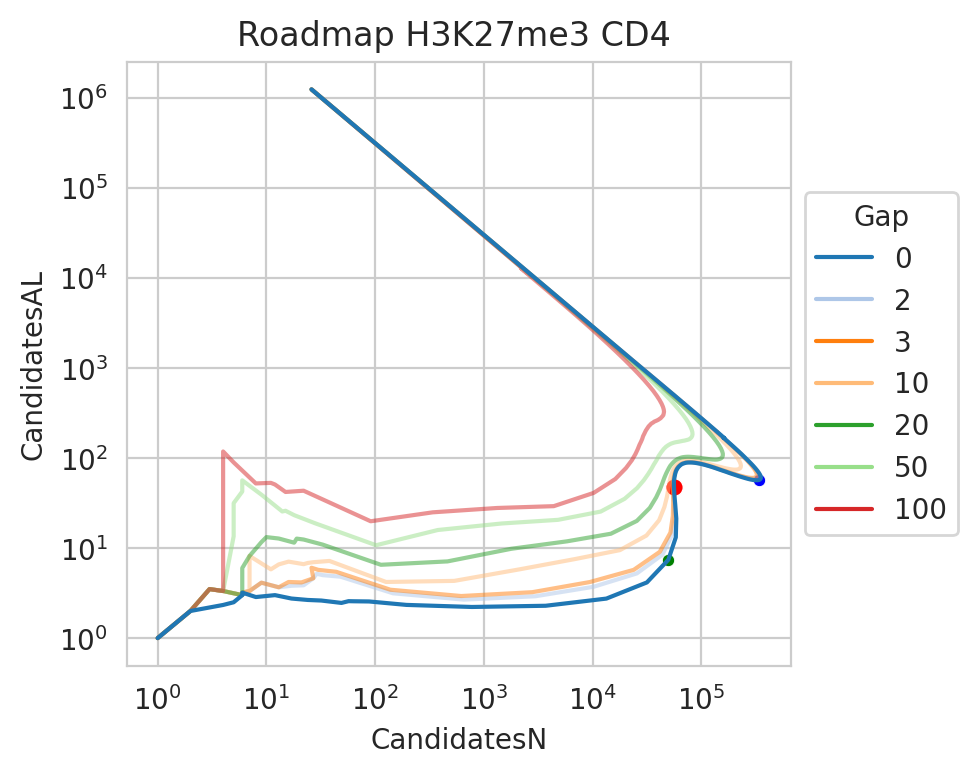

CandidatesN


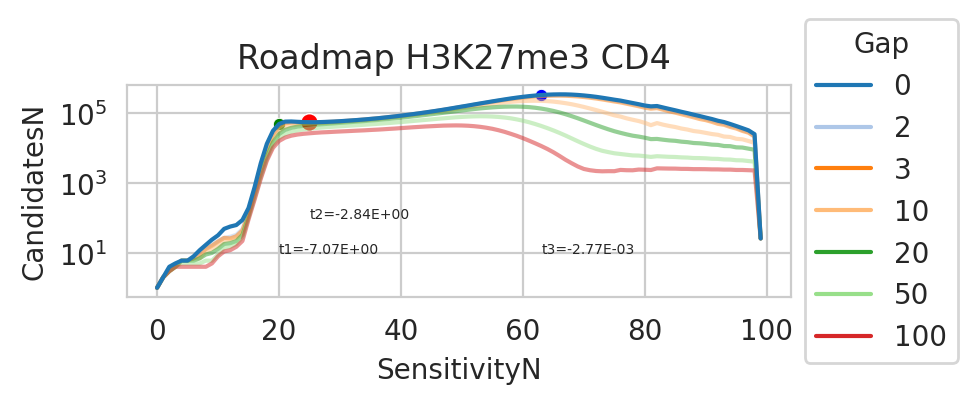

CandidatesAL


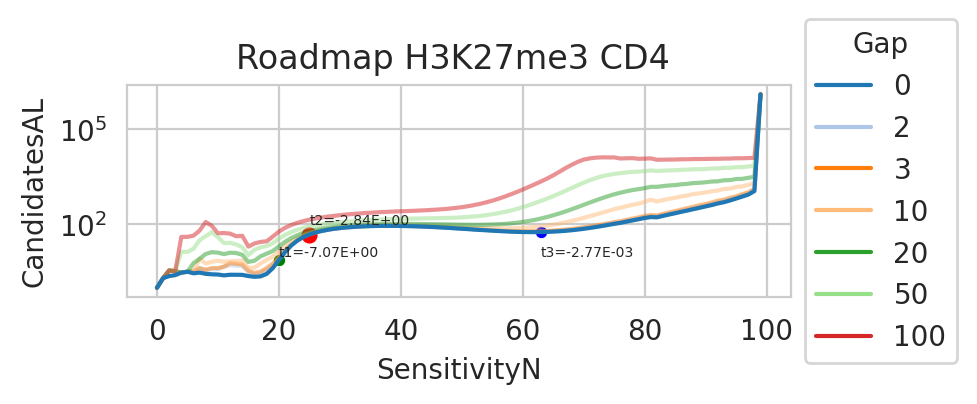

CandidatesML


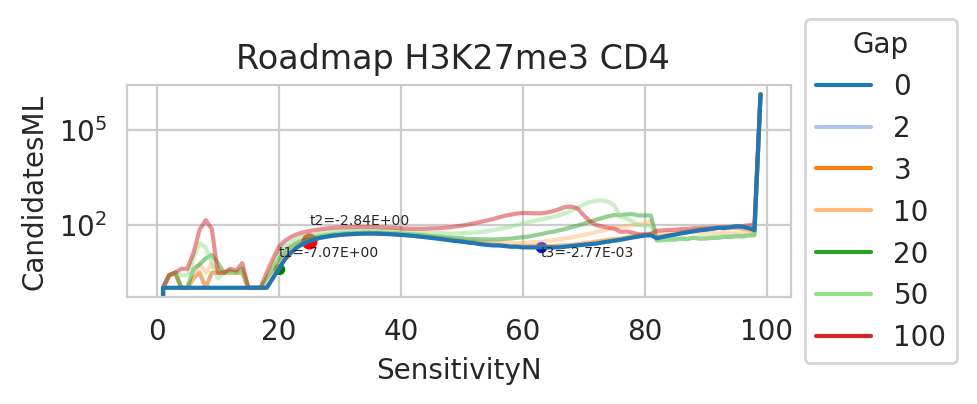

SignalNoiseRatio


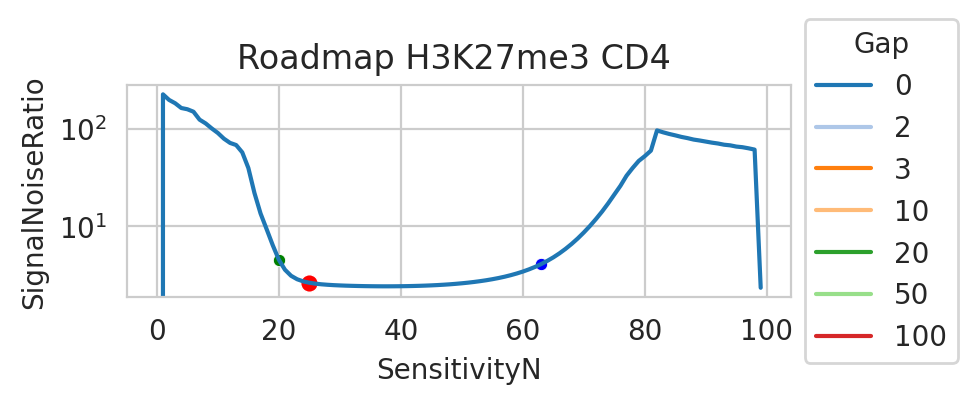

SignalControlRatio


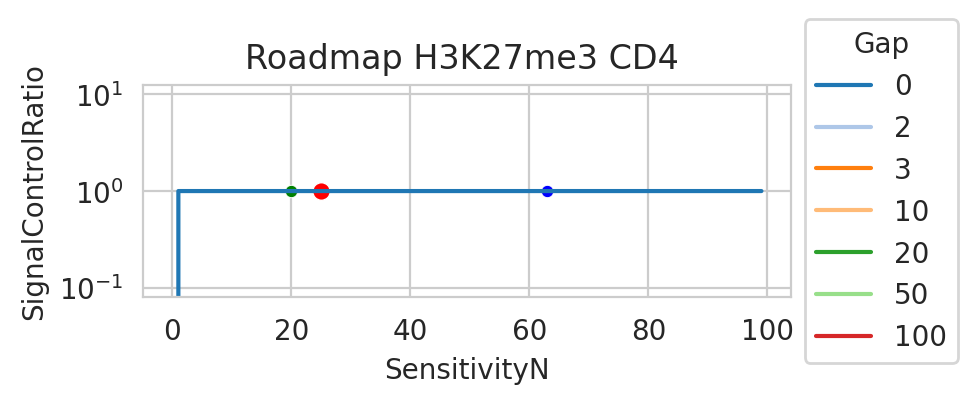

Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 1.1088301805503984) I3mab (84, 25.075726617915592)
Checking I 11 I1mab (6, 1.3079981467342843) I3mab (84, 23.88659368636202)
Checking I 12 I1mab (6, 1.3904915922141705) I3mab (84, 22.576585791983163)
Checking I 13 I1mab (6, 1.3138781809601587) I3mab (84, 21.019474057405517)
Checking I 14 I1mab (6, 1.3327401232982208) I3mab (84, 19.4207426398373)
Checking I 15 I1mab (6, 1.124894511839208) I3mab (84, 18.045326458233248)
Checking I 16 I1mab (6, 2.0933812134833523) I3mab (84, 16.954576783248157)
Checking I 17 I1mab (7, 3.3729006276737445) I3mab (84, 16.08379645333838)
Checking I 18 I1mab (15, 5.962384281723331) I3mab (84, 15.489120395574673)
Checking I 19 I1mab (15, 7.973868479832835) I3mab (84, 14.936529021203299)
Checking I 20 I1mab (15, 9.321588637863565) I3mab (84, 14.482895928977271)
Checking I 21 I1mab (15, 10.207441894070683) I3mab (84, 14.11074813266346)
Checking I 22 I1mab (15, 10.809903429305798) I3mab (84, 13.80026857412605)
Checking I

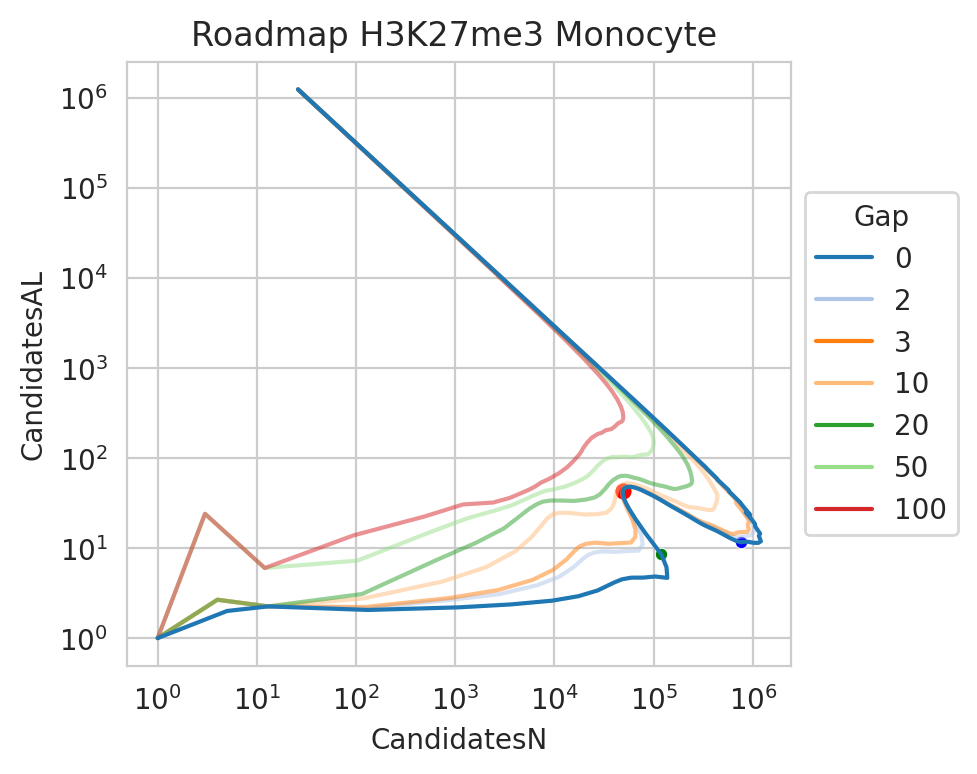

CandidatesN


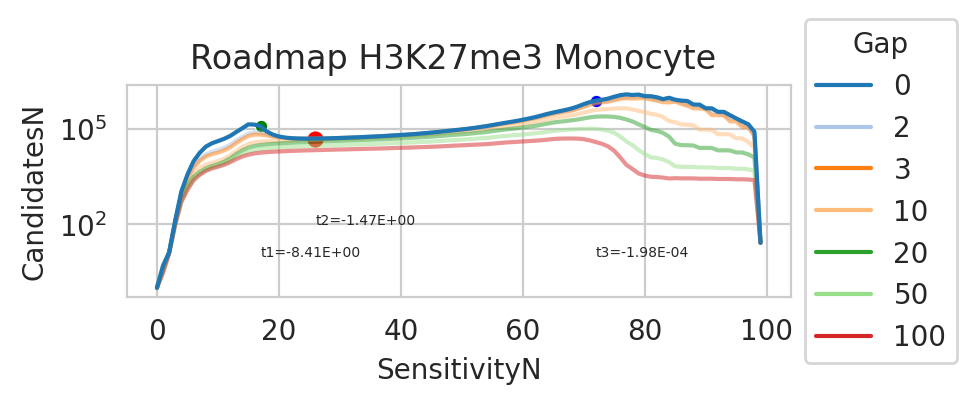

CandidatesAL


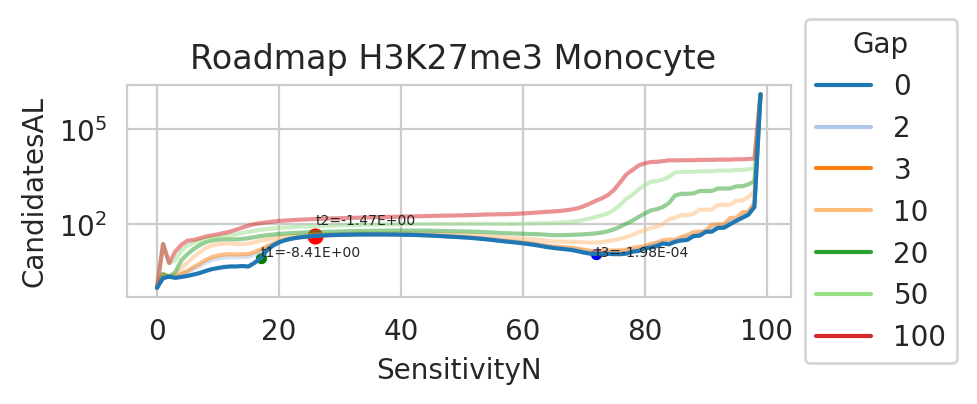

CandidatesML


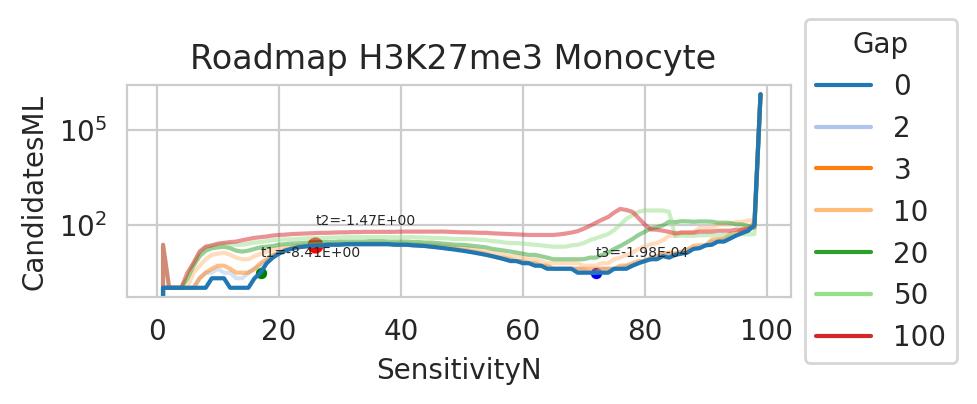

SignalNoiseRatio


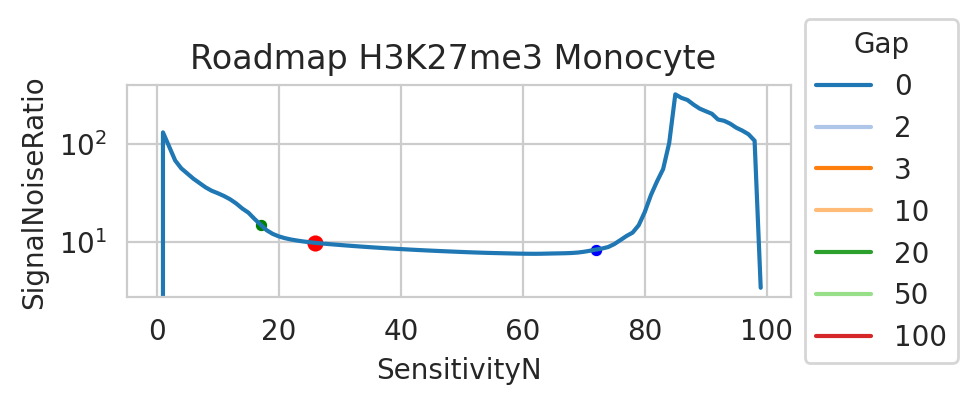

SignalControlRatio


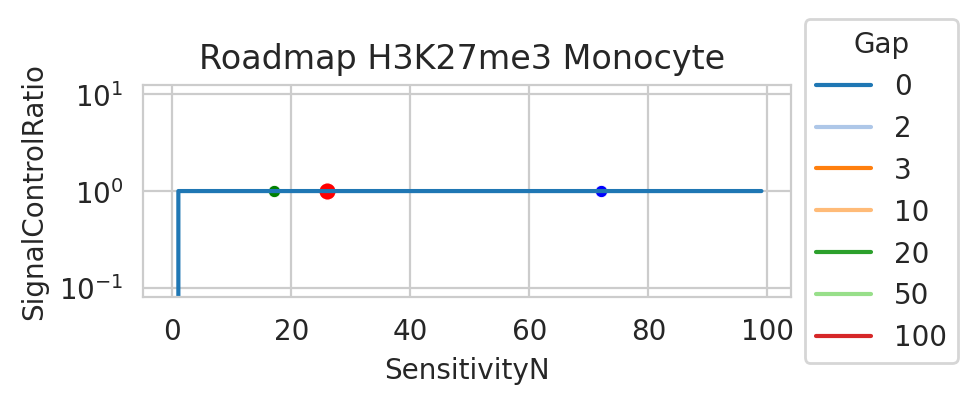

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (78, 35.352431299726035)
Checking I 11 I1mab (-1, 0) I3mab (78, 32.24098966792111)
Checking I 12 I1mab (-1, 0) I3mab (78, 29.783234228228068)
Checking I 13 I1mab (-1, 0) I3mab (78, 27.1269311360836)
Checking I 14 I1mab (-1, 0) I3mab (79, 24.98154396630693)
Checking I 15 I1mab (-1, 0) I3mab (79, 22.54780493660877)
Checking I 16 I1mab (-1, 0) I3mab (79, 19.953366835787875)
Checking I 17 I1mab (16, 0.15508066766943063) I3mab (79, 17.76107678420344)
Checking I 18 I1mab (16, 0.20322178847753292) I3mab (79, 15.986844280906652)
Checking I 19 I1mab (16, 0.5247827592443173) I3mab (79, 14.60857001193871)
Checking I 20 I1mab (16, 1.3971753346373594) I3mab (79, 13.64536185989165)
Checking I 21 I1mab (16, 2.346061004890799) I3mab (79, 12.891525726332816)
Checking I 22 I1mab (16, 3.2935212969670857) I3mab (79, 12.26640176613661)
Checking I 23 I1mab (18, 4.077064740175094) I3mab (79, 11.716574860380462)
Checking I 24 I1mab (18, 4.7585289540248725)

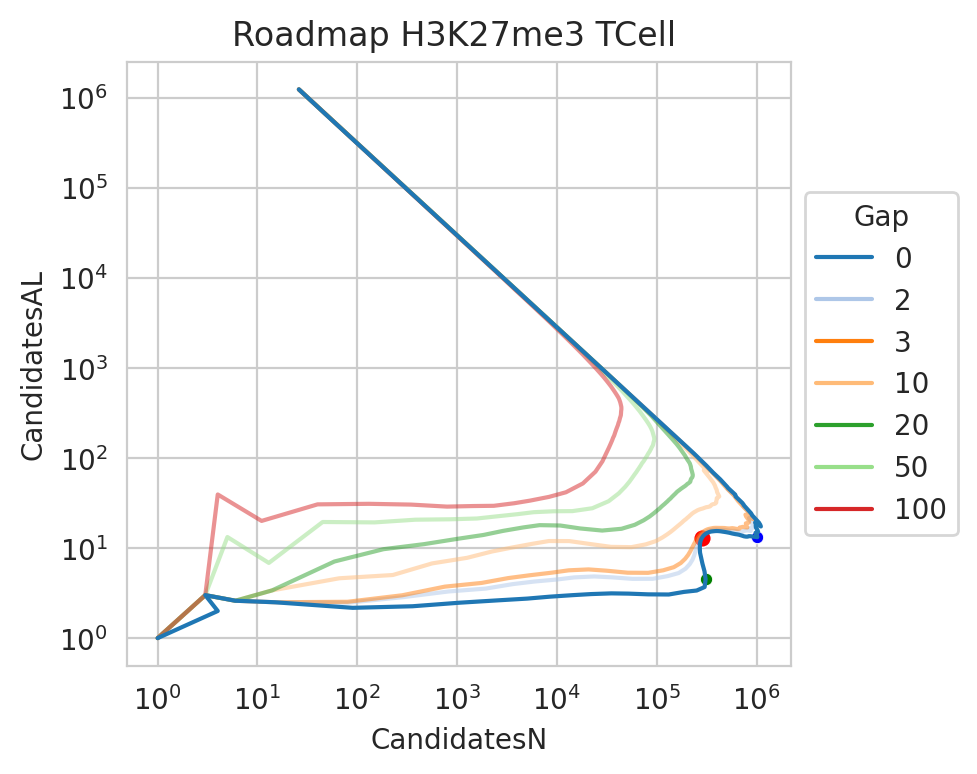

CandidatesN


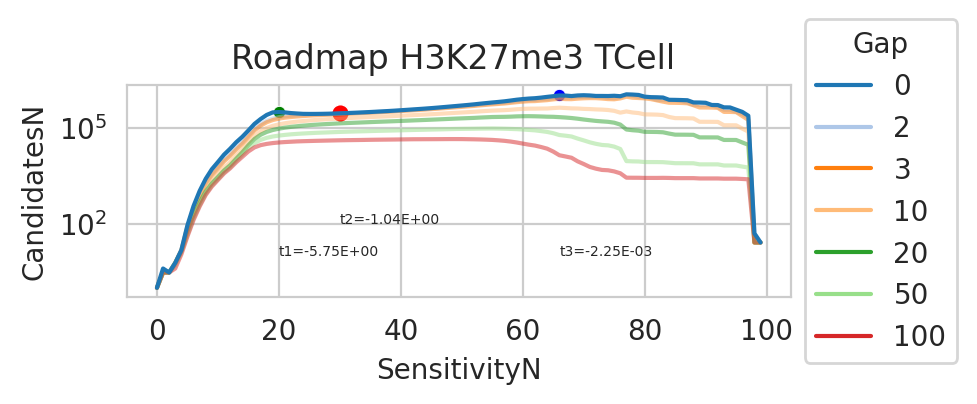

CandidatesAL


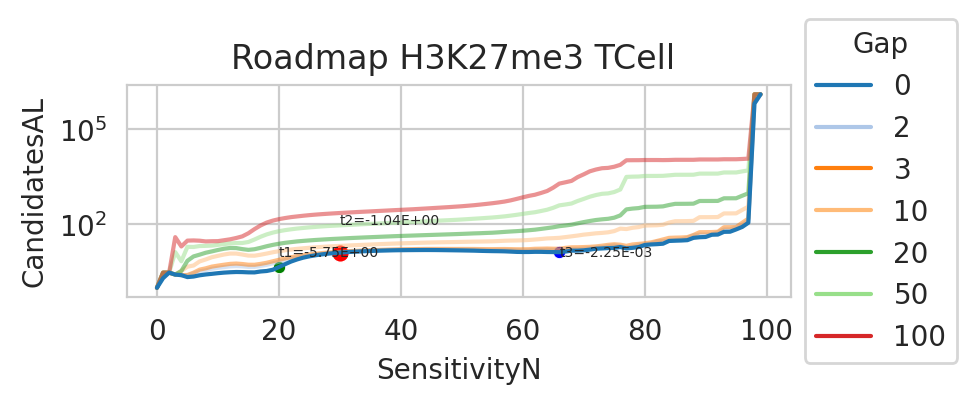

CandidatesML


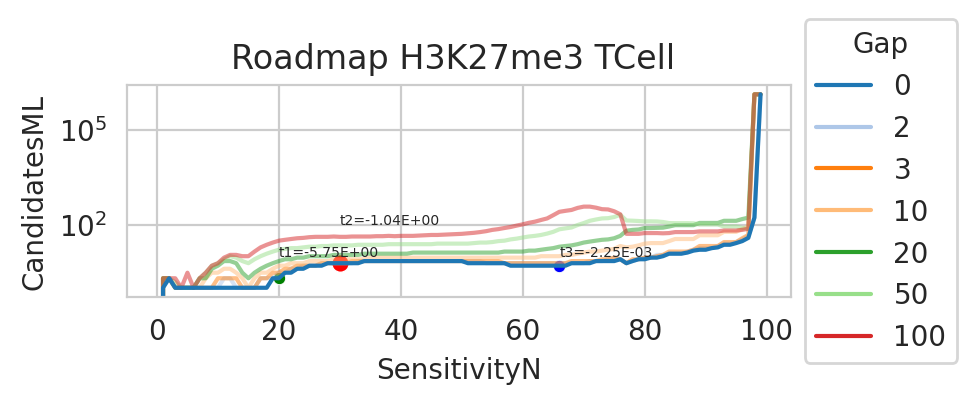

SignalNoiseRatio


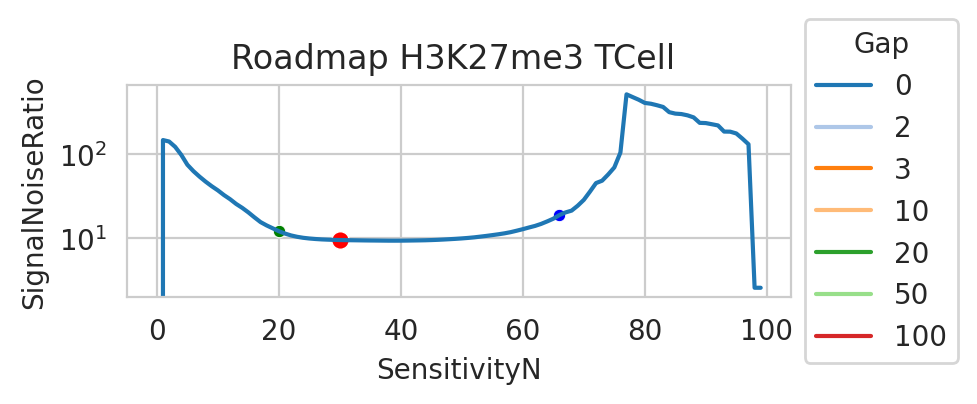

SignalControlRatio


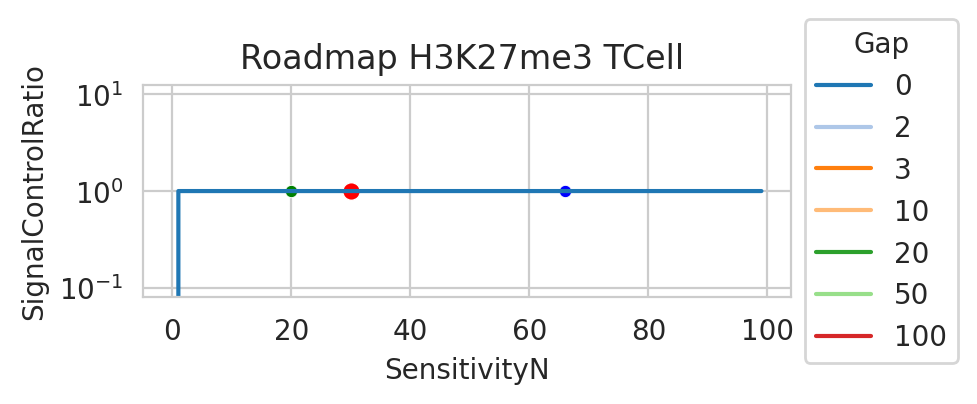

In [18]:
for (m, c, r, ds) in [
    ('CTCF', 'H1', '', 'CTCF'),
    # ('ATAC', 'Blood_Monocyte', 'SRR5799491', 'Immgen'),
    # ('ATAC', 'Blood_Monocyte', 'SRR5799492', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799444', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799445', 'Immgen'),
    # ('H3K4me1', 'CD34', '', 'Roadmap'),
    # ('H3K4me1', 'CD34', 'rep2', 'Roadmap'),
    # ('H3K4me3', 'CD4', '', 'Roadmap'),
    # ('H3K4me3', 'CD34', 'rep2', 'Roadmap'),
    ('H3K4me3', 'K562', 'rep1', 'ENCODE'),
    ('H3K27ac', 'K562', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep2', 'ENCODE'),
    # ('H3K27me3', 'NHLF', 'rep1', 'ENCODE'),
    ('H3K27me3', 'CD4', '', 'Roadmap'),
    # ('H3K27me3', 'CD4', 'rep2', 'Roadmap'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K27me3', 'BCell', '', 'Roadmap'),
    # ('H3K27me3', 'PBMC', '', 'Roadmap'),
    ('H3K27me3', 'TCell', '', 'Roadmap'),
    # ('H3K27me3', 'H1', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep2', 'ENCODE'),
    # ('H3K36me3', 'CD4', '', 'Roadmap'),
    # ('H3K36me3', 'CD4', 'rep1', 'Roadmap'),
    # ('H3K36me3', 'GM12878', 'rep1', 'ENCODE'),
    # ('H3K36me3', 'CD4', '', 'Roadmap'),
    # ('H3K36me3', 'CD34', '', 'Roadmap'),
    # ('H3K36me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K36me3', 'BCell', '', 'Roadmap'),
    # ('H3K36me3', 'TCell', '', 'Roadmap'),
    # ('H3K36me3', 'PBMC', '', 'Roadmap'),
]:
    t = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                         (full_sensitivity['modification'] == m) &
                         (full_sensitivity['cell'] == c) &
                         (full_sensitivity['replicate'] == r)].copy().reset_index(drop=True)
    if len(t) == 0:
        continue
    name = f'{ds} {m} {c} {r}'
    # plot_sensitivity(t, name, 'CandidatesAL', 'CandidatesML', logx=True, logy=True)
    # plot_sensitivity(t, name, 'CandidatesN', 'SignalNoiseRatio', logx=True, logy=False)
    # plot_sensitivity(t, name, 'CandidatesN', 'SignalControlRatio', logx=True, logy=False)
    # plot_sensitivity(t, name, 'SignalControlRatio', 'SignalNoiseRatio', logx=False, logy=False)
    sp = plot_sensitivity(t, name)
    plot_projections(t, name, sp)

Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 1.1088301805503984) I3mab (84, 25.075726617915592)
Checking I 11 I1mab (6, 1.3079981467342843) I3mab (84, 23.88659368636202)
Checking I 12 I1mab (6, 1.3904915922141705) I3mab (84, 22.576585791983163)
Checking I 13 I1mab (6, 1.3138781809601587) I3mab (84, 21.019474057405517)
Checking I 14 I1mab (6, 1.3327401232982208) I3mab (84, 19.4207426398373)
Checking I 15 I1mab (6, 1.124894511839208) I3mab (84, 18.045326458233248)
Checking I 16 I1mab (6, 2.0933812134833523) I3mab (84, 16.954576783248157)
Checking I 17 I1mab (7, 3.3729006276737445) I3mab (84, 16.08379645333838)
Checking I 18 I1mab (15, 5.962384281723331) I3mab (84, 15.489120395574673)
Checking I 19 I1mab (15, 7.973868479832835) I3mab (84, 14.936529021203299)
Checking I 20 I1mab (15, 9.321588637863565) I3mab (84, 14.482895928977271)
Checking I 21 I1mab (15, 10.207441894070683) I3mab (84, 14.11074813266346)
Checking I 22 I1mab (15, 10.809903429305798) I3mab (84, 13.80026857412605)
Checking I

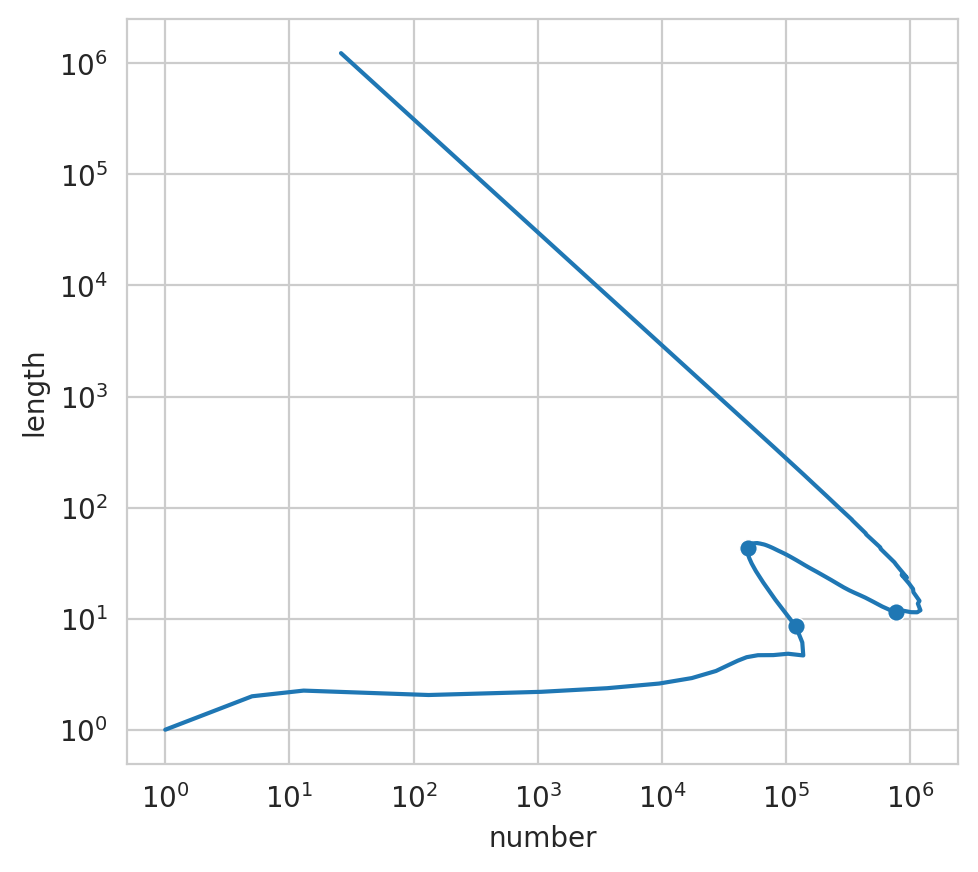

In [19]:
for (m, c, r, ds) in [
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
]:
    t = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                         (full_sensitivity['modification'] == m) &
                         (full_sensitivity['cell'] == c) &
                         (full_sensitivity['replicate'] == r) &
                         (full_sensitivity['Gap'] == 0)].copy().reset_index(drop=True)
    name = f'{ds} {m} {c} {r}'
    # plot_sensitivity(t, name, 'CandidatesAL', 'CandidatesML', logx=True, logy=True)
    # plot_sensitivity(t, name, 'CandidatesN', 'SignalNoiseRatio', logx=True, logy=False)
    # plot_sensitivity(t, name, 'CandidatesN', 'SignalControlRatio', logx=True, logy=False)
    # plot_sensitivity(t, name, 'SignalControlRatio', 'SignalNoiseRatio', logx=False, logy=False)
    # plt.figure(figsize=(1.75, 1.5))
    plt.figure(figsize=(5, 4.5))
    ax = plt.axes()
    sns.lineplot(data=t, x='CandidatesN', y='CandidatesAL', sort=False, ax=ax)

    sp = detect_sensitivity_triangle(t)
    sns.scatterplot(data=t[t.index.isin([sp[0], sp[1], sp[2]])],
                    x='CandidatesN', y='CandidatesAL', s=40,
                    legend=False, ax=ax)
    ax.set(xscale='log')
    ax.set(yscale='log')
    ax.set_xlabel('number')
    ax.set_ylabel('length')
    plt.tight_layout()
    plt.show()

## Per modification

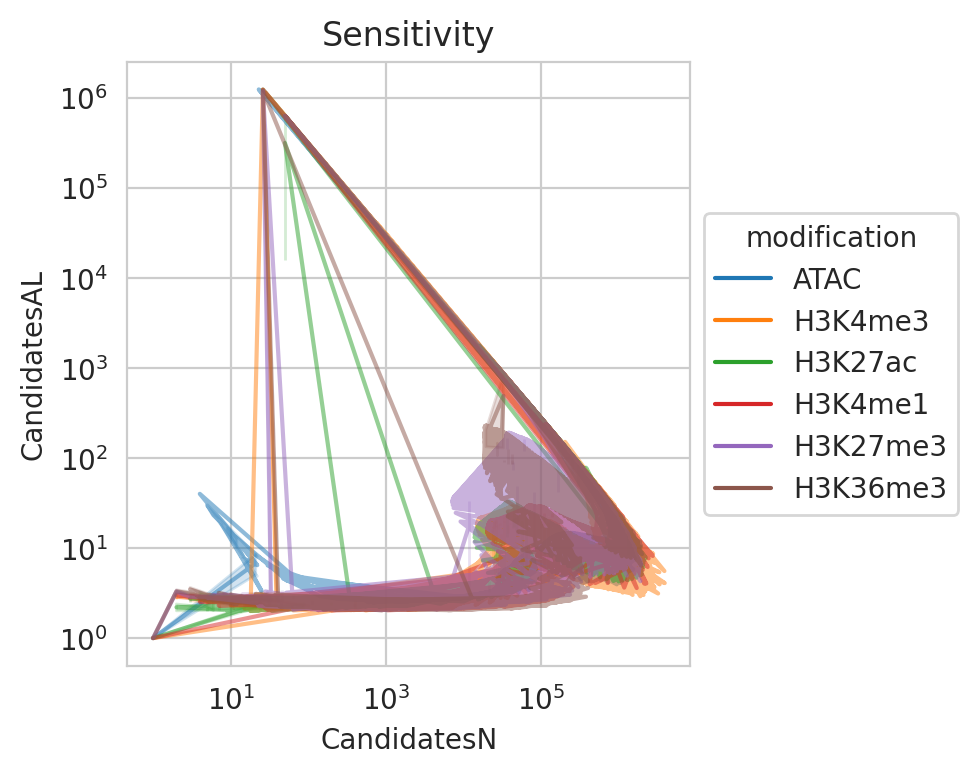

In [20]:
dfg = full_sensitivity[(full_sensitivity['Gap'] == 0)].copy()
dfg.sort_values(by=['Sensitivity', 'dataset', 'modification', 'cell', 'replicate'], inplace=True)
plt.figure(figsize=(5, 4))
ax = plt.axes()
tt = t
sns.lineplot(data=dfg, x='CandidatesN', y='CandidatesAL',
             hue='modification',
             hue_order=['ATAC'] + MODIFICATIONS,
             sort=False,
             # estimator=None,
             errorbar=('se', .95),
             alpha=0.5,
             ax=ax)
ax.set(xscale='log')
ax.set(yscale='log')
ax.set_title('Sensitivity')
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

In [21]:
# dfg = full_sensitivity[full_sensitivity['Gap'] == 0]
# for y in ['CandidatesN', 'CandidatesAL', 'SignalNoiseRatio', 'SignalControlRatio']:
#     print(y)
#     plt.figure(figsize=(8, 2))
#     ax = plt.axes()
#     sns.lineplot(data=dfg, x='Sensitivity', y=y, hue='modification',
#                  hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
#                  alpha=0.5,
#                  sort=False,
#                  errorbar=('se', .95),
#                  ax=ax)
#     ax.set(xscale='log')
#     ax.set(yscale='log')
#     ax.invert_xaxis()
#     ax.set_title(y)
#     sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
#     plt.tight_layout()
#     plt.show()

In [22]:
# plt.rc('font', size=5)
# dfg = full_sensitivity[full_sensitivity['Gap'] == 0]
# for y in ['CandidatesN', 'CandidatesAL', 'SignalNoiseRatio', 'SignalControlRatio']:
#     print(y)
#     plt.figure(figsize=(3, 6))
#     axs = [plt.subplot(7, 1, i + 1) for i in range(7)]
#     for i, m in enumerate(['CTCF', 'ATAC'] + MODIFICATIONS):
#         ax = axs[i]
#         sns.lineplot(data=dfg[dfg['modification'] == m], x='Sensitivity', y=y, hue='dataset',
#                      alpha=0.5,
#                      sort=False,
#                      errorbar=('se', .95),
#                      ax=ax)
#         ax.set(xscale='log')
#         ax.set(yscale='log')
#         ax.invert_xaxis()
#         ax.set_title(f'{m} {y}')
#         sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
#     plt.tight_layout()
#     plt.show()
# plt.rc('font', size=8)

## Individual

In [23]:
# import plotly.express as px
#
# full_sensitivity['experiment'] = full_sensitivity['dataset'] + ' ' + full_sensitivity['cell'] + ' ' + full_sensitivity['replicate']
# for m in ['ATAC'] + MODIFICATIONS:
#     dfm = full_sensitivity[(full_sensitivity['modification'] == m) &
#                            (full_sensitivity['Gap'] == 0)]
#     if len(dfm) == 0:
#         continue
#     fig = px.line(dfm, x='CandidatesN', y='CandidatesAL', color='experiment',
#                   hover_data=['experiment', 'Sensitivity', 'CandidatesN', 'CandidatesAL'],
#                   log_x=True, log_y=True,
#                   title=f'{m}',
#                   width=800, height=600)
#     fig.show()

In [24]:
# import plotly.express as px
#
# full_sensitivity['experiment'] = full_sensitivity['dataset'] + ' ' + full_sensitivity['cell'] + ' ' + full_sensitivity['replicate']
# plt.rc('font', size=4)
# for y in ['CandidatesN', 'CandidatesAL', 'SignalNoiseRatio']:
#     print(y)
#     for m in ['ATAC'] + MODIFICATIONS:
#         dfm = full_sensitivity[(full_sensitivity['modification'] == m) &
#                                (full_sensitivity['Gap'] == 0)]
#         if len(dfm) == 0:
#             continue
#         fig = px.line(dfm, x='Sensitivity', y=y, color='experiment',
#                       hover_data=['experiment', 'Sensitivity', y],
#                       log_x=True, log_y=True,
#                       title=f'{m} {y}',
#                       width=1000, height=400)
#         fig['layout']['xaxis']['autorange'] = "reversed"
#         fig.show()
# plt.rc('font', size=8)

# Triangles

In [25]:
sps = {}
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) & (full_sensitivity['modification'] == m)]
        for i, ((cell, rep), t) in enumerate(dfdsm.groupby(['cell', 'replicate'])):
            tt = t[t['Gap'] == 0].sort_values(by=['Sensitivity']).copy().reset_index(drop=True)
            sp = detect_sensitivity_triangle(tt)
            name = f'{ds} {m} {cell} {rep}'
            sps[name] = sp

ENCODE CTCF
Roadmap CTCF
Immgen CTCF
CTCF CTCF
Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 0.16309876707091092) I3mab (85, 30.58563233121062)
Checking I 11 I1mab (6, 0.21797731524624797) I3mab (85, 29.770857656693792)
Checking I 12 I1mab (6, 0.26993606322015756) I3mab (85, 29.078286006597466)
Checking I 13 I1mab (6, 0.3161789856893966) I3mab (85, 28.47949290574995)
Checking I 14 I1mab (6, 0.3634498725316765) I3mab (85, 27.8839960529086)
Checking I 15 I1mab (6, 0.4060117445228733) I3mab (85, 27.392399876490103)
Checking I 16 I1mab (6, 0.4507406667989974) I3mab (85, 26.897267771610927)
Checking I 17 I1mab (6, 0.4884831601733928) I3mab (85, 26.44360145077863)
Checking I 18 I1mab (6, 0.5271320859379254) I3mab (85, 26.020707198537096)
Checking I 19 I1mab (6, 0.5701644588362507) I3mab (87, 25.597102493116395)
Checking I 20 I1mab (6, 0.6156419930103916) I3mab (87, 25.171659642009672)
Checking I 21 I1mab (6, 0.6443859441689989) I3mab (87, 24.839242915824883)
Checking I 22 I1mab (6, 0.687308422

## All

ENCODE CTCF
0


<Figure size 100x300 with 0 Axes>

Roadmap CTCF
0


<Figure size 100x300 with 0 Axes>

Immgen CTCF
0


<Figure size 100x300 with 0 Axes>

CTCF CTCF
1
Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 0.16309876707091092) I3mab (85, 30.58563233121062)
Checking I 11 I1mab (6, 0.21797731524624797) I3mab (85, 29.770857656693792)
Checking I 12 I1mab (6, 0.26993606322015756) I3mab (85, 29.078286006597466)
Checking I 13 I1mab (6, 0.3161789856893966) I3mab (85, 28.47949290574995)
Checking I 14 I1mab (6, 0.3634498725316765) I3mab (85, 27.8839960529086)
Checking I 15 I1mab (6, 0.4060117445228733) I3mab (85, 27.392399876490103)
Checking I 16 I1mab (6, 0.4507406667989974) I3mab (85, 26.897267771610927)
Checking I 17 I1mab (6, 0.4884831601733928) I3mab (85, 26.44360145077863)
Checking I 18 I1mab (6, 0.5271320859379254) I3mab (85, 26.020707198537096)
Checking I 19 I1mab (6, 0.5701644588362507) I3mab (87, 25.597102493116395)
Checking I 20 I1mab (6, 0.6156419930103916) I3mab (87, 25.171659642009672)
Checking I 21 I1mab (6, 0.6443859441689989) I3mab (87, 24.839242915824883)
Checking I 22 I1mab (6, 0.6873084229080788) I3mab (87, 24.474312177655

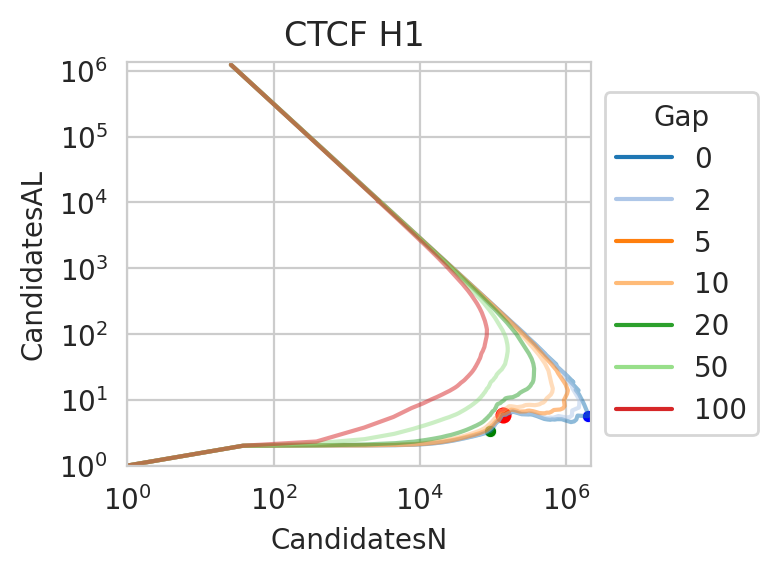

ENCODE ATAC
0


<Figure size 100x300 with 0 Axes>

Roadmap ATAC
0


<Figure size 100x300 with 0 Axes>

Immgen ATAC
8
Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (77, 37.95908376047047)
Checking I 11 I1mab (-1, 0) I3mab (77, 35.61108903479973)
Checking I 12 I1mab (-1, 0) I3mab (77, 33.69774924502239)
Checking I 13 I1mab (-1, 0) I3mab (77, 31.913231038479992)
Checking I 14 I1mab (-1, 0) I3mab (77, 30.5131106685658)
Checking I 15 I1mab (-1, 0) I3mab (77, 29.14355212651104)
Checking I 16 I1mab (-1, 0) I3mab (77, 28.11209514819221)
Checking I 17 I1mab (16, 0.013564995254766343) I3mab (77, 27.098344101608532)
Checking I 18 I1mab (16, 0.06108892578568248) I3mab (77, 26.14227387270067)
Checking I 19 I1mab (16, 0.16342184915907232) I3mab (77, 25.371293118654123)
Checking I 20 I1mab (16, 0.21716642804601205) I3mab (77, 24.65047104477516)
Checking I 21 I1mab (16, 0.3020403565298475) I3mab (77, 24.02367146112347)
Checking I 22 I1mab (16, 0.4419787530151703) I3mab (77, 23.462017678235497)
Checking I 23 I1mab (16, 0.6541177374561017) I3mab (77, 22.979696407499205)
Checking I 24 I1mab (17, 0

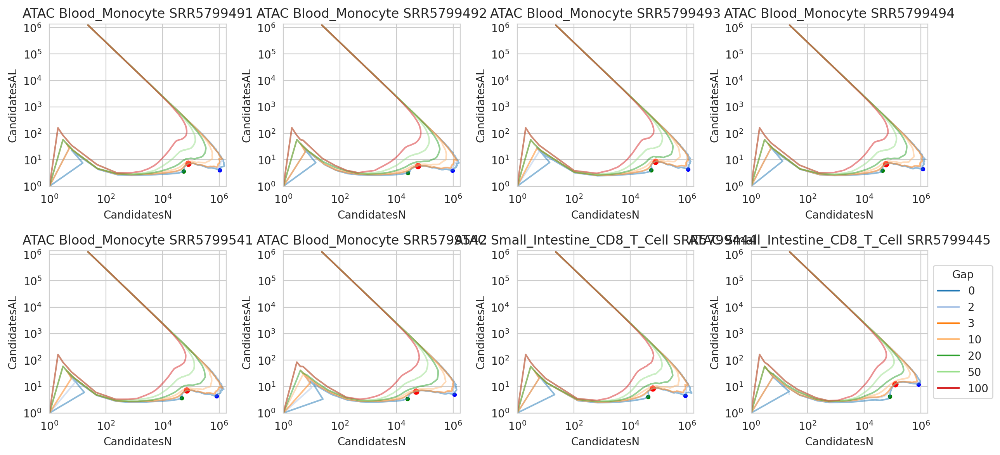

CTCF ATAC
0


<Figure size 100x300 with 0 Axes>

ENCODE H3K4me3
16
Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (82, 51.80210409535944)
Checking I 11 I1mab (-1, 0) I3mab (82, 45.51926677693079)
Checking I 12 I1mab (-1, 0) I3mab (82, 37.337012468213274)
Checking I 13 I1mab (12, 0.030522137204755717) I3mab (90, 32.89340110637728)
Checking I 14 I1mab (12, 0.0556569524900592) I3mab (90, 30.633010841168556)
Checking I 15 I1mab (12, 0.2762427326484086) I3mab (90, 27.14317454485912)
Checking I 16 I1mab (12, 0.3865801384056051) I3mab (90, 25.27187734183113)
Checking I 17 I1mab (13, 0.5476882810734915) I3mab (90, 23.528889609934325)
Checking I 18 I1mab (14, 1.6059135588440148) I3mab (90, 21.96877464711787)
Checking I 19 I1mab (14, 2.3752903297991663) I3mab (90, 20.792345561517195)
Checking I 20 I1mab (14, 3.5485571910226192) I3mab (90, 19.99026208672295)
Checking I 21 I1mab (16, 5.340715427713366) I3mab (90, 19.49717459441267)
Checking I 22 I1mab (17, 7.111128488215755) I3mab (90, 19.11628476401897)
Checking I 23 I1mab (17, 8.0342238

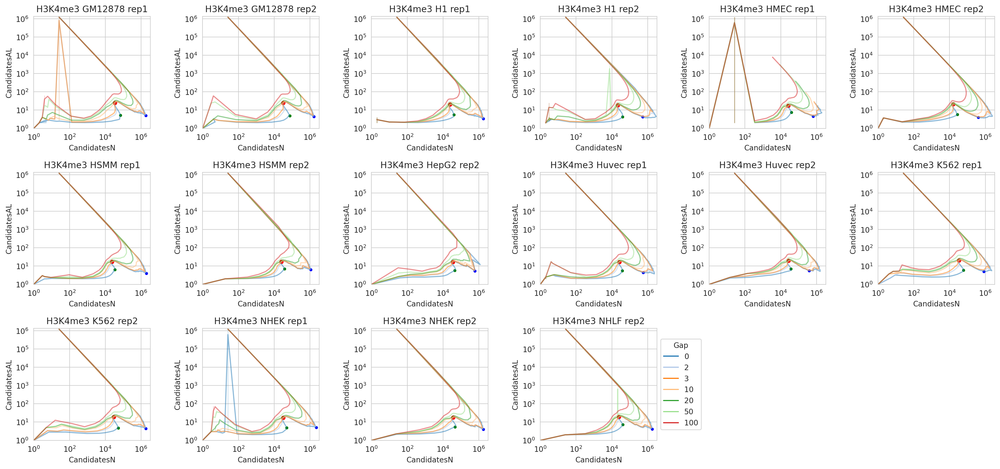

Roadmap H3K4me3
12
Limit Im1 10 Im2 90
Checking I 10 I1mab (3, 1.4504610329384657) I3mab (87, 29.81790778995905)
Checking I 11 I1mab (3, 1.6180268337135515) I3mab (87, 29.174551426453945)
Checking I 12 I1mab (3, 1.761657616568273) I3mab (87, 28.62551875836536)
Checking I 13 I1mab (3, 1.9243273766632978) I3mab (87, 28.069030288773618)
Checking I 14 I1mab (3, 2.0536698719215076) I3mab (87, 27.60096184237146)
Checking I 15 I1mab (3, 2.22860488981878) I3mab (87, 27.160563293830364)
Checking I 16 I1mab (3, 2.346962555030041) I3mab (87, 26.7830623876753)
Checking I 17 I1mab (3, 2.509547907252808) I3mab (87, 26.431696395380584)
Checking I 18 I1mab (3, 2.729206278843657) I3mab (87, 26.124214201070373)
Checking I 19 I1mab (3, 2.8463438487463613) I3mab (87, 25.834335000446927)
Checking I 20 I1mab (4, 3.3526929819025377) I3mab (87, 25.647809895579314)
Checking I 21 I1mab (4, 3.957653521344312) I3mab (87, 25.503573150724733)
Checking I 22 I1mab (4, 4.520082453117335) I3mab (87, 25.386063802497972)

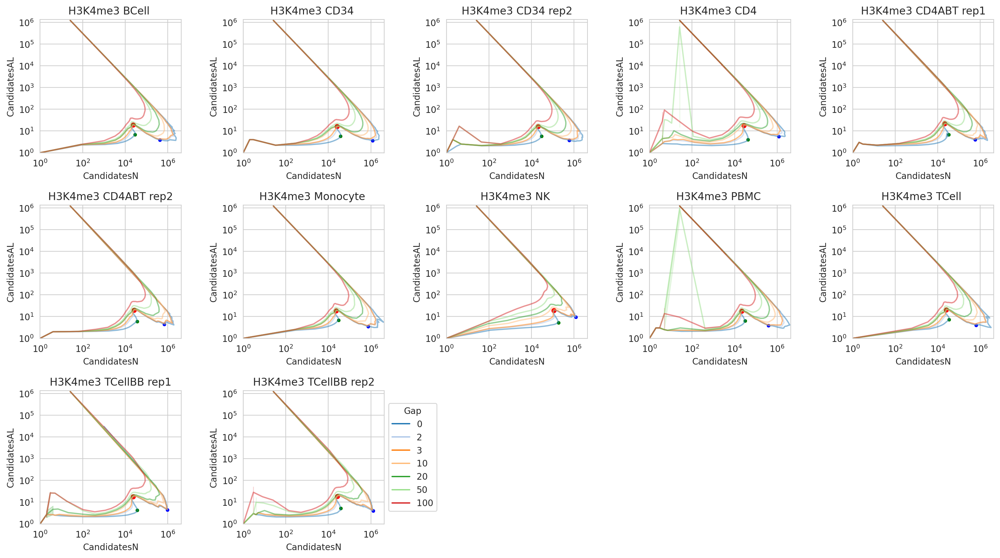

Immgen H3K4me3
0


<Figure size 100x300 with 0 Axes>

CTCF H3K4me3
0


<Figure size 100x300 with 0 Axes>

ENCODE H3K27ac
17
Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 0.5012126842688723) I3mab (61, 21.762188864705436)
Checking I 11 I1mab (7, 0.8790533799366019) I3mab (61, 20.172315996624818)
Checking I 12 I1mab (7, 0.9564971981772222) I3mab (61, 18.898265586312732)
Checking I 13 I1mab (8, 2.684074722191683) I3mab (61, 18.142196249480875)
Checking I 14 I1mab (9, 5.172378967040256) I3mab (61, 17.72553050412246)
Checking I 15 I1mab (9, 6.881138587803461) I3mab (61, 17.334919127522454)
Checking I 16 I1mab (9, 7.636162557340468) I3mab (61, 16.97530161515064)
Checking I 17 I1mab (9, 8.00611198667027) I3mab (61, 16.675494327634382)
Checking I 18 I1mab (9, 8.24595867546774) I3mab (61, 16.41376976145824)
Checking I 19 I1mab (9, 8.40133566079589) I3mab (61, 16.184156993908303)
Checking I 20 I1mab (9, 8.551604939558095) I3mab (61, 15.969594404259198)
Checking I 21 I1mab (9, 8.667040694881717) I3mab (61, 15.774033706630803)
Checking I 22 I1mab (9, 8.767880022497518) I3mab (61, 15.584385124508529)
Che

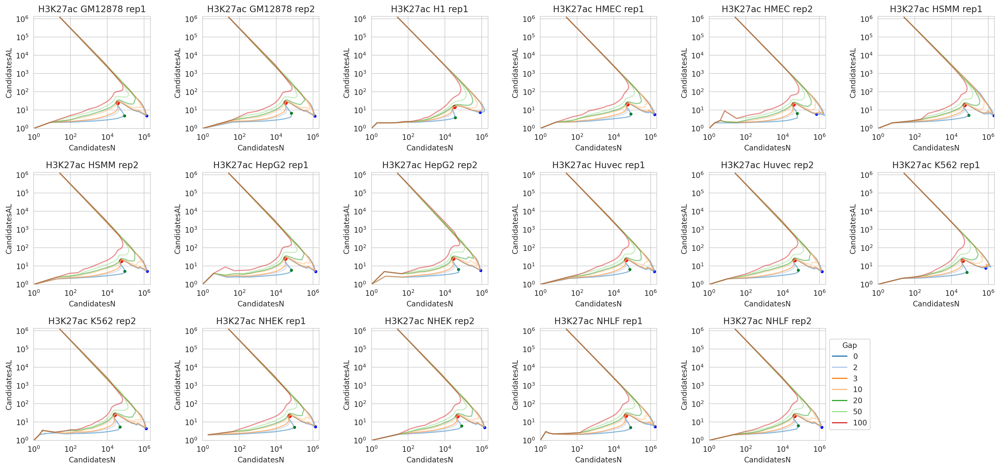

Roadmap H3K27ac
9
Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 0.0507869588558858) I3mab (90, 32.41599551681108)
Checking I 11 I1mab (6, 0.09758214454422887) I3mab (90, 31.058152721102473)
Checking I 12 I1mab (6, 0.15600726903418471) I3mab (90, 29.816593660115075)
Checking I 13 I1mab (6, 0.2018083336386609) I3mab (90, 28.71712173501571)
Checking I 14 I1mab (9, 0.25704830012091784) I3mab (90, 27.812560063962678)
Checking I 15 I1mab (9, 0.3181515612660566) I3mab (90, 26.817395120740912)
Checking I 16 I1mab (9, 0.38823884323240776) I3mab (90, 25.735891913275026)
Checking I 17 I1mab (9, 0.43292094555822913) I3mab (90, 24.88782791331458)
Checking I 18 I1mab (9, 0.5233018078027846) I3mab (90, 24.014038102803752)
Checking I 19 I1mab (9, 0.8011022459139602) I3mab (90, 23.252075327986375)
Checking I 20 I1mab (9, 0.8164565097290781) I3mab (90, 22.54308586422556)
Checking I 21 I1mab (9, 1.4642762903813613) I3mab (90, 22.04563793643642)
Checking I 22 I1mab (10, 2.2977596375550835) I3mab (90, 21.612

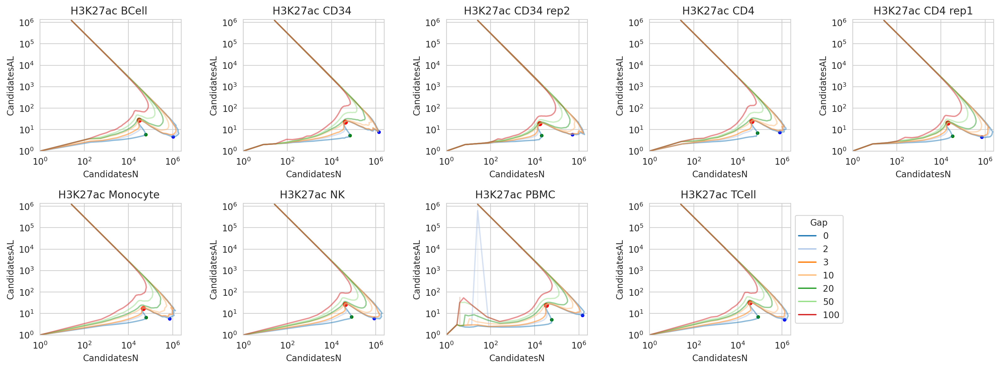

Immgen H3K27ac
0


<Figure size 100x300 with 0 Axes>

CTCF H3K27ac
0


<Figure size 100x300 with 0 Axes>

ENCODE H3K4me1
17
Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (60, 36.65832479571657)
Checking I 11 I1mab (-1, 0) I3mab (60, 30.955264591657226)
Checking I 12 I1mab (-1, 0) I3mab (64, 25.688179141225405)
Checking I 13 I1mab (12, 0.18157992506056186) I3mab (64, 21.23933291524486)
Checking I 14 I1mab (12, 0.9067453974001316) I3mab (69, 18.224988302993438)
Checking I 15 I1mab (12, 1.451940997351406) I3mab (69, 16.339007442995637)
Checking I 16 I1mab (12, 2.6550629786096867) I3mab (69, 15.230642240935794)
Checking I 17 I1mab (13, 5.687474060676701) I3mab (69, 14.730967419999658)
Checking I 18 I1mab (13, 7.54507914279626) I3mab (69, 14.215460556641204)
Checking I 19 I1mab (13, 8.55888976485112) I3mab (69, 13.760832968840717)
Checking I 20 I1mab (13, 9.135164926029177) I3mab (69, 13.385561221468677)
Checking I 21 I1mab (13, 9.519323678595093) I3mab (69, 13.06725484920706)
Checking I 22 I1mab (13, 9.801440180593262) I3mab (69, 12.789121830551323)
Checking I 23 I1mab (13, 10.01527309

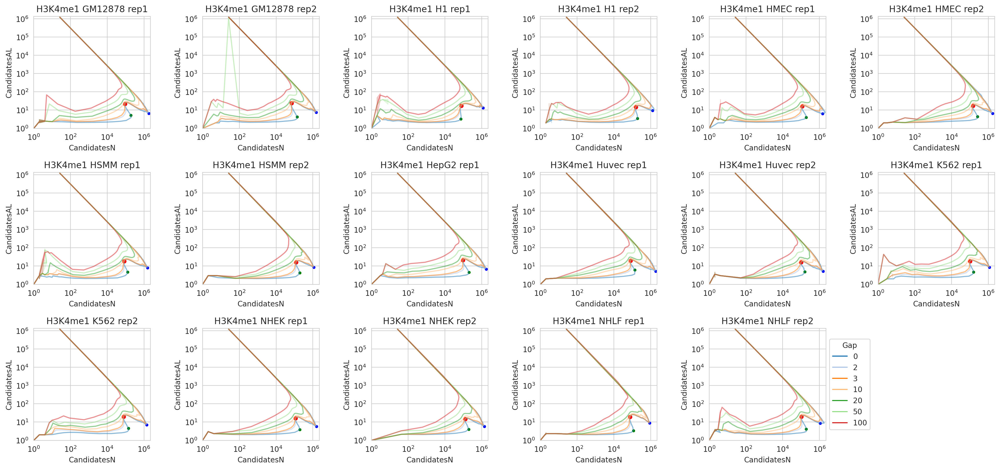

Roadmap H3K4me1
8
Limit Im1 10 Im2 90
Checking I 10 I1mab (9, 0.0473578267711372) I3mab (86, 25.12945680040123)
Checking I 11 I1mab (9, 0.10596999636041393) I3mab (86, 23.574594991881057)
Checking I 12 I1mab (9, 0.20707374399147904) I3mab (86, 22.061386763033596)
Checking I 13 I1mab (9, 0.3454834016526621) I3mab (86, 20.56793132737458)
Checking I 14 I1mab (9, 0.45074018987260256) I3mab (86, 19.547364991308186)
Checking I 15 I1mab (9, 0.7579478800978494) I3mab (86, 18.185490458559286)
Checking I 16 I1mab (9, 0.7619413265224002) I3mab (86, 17.497317725469998)
Checking I 17 I1mab (9, 1.0519632146619196) I3mab (86, 16.550884583896845)
Checking I 18 I1mab (9, 1.158451635584266) I3mab (86, 15.93499364398268)
Checking I 19 I1mab (10, 1.9617670353079673) I3mab (86, 15.386582699354108)
Checking I 20 I1mab (10, 2.415107578494712) I3mab (86, 14.903689220097007)
Checking I 21 I1mab (11, 3.1320684196635438) I3mab (86, 14.576643281305365)
Checking I 22 I1mab (11, 3.990413661060823) I3mab (86, 14.312

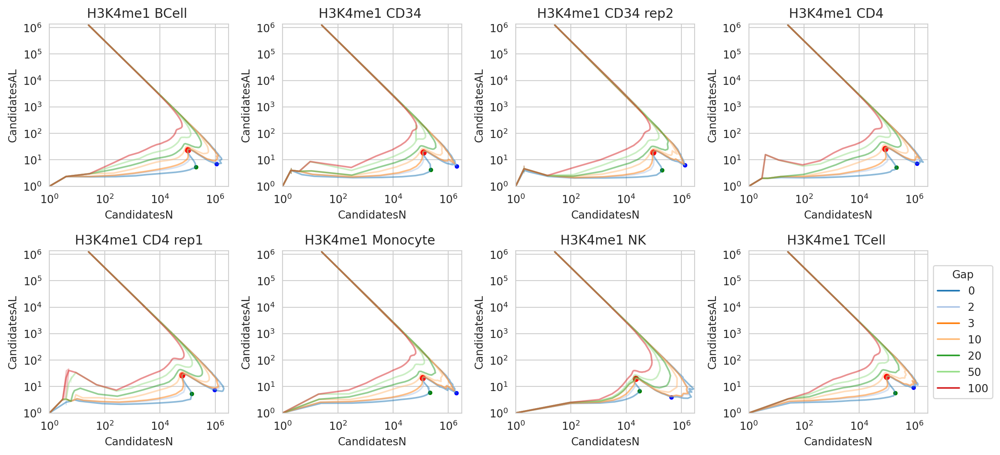

Immgen H3K4me1
0


<Figure size 100x300 with 0 Axes>

CTCF H3K4me1
0


<Figure size 100x300 with 0 Axes>

ENCODE H3K27me3
18
Limit Im1 10 Im2 90
Checking I 10 I1mab (9, 0.004485278710239626) I3mab (82, 57.47137029934407)
Checking I 11 I1mab (-1, 0) I3mab (82, 55.72125184579164)
Checking I 12 I1mab (-1, 0) I3mab (82, 54.55939246308686)
Checking I 13 I1mab (-1, 0) I3mab (82, 50.21938818039747)
Checking I 14 I1mab (-1, 0) I3mab (82, 41.31199664100781)
Checking I 15 I1mab (-1, 0) I3mab (82, 32.094951799733515)
Checking I 16 I1mab (15, 0.27235053922523) I3mab (82, 23.969365842436545)
Checking I 17 I1mab (15, 1.1829309701392199) I3mab (83, 17.481002514061984)
Checking I 18 I1mab (16, 3.775086833157336) I3mab (83, 13.014271009365828)
Checking I 19 I1mab (16, 7.187945236704918) I3mab (83, 10.30518189695492)
Checking I 20 I1mab (17, 10.122577904226985) I3mab (83, 8.758754159526887)
Checking I 21 I1mab (17, 12.465614303338816) I3mab (83, 7.821688681693814)
Checking I 22 I1mab (17, 14.08727974183576) I3mab (83, 7.197566022377714)
Checking I 23 I1mab (17, 15.230365858411822) I3mab (83, 6.7412220094305

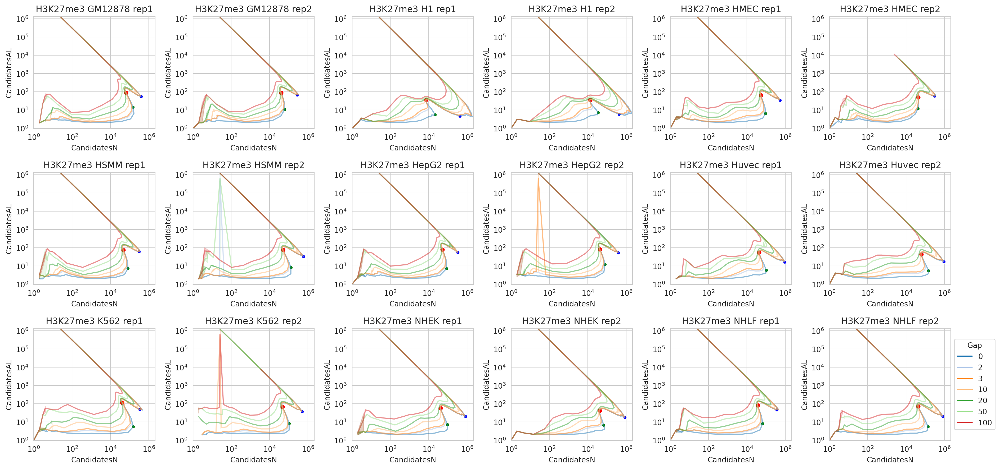

Roadmap H3K27me3
9
Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (71, 48.23940549693702)
Checking I 11 I1mab (-1, 0) I3mab (71, 43.54492302833408)
Checking I 12 I1mab (-1, 0) I3mab (71, 37.89593100432224)
Checking I 13 I1mab (-1, 0) I3mab (75, 35.12699073436724)
Checking I 14 I1mab (-1, 0) I3mab (75, 31.018649492912274)
Checking I 15 I1mab (-1, 0) I3mab (75, 28.14314542504286)
Checking I 16 I1mab (-1, 0) I3mab (75, 24.97818001513872)
Checking I 17 I1mab (-1, 0) I3mab (75, 21.6737953161348)
Checking I 18 I1mab (17, 0.14099535669402835) I3mab (75, 18.91297524746146)
Checking I 19 I1mab (17, 0.1364870442021039) I3mab (81, 16.08545272829724)
Checking I 20 I1mab (17, 0.9833827878648246) I3mab (81, 14.076136901026373)
Checking I 21 I1mab (19, 2.8872692832219435) I3mab (81, 12.659647879818351)
Checking I 22 I1mab (19, 5.163268176423511) I3mab (82, 11.576826856951598)
Checking I 23 I1mab (19, 7.004552540985167) I3mab (82, 10.714218552958002)
Checking I 24 I1mab (19, 8.4417889526278) I3

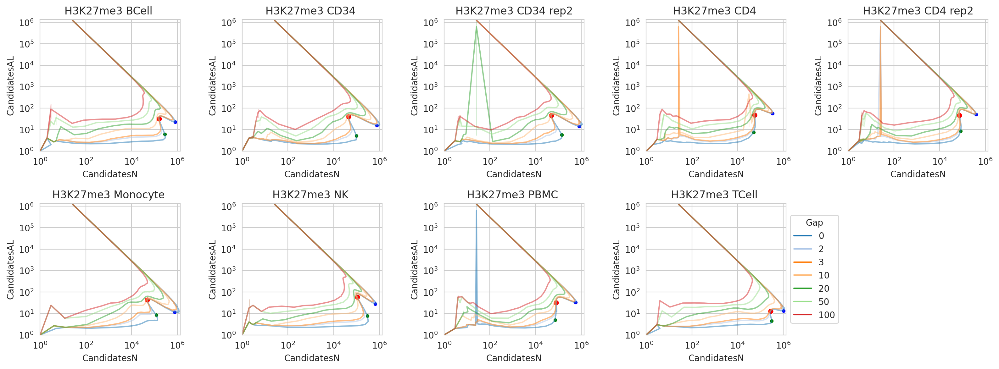

Immgen H3K27me3
0


<Figure size 100x300 with 0 Axes>

CTCF H3K27me3
0


<Figure size 100x300 with 0 Axes>

ENCODE H3K36me3
17
Limit Im1 10 Im2 90
Checking I 10 I1mab (8, 0.0034443056133747207) I3mab (87, 67.65878840006192)
Checking I 11 I1mab (-1, 0) I3mab (87, 66.20014711085881)
Checking I 12 I1mab (-1, 0) I3mab (87, 63.00821474115215)
Checking I 13 I1mab (-1, 0) I3mab (87, 50.35090705723254)
Checking I 14 I1mab (-1, 0) I3mab (87, 37.97885077983829)
Checking I 15 I1mab (-1, 0) I3mab (87, 27.406673556007675)
Checking I 16 I1mab (15, 0.34654313990573654) I3mab (89, 19.73628903138372)
Checking I 17 I1mab (15, 2.159904690717647) I3mab (89, 15.033641138961642)
Checking I 18 I1mab (16, 7.831370571887855) I3mab (89, 12.778091880536095)
Checking I 19 I1mab (16, 13.400209074893995) I3mab (89, 11.706141064391034)
Checking I 20 I1mab (16, 16.846346909845007) I3mab (89, 11.150134816087686)
Checking I 21 I1mab (16, 18.934431343177163) I3mab (89, 10.807639606072811)
Checking I 22 I1mab (16, 20.186567386994984) I3mab (89, 10.561718046436013)
Checking I 23 I1mab (16, 21.054436723266864) I3mab (89, 10.3732

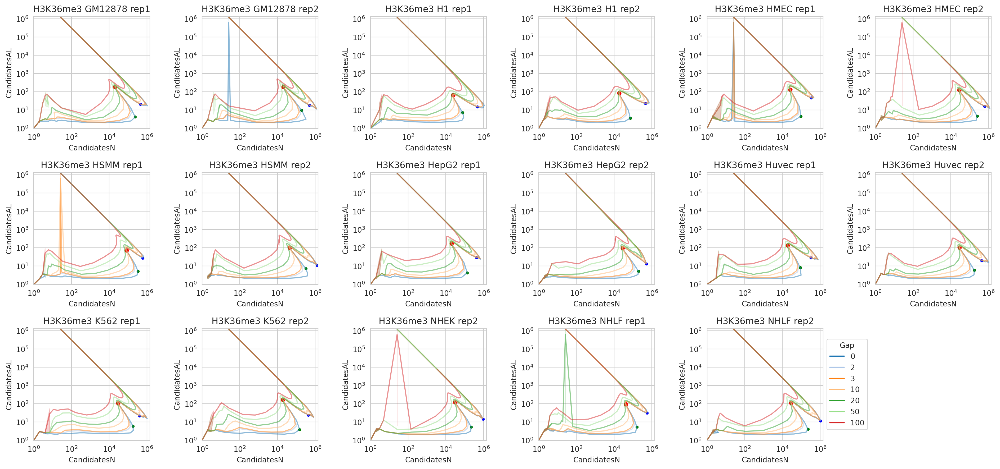

Roadmap H3K36me3
8
Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (85, 29.470350931499823)
Checking I 11 I1mab (-1, 0) I3mab (85, 24.45046884279735)
Checking I 12 I1mab (11, 0.10274784798875436) I3mab (85, 20.003744373891763)
Checking I 13 I1mab (11, 0.41563625527482134) I3mab (88, 16.271242944618237)
Checking I 14 I1mab (11, 1.1905081892192504) I3mab (88, 13.649900918777035)
Checking I 15 I1mab (12, 2.7017771974680995) I3mab (92, 12.401916426862869)
Checking I 16 I1mab (12, 4.847591016133335) I3mab (92, 11.490375784125334)
Checking I 17 I1mab (13, 8.526507677913543) I3mab (92, 11.101961281355699)
Checking I 18 I1mab (13, 12.309458313216371) I3mab (92, 10.827428539636585)
Checking I 19 I1mab (13, 14.87314690322414) I3mab (88, 10.599855849482765)
Checking I 20 I1mab (13, 16.536730442680383) I3mab (88, 10.42001770887859)
Checking I 21 I1mab (13, 17.57409231627891) I3mab (88, 10.274532420801762)
Checking I 22 I1mab (13, 18.300073121310298) I3mab (88, 10.15225247810666)
Checking I 2

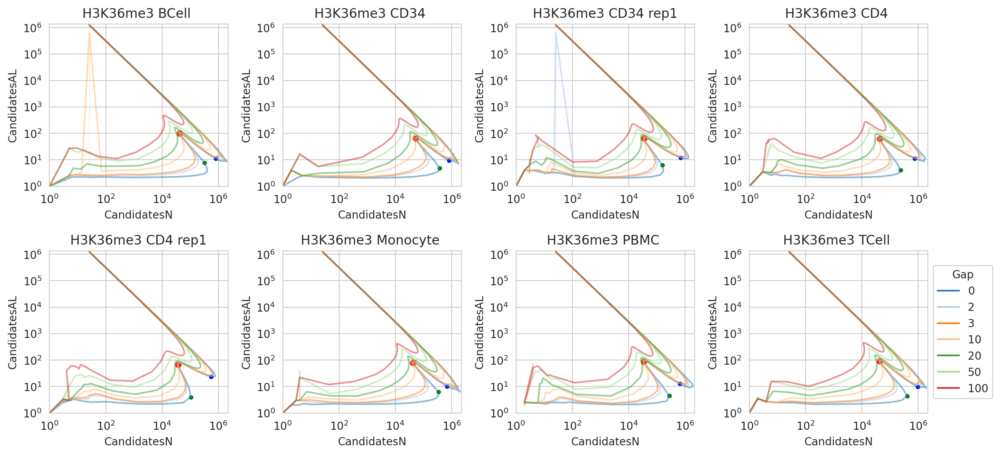

Immgen H3K36me3
0


<Figure size 100x300 with 0 Axes>

CTCF H3K36me3
0


<Figure size 100x300 with 0 Axes>

In [26]:
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) & (full_sensitivity['modification'] == m)]
        t = dfdsm
        minx, maxx = t['CandidatesN'].min(), t['CandidatesN'].max()
        minx, maxx = 1, maxx + (maxx - minx) * 0.1
        miny, maxy = t['CandidatesAL'].min(), t['CandidatesAL'].max()
        miny, maxy = 1, maxy + (maxy - miny) * 0.1
        n = min(len(dfdsm[['cell', 'replicate']].copy().drop_duplicates()), 18)
        print(n)
        if n <= 6:
            ncols, nrows = n, 1
        else:
            ncols = int(math.floor(math.sqrt(n) + 2))
            nrows = int(math.ceil(n / ncols))
        plt.figure(figsize=(3 * ncols + 1, 3 * nrows))
        axs = [plt.subplot(nrows, ncols, i + 1) for i in range(n)]
        for i, ((cell, rep), t) in enumerate(dfdsm.groupby(['cell', 'replicate'])):
            if i == 18:
                break
            tt = t
            ax = axs[i]
            sns.lineplot(data=tt, x="CandidatesN", y="CandidatesAL", hue='Gap',
                         palette='tab20',
                         sort=False,
                         alpha=0.5,
                         ax=ax)

            tt = t[t['Gap'] == 0].sort_values(by=['Sensitivity']).copy().reset_index(drop=True)
            sp = detect_sensitivity_triangle(tt)
            st = full_infos[(full_infos['dataset'] == ds) &
                            (full_infos['modification'] == m) &
                            (full_infos['cell'] == cell) &
                            (full_infos['replicate'] == rep)]
            name = f'{ds} {m} {cell} {rep}'
            sp = sps[name] if name in sps else None
            if sp is not None:
                sns.scatterplot(data=tt[tt.index.isin([sp[0],])],
                                x="CandidatesN", y="CandidatesAL", color='green', s=20,
                                legend=False, ax=ax)
                sns.scatterplot(data=tt[tt.index.isin([sp[1],])],
                                x="CandidatesN", y="CandidatesAL", color='red', s=40,
                                legend=False, ax=ax)
                sns.scatterplot(data=tt[tt.index.isin([sp[2],])],
                                x="CandidatesN", y="CandidatesAL", color='blue', s=20,
                                legend=False, ax=ax)
            ax.set(yscale='log')
            ax.set(xscale='log')
            ax.set_title(f'{m} {cell} {rep}')
            ax.set_xlim(minx, maxx)
            ax.set_ylim(miny, maxy)
            if i == n - 1:
                sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
            else:
                ax.legend().set_visible(False)
        plt.tight_layout()
        plt.show()


## Summary

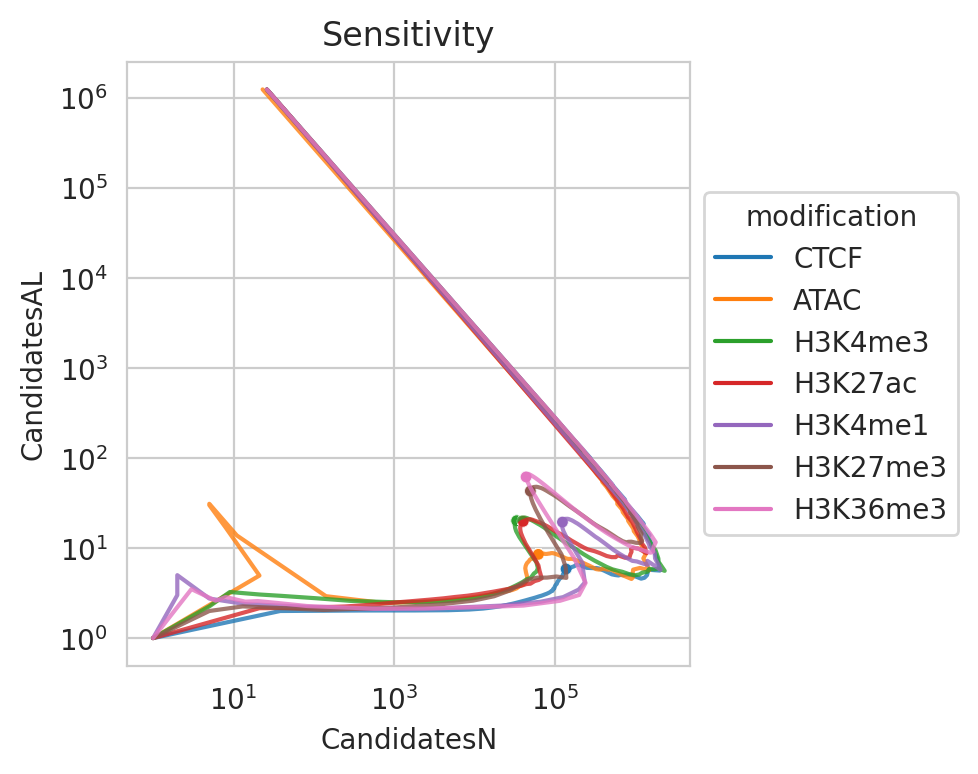

In [27]:
ts = []
for (m, c, r, ds) in [
    ('CTCF', 'H1', '', 'CTCF'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799444', 'Immgen'),
    ('H3K4me1', 'CD34', '', 'Roadmap'),
    ('H3K4me3', 'K562', 'rep1', 'ENCODE'),
    ('H3K27ac', 'K562', 'rep1', 'ENCODE'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    ('H3K36me3', 'CD4', '', 'Roadmap'),
]:
    t = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                         (full_sensitivity['modification'] == m) &
                         (full_sensitivity['cell'] == c) &
                         (full_sensitivity['replicate'] == r) &
                         (full_sensitivity['Gap'] == 0)].copy().reset_index(drop=True)
    name = f'{ds} {m} {c} {r}'
    sp = sps[name] if name in sps else None
    if sp is not None:
        t['S2CN'] = t[t.index == sp[1]]['CandidatesN'].values[0]
        t['S2CAL'] = t[t.index == sp[1]]['CandidatesAL'].values[0]
    ts.append(t)

t = pd.concat(ts).reset_index(drop=True)
plt.figure(figsize=(5, 4))
ax = plt.axes()
sns.lineplot(data=t, x='CandidatesN', y='CandidatesAL',
             hue='modification',
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             sort=False,
             estimator=None,
             alpha=0.8,
             ax=ax)

sns.scatterplot(data=t, x='S2CN', y='S2CAL',
             hue='modification',
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             alpha=0.8, size=10, legend=False,
             ax=ax)

ax.set(xscale='log')
ax.set(yscale='log')
ax.set_title('Sensitivity')
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

In [28]:
sensitivities = list(sorted(full_sensitivity['Sensitivity'].unique()))
ts = []
for (m, c, r, ds) in [
    ('CTCF', 'H1', '', 'CTCF'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799444', 'Immgen'),
    ('H3K4me1', 'CD34', '', 'Roadmap'),
    ('H3K4me3', 'K562', 'rep1', 'ENCODE'),
    ('H3K27ac', 'K562', 'rep1', 'ENCODE'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    ('H3K36me3', 'CD4', '', 'Roadmap'),
]:
    t = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                         (full_sensitivity['modification'] == m) &
                         (full_sensitivity['cell'] == c) &
                         (full_sensitivity['replicate'] == r) &
                         (full_sensitivity['Gap'] == 0)].copy().reset_index(drop=True)
    name = f'{ds} {m} {c} {r}'
    sp = sps[name] if name in sps else None
    t['S2N'] = sp[1]
    t['S2CN'] = t[t.index == sp[1]]['CandidatesN'].values[0]
    t['S2CAL'] = t[t.index == sp[1]]['CandidatesAL'].values[0]
    ts.append(t)
t = pd.concat(ts).reset_index(drop=True)
display(t.sample(10))


,Sensitivity,Gap,CandidatesN,CandidatesAL,CandidatesML,SignalNoiseRatio,SignalControlRatio,file,modification,cell,replicate,SensitivityN,dataset,S2N,S2CN,S2CAL
252,-0.000090,0,2040660,5.735633,1.0,2586.646488,1.0,/home/jetbrains/data/2023_Immune/span/CD34_H3K...,H3K4me1,CD34,,52,Roadmap,21,122701,19.419250
62,-0.019428,0,274588,6.000066,4.0,13.773452,0.0,/home/jetbrains/data/2024_TFs/span/H1_CTCF_hg3...,CTCF,H1,,62,CTCF,48,136089,5.853676
521,-3.876395,0,52683,31.388121,15.0,10.854434,1.0,/home/jetbrains/data/2023_Immune/span/Monocyte...,H3K27me3,Monocyte,,21,Roadmap,26,48954,42.961330
133,-0.923667,0,51525,7.621070,5.0,23.014241,0.0,/home/jetbrains/data/2024_Immgen/span/SRR57994...,ATAC,Small_Intestine_CD8_T_Cell,SRR5799444,33,Immgen,39,61554,8.507335
314,-36.309809,0,33284,3.884596,2.0,68.105164,1.0,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K4me3,K562,rep1,14,ENCODE,32,33111,20.128330
81,-0.000767,0,1768753,8.468595,5.0,7.980663,0.0,/home/jetbrains/data/2024_TFs/span/H1_CTCF_hg3...,CTCF,H1,,81,CTCF,48,136089,5.853676
233,-0.023054,0,160016,20.349492,12.0,23.247680,1.0,/home/jetbrains/data/2023_Immune/span/CD34_H3K...,H3K4me1,CD34,,33,Roadmap,21,122701,19.419250
245,-0.000695,0,630168,8.623928,2.0,25.905842,1.0,/home/jetbrains/data/2023_Immune/span/CD34_H3K...,H3K4me1,CD34,,45,Roadmap,21,122701,19.419250
213,-7.886987,0,220597,6.700570,3.0,27.374123,1.0,/home/jetbrains/data/2023_Immune/span/CD34_H3K...,H3K4me1,CD34,,13,Roadmap,21,122701,19.419250
26,-8.874164,0,85363,3.224995,2.0,57.754816,0.0,/home/jetbrains/data/2024_TFs/span/H1_CTCF_hg3...,CTCF,H1,,26,CTCF,48,136089,5.853676


CandidatesN


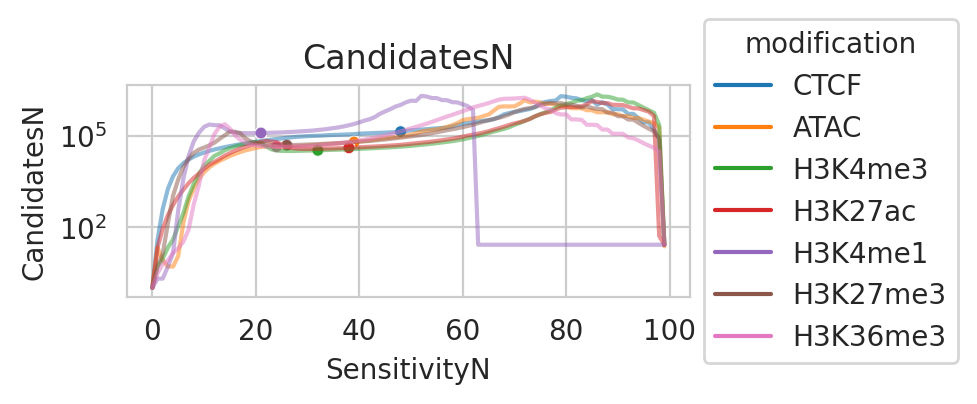

CandidatesAL


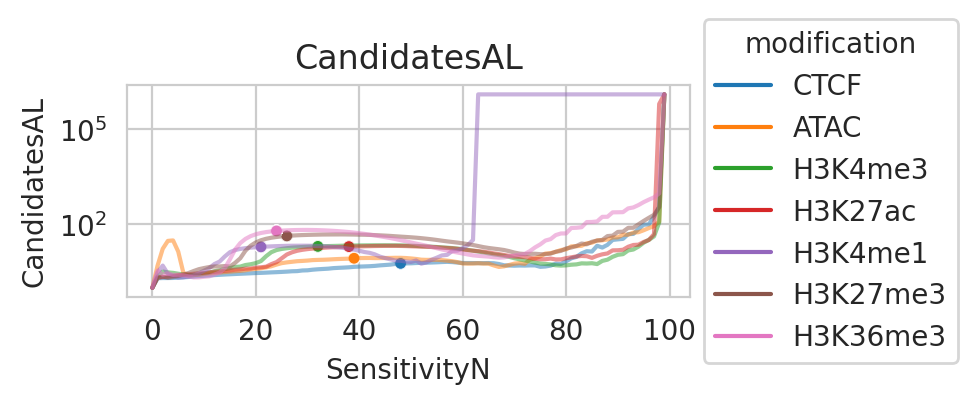

SignalNoiseRatio


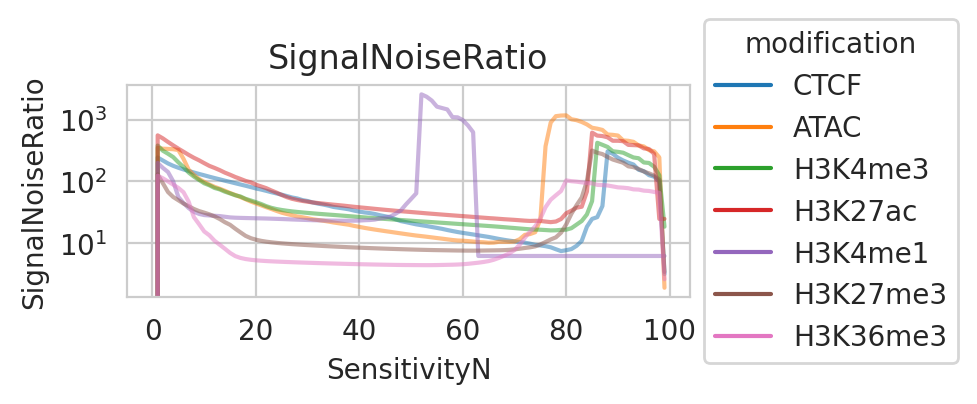

SignalControlRatio


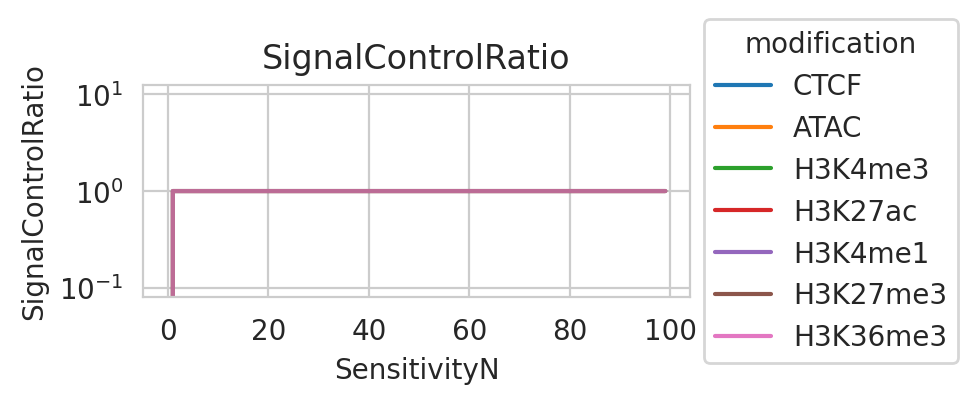

In [29]:
for y in ['CandidatesN', 'CandidatesAL', 'SignalNoiseRatio', 'SignalControlRatio']:
    print(y)
    plt.figure(figsize=(5, 2))
    ax = plt.axes()
    sns.lineplot(data=t, x='SensitivityN', y=y, hue='modification',
                 hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
                 alpha=0.5,
                 sort=False,
                 estimator=None,
                 ax=ax)
    if y == 'CandidatesN':
        sns.scatterplot(data=t, x='S2N', y='S2CN',
                        hue='modification',
                        hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
                        alpha=0.8, size=50, legend=False,
                        ax=ax)
    elif y == 'CandidatesAL':
        sns.scatterplot(data=t, x='S2N', y='S2CAL',
                        hue='modification',
                        hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
                        alpha=0.8, size=50, legend=False,
                        ax=ax)
    ax.set(yscale='log')
    ax.set_title(y)
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()


# Fragmentation

In [30]:
ts = []
for (ds, m, c, r), t in full_sensitivity.groupby(['dataset', 'modification', 'cell', 'replicate']):
    if len(t['file'].unique()) != 1:
        continue
    gaps = t['file'].values[0].replace('.sensitivity.tsv', '.gaps.tsv')
    if not os.path.exists(gaps):
        continue
    print(ds, m, c, r, gaps)
    t = pd.read_csv(gaps, sep='\t')
    t['dataset'] = ds
    t['modification'] = m
    t['cell'] = c
    t['replicate'] = r
    t['N'] = t['CandidatesN'] / np.max(t['CandidatesN'])
    ts.append(t)
gaps_df = pd.concat(ts).reset_index(drop=True)
del ts
gaps_df.sample(5)

CTCF CTCF H1  /home/jetbrains/data/2024_TFs/span/H1_CTCF_hg38_ENCFF767YLK_100_0.05.peak.gaps.tsv
ENCODE H3K27ac GM12878 rep1 /home/jetbrains/data/2023_GSE26320/span/GSM646316_GM12878_H3K27ac_rep1_100_0.05.peak.gaps.tsv
ENCODE H3K27ac GM12878 rep2 /home/jetbrains/data/2023_GSE26320/span/GSM646317_GM12878_H3K27ac_rep2_100_0.05.peak.gaps.tsv
ENCODE H3K27ac H1 rep1 /home/jetbrains/data/2023_GSE26320/span/GSM646336_H1_H3K27ac_rep1_100_0.05.peak.gaps.tsv
ENCODE H3K27ac HMEC rep1 /home/jetbrains/data/2023_GSE26320/span/GSM646374_HMEC_H3K27ac_rep1_100_0.05.peak.gaps.tsv
ENCODE H3K27ac HMEC rep2 /home/jetbrains/data/2023_GSE26320/span/GSM646375_HMEC_H3K27ac_rep2_100_0.05.peak.gaps.tsv
ENCODE H3K27ac HSMM rep1 /home/jetbrains/data/2023_GSE26320/span/GSM646394_HSMM_H3K27ac_rep1_100_0.05.peak.gaps.tsv
ENCODE H3K27ac HSMM rep2 /home/jetbrains/data/2023_GSE26320/span/GSM646395_HSMM_H3K27ac_rep2_100_0.05.peak.gaps.tsv
ENCODE H3K27ac HepG2 rep1 /home/jetbrains/data/2023_GSE26320/span/GSM646355_HepG2_H

,Gap,CandidatesN,dataset,modification,cell,replicate,N
6980,30,21997,Roadmap,H3K4me3,TCellBB,rep2,0.891252
6932,32,19499,Roadmap,H3K4me3,TCellBB,rep1,0.899483
3846,46,19815,ENCODE,H3K4me3,HSMM,rep1,0.879221
3815,15,21244,ENCODE,H3K4me3,HSMM,rep1,0.942628
2603,3,29382,ENCODE,H3K36me3,NHLF,rep2,0.995662


## From files

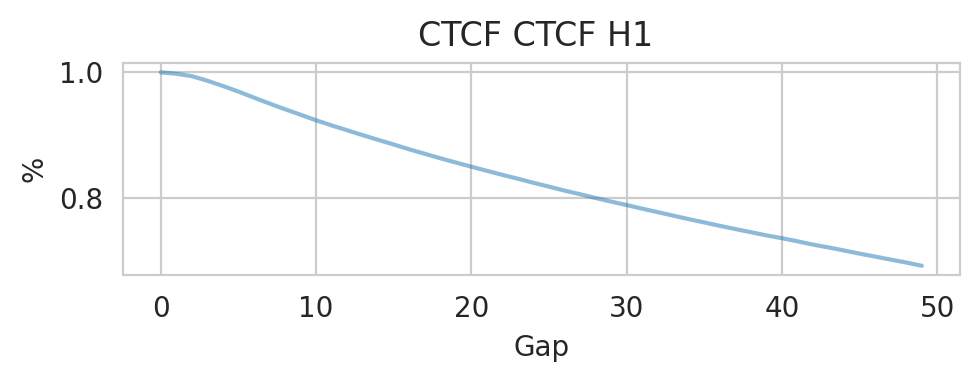

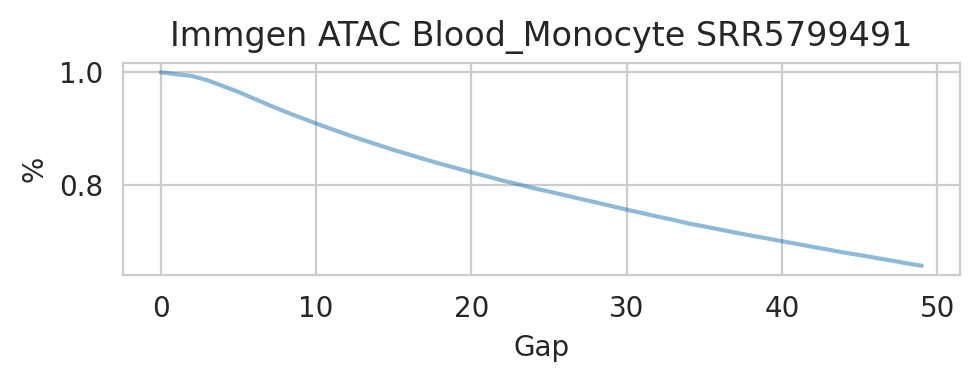

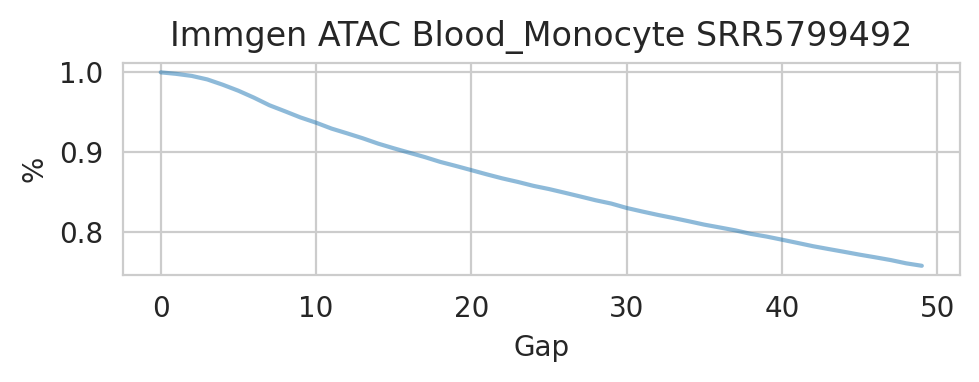

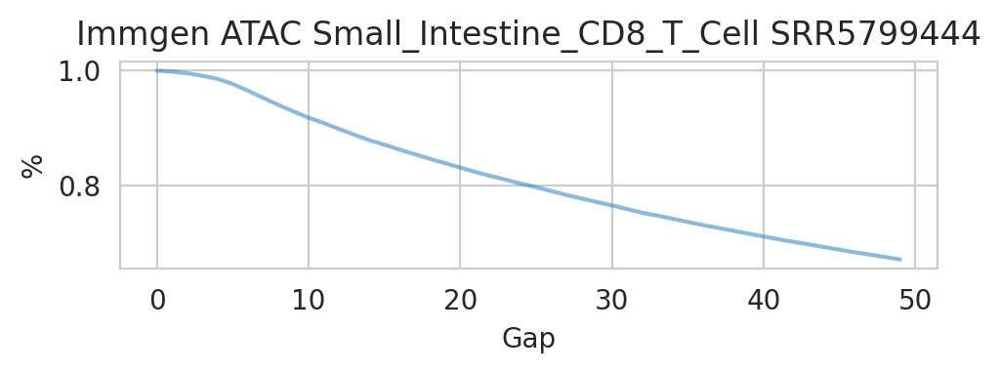

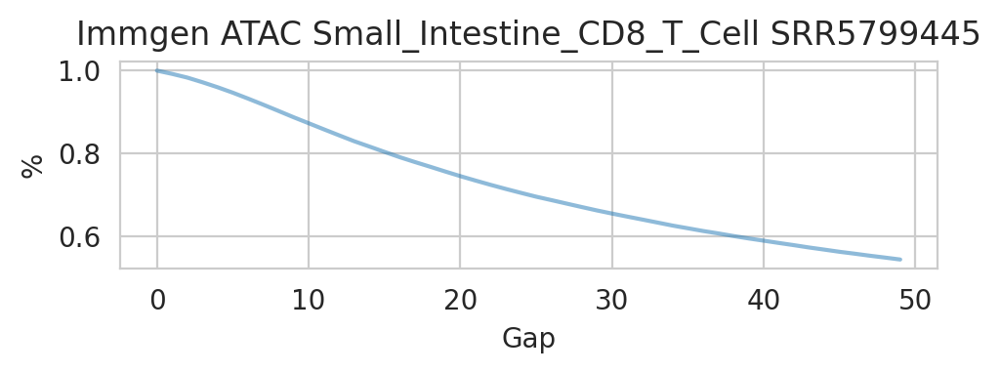

In [31]:
for (m, c, r, ds) in [
    ('CTCF', 'H1', '', 'CTCF'),
    ('ATAC', 'Blood_Monocyte', 'SRR5799491', 'Immgen'),
    ('ATAC', 'Blood_Monocyte', 'SRR5799492', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799444', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799445', 'Immgen'),
    # ('H3K4me3', 'CD34', '', 'Roadmap'),
    # ('H3K4me3', 'K562', 'rep1', 'ENCODE'),
    # ('H3K4me3', 'CD34', 'rep2', 'Roadmap'),
    # ('H3K4me3', 'CD4', '', 'Roadmap'),
    # ('H3K27ac', 'K562', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep2', 'ENCODE'),
    # ('H3K27me3', 'GM12878', 'rep2', 'ENCODE'),
    # ('H3K27me3', 'NHLF', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'CD4', '', 'Roadmap'),
    # ('H3K27me3', 'CD4', 'rep2', 'Roadmap'),
    # ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K27me3', 'BCell', '', 'Roadmap'),
    # ('H3K27me3', 'PBMC', '', 'Roadmap'),
    # ('H3K27me3', 'TCell', '', 'Roadmap'),
    # ('H3K27me3', 'H1', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep2', 'ENCODE'),
    # ('H3K36me3', 'CD4', '', 'Roadmap'),
    # ('H3K36me3', 'CD4', 'rep1', 'Roadmap'),
    # ('H3K36me3', 'GM12878', 'rep1', 'ENCODE'),
    # ('H3K36me3', 'CD34', '', 'Roadmap'),
    # ('H3K36me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K36me3', 'BCell', '', 'Roadmap'),
    # ('H3K36me3', 'TCell', '', 'Roadmap'),
    # ('H3K36me3', 'PBMC', '', 'Roadmap'),
]:
    t = gaps_df[(gaps_df['dataset'] == ds) &
                (gaps_df['modification'] == m) &
                (gaps_df['cell'] == c) &
                (gaps_df['replicate'] == r)]
    if len(t) == 0:
        continue
    plt.figure(figsize=(5, 2))
    ax = plt.axes()
    sns.lineplot(data=t.reset_index(drop=True), x='Gap', y='N',
                 estimator=None,
                 alpha=0.5,
                 sort=False,
                 ax=ax)
    ax.set_ylabel('%')
    ax.set_title(f'{ds} {m} {c} {r}')
    plt.tight_layout()
    plt.show()

## Per modification

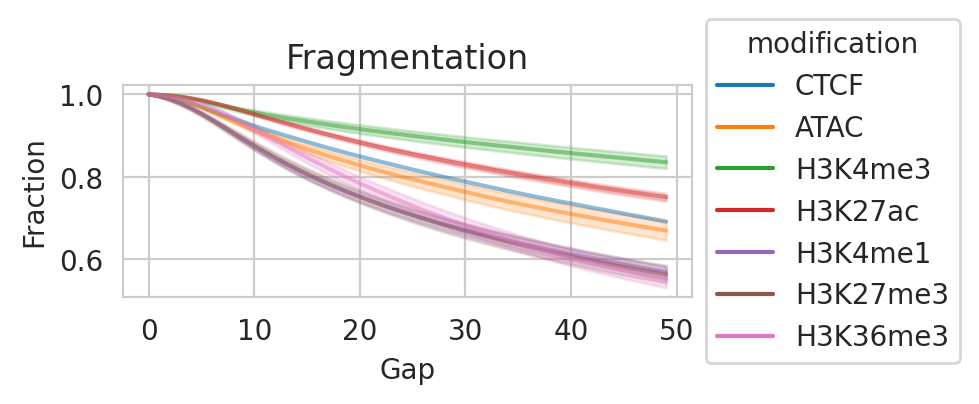

In [32]:
plt.figure(figsize=(5, 2))
ax = plt.axes()
sns.lineplot(data=gaps_df, x='Gap', y='N', hue='modification',
             alpha=0.5,
             sort=False, errorbar=('se', .95),
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             ax=ax)
# ax.axvline(x=20, ymin=60, ymax=100, color='black', lw=1, ls='dotted')
# sns.scatterplot(x=[20], y=[75],
#                 color='red', s=20,
#                 legend=False, ax=ax)
ax.set_ylabel('Fraction')
# ax.set_ylim(20, 100)
# ax.set(xscale='log')
ax.set_title('Fragmentation')
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

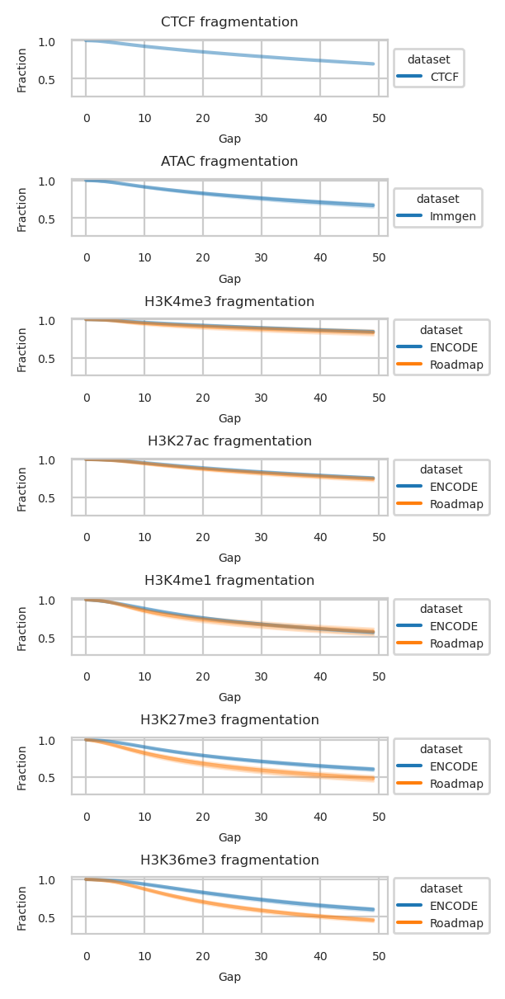

In [33]:
plt.rc('font', size=5)
plt.figure(figsize=(3, 6))
axs = [plt.subplot(7, 1, i + 1) for i in range(7)]
ymin = np.min(gaps_df['N'])
for i, m in enumerate(['CTCF', 'ATAC'] + MODIFICATIONS):
    t = gaps_df[gaps_df['modification'] == m]
    if len(t) == 0:
        continue
    ax = axs[i]
    sns.lineplot(t,
                 x='Gap', y='N',
                 hue='dataset',
                 alpha=0.5, errorbar=('se', .95),
                 ax=ax)
    # sns.scatterplot(x=[20], y=[70],
    #                 color='red', s=20,
    #                 legend=False, ax=ax)
    ax.set_ylim(bottom=ymin)
    ax.set_ylabel('Fraction')
    ax.set_title(f'{m} fragmentation')
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()
plt.rc('font', size=8)

# Autocorrelations

## Coverage

In [34]:
ts = []
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                                 (full_sensitivity['modification'] == m) &
                                 (full_sensitivity['Gap'] == 0)]
        for (cell, rep), t in dfdsm.groupby(['cell', 'replicate']):
            if len(t['file'].unique()) != 1:
                continue
            corrs = t['file'].values[0].replace('.sensitivity.tsv', '.ac.coverage.tsv')
            if not os.path.exists(corrs):
                continue
            t = pd.read_csv(corrs, sep='\t')
            t['dataset'] = ds
            t['modification'] = m
            t['cell'] = cell
            t['replicate'] = rep
            ts.append(t)
ac_cov_df = pd.concat(ts).reset_index(drop=True)
del ts
ac_cov_df.sample(5)

ENCODE CTCF
Roadmap CTCF
Immgen CTCF
CTCF CTCF
ENCODE ATAC
Roadmap ATAC
Immgen ATAC
CTCF ATAC
ENCODE H3K4me3
Roadmap H3K4me3
Immgen H3K4me3
CTCF H3K4me3
ENCODE H3K27ac
Roadmap H3K27ac
Immgen H3K27ac
CTCF H3K27ac
ENCODE H3K4me1
Roadmap H3K4me1
Immgen H3K4me1
CTCF H3K4me1
ENCODE H3K27me3
Roadmap H3K27me3
Immgen H3K27me3
CTCF H3K27me3
ENCODE H3K36me3
Roadmap H3K36me3
Immgen H3K36me3
CTCF H3K36me3


,D,Correlation,dataset,modification,cell,replicate
4384,50,0.190032,Roadmap,H3K4me1,Monocyte,
5200,50,0.087311,ENCODE,H3K27me3,K562,rep2
1900,14,0.361034,ENCODE,H3K27ac,GM12878,rep1
3317,3,0.182088,ENCODE,H3K4me1,H1,rep1
380,24,0.038269,Immgen,ATAC,Small_Intestine_CD8_T_Cell,SRR5799444


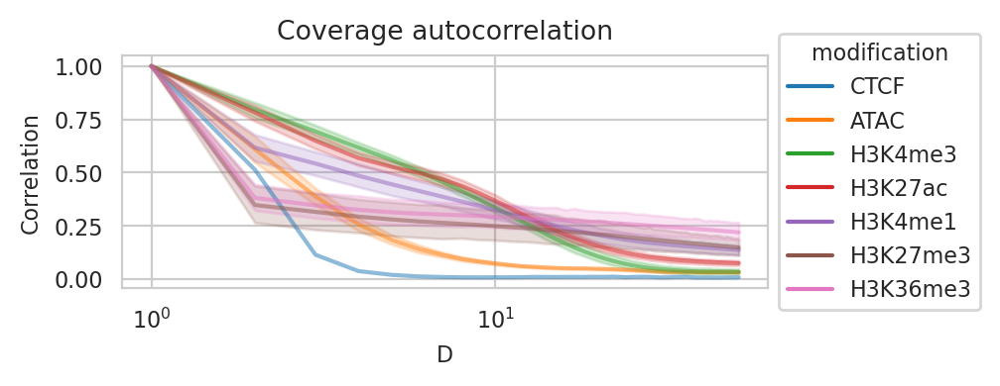

In [35]:
plt.figure(figsize=(5, 2))
ax = plt.axes()
sns.lineplot(ac_cov_df[ac_cov_df['D'] <= 200],
             x='D', y='Correlation',
             hue='modification',
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             alpha=0.5,  # errorbar=('se', .95),
             ax=ax)
ax.set_title('Coverage autocorrelation')
ax.set(xscale='log')
# ax.invert_xaxis()
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

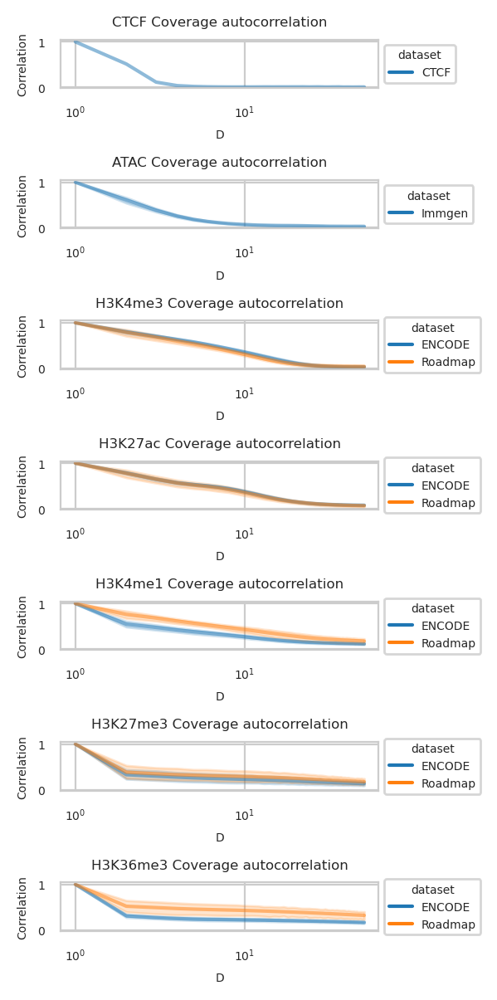

In [36]:
plt.rc('font', size=5)
plt.figure(figsize=(3, 6))
axs = [plt.subplot(7, 1, i + 1) for i in range(7)]
ymin = np.min(ac_cov_df['Correlation'])
for i, m in enumerate(['CTCF', 'ATAC'] + MODIFICATIONS):
    t = ac_cov_df[ac_cov_df['modification'] == m]
    if len(t) == 0:
        continue
    ax = axs[i]
    sns.lineplot(t,
                 x='D', y='Correlation',
                 hue='dataset',
                 alpha=0.5,
                 ax=ax)
    ax.set_title(f'{m} Coverage autocorrelation')
    ax.set(xscale='log')
    ax.set_ylim(bottom=ymin)
    # ax.invert_xaxis()
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()
plt.rc('font', size=8)

## PVals

In [37]:
ts = []
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                                 (full_sensitivity['modification'] == m) &
                                 (full_sensitivity['Gap'] == 0)]
        for (cell, rep), t in dfdsm.groupby(['cell', 'replicate']):
            if len(t['file'].unique()) != 1:
                continue
            corrs = t['file'].values[0].replace('.sensitivity.tsv', '.ac.pvals.tsv')
            if not os.path.exists(corrs):
                continue
            t = pd.read_csv(corrs, sep='\t')
            t['dataset'] = ds
            t['modification'] = m
            t['cell'] = cell
            t['replicate'] = rep
            ts.append(t)
ac_pvals_df = pd.concat(ts).reset_index(drop=True)
del ts
ac_pvals_df.sample(5)

ENCODE CTCF
Roadmap CTCF
Immgen CTCF
CTCF CTCF
ENCODE ATAC
Roadmap ATAC
Immgen ATAC
CTCF ATAC
ENCODE H3K4me3
Roadmap H3K4me3
Immgen H3K4me3
CTCF H3K4me3
ENCODE H3K27ac
Roadmap H3K27ac
Immgen H3K27ac
CTCF H3K27ac
ENCODE H3K4me1
Roadmap H3K4me1
Immgen H3K4me1
CTCF H3K4me1
ENCODE H3K27me3
Roadmap H3K27me3
Immgen H3K27me3
CTCF H3K27me3
ENCODE H3K36me3
Roadmap H3K36me3
Immgen H3K36me3
CTCF H3K36me3


,D,Correlation,dataset,modification,cell,replicate
3809,36,0.260702,ENCODE,H3K4me1,K562,rep1
11,12,0.004496,CTCF,CTCF,H1,
1008,40,0.022291,ENCODE,H3K4me3,Huvec,rep2
6130,11,0.882859,ENCODE,H3K36me3,HMEC,rep2
6791,9,0.796436,Roadmap,H3K36me3,CD34,


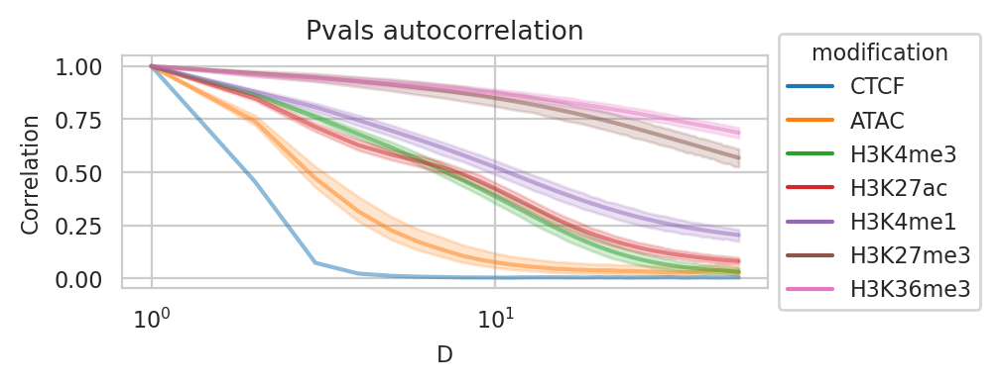

In [38]:
plt.figure(figsize=(5, 2))
ax = plt.axes()
sns.lineplot(ac_pvals_df[ac_pvals_df['D'] <= 200],
             x='D', y='Correlation',
             hue='modification',
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             alpha=0.5,  #errorbar=('se', .95),
             ax=ax)
# ax.axvline(x=10, ymin=0, ymax=1.0, color='black', lw=.5, ls='dotted')
# sns.scatterplot(x=[10], y=[0.7],
#                 color='red', s=20,
#                 legend=False, ax=ax)
ax.set_title('Pvals autocorrelation')
ax.set(xscale='log')
# ax.invert_xaxis()
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

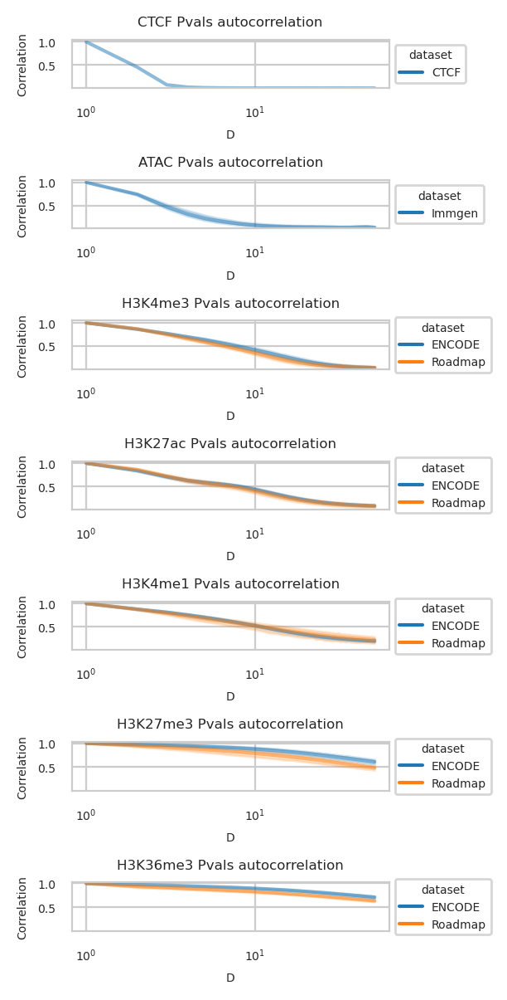

In [39]:
plt.rc('font', size=5)
plt.figure(figsize=(3, 6))
axs = [plt.subplot(7, 1, i + 1) for i in range(7)]
ymin = np.min(ac_pvals_df['Correlation'])
for i, m in enumerate(['CTCF', 'ATAC'] + MODIFICATIONS):
    t = ac_pvals_df[ac_pvals_df['modification'] == m]
    if len(t) == 0:
        continue
    ax = axs[i]
    sns.lineplot(t,
                 x='D', y='Correlation',
                 hue='dataset',
                 alpha=0.5,  #errorbar=('se', .95),
                 ax=ax)
    # sns.scatterplot(x=[10], y=[0.7],
    #                 color='red', s=20,
    #                 legend=False, ax=ax)
    ax.set_ylim(bottom=ymin)
    ax.set_title(f'{m} Pvals autocorrelation')
    ax.set(xscale='log')
    # ax.invert_xaxis()
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()
plt.rc('font', size=8)

## Per modification

In [40]:
# import plotly.express as px
#
# ac_pvals_df['experiment'] = ac_pvals_df['dataset'] + ' ' + ac_pvals_df['cell'] + ' ' + ac_pvals_df['replicate']
#
# plt.rc('font', size=4)
# # for m in ['ATAC'] + MODIFICATIONS:
# for m in ['H3K27me3']:
#     dfm = ac_pvals_df[(ac_pvals_df['modification'] == m) & (ac_pvals_df['D'] <= 50)]
#     if len(dfm) == 0:
#         continue
#     fig = px.line(dfm, x='D', y='Correlation', color='experiment',
#                   hover_data=['experiment'],
#                   title=f'{m} Pvals autocorrelation',
#                   width=1000, height=400)
#     fig.show()
# plt.rc('font', size=8)

# Autocorrelation vs fragmentation

In [41]:
t1 = ac_pvals_df[ac_pvals_df['D'] == 10]
t2 = gaps_df[gaps_df['Gap'] == 20]
ac_gaps_df = pd.merge(t1, t2, left_on=['dataset', 'modification', 'cell', 'replicate'],
             right_on=['dataset', 'modification', 'cell', 'replicate'])
ac_gaps_df.sample(3)

,D,Correlation,dataset,modification,cell,replicate,Gap,CandidatesN,N
97,10,0.943725,ENCODE,H3K27me3,HepG2,rep2,20,36049,0.767457
99,10,0.779693,ENCODE,H3K27me3,Huvec,rep2,20,48901,0.755835
137,10,0.800155,Roadmap,H3K36me3,Monocyte,,20,28002,0.656353


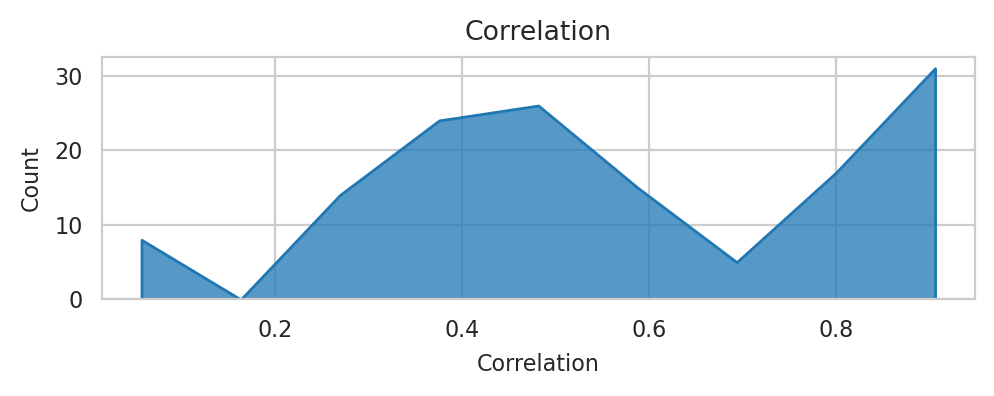

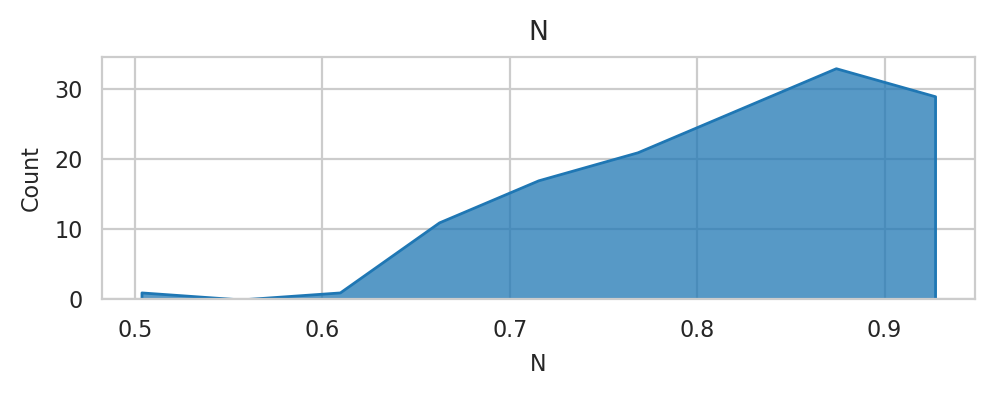

In [42]:
for y in ['Correlation', 'N']:
    plt.figure(figsize=(5, 2))
    ax = plt.axes()
    sns.histplot(ac_gaps_df,
                 x=y,
                 element="poly",
                 ax=ax)
    ax.set_title(y)
    plt.tight_layout()
    plt.show()

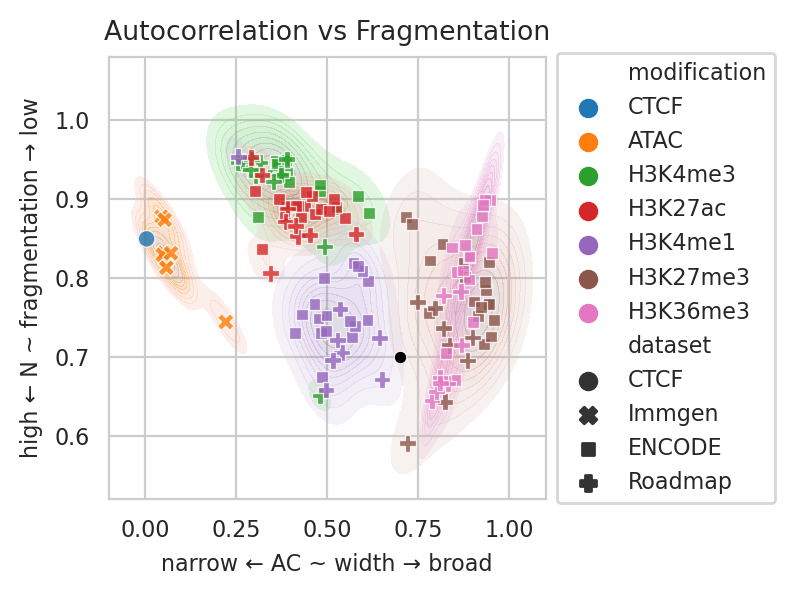

In [43]:
plt.figure(figsize=(4, 3))
ax = plt.axes()
sns.kdeplot(
    ac_gaps_df, x='Correlation', y='N',
    hue='modification',
    hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
    alpha=0.2,
    common_norm=False, common_grid=False,
    thresh=.1,
    fill=True,
    warn_singular=False,
    ax = ax,
)
sns.scatterplot(ac_gaps_df, x='Correlation', y='N',
                hue='modification',
                hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
                style='dataset',
                alpha=0.8,
                ax=ax)
sns.scatterplot(x=[0.7], y=[0.7],
                color='black', s=20,
                legend=False, ax=ax)
# ax.axvline(x=0.7, ymin=40, ymax=100, color='black', lw=.5)
# ax.axhline(y=70, xmin=0, xmax=1.0, color='black', lw=.5)
ax.set_xlim(-0.1, 1.1)
ax.set_ylim(0.52, 1.08)
ax.set_xlabel('narrow ← AC ~ width → broad')
ax.set_ylabel('high ← N ~ fragmentation → low')
ax.set_title('Autocorrelation vs Fragmentation')
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

In [44]:
ac_gaps_df[(ac_gaps_df['modification'] == 'H3K27me3') &
           (ac_gaps_df['cell'].isin(['Monocyte', 'TCell', 'CD4'])) &
           (ac_gaps_df['replicate'] == '')][['cell', 'Correlation', 'N']]

,cell,Correlation,N
109,CD4,0.899603,0.724945
111,Monocyte,0.748061,0.769756
114,TCell,0.541084,0.477131


In [45]:
ac_gaps_df[(ac_gaps_df['modification'] == 'H3K27me3') & (ac_gaps_df['N'] < 70)][['cell', 'replicate', 'Correlation', 'N']]

,cell,replicate,Correlation,N
88,GM12878,rep1,0.929932,0.716431
89,GM12878,rep2,0.959035,0.747150
90,H1,rep1,0.716781,0.877503
91,H1,rep2,0.732556,0.868188
92,HMEC,rep1,0.902417,0.770417
93,HMEC,rep2,0.936790,0.784631
94,HSMM,rep1,0.942225,0.767524
95,HSMM,rep2,0.913970,0.751794
96,HepG2,rep1,0.950160,0.726040
97,HepG2,rep2,0.943725,0.767457


In [46]:
ac_gaps_df[(ac_gaps_df['modification'] == 'ATAC') & (ac_gaps_df['N'] < 80)][['cell', 'replicate', 'Correlation', 'N']]

,cell,replicate,Correlation,N
1,Blood_Monocyte,SRR5799491,0.058286,0.822932
2,Blood_Monocyte,SRR5799492,0.044871,0.877561
3,Blood_Monocyte,SRR5799493,0.058039,0.813179
4,Blood_Monocyte,SRR5799494,0.052002,0.832209
5,Blood_Monocyte,SRR5799541,0.047900,0.829393
6,Blood_Monocyte,SRR5799542,0.053513,0.873685
7,Small_Intestine_CD8_T_Cell,SRR5799444,0.070683,0.831489
8,Small_Intestine_CD8_T_Cell,SRR5799445,0.221384,0.744510


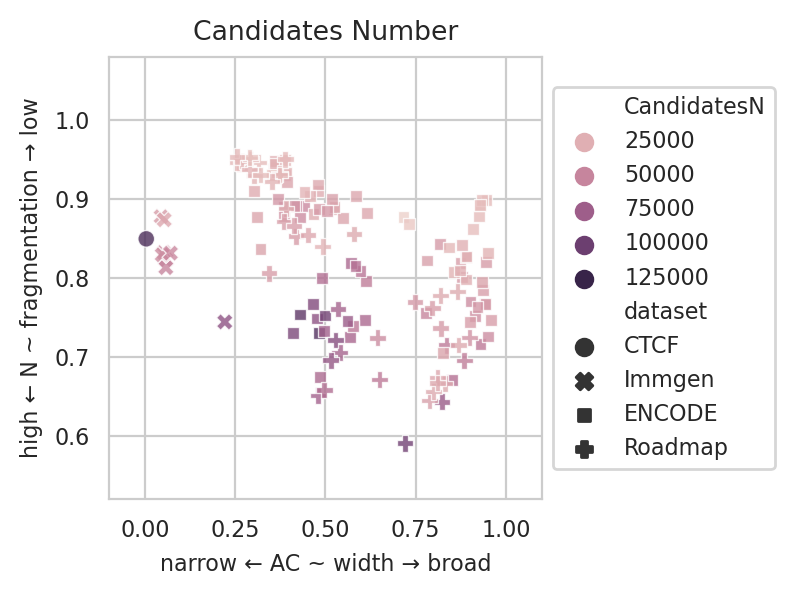

In [47]:
plt.figure(figsize=(4, 3))
ax = plt.axes()
sns.scatterplot(ac_gaps_df, x='Correlation', y='N',
                hue='CandidatesN', style='dataset',
                alpha=0.8,
                ax=ax)
# sns.scatterplot(x=[0.7], y=[75],
#                 color='black', s=20,
#                 legend=False, ax=ax)
# ax.axvline(x=0.7, ymin=40, ymax=100, color='black', lw=.5)
# ax.axhline(y=75, xmin=0, xmax=1.0, color='black', lw=.5)
ax.set_xlim(-0.1, 1.1)
ax.set_ylim(0.52, 1.08)
ax.set_xlabel('narrow ← AC ~ width → broad')
ax.set_ylabel('high ← N ~ fragmentation → low')
ax.set_title('Candidates Number')

sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

# Candidates

In [48]:
cns = {}
cals = {}
for (ds, m, c, r), t in full_sensitivity.groupby(['dataset', 'modification', 'cell', 'replicate']):
    tt = t[t['Gap'] == 0].sort_values('Sensitivity').reset_index(drop=True)
    name = f'{ds} {m} {c} {r}'
    sp = sps[name]
    cn = tt['CandidatesN'].values[sp[1]]
    cal = tt['CandidatesAL'].values[sp[1]]
    cns[(ds, m, c, r)] = cn
    cals[(ds, m, c, r)] = cal

full_infos['candidatesN'] = [cns[(ds, m, c, r)] for _, (ds, m, c, r) in
                             full_infos[['dataset', 'modification', 'cell', 'replicate']].iterrows()]
full_infos['candidatesAL'] = [cals[(ds, m, c, r)] for _, (ds, m, c, r) in
                              full_infos[['dataset', 'modification', 'cell', 'replicate']].iterrows()]
full_infos.sample(3)

,file,modification,cell,replicate,peaks,length_mean,length_median,model_signal,model_noise,model_signal_to_noise,...,fragmentation_score,signal_density,noise_density,signal_to_noise,signal_to_control,fit_out_up,fit_out_down,dataset,candidatesN,candidatesAL
58,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K4me1,NHEK,rep2,123373.0,1161.0,780.0,3.855145,0.440315,8.755417,...,0.730488,0.038420,0.001107,34.703682,1.0,False,False,ENCODE,126693,14.905866
50,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K27ac,NHLF,rep2,42262.0,1314.0,900.0,5.064932,0.378207,13.391949,...,0.900103,0.051155,0.000898,56.988147,1.0,False,False,ENCODE,44023,21.955840
137,/home/jetbrains/data/2024_Immgen/span/SRR57995...,ATAC,Blood_Monocyte,SRR5799542,31785.0,416.0,310.0,5.077900,0.927600,5.474236,...,0.873685,0.074934,0.004896,15.305155,NaN,False,False,Immgen,48207,6.543480


In [49]:
# Remove outliers
OUTLIERS = [
    ('H3K4me3', 'NK', ''),
    ('H3K27me3', 'TCell', ''),
    ('H3K27me3', 'BCell', ''),
]
df_peaks = full_infos.loc[[(m, c, r) not in OUTLIERS
                           for _, (m, c, r) in full_infos[['modification', 'cell', 'replicate']].iterrows()]].copy()

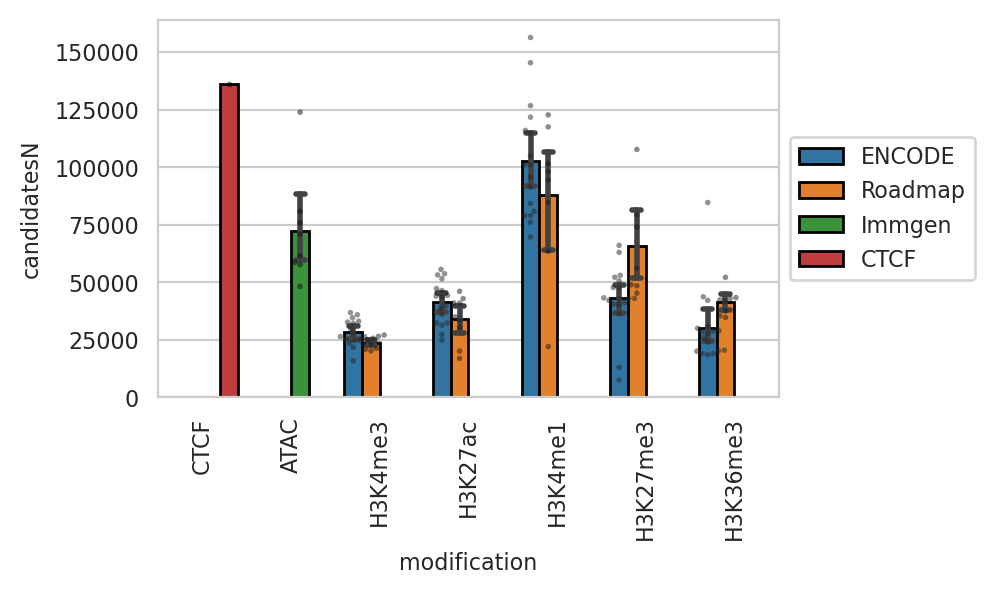

In [50]:
sns.set_style('whitegrid')
plt.figure(figsize=(5, 3))
ax = plt.axes()
t = df_peaks
sns.barplot(data=t, x='modification', y='candidatesN', hue='dataset',
            capsize=.1, errwidth=2, edgecolor="black",
            order=['CTCF', 'ATAC'] + MODIFICATIONS,
            hue_order=['ENCODE', 'Roadmap', 'Immgen', 'CTCF'],
            ax=ax)
sns.swarmplot(data=t, x='modification', y='candidatesN', hue='dataset',
              dodge=True, size=2, palette='dark:black', alpha=0.5,
              order=['CTCF', 'ATAC'] + MODIFICATIONS,
              hue_order=['ENCODE', 'Roadmap', 'Immgen', 'CTCF'], legend=False,
              ax=ax)
ax.xaxis.set_tick_params(rotation=90)
# ax.set_ylim(0, 2e5)
# ax.set(yscale='log')
# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

In [51]:
full_infos[(full_infos['modification'] == 'H3K27me3')].sort_values(by=['candidatesN'], ascending=False)[
    ['cell', 'replicate', 'candidatesN']].head(10)

,cell,replicate,candidatesN
108,TCell,,281908
117,BCell,,159100
115,NK,,107693
85,PBMC,,79289
120,CD4,rep2,74034
3,GM12878,rep1,66053
46,Huvec,rep2,63004
92,CD4,,56057
41,HMEC,rep1,53030
83,HepG2,rep1,52204


# Min signal-to-noise

In [52]:
min_sns = {}
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) & (full_sensitivity['modification'] == m)]
        for (cell, rep), t in dfdsm.groupby(['cell', 'replicate']):
            tt = t[t['Gap'] == 0].sort_values(by=['Sensitivity']).copy().reset_index(drop=True)
            sp = detect_sensitivity_triangle(tt)
            snr = tt['SignalNoiseRatio'].copy().values
            snr[:sp[0]] = 1e6
            snr[sp[2]:] = 1e6
            mi = np.argmin(snr)
            min_snr = snr[mi]
            print(f'{ds} {m} {cell} {rep} {mi}: {min_snr}')
            min_sns[(ds, m, cell, rep)] = min_snr

full_infos['minimal_signal_noise_ratio'] = [min_sns[(ds, m, c, r)] for _, (ds, m, c, r) in
                                            full_infos[['dataset', 'modification', 'cell', 'replicate']].iterrows()]
full_infos.sample(3)

ENCODE CTCF
Roadmap CTCF
Immgen CTCF
CTCF CTCF
Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 0.16309876707091092) I3mab (85, 30.58563233121062)
Checking I 11 I1mab (6, 0.21797731524624797) I3mab (85, 29.770857656693792)
Checking I 12 I1mab (6, 0.26993606322015756) I3mab (85, 29.078286006597466)
Checking I 13 I1mab (6, 0.3161789856893966) I3mab (85, 28.47949290574995)
Checking I 14 I1mab (6, 0.3634498725316765) I3mab (85, 27.8839960529086)
Checking I 15 I1mab (6, 0.4060117445228733) I3mab (85, 27.392399876490103)
Checking I 16 I1mab (6, 0.4507406667989974) I3mab (85, 26.897267771610927)
Checking I 17 I1mab (6, 0.4884831601733928) I3mab (85, 26.44360145077863)
Checking I 18 I1mab (6, 0.5271320859379254) I3mab (85, 26.020707198537096)
Checking I 19 I1mab (6, 0.5701644588362507) I3mab (87, 25.597102493116395)
Checking I 20 I1mab (6, 0.6156419930103916) I3mab (87, 25.171659642009672)
Checking I 21 I1mab (6, 0.6443859441689989) I3mab (87, 24.839242915824883)
Checking I 22 I1mab (6, 0.687308422

,file,modification,cell,replicate,peaks,length_mean,length_median,model_signal,model_noise,model_signal_to_noise,...,signal_density,noise_density,signal_to_noise,signal_to_control,fit_out_up,fit_out_down,dataset,candidatesN,candidatesAL,minimal_signal_noise_ratio
130,/home/jetbrains/data/2023_Immune/span/BCell_H3...,H3K4me3,BCell,,21301.0,957.0,800.0,20.375375,1.122610,18.150000,...,0.232033,0.005375,43.166648,1.0,True,False,Roadmap,23169,19.360627,18.926120
54,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K27ac,K562,rep2,23884.0,1531.0,1060.0,4.196290,0.333506,12.582362,...,0.043945,0.000789,55.712754,1.0,False,False,ENCODE,24963,24.629877,33.758774
79,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K4me3,HMEC,rep2,15476.0,1242.0,1010.0,7.788239,0.416446,18.701661,...,0.074436,0.001997,37.278621,1.0,False,False,ENCODE,15919,21.142103,18.347812


# Pvalues

## Examples

/tmp/ipykernel_3632833/372498453.py:103: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  t = pd.read_csv(t, sep='\\t')


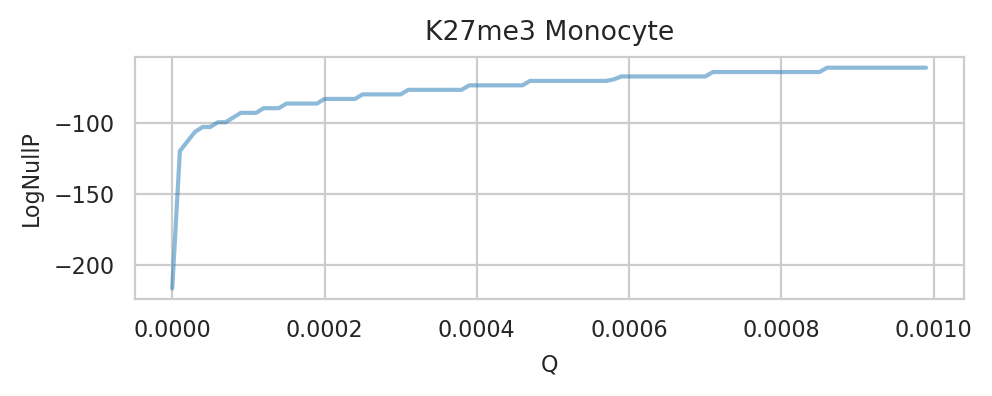

In [53]:
t = StringIO('''Q	LogNullP
0.0	-216.5814666748047
1.0E-5	-119.61390686035156
2.0E-5	-112.77011108398438
3.0000000000000004E-5	-105.98941040039062
4.0E-5	-102.6241455078125
5.0E-5	-102.6241455078125
6.0E-5	-99.27644348144531
7.000000000000001E-5	-99.27644348144531
8.0E-5	-95.94697570800781
9.0E-5	-92.6364517211914
1.0E-4	-92.6364517211914
1.1E-4	-92.6364517211914
1.2E-4	-89.34564208984375
1.3000000000000002E-4	-89.34564208984375
1.4000000000000001E-4	-89.34564208984375
1.5000000000000001E-4	-86.07534790039062
1.6E-4	-86.07534790039062
1.7E-4	-86.07534790039062
1.8E-4	-86.07534790039062
1.9E-4	-86.07534790039062
2.0E-4	-82.82644653320312
2.1E-4	-82.82644653320312
2.2E-4	-82.82644653320312
2.3E-4	-82.82644653320312
2.4E-4	-82.82644653320312
2.5E-4	-79.59986877441406
2.6000000000000003E-4	-79.59986877441406
2.7000000000000006E-4	-79.59986877441406
2.800000000000001E-4	-79.59986877441406
2.900000000000001E-4	-79.59986877441406
3.0000000000000014E-4	-79.59986877441406
3.1000000000000016E-4	-76.39661407470703
3.200000000000002E-4	-76.39661407470703
3.300000000000002E-4	-76.39661407470703
3.4000000000000024E-4	-76.39661407470703
3.5000000000000027E-4	-76.39661407470703
3.600000000000003E-4	-76.39661407470703
3.700000000000003E-4	-76.39661407470703
3.8000000000000035E-4	-76.3956298828125
3.9000000000000037E-4	-73.21774291992188
4.000000000000004E-4	-73.21774291992188
4.100000000000004E-4	-73.21774291992188
4.2000000000000045E-4	-73.21774291992188
4.300000000000005E-4	-73.21774291992188
4.400000000000005E-4	-73.21774291992188
4.5000000000000053E-4	-73.21774291992188
4.6000000000000056E-4	-73.21774291992188
4.700000000000006E-4	-70.0644302368164
4.800000000000006E-4	-70.0644302368164
4.900000000000006E-4	-70.0644302368164
5.000000000000007E-4	-70.0644302368164
5.100000000000007E-4	-70.0644302368164
5.200000000000007E-4	-70.0644302368164
5.300000000000007E-4	-70.0644302368164
5.400000000000008E-4	-70.0644302368164
5.500000000000008E-4	-70.0644302368164
5.600000000000008E-4	-70.0644302368164
5.700000000000008E-4	-70.0644302368164
5.800000000000009E-4	-68.97872924804688
5.900000000000009E-4	-66.93791198730469
6.000000000000009E-4	-66.93791198730469
6.10000000000001E-4	-66.93791198730469
6.20000000000001E-4	-66.93791198730469
6.30000000000001E-4	-66.93791198730469
6.40000000000001E-4	-66.93791198730469
6.500000000000011E-4	-66.93791198730469
6.600000000000011E-4	-66.93791198730469
6.700000000000011E-4	-66.93791198730469
6.800000000000011E-4	-66.93791198730469
6.900000000000012E-4	-66.93791198730469
7.000000000000012E-4	-66.93778228759766
7.100000000000012E-4	-63.83954620361328
7.200000000000012E-4	-63.83954620361328
7.300000000000013E-4	-63.83954620361328
7.400000000000013E-4	-63.83954620361328
7.500000000000013E-4	-63.83954620361328
7.600000000000013E-4	-63.83954620361328
7.700000000000014E-4	-63.83954620361328
7.800000000000014E-4	-63.83954620361328
7.900000000000014E-4	-63.83954620361328
8.000000000000014E-4	-63.83954620361328
8.100000000000015E-4	-63.83954620361328
8.200000000000015E-4	-63.83954620361328
8.300000000000015E-4	-63.83954620361328
8.400000000000016E-4	-63.83954620361328
8.500000000000016E-4	-63.8370475769043
8.600000000000016E-4	-60.77081298828125
8.700000000000016E-4	-60.77081298828125
8.800000000000017E-4	-60.77081298828125
8.900000000000017E-4	-60.77081298828125
9.000000000000017E-4	-60.77081298828125
9.100000000000017E-4	-60.77081298828125
9.200000000000018E-4	-60.77081298828125
9.300000000000018E-4	-60.77081298828125
9.400000000000018E-4	-60.77081298828125
9.500000000000018E-4	-60.77081298828125
9.600000000000019E-4	-60.77081298828125
9.700000000000019E-4	-60.77081298828125
9.80000000000002E-4	-60.77081298828125
9.90000000000002E-4	-60.77081298828125
''')
t = pd.read_csv(t, sep='\\t')
plt.figure(figsize=(5, 2))
ax = plt.axes()
sns.lineplot(data=t, x='Q', y='LogNullP', estimator=None,
             alpha=0.5,
             sort=False,
             ax=ax)
ax.set_title('K27me3 Monocyte')
plt.tight_layout()
plt.show()

## From files

In [54]:
ts = []
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                                 (full_sensitivity['modification'] == m) &
                                 (full_sensitivity['Gap'] == 0)]
        for (cell, rep), t in dfdsm.groupby(['cell', 'replicate']):
            if len(t['file'].unique()) != 1:
                continue
            pvals = t['file'].values[0].replace('.sensitivity.tsv', '.logps.tsv')
            if not os.path.exists(pvals):
                continue
            t = pd.read_csv(pvals, sep='\t')
            t['dataset'] = ds
            t['modification'] = m
            t['cell'] = cell
            t['replicate'] = rep
            ts.append(t)
pvals_df = pd.concat(ts).reset_index(drop=True)
del ts
pvals_df.sample(5)

ENCODE CTCF
Roadmap CTCF
Immgen CTCF
CTCF CTCF
ENCODE ATAC
Roadmap ATAC
Immgen ATAC
CTCF ATAC
ENCODE H3K4me3
Roadmap H3K4me3
Immgen H3K4me3
CTCF H3K4me3
ENCODE H3K27ac
Roadmap H3K27ac
Immgen H3K27ac
CTCF H3K27ac
ENCODE H3K4me1
Roadmap H3K4me1
Immgen H3K4me1
CTCF H3K4me1
ENCODE H3K27me3
Roadmap H3K27me3
Immgen H3K27me3
CTCF H3K27me3
ENCODE H3K36me3
Roadmap H3K36me3
Immgen H3K36me3
CTCF H3K36me3


,Q,LogNullP,dataset,modification,cell,replicate
497,0.00497,-15.488867,CTCF,CTCF,H1,
100984,0.00884,-10.427981,ENCODE,H3K27me3,K562,rep1
20182,0.00162,-60.808460,ENCODE,H3K4me3,K562,rep1
47267,0.00220,-44.381615,ENCODE,H3K27ac,Huvec,rep2
64210,0.00146,-19.115240,ENCODE,H3K4me1,GM12878,rep2


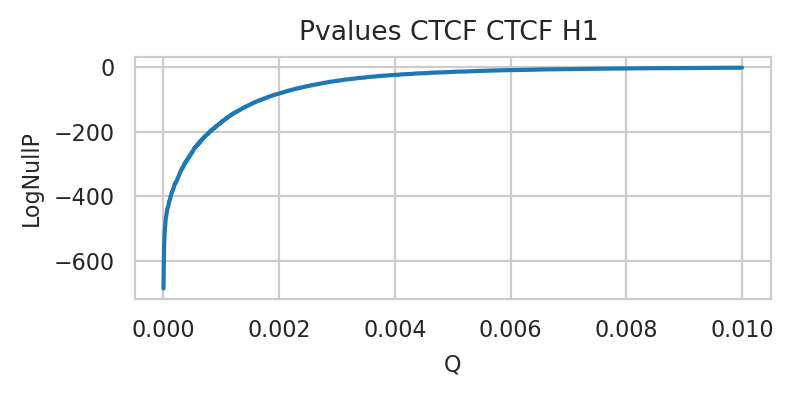

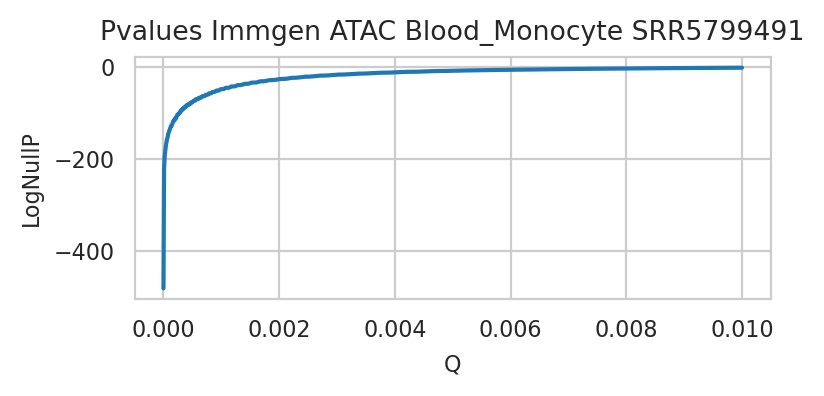

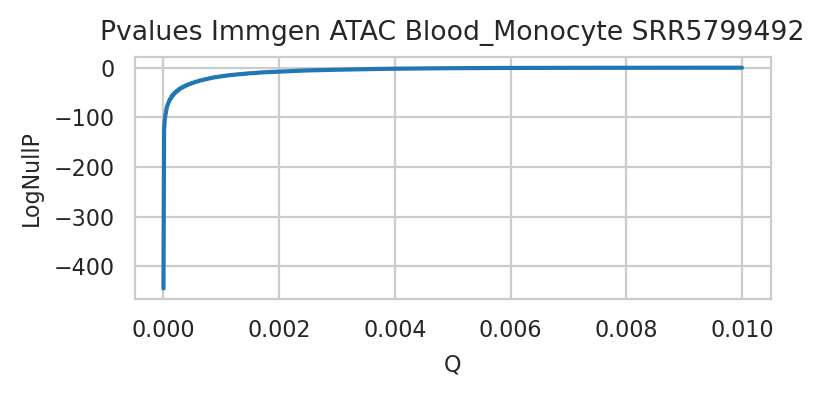

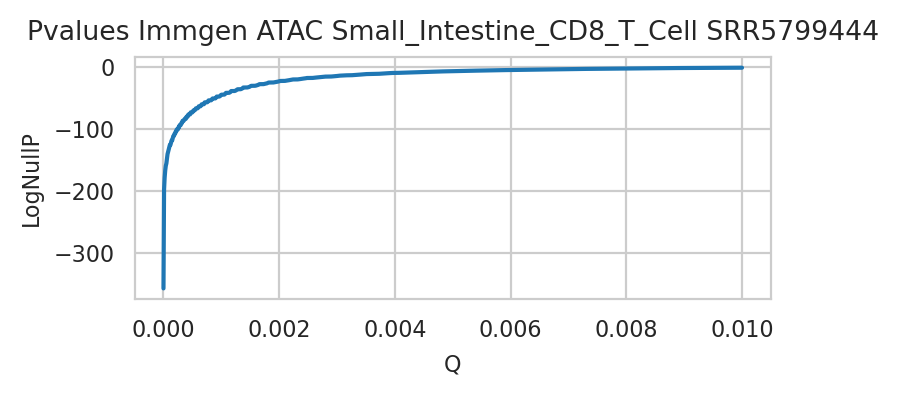

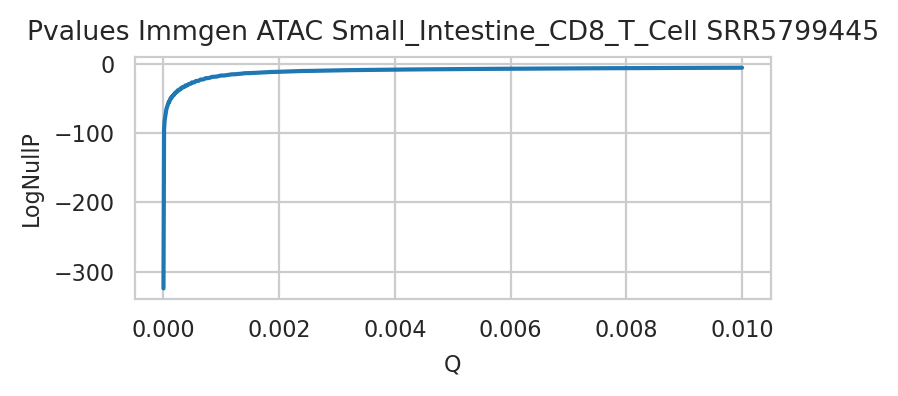

...

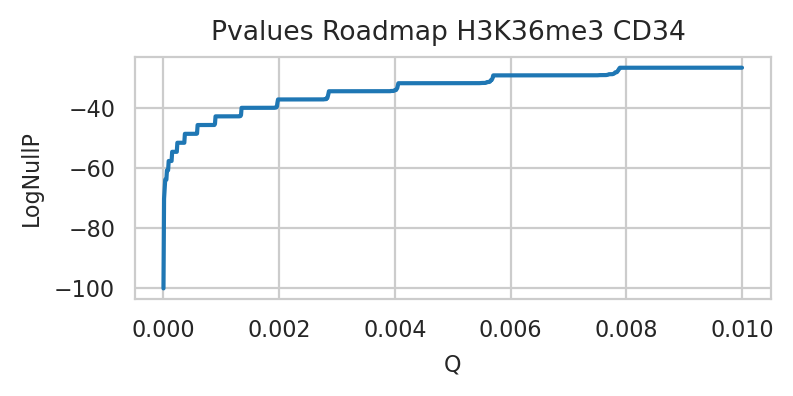

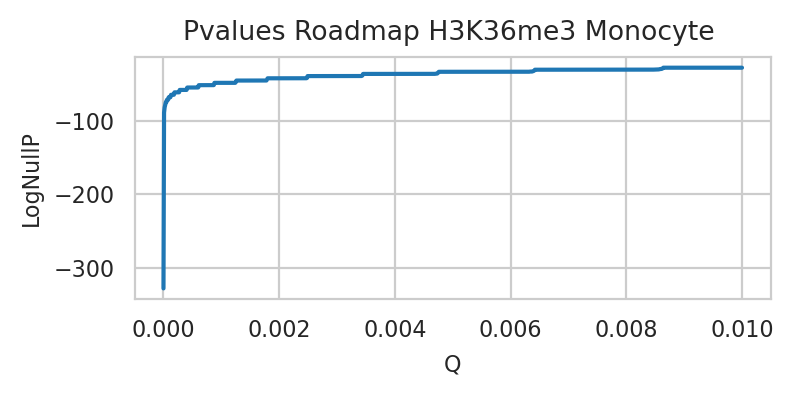

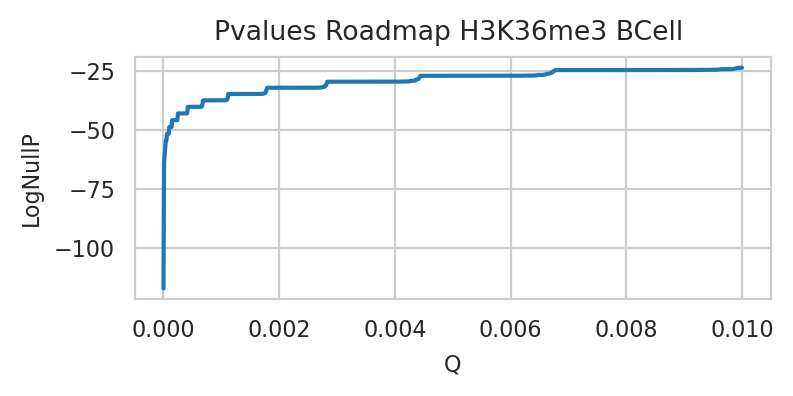

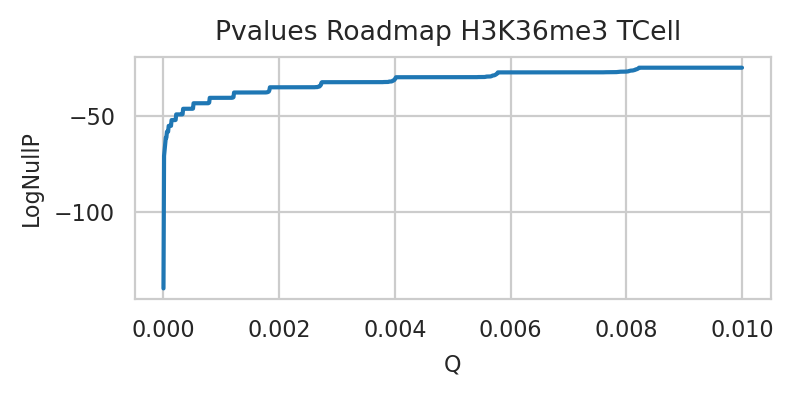

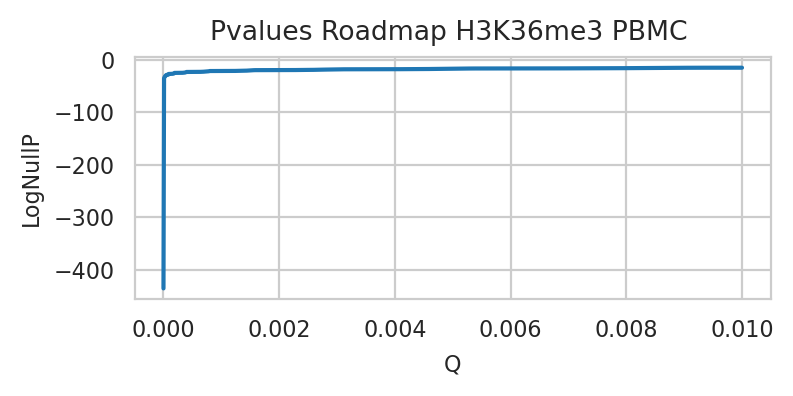

In [55]:
for (m, c, r, ds) in [
    ('CTCF', 'H1', '', 'CTCF'),
    ('ATAC', 'Blood_Monocyte', 'SRR5799491', 'Immgen'),
    ('ATAC', 'Blood_Monocyte', 'SRR5799492', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799444', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799445', 'Immgen'),
    ('H3K4me1', 'CD34', '', 'Roadmap'),
    ('H3K4me1', 'CD34', 'rep2', 'Roadmap'),
    ('H3K4me3', 'CD4', '', 'Roadmap'),
    ('H3K4me3', 'CD34', 'rep2', 'Roadmap'),
    ('H3K4me3', 'K562', 'rep1', 'ENCODE'),
    ('H3K27ac', 'K562', 'rep1', 'ENCODE'),
    ('H3K4me1', 'H1', 'rep1', 'ENCODE'),
    ('H3K4me1', 'H1', 'rep2', 'ENCODE'),
    ('H3K27me3', 'NHLF', 'rep1', 'ENCODE'),
    ('H3K27me3', 'CD4', '', 'Roadmap'),
    ('H3K27me3', 'CD4', 'rep2', 'Roadmap'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    ('H3K27me3', 'BCell', '', 'Roadmap'),
    ('H3K27me3', 'PBMC', '', 'Roadmap'),
    ('H3K27me3', 'TCell', '', 'Roadmap'),
    ('H3K27me3', 'H1', 'rep1', 'ENCODE'),
    ('H3K27me3', 'HepG2', 'rep1', 'ENCODE'),
    ('H3K27me3', 'HepG2', 'rep2', 'ENCODE'),
    ('H3K36me3', 'CD4', '', 'Roadmap'),
    ('H3K36me3', 'CD4', 'rep1', 'Roadmap'),
    ('H3K36me3', 'GM12878', 'rep1', 'ENCODE'),
    ('H3K36me3', 'CD4', '', 'Roadmap'),
    ('H3K36me3', 'CD34', '', 'Roadmap'),
    ('H3K36me3', 'Monocyte', '', 'Roadmap'),
    ('H3K36me3', 'BCell', '', 'Roadmap'),
    ('H3K36me3', 'TCell', '', 'Roadmap'),
    ('H3K36me3', 'PBMC', '', 'Roadmap'),
]:
    t = pvals_df[(pvals_df['dataset'] == ds) &
                 (pvals_df['modification'] == m) &
                 (pvals_df['cell'] == c) &
                 (pvals_df['replicate'] == r)].copy().reset_index(drop=True)
    if len(t) == 0:
        continue
    name = f'{ds} {m} {c} {r}'
    plt.figure(figsize=(4, 2))
    ax = plt.axes()
    sns.lineplot(t,
                 x='Q', y='LogNullP', estimator=None,
                 ax=ax)
    ax.set_title(f'Pvalues {name}')
    plt.tight_layout()
    plt.show()

## All

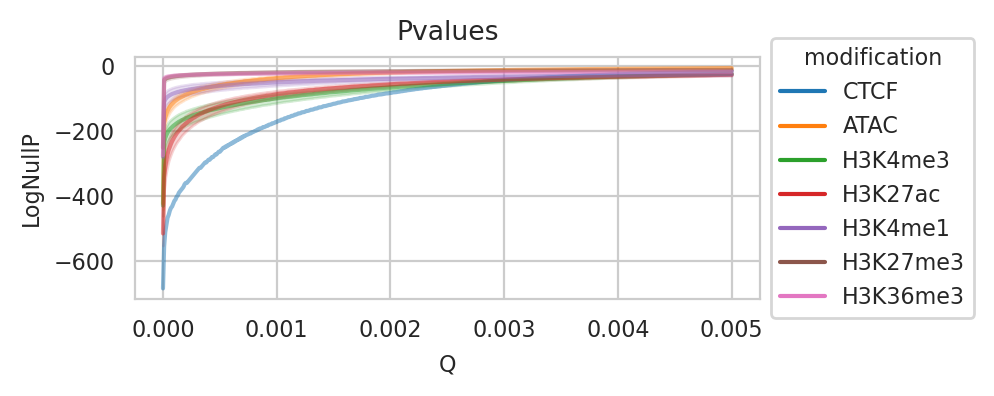

In [56]:
pvals_df['MinusLogNullP'] = -pvals_df['LogNullP']
plt.figure(figsize=(5, 2))
ax = plt.axes()
sns.lineplot(pvals_df[pvals_df['Q']<=0.005],
             x='Q', y='LogNullP',
             hue='modification',
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             alpha=0.5, errorbar=('se', .95),
             ax=ax)
ax.set_title('Pvalues')
# ax.set(yscale='log')
# ax.invert_xaxis()
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

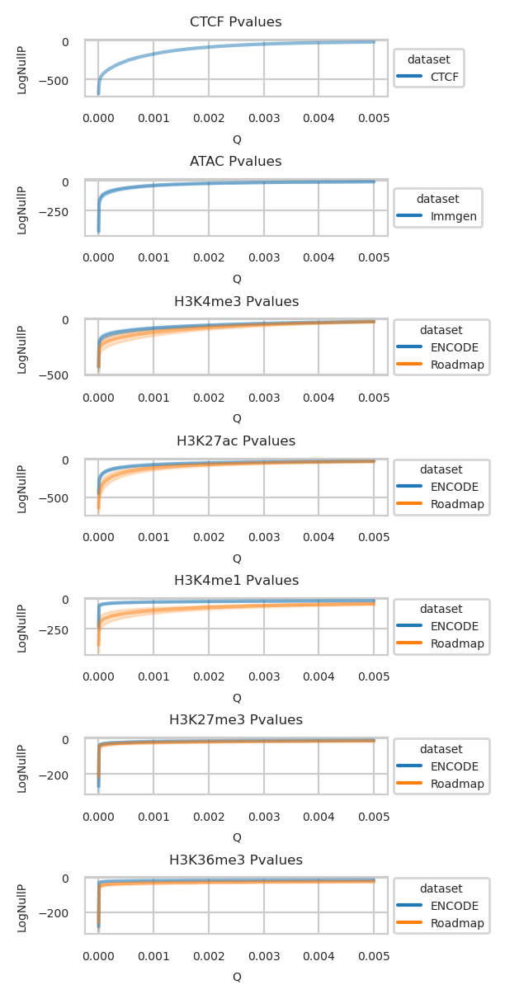

In [57]:
plt.rc('font', size=5)
plt.figure(figsize=(3, 6))
axs = [plt.subplot(7, 1, i + 1) for i in range(7)]
for i, m in enumerate(['CTCF', 'ATAC'] + MODIFICATIONS):
    ax = axs[i]
    sns.lineplot(pvals_df[(pvals_df['modification'] == m) & (pvals_df['dataset'] != '') & (pvals_df['Q'] <= 0.005)],
                 x='Q', y='LogNullP',
                 hue='dataset',
                 alpha=0.5, errorbar=('se', .95),
                 ax=ax)
    ax.set_title(f'{m} Pvalues')
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()
plt.rc('font', size=8)

# Summary

In [58]:
full_infos['effective_coverage'] = full_infos['coverage'] - full_infos['beta'] * full_infos['control_coverage'] * \
                                   full_infos['control_scale']

In [59]:
features = [
    'fit_out_down',
    'model_signal',
    'model_noise',
    'model_signal_to_noise',
    'log_null_pvals_mean',
    'log_null_pvals_std',
    'coverage',
    'control_coverage',
    'control_scale',
    'beta',
    'min_correlation',
    'coverage_non_zero',
    'coverage_max',
    'coverage_mean',
    'coverage_median',
    'coverage_std',
    'roughness',
    'signal_density',
    'noise_density',
    'signal_to_noise',
    'signal_to_control',
]

full_features = features + ['candidatesN', 'candidatesAL',
                            'minimal_signal_noise_ratio',
                            ]
full_infos[(full_infos['modification'] == 'H3K27me3') &
           (full_infos['replicate'] == '') &
           (full_infos['cell'].isin(['CD4', 'TCell', 'Monocyte']))][['modification', 'cell'] + full_features].T

,92,105,108
modification,H3K27me3,H3K27me3,H3K27me3
cell,CD4,Monocyte,TCell
fit_out_down,False,False,False
model_signal,1.226729,4.127886,3.773297
model_noise,0.710421,0.723792,0.891789
model_signal_to_noise,1.726763,5.703138,4.231156
log_null_pvals_mean,-0.72074,-0.772702,-0.624209
log_null_pvals_std,1.62825,4.364405,2.306169
coverage,18989630.0,22268090.0,25580326.0
control_coverage,42504376.0,20067586.0,35331275.0


In [60]:
full_infos[(full_infos['modification'] == 'H3K27ac') &
           (full_infos['cell'].isin(['CD4']))][['modification', 'cell'] + full_features].T

,103,107
modification,H3K27ac,H3K27ac
cell,CD4,CD4
fit_out_down,False,False
model_signal,6.313399,6.034595
model_noise,0.58773,0.55
model_signal_to_noise,10.742013,10.971987
log_null_pvals_mean,-0.647981,-0.211191
log_null_pvals_std,6.879832,3.154723
coverage,14516188.0,12359878.0
control_coverage,42504323.0,42504338.0


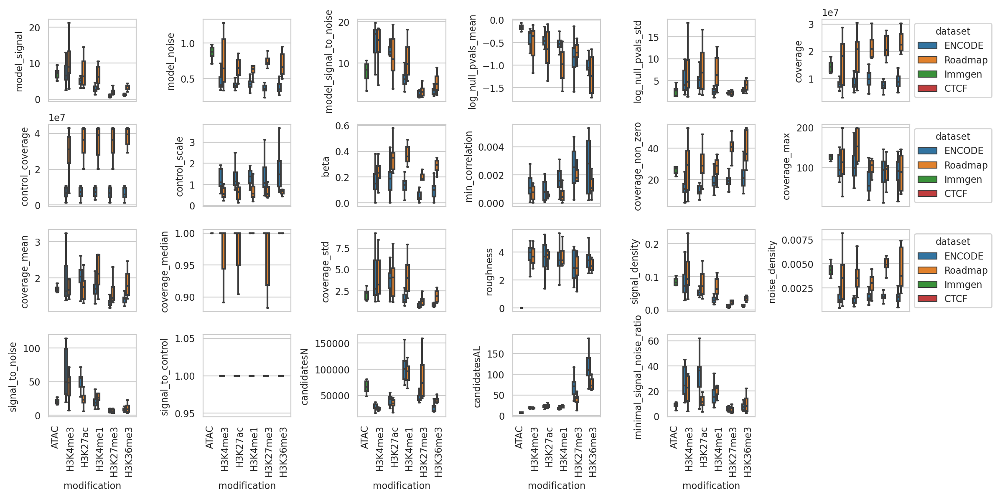

In [61]:
features = [
    'model_signal',
    'model_noise',
    'model_signal_to_noise',
    'log_null_pvals_mean',
    'log_null_pvals_std',
    'coverage',
    'control_coverage',
    'control_scale',
    'beta',
    'min_correlation',
    'coverage_non_zero',
    'coverage_max',
    'coverage_mean',
    'coverage_median',
    'coverage_std',
    'roughness',
    'signal_density',
    'noise_density',
    'signal_to_noise',
    'signal_to_control',
]

full_features = features + ['candidatesN', 'candidatesAL',
                            'minimal_signal_noise_ratio',
                            ]
ncols = int(math.ceil(math.sqrt(len(full_features) + 3)))
nrows = int(math.ceil(len(full_features) / ncols))
plt.figure(figsize=(2 * ncols, 1.5 * nrows))
axs = [plt.subplot(nrows, ncols, i + 1) for i in range(len(full_features))]
for i, y in enumerate(full_features):
    ax = axs[i]
    sns.boxplot(data=full_infos, x='modification', y=y, hue='dataset',
                order=['ATAC'] + MODIFICATIONS,
                showfliers=False,
                ax=ax)
    ax.xaxis.set_tick_params(rotation=90)
    if i < (nrows - 1) * ncols:
        ax.set_xlabel(None)
        ax.set_xticks([], minor=False)
        ax.set_xticklabels([])
    ax.xaxis.set_tick_params(rotation=90)
    if i % ncols == ncols - 1:
        sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
    else:
        ax.legend().set_visible(False)
plt.tight_layout()
plt.show()

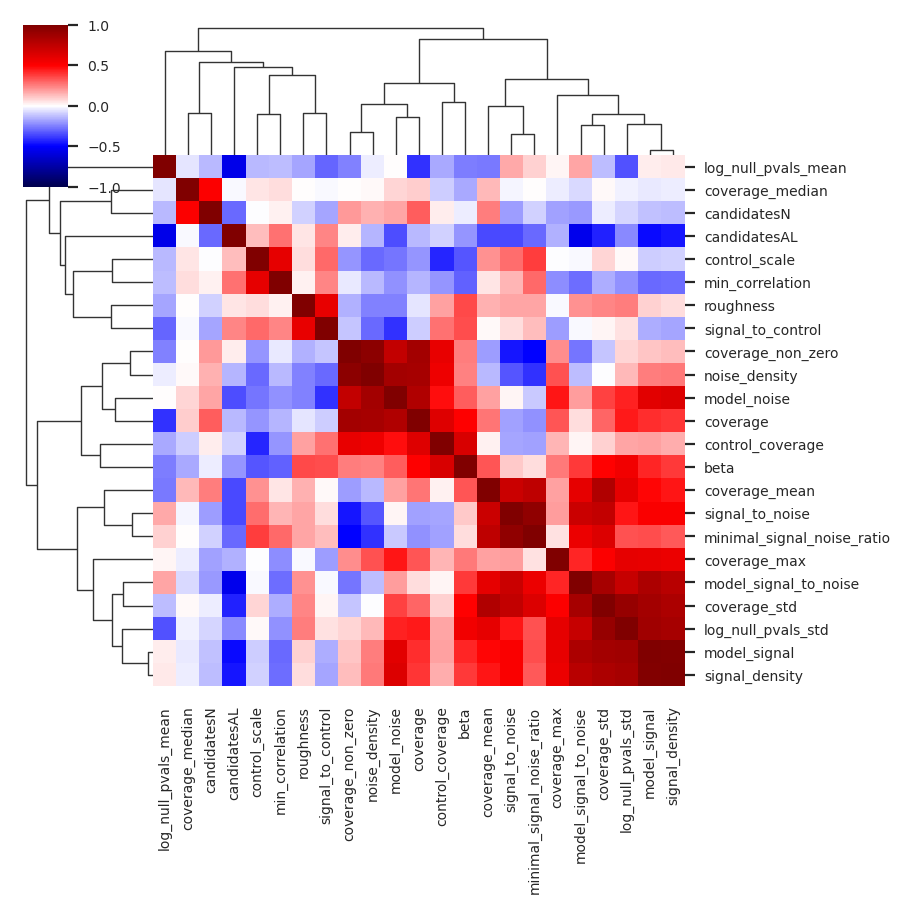

In [62]:
full_infos.fillna(0, inplace=True)
corrs = full_infos[full_features].corr(method='pearson').fillna(0)
plt.rc('font', size=5)
sns.clustermap(corrs,
               col_cluster=True, row_cluster=True,
               figsize=(4.5, 4.5),
               cmap=plt.cm.seismic,
               vmin=-1, vmax=1)
plt.show()
plt.rc('font', size=8)

In [63]:
# for m in MODIFICATIONS:
#     print(m)
#     corrs = full_infos[full_infos['modification'] == m][features].corr(method='spearman')
#     plt.rc('font', size=5)
#     sns.clustermap(corrs,
#                    col_cluster=True, row_cluster=True,
#                    figsize=(4, 4),
#                    cmap=plt.cm.seismic,
#                 vmin=-1, vmax=1)
#     plt.show()
#     plt.rc('font', size=8)

# Segments

In [64]:
import matplotlib.patches as mpatches


def d(a, b):
    return a / b if b != 0 else 0


def plot_segments(sdf, df, name, sp=None, ax=None, legend=True):
    sdf['New %'] = [d(n, t) * 100 for n, t in zip(sdf['New'], sdf['CandidatesN'])]
    sdf['Total %'] = 100
    axisnone = ax is None
    if ax is None:
        plt.figure(figsize=(8, 2))
        ax = plt.axes()
    # Background
    sns.barplot(sdf, x='Sensitivity', y='Total %',
                color='orange',
                alpha=0.5,
                ax=ax)
    # Foreground
    sns.barplot(sdf, x='Sensitivity', y='New %',
                color='blue',
                alpha=0.5,
                ax=ax)
    if df is not None:
        # assert len(sdf) == len(df) - 1
        df = df.sort_values(by=['Sensitivity'], ascending=False)
        ns = np.log1p(df['CandidatesN'])
        ns = ns * 80 / ns.max() + 10
        sns.lineplot(x=[len(df) - 1 - i for i in range(len(df))], y=ns,
                     color='black',
                     sort=False,
                     estimator=None,
                     ax=ax)
        als = np.log1p(df['CandidatesAL'])
        als = als * 80 / als.max() + 10
        sns.lineplot(x=[len(df) - 1 - i for i in range(len(df))], y=als,
                     color='brown',
                     sort=False,
                     estimator=None,
                     ax=ax)
        snrs = np.log1p(df['SignalNoiseRatio'])
        snrs = snrs * 80 / snrs.max() + 10
        sns.lineplot(x=[len(df) - 1 - i for i in range(len(df))], y=snrs,
                     color='green',
                     sort=False,
                     estimator=None,
                     ax=ax)

    ax.set_title(name)
    ax.set_ylabel('peaks %')

    # Limit ticks number
    # for i, label in enumerate(ax.get_xticklabels()):
    #     if axisnone and i not in tens_closest:
    #         label.set_visible(False)
    sens = np.array(sorted(sdf['Sensitivity']))
    tens_closest = {np.argmin(np.fabs(sens - x)): x for x in [-100, -10, -1, -0.1, -1e-2, -1e-3, -1e-4, -1e-6]}
    labels = [str(tens_closest[i]) if i in tens_closest else '' for i in range(len(ax.get_xticklabels()))]
    ax.set_xticklabels(labels)
    for i in tens_closest.keys():
        ax.axvline(x=i, ymin=0, ymax=90, color='grey', lw=0.5)

    # Points
    if sp is not None:
        ax.axvline(x=sp[2], ymin=0, ymax=90, color='blue', lw=2)
        ax.axvline(x=sp[1], ymin=0, ymax=90, color='red', lw=2)
        ax.axvline(x=sp[0], ymin=0, ymax=90, color='green', lw=2)
        # ax.axvline(x=int((sp[1] + sp[2]) / 2), ymin=0, ymax=90, color='grey', lw=2)

    # add legend
    if legend:
        top_bar = mpatches.Patch(color='orange', label='old %')
        bottom_bar = mpatches.Patch(color='blue', label='new %')
        ns = mpatches.Patch(color='black', label='number')
        if df is None:
            plt.legend(handles=[bottom_bar, top_bar, ns])
        else:
            als = mpatches.Patch(color='brown', label='avglen')
            snrs = mpatches.Patch(color='green', label='snr')
            plt.legend(handles=[bottom_bar, top_bar, ns, als, snrs])
        sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))

    new_value = 1
    for patch in ax.patches:
        current_width = patch.get_width()
        diff = current_width - new_value
        # we change the bar width
        patch.set_width(new_value)
        # we recenter the bar
        patch.set_x(patch.get_x() + diff * .5)
    if axisnone:
        plt.tight_layout()
        plt.show()

## Examples

In [65]:
out = StringIO('''Sensitivity	CandidatesN	New	Old
-244.44873046875023	0	0	0
-208.44618219312653	4	4	0
-177.7461097366783	4	0	4
-151.5675614401589	3	0	3
-129.2446046495714	3	0	3
-110.20938565155366	3	0	3
-93.97768455112971	3	0	3
-80.13659763529517	3	0	3
-68.33403388511132	3	0	3
-58.26975844747996	3	0	3
-49.687755229498414	3	0	3
-42.369714334268366	3	0	3
-36.129478670868686	3	0	3
-30.808308470774936	3	0	3
-26.270843248998407	3	0	3
-22.401658489888717	3	0	3
-19.10232946621292	3	0	3
-16.28892750063341	3	0	3
-13.88988497922152	3	0	3
-11.844174806997048	3	0	3
-10.099757994293048	5380	5377	3
-8.612259883485175	12041	7109	4932
-7.343841341802347	15787	4914	10873
-6.262236205503395	18210	3735	14475
-5.339930489823616	19074	2769	16305
-4.55346248534803	20296	2436	17860
-3.882825936589433	21456	2115	19341
-3.310961120765505	22731	2046	20685
-2.823320880783522	23909	1878	22031
-2.407500573134271	25035	1770	23265
-2.052922517270986	26230	1741	24489
-1.750566919463486	27388	1628	25760
-1.492742426340374	28673	1727	26946
-1.2728904714362317	29856	1635	28221
-1.085418437690804	31219	1759	29460
-0.9255573918703575	32569	1776	30793
-0.7892407719444762	33983	1863	32120
-0.6730009414551388	35435	1882	33553
-0.5738809794172248	36876	1910	34966
-0.4893594618527388	38574	2140	36434
-0.41728632154351275	40309	2214	38095
-0.3558281543960741	42076	2248	39828
-0.3034215811162494	44052	2494	41558
-0.25873347780290323	46162	2679	43483
-0.22062706380248456	48548	3000	45548
-0.18813298416367263	50999	3125	47874
-0.160424651084579	53773	3433	50340
-0.13679721708564901	56721	3717	53004
-0.11664964502563928	60077	4182	55895
-0.09946941885585443	63861	4702	59159
-0.08481950618320944	68011	5124	62887
-0.07232724099443222	72625	5724	66901
-0.061674843738977574	77628	6277	71351
-0.05259133761953	83454	7236	76218
-0.04484565545584697	89984	8153	81831
-0.03824076177362146	97833	9632	88201
-0.03260864059544484	106061	10329	95732
-0.027806021432773248	115297	11566	103731
-0.023710734756230607	126027	13336	112691
-0.020218604234322157	138021	15031	122990
-0.017240796685000632	151638	17133	134505
-0.014701562327875185	167960	20259	147701
-0.01253630785336248	186069	22584	163485
-0.010689953291310627	206670	25861	180809
-0.009115530880948493	229720	29374	200346
-0.007772990300066881	255546	33286	222260
-0.006628179860726588	285580	39622	245958
-0.005651977755042788	325012	50255	274757
-0.0048195512515854765	361229	48861	312368
-0.004109724997755826	411182	65118	346064
-0.003504442358948439	448980	55164	393816
-0.0029883060919887313	494098	64337	429761
-0.002548186668448022	551095	77726	473369
-0.00217288828432396	596883	68956	527927
-0.0018528640600054362	671341	100114	571227
-0.001579973185748914	740154	96672	643482
-0.0013472738349073784	804654	97163	707491
-0.0011488465770168415	910488	147621	762867
-9.796437987041038E-4	917867	97487	820380
-8.353613019689927E-4	1011938	164250	847688
-7.123288135447118E-4	1071163	180097	891066
-6.074166201020087E-4	1188603	187891	1000712
-5.179559542736199E-4	1600563	477562	1123001
-4.4167110627042506E-4	1500641	21	1500620
-3.7662153413741713E-4	1447536	0	1447536
-3.211525000441708E-4	1379132	0	1379132
-2.7385297689056014E-4	1292329	0	1292329
-2.3351975445156753E-4	1237696	0	1237696
-1.9912683198953363E-4	1176887	0	1176887
-1.697993187399131E-4	1100474	0	1100474
-1.4479117834835054E-4	1046992	0	1046992
-1.234662511197457E-4	957599	0	957599
-1.0528207132128658E-4	913323	0	913323
-8.977606788230846E-5	824495	0	824495
-7.655379746294278E-5	767380	0	767380
-6.527891056311377E-5	695013	0	695013
-5.566459542872183E-5	605118	0	605118
-4.7466282104195014E-5	509382	0	509382
-4.047542103633979E-5	350110	0	350110
-3.4514177968958406E-5	22	0	22''')
t = pd.read_csv(out, sep='\\t')
t.sample(3)

/tmp/ipykernel_3632833/1224463008.py:102: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  t = pd.read_csv(out, sep='\\t')


,Sensitivity,CandidatesN,New,Old
24,-5.339930,19074,2769,16305
59,-0.020219,138021,15031,122990
22,-7.343841,15787,4914,10873


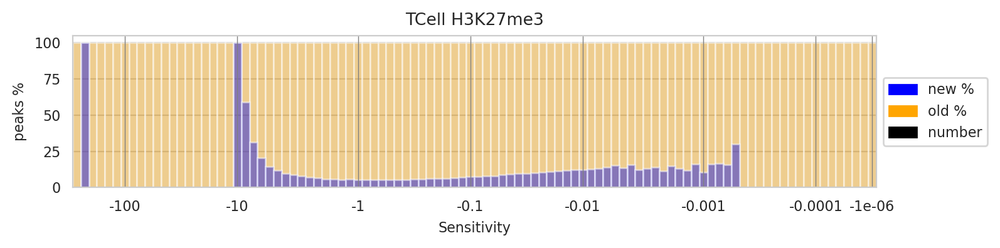

In [66]:
plot_segments(t, None, 'TCell H3K27me3', ax=None)

## From files

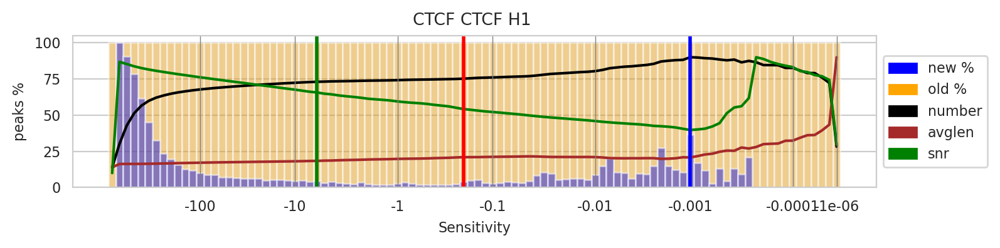

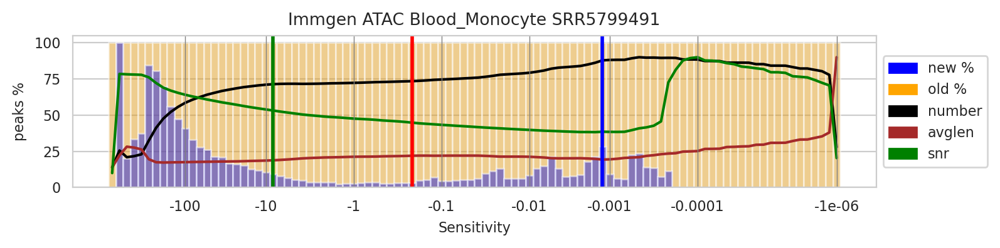

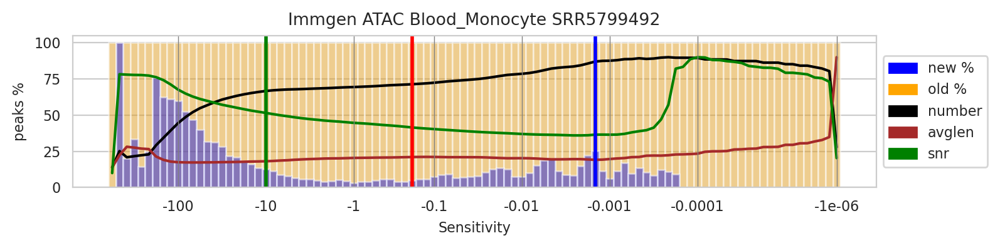

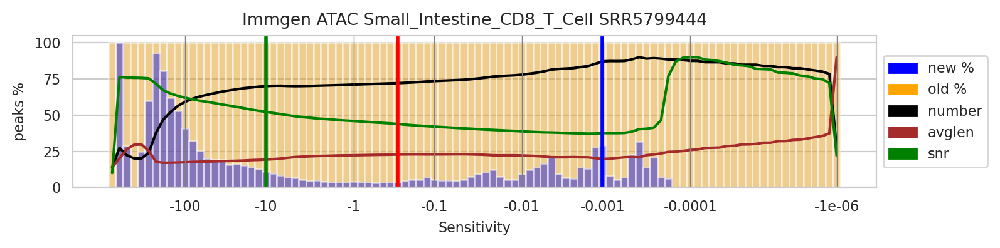

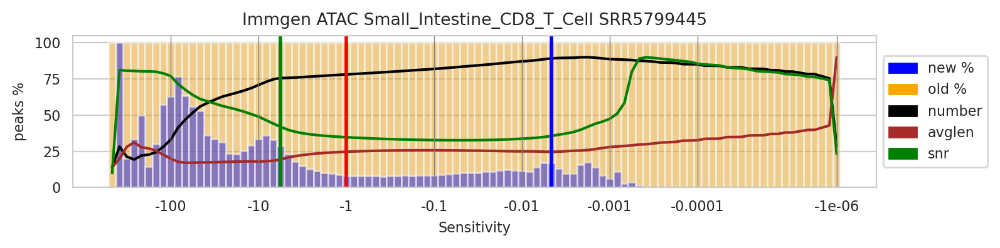

...

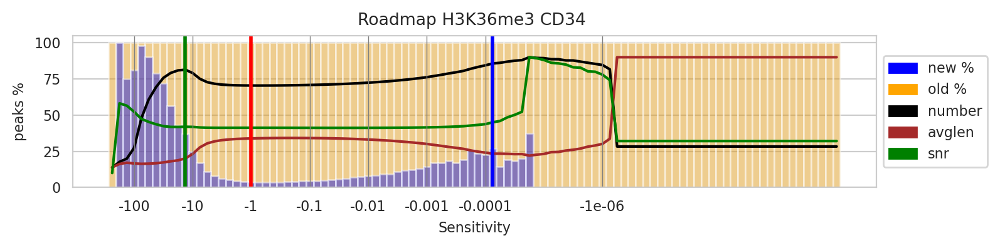

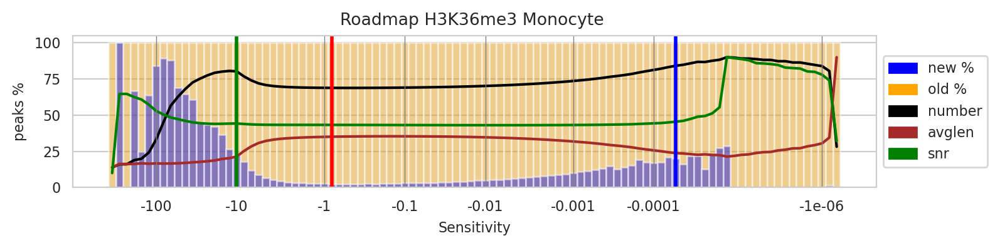

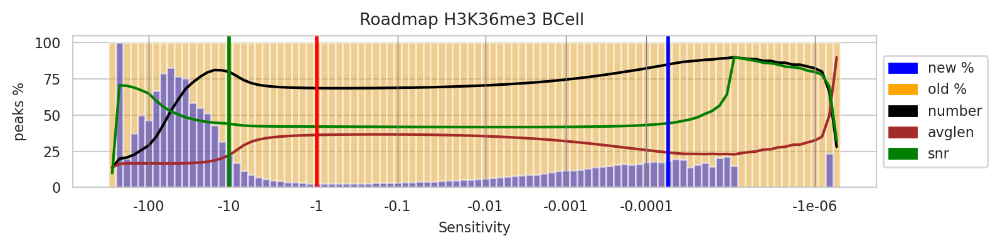

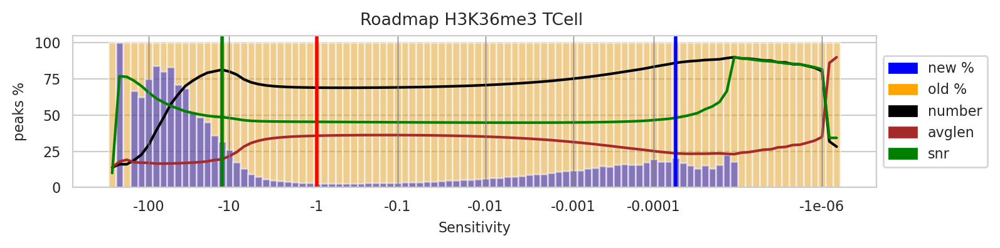

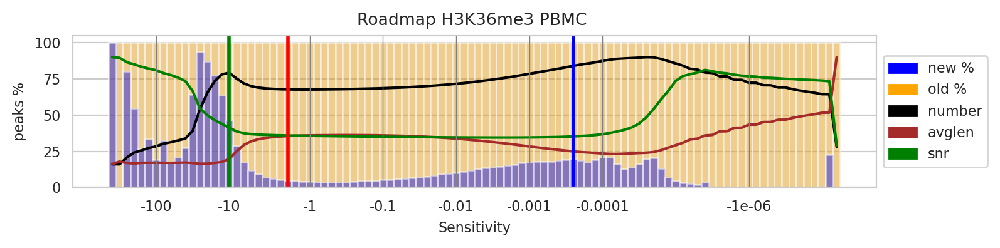

In [67]:
for (m, c, r, ds) in [
    ('CTCF', 'H1', '', 'CTCF'),
    ('ATAC', 'Blood_Monocyte', 'SRR5799491', 'Immgen'),
    ('ATAC', 'Blood_Monocyte', 'SRR5799492', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799444', 'Immgen'),
    ('ATAC', 'Small_Intestine_CD8_T_Cell', 'SRR5799445', 'Immgen'),
    ('H3K4me3', 'CD34', '', 'Roadmap'),
    ('H3K4me3', 'K562', 'rep1', 'ENCODE'),
    ('H3K4me3', 'CD34', 'rep2', 'Roadmap'),
    ('H3K4me3', 'CD4', '', 'Roadmap'),
    ('H3K27ac', 'K562', 'rep1', 'ENCODE'),
    ('H3K4me1', 'H1', 'rep1', 'ENCODE'),
    ('H3K4me1', 'H1', 'rep2', 'ENCODE'),
    ('H3K27me3', 'GM12878', 'rep2', 'ENCODE'),
    ('H3K27me3', 'NHLF', 'rep1', 'ENCODE'),
    ('H3K27me3', 'CD4', '', 'Roadmap'),
    ('H3K27me3', 'CD4', 'rep2', 'Roadmap'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    ('H3K27me3', 'BCell', '', 'Roadmap'),
    ('H3K27me3', 'PBMC', '', 'Roadmap'),
    ('H3K27me3', 'TCell', '', 'Roadmap'),
    ('H3K27me3', 'H1', 'rep1', 'ENCODE'),
    ('H3K27me3', 'HepG2', 'rep1', 'ENCODE'),
    ('H3K27me3', 'HepG2', 'rep2', 'ENCODE'),
    ('H3K36me3', 'CD4', '', 'Roadmap'),
    ('H3K36me3', 'CD4', 'rep1', 'Roadmap'),
    ('H3K36me3', 'GM12878', 'rep1', 'ENCODE'),
    ('H3K36me3', 'CD34', '', 'Roadmap'),
    ('H3K36me3', 'Monocyte', '', 'Roadmap'),
    ('H3K36me3', 'BCell', '', 'Roadmap'),
    ('H3K36me3', 'TCell', '', 'Roadmap'),
    ('H3K36me3', 'PBMC', '', 'Roadmap'),
]:
    t = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                         (full_sensitivity['modification'] == m) &
                         (full_sensitivity['cell'] == c) &
                         (full_sensitivity['replicate'] == r) &
                         (full_sensitivity['Gap'] == 0)]
    if len(t['file'].unique()) != 1:
        continue
    segments = t['file'].values[0].replace('.sensitivity.tsv', '.segments.tsv')
    if not os.path.exists(segments):
        continue
    sdf = pd.read_csv(segments, sep='\t')
    # Hack with indexing
    # sdf['Sensitivity'] = sorted(sdf['Sensitivity'])
    name = f'{ds} {m} {c} {r}'
    sp = sps[name] if name in sps else None
    plot_segments(sdf, t, name, sp)

## Per modification

In [68]:
ts = []
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                                 (full_sensitivity['modification'] == m) &
                                 (full_sensitivity['Gap'] == 0)]
        for (cell, rep), t in dfdsm.groupby(['cell', 'replicate']):
            if len(t['file'].unique()) != 1:
                continue
            segments = t['file'].values[0].replace('.sensitivity.tsv', '.segments.tsv')
            if not os.path.exists(segments):
                continue
            sdf = pd.read_csv(segments, sep='\t')
            sdf['dataset'] = ds
            sdf['modification'] = m
            sdf['cell'] = cell
            sdf['replicate'] = rep
            sdf['SensitivityN'] = range(len(sdf))
            ts.append(sdf)
segments_df = pd.concat(ts).reset_index(drop=True)
segments_df['New %'] = [d(n, t) * 100 for n, t in zip(segments_df['New'], segments_df['CandidatesN'])]
del ts
segments_df.fillna(0, inplace=True)
segments_df.sample(5)

ENCODE CTCF
Roadmap CTCF
Immgen CTCF
CTCF CTCF
ENCODE ATAC
Roadmap ATAC
Immgen ATAC
CTCF ATAC
ENCODE H3K4me3
Roadmap H3K4me3
Immgen H3K4me3
CTCF H3K4me3
ENCODE H3K27ac
Roadmap H3K27ac
Immgen H3K27ac
CTCF H3K27ac
ENCODE H3K4me1
Roadmap H3K4me1
Immgen H3K4me1
CTCF H3K4me1
ENCODE H3K27me3
Roadmap H3K27me3
Immgen H3K27me3
CTCF H3K27me3
ENCODE H3K36me3
Roadmap H3K36me3
Immgen H3K36me3
CTCF H3K36me3


,Sensitivity,CandidatesN,New,Old,dataset,modification,cell,replicate,SensitivityN,New %
2394,-4.332324e-10,25,0,25,ENCODE,H3K4me3,NHEK,rep2,94,0.000000
1845,-7.030695e-02,31767,764,31003,ENCODE,H3K4me3,Huvec,rep1,45,2.405011
406,-1.919799e+02,266,213,53,Immgen,ATAC,Blood_Monocyte,SRR5799494,6,80.075188
6985,-2.857062e-04,1308362,0,1308362,ENCODE,H3K4me1,HSMM,rep1,85,0.000000
13593,-3.412965e-07,82436,0,82436,Roadmap,H3K36me3,CD4,,93,0.000000


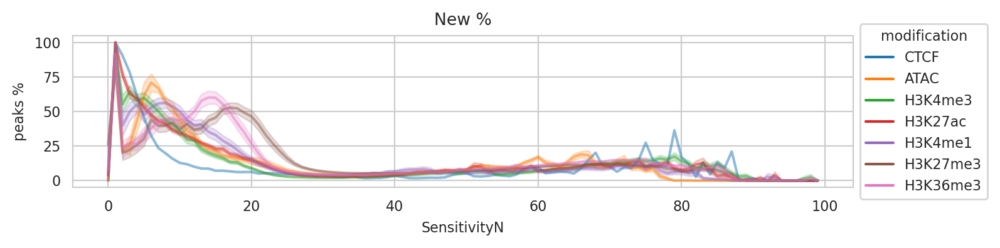

In [69]:
plt.figure(figsize=(8, 2))
ax = plt.axes()
sns.lineplot(segments_df,
             x='SensitivityN', y='New %',
             hue='modification',
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             alpha=0.5, errorbar=('se', .95),
             ax=ax)
ax.set_ylabel('peaks %')
ax.set_title('New %')
# ax.set(xscale='log')
# ax.invert_xaxis()
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))

plt.tight_layout()
plt.show()

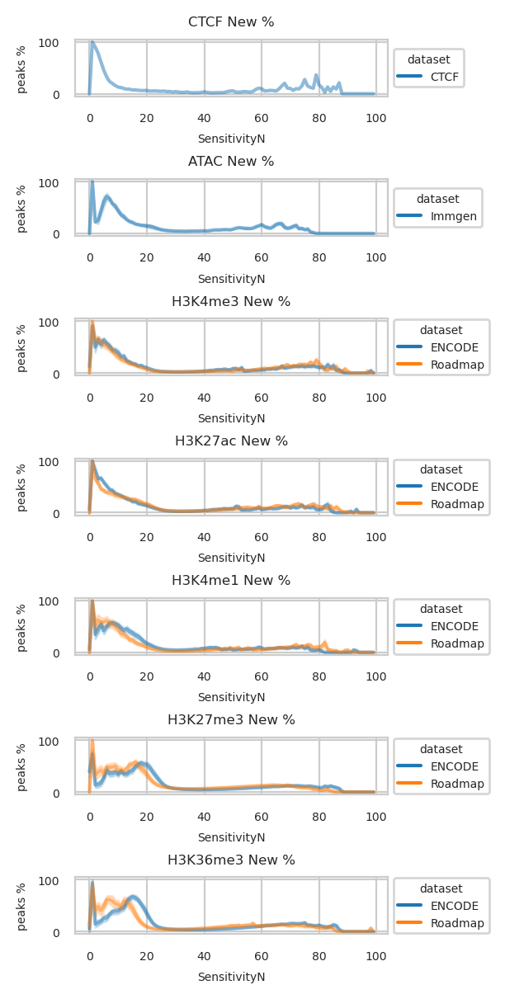

In [70]:
plt.rc('font', size=5)
plt.figure(figsize=(3, 6))
axs = [plt.subplot(7, 1, i + 1) for i in range(7)]
for i, m in enumerate(['CTCF', 'ATAC'] + MODIFICATIONS):
    ax = axs[i]
    sns.lineplot(segments_df[segments_df['modification'] == m],
                 x='SensitivityN', y='New %',
                 hue='dataset',
                 alpha=0.5, errorbar=('se', .95),
                 ax=ax)
    ax.set_ylabel('peaks %')
    ax.set_title(f'{m} New %')
    # ax.set(xscale='log')
    # ax.invert_xaxis()
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))

plt.tight_layout()
plt.show()
plt.rc('font', size=8)

## Individual

In [71]:
# import plotly.express as px
#
# segments_df['experiment'] = segments_df['dataset'] + ' ' + segments_df['cell'] + ' ' + segments_df['replicate']
#
# plt.rc('font', size=4)
# # for m in ['ATAC'] + MODIFICATIONS:
# for m in ['ATAC']:
#     dfm = segments_df[segments_df['modification'] == m]
#     if len(dfm) == 0:
#         continue
#     fig = px.line(dfm, x='SensitivityN', y='New %', color='experiment',
#                   hover_data=['experiment', 'Sensitivity', 'New %'],
#                   log_x=True,
#                   title=f'{m} New %',
#                   width=1000, height=400)
#     fig.show()
# plt.rc('font', size=8)

## All

ENCODE CTCF
0


<Figure size 100x200 with 0 Axes>

Roadmap CTCF
0


<Figure size 100x200 with 0 Axes>

Immgen CTCF
0


<Figure size 100x200 with 0 Axes>

CTCF CTCF
1


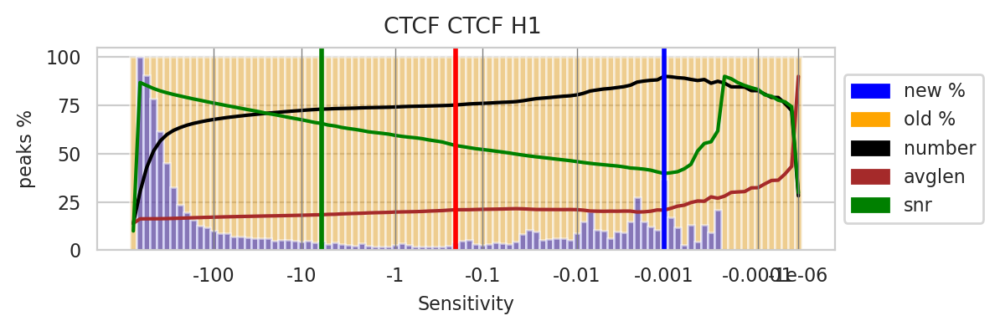

ENCODE ATAC
0


<Figure size 100x200 with 0 Axes>

Roadmap ATAC
0


<Figure size 100x200 with 0 Axes>

Immgen ATAC
8


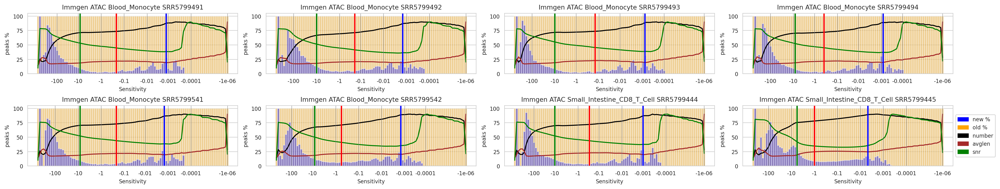

CTCF ATAC
0


<Figure size 100x200 with 0 Axes>

ENCODE H3K4me3
16


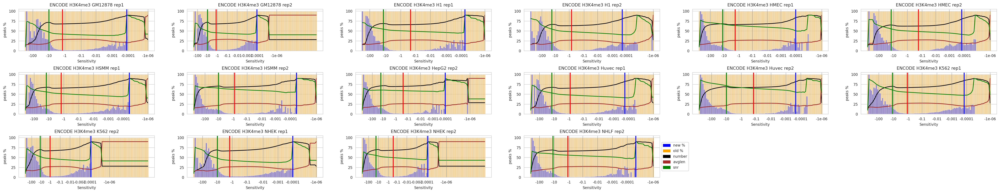

Roadmap H3K4me3
12


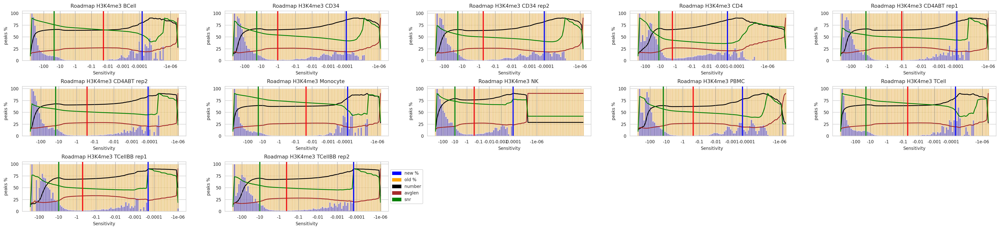

Immgen H3K4me3
0


<Figure size 100x200 with 0 Axes>

CTCF H3K4me3
0


<Figure size 100x200 with 0 Axes>

ENCODE H3K27ac
17


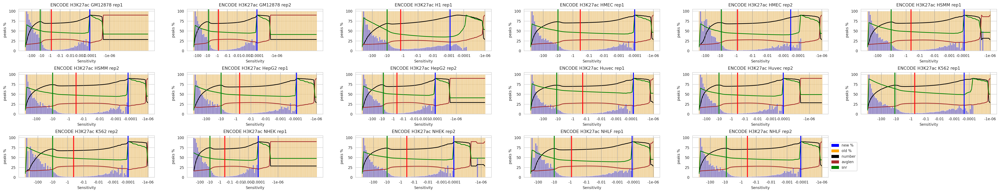

Roadmap H3K27ac
9


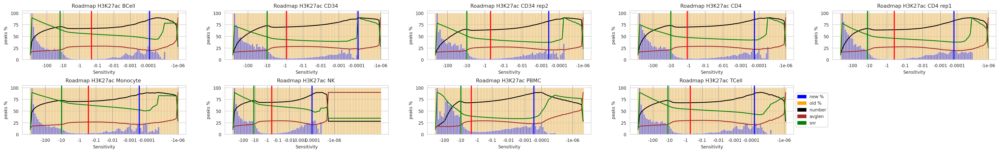

Immgen H3K27ac
0


<Figure size 100x200 with 0 Axes>

CTCF H3K27ac
0


<Figure size 100x200 with 0 Axes>

ENCODE H3K4me1
17


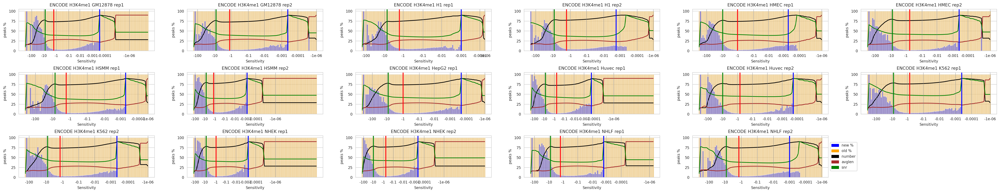

Roadmap H3K4me1
8


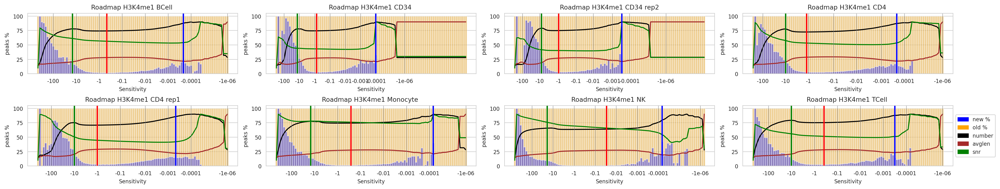

Immgen H3K4me1
0


<Figure size 100x200 with 0 Axes>

CTCF H3K4me1
0


<Figure size 100x200 with 0 Axes>

ENCODE H3K27me3
18


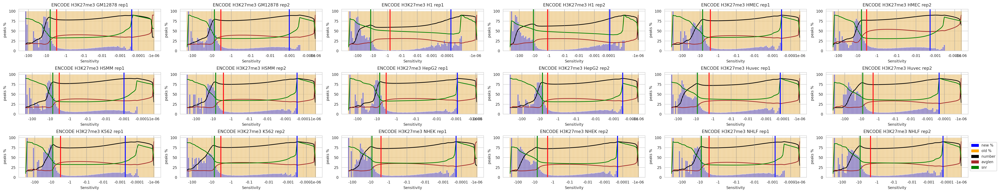

Roadmap H3K27me3
9


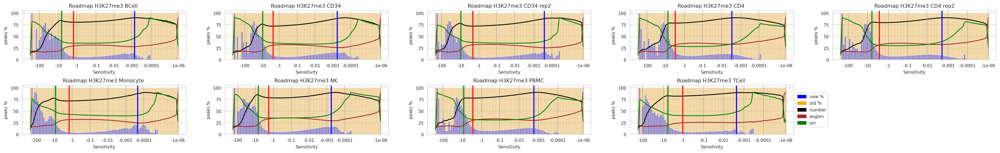

Immgen H3K27me3
0


<Figure size 100x200 with 0 Axes>

CTCF H3K27me3
0


<Figure size 100x200 with 0 Axes>

ENCODE H3K36me3
17


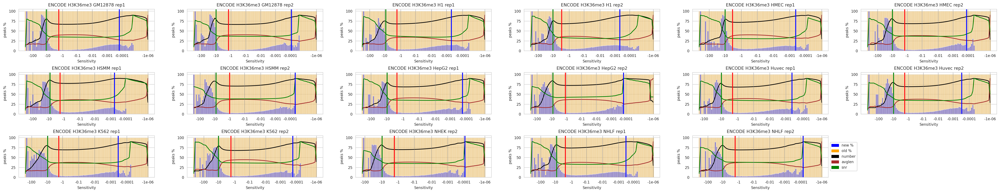

Roadmap H3K36me3
8


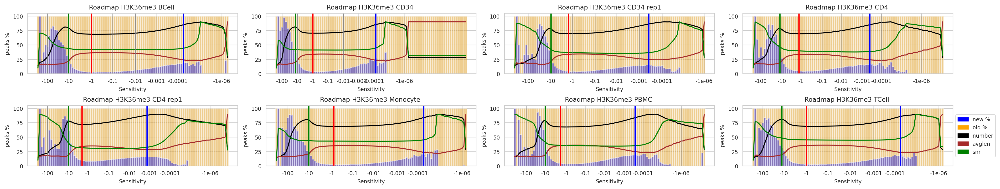

Immgen H3K36me3
0


<Figure size 100x200 with 0 Axes>

CTCF H3K36me3
0


<Figure size 100x200 with 0 Axes>

In [72]:
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = segments_df[(segments_df['dataset'] == ds) &
                            (segments_df['modification'] == m)]
        n = min(len(dfdsm[['cell', 'replicate']].copy().drop_duplicates()), 18)
        print(n)
        if n <= 6:
            ncols, nrows = n, 1
        else:
            ncols = int(math.floor(math.sqrt(n) + 2))
            nrows = int(math.ceil(n / ncols))
        plt.figure(figsize=(5 * ncols + 1, 2 * nrows))
        axs = [plt.subplot(nrows, ncols, i + 1) for i in range(n)]
        for i, ((cell, rep), sdf) in enumerate(dfdsm.groupby(['cell', 'replicate'])):
            if i == 18:
                break
            t = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                                 (full_sensitivity['modification'] == m) &
                                 (full_sensitivity['cell'] == cell) &
                                 (full_sensitivity['replicate'] == rep) &
                                 (full_sensitivity['Gap'] == 0)]
            ax = axs[i]
            name = f'{ds} {m} {cell} {rep}'
            sp = sps[name] if name in sps else None
            if i == n - 1:
                plot_segments(sdf, t, name, sp, ax, True)
                sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
            else:
                plot_segments(sdf, t, name, sp, ax, False)
        plt.tight_layout()
        plt.show()

# Coverage

## TCell H3K27me3 scores

In [73]:
out = StringIO('''Q	Coverage
1	1.101189395318887
2	1.101189395318887
3	1.171189395318887
4	1.171189395318887
5	1.171189395318887
6	1.171189395318887
7	1.171189395318887
8	1.2411893953188868
9	1.2411893953188868
10	1.2411893953188868
11	1.2411893953188868
12	1.2411893953188868
13	1.2411893953188868
14	1.2411893953188868
15	1.2411893953188868
16	1.2411893953188868
17	1.2411893953188868
18	1.2411893953188868
19	1.311189395318887
20	1.311189395318887
21	1.311189395318887
22	1.311189395318887
23	1.311189395318887
24	1.311189395318887
25	1.311189395318887
26	1.311189395318887
27	1.311189395318887
28	1.311189395318887
29	1.311189395318887
30	1.311189395318887
31	1.311189395318887
32	1.311189395318887
33	1.311189395318887
34	1.311189395318887
35	1.381189395318887
36	1.381189395318887
37	1.381189395318887
38	1.381189395318887
39	1.381189395318887
40	1.381189395318887
41	1.381189395318887
42	1.381189395318887
43	1.381189395318887
44	1.381189395318887
45	1.381189395318887
46	1.381189395318887
47	1.381189395318887
48	1.381189395318887
49	1.381189395318887
50	2.4823787906377737
51	2.552378790637774
52	2.552378790637774
53	2.622378790637774
54	2.622378790637774
55	2.622378790637774
56	2.622378790637774
57	2.692378790637774
58	2.692378790637774
59	2.692378790637774
60	2.692378790637774
61	2.692378790637774
62	2.692378790637774
63	2.692378790637774
64	2.762378790637774
65	2.762378790637774
66	2.762378790637774
67	2.762378790637774
68	2.762378790637774
69	2.762378790637774
70	2.762378790637774
71	3.933568185956661
72	4.003568185956661
73	4.003568185956661
74	4.003568185956661
75	4.073568185956661
76	4.073568185956661
77	4.073568185956661
78	4.073568185956661
79	4.143568185956661
80	4.143568185956661
81	4.143568185956661
82	5.244757581275548
83	5.384757581275548
84	5.384757581275548
85	5.4547575812755476
86	5.4547575812755476
87	5.524757581275548
88	5.524757581275548
89	6.695946976594435
90	6.8359469765944345
91	6.8359469765944345
92	6.905946976594435
93	8.147136371913321
94	8.217136371913321
95	8.287136371913322
96	9.598325767232208
97	10.909515162551095
98	12.360704557869983
99	16.294272743826642
100	144.1096440897587''')
t1 = pd.read_csv(out, sep='\\t')
t1.sample(3)

/tmp/ipykernel_3632833/48342798.py:102: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  t1 = pd.read_csv(out, sep='\\t')


,Q,Coverage
61,62,2.692379
32,33,1.311189
0,1,1.101189


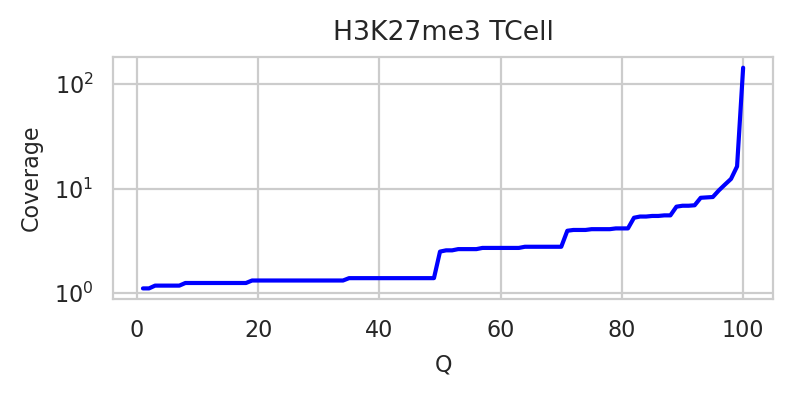

In [74]:
plt.figure(figsize=(4, 2))
ax = plt.axes()
sns.lineplot(t1, x='Q', y='Coverage',
             color='blue',
             ax=ax)
ax.set(yscale='log')
ax.set_title('H3K27me3 TCell')
plt.tight_layout()
plt.show()

## Monocyte H3K27me3 scores

In [75]:
out = StringIO('''Q	Coverage
1	0.3674968528850454
2	0.3674968528850454
3	0.3674968528850454
4	0.5783312352566969
5	0.5783312352566969
6	0.5783312352566969
7	0.5783312352566969
8	0.5783312352566969
9	0.5783312352566969
10	0.5783312352566969
11	0.5783312352566969
12	0.5783312352566969
13	0.7891656176283485
14	0.7891656176283485
15	0.7891656176283485
16	0.7891656176283485
17	0.7891656176283485
18	0.7891656176283485
19	0.7891656176283485
20	0.7891656176283485
21	0.7891656176283485
22	0.7891656176283485
23	0.7891656176283485
24	0.7891656176283485
25	0.7891656176283485
26	0.7891656176283485
27	0.7891656176283485
28	0.7891656176283485
29	0.7891656176283485
30	0.7891656176283485
31	0.7891656176283485
32	0.7891656176283485
33	1.0
34	1.0
35	1.0
36	1.0
37	1.0
38	1.0
39	1.0
40	1.0
41	1.0
42	1.0
43	1.0
44	1.0
45	1.0
46	1.0
47	1.0
48	1.0
49	1.0
50	1.0
51	1.0
52	1.0
53	1.0
54	1.0
55	1.0
56	1.0
57	1.0
58	1.0
59	1.0
60	1.0
61	1.0
62	1.0
63	1.3674968528850453
64	1.3674968528850453
65	1.578331235256697
66	1.578331235256697
67	1.578331235256697
68	1.7891656176283486
69	1.7891656176283486
70	1.7891656176283486
71	1.7891656176283486
72	1.7891656176283486
73	1.7891656176283486
74	1.7891656176283486
75	2.0
76	2.0
77	2.0
78	2.0
79	2.0
80	2.0
81	2.0
82	2.0
83	2.0
84	2.156662470513394
85	2.578331235256697
86	2.7891656176283486
87	2.7891656176283486
88	2.7891656176283486
89	3.0
90	3.0
91	3.0
92	3.578331235256697
93	3.7891656176283486
94	4.0
95	4.578331235256697
96	5.0
97	6.367496852885045
98	8.789165617628349
99	14.0
100	68.53735837982705''')
t1 = pd.read_csv(out, sep='\\t')
t1.sample(3)

/tmp/ipykernel_3632833/2446333002.py:102: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  t1 = pd.read_csv(out, sep='\\t')


,Q,Coverage
52,53,1.000000
99,100,68.537358
9,10,0.578331


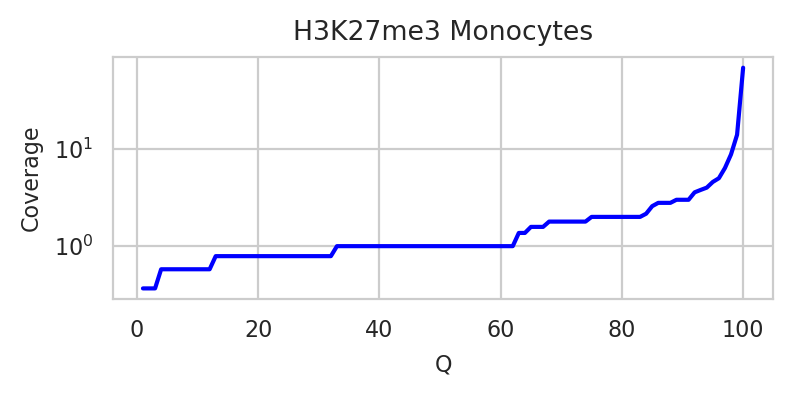

In [76]:
plt.figure(figsize=(4, 2))
ax = plt.axes()
sns.lineplot(t1, x='Q', y='Coverage',
             color='blue',
             ax=ax)
ax.set(yscale='log')
ax.set_title('H3K27me3 Monocytes')
plt.tight_layout()
plt.show()

## Monocyte CD4 scores

In [77]:
out = StringIO('''Q	Coverage
1	0.8205303096321184
2	1.0171085913600988
3	1.213686873088079
4	1.213686873088079
5	1.213686873088079
6	1.213686873088079
7	1.213686873088079
8	1.4102651548160592
9	1.4102651548160592
10	1.4102651548160592
11	1.4102651548160592
12	1.4102651548160592
13	1.4102651548160592
14	1.4102651548160592
15	1.4102651548160592
16	1.4102651548160592
17	1.6068434365440396
18	1.6068434365440396
19	1.6068434365440396
20	1.6068434365440396
21	1.6068434365440396
22	1.6068434365440396
23	1.6068434365440396
24	1.6068434365440396
25	1.6068434365440396
26	1.6068434365440396
27	1.6068434365440396
28	1.6068434365440396
29	1.6068434365440396
30	1.6068434365440396
31	1.6068434365440396
32	1.8034217182720198
33	1.8034217182720198
34	1.8034217182720198
35	1.8034217182720198
36	1.8034217182720198
37	1.8034217182720198
38	1.8034217182720198
39	1.8034217182720198
40	1.8034217182720198
41	1.8034217182720198
42	1.8034217182720198
43	1.8034217182720198
44	1.8034217182720198
45	1.8034217182720198
46	1.8034217182720198
47	1.8034217182720198
48	1.8034217182720198
49	1.8034217182720198
50	1.8034217182720198
51	2.0
52	2.0
53	2.0
54	2.0
55	2.0
56	2.0
57	2.0
58	2.0
59	2.0
60	2.0
61	2.0
62	2.0
63	2.0
64	2.0
65	2.8205303096321184
66	3.213686873088079
67	3.213686873088079
68	3.4102651548160594
69	3.4102651548160594
70	3.4102651548160594
71	3.4102651548160594
72	3.6068434365440396
73	3.6068434365440396
74	3.6068434365440396
75	3.6068434365440396
76	3.6068434365440396
77	3.6068434365440396
78	3.6068434365440396
79	3.80342171827202
80	3.80342171827202
81	3.80342171827202
82	3.80342171827202
83	3.80342171827202
84	3.80342171827202
85	4.0
86	4.0
87	4.0
88	4.0
89	4.0
90	5.213686873088079
91	5.410265154816059
92	5.60684343654404
93	5.60684343654404
94	5.80342171827202
95	5.80342171827202
96	6.0
97	6.0
98	7.60684343654404
99	8.0
100	245.3337880504351''')
t2 = pd.read_csv(out, sep='\\t')
t2.sample(3)

/tmp/ipykernel_3632833/3830963150.py:102: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  t2 = pd.read_csv(out, sep='\\t')


,Q,Coverage
2,3,1.213687
74,75,3.606843
9,10,1.410265


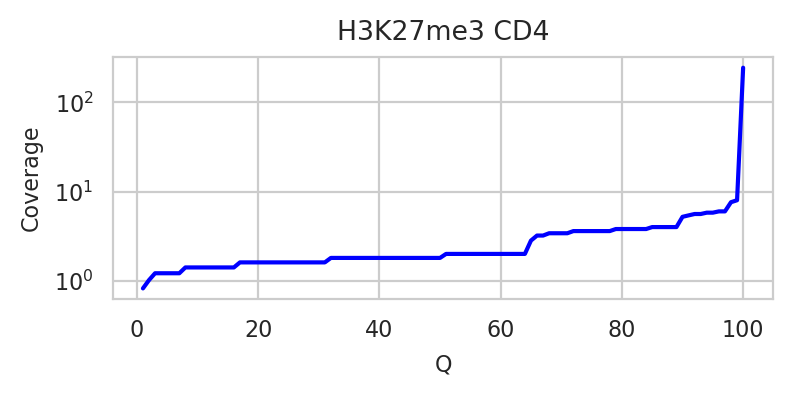

In [78]:
plt.figure(figsize=(4, 2))
ax = plt.axes()
sns.lineplot(t2, x='Q', y='Coverage',
             color='blue',
             ax=ax)
ax.set(yscale='log')
ax.set_title('H3K27me3 CD4')
plt.tight_layout()
plt.show()

## From files

In [79]:
ts = []
for m in ['CTCF', 'ATAC'] + MODIFICATIONS:
    for ds in ['ENCODE', 'Roadmap', 'Immgen', 'CTCF']:
        print(ds, m)
        dfdsm = full_sensitivity[(full_sensitivity['dataset'] == ds) &
                                 (full_sensitivity['modification'] == m) &
                                 (full_sensitivity['Gap'] == 0)]
        for (cell, rep), t in dfdsm.groupby(['cell', 'replicate']):
            if len(t['file'].unique()) != 1:
                continue
            assert len(t['file'].unique()) == 1
            cov = t['file'].values[0].replace('.sensitivity.tsv', '.coverage.tsv')
            if not os.path.exists(cov):
                continue
            t = pd.read_csv(cov, sep='\t')
            t['dataset'] = ds
            t['modification'] = m
            t['cell'] = cell
            t['replicate'] = rep
            ts.append(t)
cov_df = pd.concat(ts).reset_index(drop=True)
del ts
cov_df['CoverageI'] = cov_df['Coverage'].astype(int)
cov_df.sample(5)

ENCODE CTCF
Roadmap CTCF
Immgen CTCF
CTCF CTCF
ENCODE ATAC
Roadmap ATAC
Immgen ATAC
CTCF ATAC
ENCODE H3K4me3
Roadmap H3K4me3
Immgen H3K4me3
CTCF H3K4me3
ENCODE H3K27ac
Roadmap H3K27ac
Immgen H3K27ac
CTCF H3K27ac
ENCODE H3K4me1
Roadmap H3K4me1
Immgen H3K4me1
CTCF H3K4me1
ENCODE H3K27me3
Roadmap H3K27me3
Immgen H3K27me3
CTCF H3K27me3
ENCODE H3K36me3
Roadmap H3K36me3
Immgen H3K36me3
CTCF H3K36me3


,Q,Coverage,dataset,modification,cell,replicate,CoverageI
11802,3,0.926705,ENCODE,H3K36me3,H1,rep2,0
8872,73,1.000000,ENCODE,H3K27me3,GM12878,rep1,1
2169,70,1.000000,ENCODE,H3K4me3,K562,rep2,1
971,72,1.000000,ENCODE,H3K4me3,GM12878,rep1,1
13938,39,0.778601,Roadmap,H3K36me3,TCell,,0


In [80]:
# for (m, c, r, ds) in [
#     ('H3K36me3', 'CD4', '', 'Roadmap'),
# ]:
#     cov = cov_df[(cov_df['dataset'] == ds) &
#                  (cov_df['modification'] == m) &
#                  (cov_df['cell'] == c) &
#                  (cov_df['replicate'] == r)]
#     display(cov)

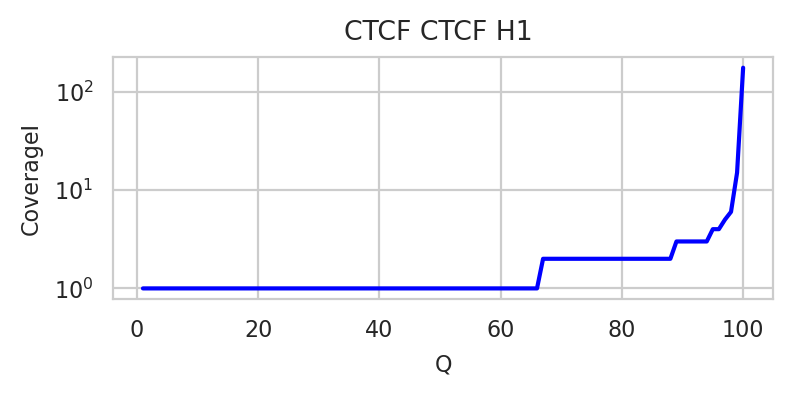

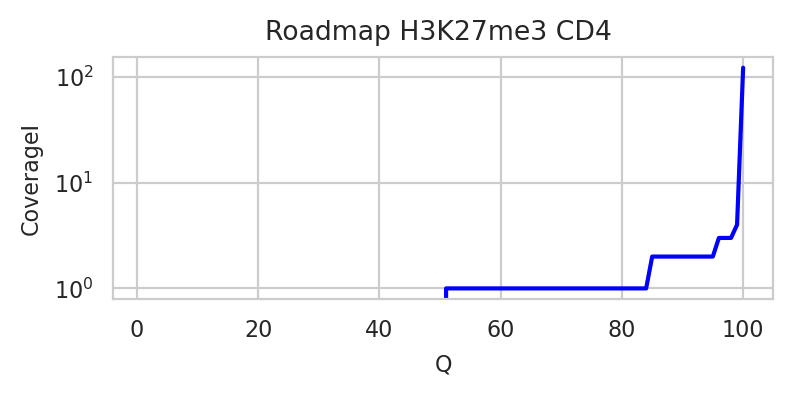

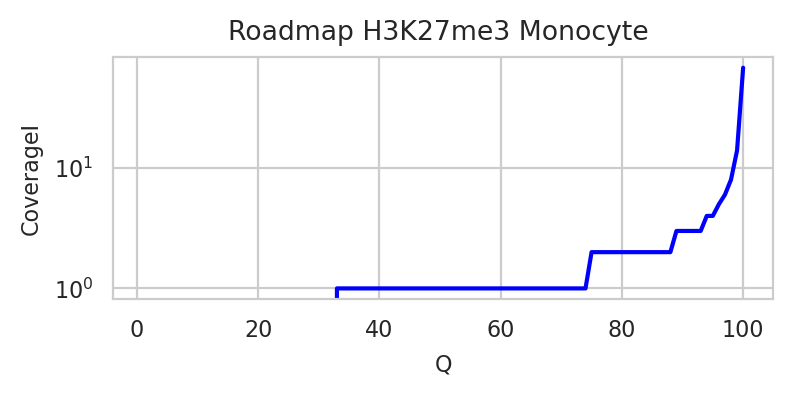

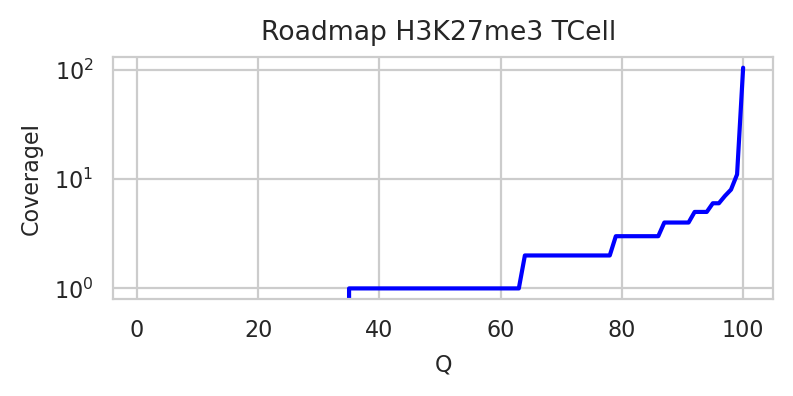

In [81]:
for (m, c, r, ds) in [
    ('CTCF', 'H1', '', 'CTCF'),
    # ('ATAC', 'Blood_Monocyte', '', 'Immgen'),
    # ('H3K4me3', 'CD34', '', 'Roadmap'),
    # ('H3K4me3', 'CD34', 'rep2', 'Roadmap'),
    # ('H3K4me3', 'CD4', '', 'Roadmap'),
    # ('H3K27ac', 'K562', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep2', 'ENCODE'),
    # ('H3K27me3', 'NHLF', 'rep1', 'ENCODE'),
    ('H3K27me3', 'CD4', '', 'Roadmap'),
    # ('H3K27me3', 'CD4', 'rep2', 'Roadmap'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K27me3', 'BCell', '', 'Roadmap'),
    # ('H3K27me3', 'PBMC', '', 'Roadmap'),
    ('H3K27me3', 'TCell', '', 'Roadmap'),
    # ('H3K27me3', 'H1', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep2', 'ENCODE'),
    # ('H3K36me3', 'CD4', '', 'Roadmap'),
    # ('H3K36me3', 'CD4', 'rep1', 'Roadmap'),
    # ('H3K36me3', 'GM12878', 'rep1', 'ENCODE'),
    # ('H3K36me3', 'CD34', '', 'Roadmap'),
    # ('H3K36me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K36me3', 'BCell', '', 'Roadmap'),
    # ('H3K36me3', 'TCell', '', 'Roadmap'),
    # ('H3K36me3', 'PBMC', '', 'Roadmap'),
]:
    cov = cov_df[(cov_df['dataset'] == ds) &
                 (cov_df['modification'] == m) &
                 (cov_df['cell'] == c) &
                 (cov_df['replicate'] == r)]
    plt.figure(figsize=(4, 2))
    ax = plt.axes()
    sns.lineplot(cov, x='Q', y='CoverageI',
                 color='blue',
                 ax=ax)
    ax.set(yscale='log')
    ax.set_title(f'{ds} {m} {c} {r}')
    plt.tight_layout()
    plt.show()

## QQs

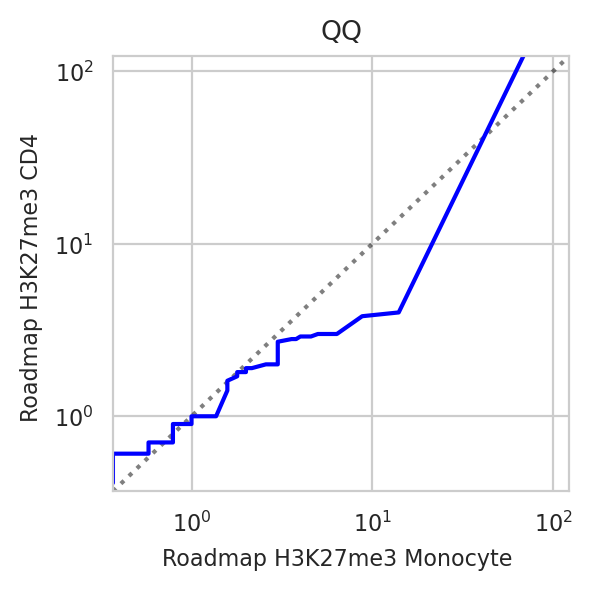

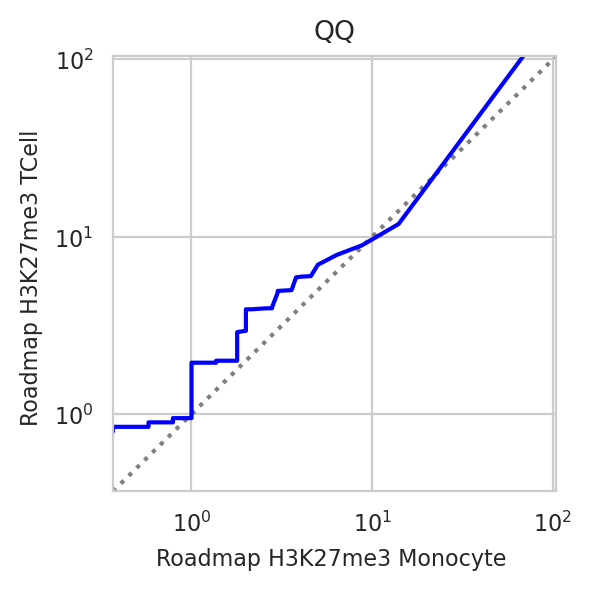

In [82]:
covs = []
for (m, c, r, ds) in [
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    ('H3K27me3', 'CD4', '', 'Roadmap'),
    ('H3K27me3', 'TCell', '', 'Roadmap')
]:
    covs.append((f'{ds} {m} {c} {r}',
                 cov_df[(cov_df['dataset'] == ds) &
                        (cov_df['modification'] == m) &
                        (cov_df['cell'] == c) &
                        (cov_df['replicate'] == r)]))

for i, j in [(0, 1), (0, 2)]:
    n1, t1 = covs[i]
    n2, t2 = covs[j]
    plt.figure(figsize=(3, 3))
    ax = plt.axes()
    minxy = min(t1['Coverage'].min(), t2['Coverage'].min())
    maxxy = max(t1['Coverage'].max(), t2['Coverage'].max())
    sns.lineplot(x=[minxy, maxxy], y=[minxy, maxxy], ax=ax, color='black', alpha=0.5, linestyle='dotted')
    sns.lineplot(x=t1['Coverage'].tolist(), y=t2['Coverage'].tolist(),
                 color='blue',
                 sort=False, estimator=None,
                 ax=ax)
    ax.set(xscale='log')
    ax.set(yscale='log')
    ax.set_xlim(minxy, maxxy)
    ax.set_ylim(minxy, maxxy)
    ax.set_xlabel(n1)
    ax.set_ylabel(n2)
    ax.set_title('QQ')
    plt.tight_layout()
    plt.show()

## All

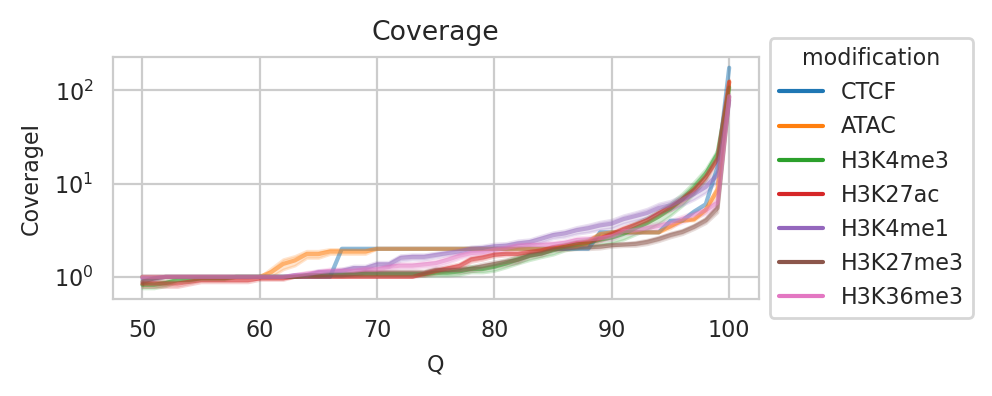

In [83]:
plt.figure(figsize=(5, 2))
ax = plt.axes()
sns.lineplot(cov_df[cov_df['Q'] >= 50],
             x='Q', y='CoverageI',
             hue='modification',
             hue_order=['CTCF', 'ATAC'] + MODIFICATIONS,
             alpha=0.5, errorbar=('se', .95),
             ax=ax)
ax.set_title('Coverage')
ax.set(yscale='log')
sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

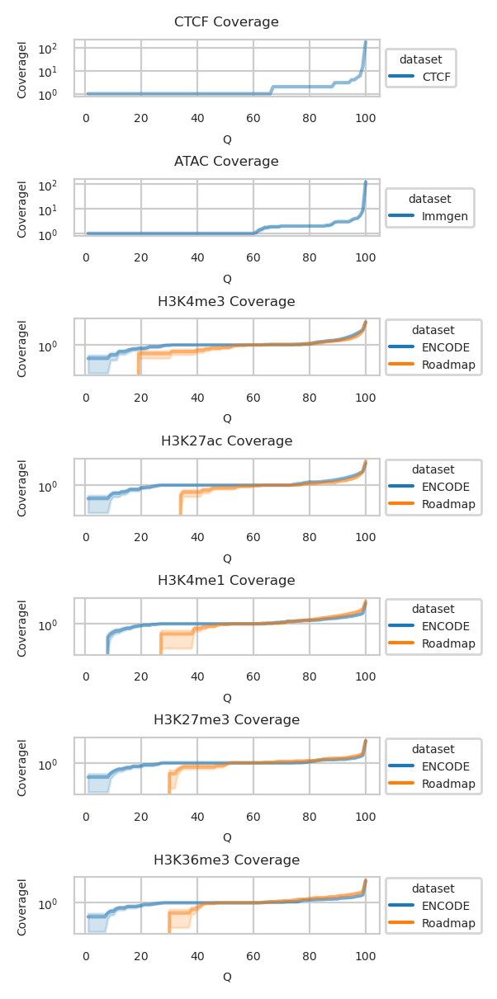

In [84]:
plt.rc('font', size=5)
plt.figure(figsize=(3, 6))
axs = [plt.subplot(7, 1, i + 1) for i in range(7)]
for i, m in enumerate(['CTCF', 'ATAC'] + MODIFICATIONS):
    ax = axs[i]
    sns.lineplot(cov_df[cov_df['modification'] == m],
                 x='Q', y='CoverageI',
                 hue='dataset',
                 alpha=0.5, errorbar=('se', .95),
                 ax=ax)
    ax.set_title(f'{m} Coverage')
    ax.set(yscale='log')
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()
plt.rc('font', size=8)

# Candidates from bw coverage

In [519]:
CHROM_SIZES = {
    c: s for _, (c, s) in pd.read_csv(os.path.join(GSE26320_PATH, 'hg38.chrom.sizes'),
                                      sep='\t', names=['chr', 'size']).iterrows() if '_' not in c
}


def load_bws(path, modification, cells, replicates, control='Input'):
    df_bws = pd.DataFrame(columns=['file', 'modification', 'cell', 'replicate'], dtype=object)
    for f in tqdm(os.listdir(path)):
        if '.bw' not in f:
            continue
        mod = next((m for m in modification if m in f), None)
        if mod is None and control is not None and control in f:
            mod = 'Control'
        cell = next((c for c in cells if c in f), None)
        rep = next((r for r in replicates if r in f), None)
        if mod and cell and rep is not None:
            df_bws.loc[len(df_bws)] = ((os.path.join(path, f)), mod, cell, rep)
    return df_bws

In [520]:
encode_bws = load_bws(GSE26320_PATH + '/bw', MODIFICATIONS, GSE26320_CELLS, GSE26320_REPS, 'Input')
encode_bws['dataset'] = 'ENCODE'
display(encode_bws.sample(3))

immune_bws = load_bws(IMMUNE_PATH + '/bw', MODIFICATIONS, IMMUNE_CELLS, IMMUNE_REPS, 'Control')
immune_bws['dataset'] = 'Roadmap'
display(immune_bws.sample(3))
all_bws = pd.concat([encode_bws, immune_bws]).reset_index(drop=False)

  0%|          | 0/103 [00:00<?, ?it/s]

,file,modification,cell,replicate,dataset
43,/home/jetbrains/data/2023_GSE26320/bw/GSM64643...,H3K27ac,K562,rep1,ENCODE
54,/home/jetbrains/data/2023_GSE26320/bw/GSM64639...,H3K27ac,HSMM,rep2,ENCODE
26,/home/jetbrains/data/2023_GSE26320/bw/GSM64645...,H3K27me3,NHEK,rep2,ENCODE


  0%|          | 0/56 [00:00<?, ?it/s]

,file,modification,cell,replicate,dataset
51,/home/jetbrains/data/2023_Immune/bw/NK_H3K27ac...,H3K27ac,NK,,Roadmap
33,/home/jetbrains/data/2023_Immune/bw/NK_H3K27me...,H3K27me3,NK,,Roadmap
12,/home/jetbrains/data/2023_Immune/bw/PBMC_H3K36...,H3K36me3,PBMC,,Roadmap


In [521]:
import pyBigWig

total_coverages = {}
ts = []
for _, (ds, m, c, r) in tqdm(list(all_bws[['dataset', 'modification', 'cell', 'replicate']].iterrows())):
    print(ds, m, c, r)
    t = all_bws[(all_bws['modification'] == m) &
                (all_bws['cell'] == c) &
                (all_bws['replicate'] == r) &
                (all_bws['dataset'] == ds)]
    if len(t) == 0:
        continue
    bw_path = t['file'].values[0]
    # print(bw_path)

    try:
        with pyBigWig.open(bw_path) as bw:
            total_coverage = sum(
                bw.stats(chr, exact=True, type='sum')[0] for chr in CHROM_SIZES.keys() if '_' not in chr)
            print('Total coverage', total_coverage)
            # Multiplier to align BAM coverage with BigWig estimation
            total_coverage *= 1.1e-2
            total_coverages[(ds, m, c, r)] = total_coverage
    except Exception:
        pass
        # print('ERROR')

total_coverages_df = pd.DataFrame([(ds, m, c, r, n) for (ds, m, c, r), n in total_coverages.items()],
                                  columns=['dataset', 'modification', 'cell', 'replicate', 'reads'])
total_coverages_df.sample(5)

  0%|          | 0/159 [00:00<?, ?it/s]

ENCODE Control HSMM rep1
Total coverage 894815013.0
ENCODE H3K4me1 GM12878 rep1
Total coverage 1068252750.0
ENCODE H3K4me3 NHLF rep2
Total coverage 751052700.0
ENCODE H3K27me3 HepG2 rep2
Total coverage 469869319.0
ENCODE H3K27ac K562 rep2
Total coverage 407297750.0
ENCODE H3K27ac NHLF rep2
Total coverage 605669500.0
ENCODE H3K27ac HepG2 rep1
Total coverage 592156369.0
ENCODE H3K27me3 NHLF rep2
Total coverage 654364600.0
ENCODE H3K4me1 NHLF rep1
Total coverage 369591300.0
ENCODE H3K27ac NHLF rep1
Total coverage 642197319.0
ENCODE H3K4me1 HMEC rep2
Total coverage 1111280200.0
ENCODE H3K27me3 HSMM rep2
Total coverage 684649207.0
ENCODE H3K27ac HepG2 rep2
Total coverage 417082519.0
ENCODE H3K36me3 HepG2 rep1
Total coverage 472956238.0
ENCODE H3K36me3 Huvec rep1
Total coverage 598335100.0
ENCODE H3K36me3 HMEC rep1
Total coverage 633591700.0
ENCODE H3K27ac NHEK rep2
Total coverage 734185750.0
ENCODE H3K36me3 HMEC rep2
Total coverage 763466200.0
ENCODE Control GM12878 rep1
Total coverage 5629

,dataset,modification,cell,replicate,reads
146,Roadmap,H3K27ac,BCell,,1.967860e+07
51,ENCODE,H3K27ac,HMEC,rep2,7.214477e+06
126,Roadmap,H3K27me3,PBMC,,2.779984e+07
62,ENCODE,H3K27ac,HSMM,rep1,9.423520e+06
96,ENCODE,Control,H1,rep2,2.772636e+06


In [522]:
# Prepare BAM files
WD = os.path.expanduser('~/data/2023_wiggle')

BLACKLIST_PATH = WD + '/hg38-blacklist.v2.bed'
blacklist_df = pd.read_csv(BLACKLIST_PATH, sep='\t', header=None)
blacklist_df.rename({0: 'chr', 1: 'start', 2: 'end'}, axis=1, inplace=True)
blacklist_df

,chr,start,end,3
0,chr10,0,45700,Low Mappability
1,chr10,38481300,38596500,High Signal Region
2,chr10,38782600,38967900,High Signal Region
3,chr10,39901300,41712900,High Signal Region
4,chr10,41838900,42107300,High Signal Region
...,...,...,...,...
631,chrY,4343800,4345800,High Signal Region
632,chrY,10246200,11041200,High Signal Region
633,chrY,11072100,11335300,High Signal Region
634,chrY,11486600,11757800,High Signal Region


In [523]:
def collect_bw_stats(bw_path, chrom_sizes, blacklist, region_len, top_regions, work_regions, resolution):
    print('Prepare chromosome indexes')
    chr_indx = {}
    indx = 0
    for chr, chr_size in chrom_sizes.items():
        if '_' in chr:
            continue
        bins = int(math.floor(chr_size / region_len))
        chr_indx[chr] = (indx, indx + bins)
        indx += bins
    chromosomes = list(chr_indx.keys())

    print('Compute coverage in regions')
    region_coverages = np.zeros(indx)
    with pyBigWig.open(bw_path) as bw:
        for chr, (istart, iend) in chr_indx.items():
            region_coverages[istart: iend] = \
                np.array(
                    [x or 0 for x in bw.stats(chr, 1, CHROM_SIZES[chr], nBins=iend - istart, exact=True, type='sum')])

    print('Processing blacklisted regions')
    blacklist_marked = 0
    for chr, start, end in zip(blacklist['chr'], blacklist['start'], blacklist['end']):
        if chr not in chr_indx:
            continue
        offset = chr_indx[chr][0]
        for x in range(int(math.floor(start / region_len)), int(math.ceil(end / region_len)) + 1):
            region_coverages[min(x - offset, len(region_coverages) - 1)] = 0
            blacklist_marked += 1
    print(f'Marked {blacklist_marked} / {len(region_coverages)} bins as blacklist')

    if top_regions > len(region_coverages):
        raise Exception(f'Too many top regions {top_regions} > {len(region_coverages)}')

    print('Split by chromosomes')
    chr_xs = [[] for _ in range(len(chr_indx))]  # Create new array for each chromosome index
    ichr = 0
    for x in np.sort(np.argpartition(region_coverages, -top_regions)[-top_regions:]):
        while chr_indx[chromosomes[ichr]][1] < x:
            ichr += 1
        chr_xs[ichr].append(x)

    print('Collect final regions')
    peaks = []
    for ichr, xs in enumerate(chr_xs):
        chr = chromosomes[ichr]
        offset = chr_indx[chr][0]
        for i, x in enumerate(xs):
            peaks.append((chr, (x - offset) * region_len, (x + 1 - offset) * region_len))
    df = pd.DataFrame(peaks, columns=['chromosome', 'start', 'end'])
    if len(df) > work_regions:
        print(f'Pick {work_regions} / {top_regions} uniform regions for computation speedup')
        step = int(math.ceil(len(df) / float(work_regions)))
        df = df.iloc[range(0, len(df), step)].copy()

    print('Collecting bigwig stats')
    region_stats = []
    with pyBigWig.open(bw_path) as bw:
        for _, (chr, start, end) in df.iterrows():
            stats = np.array(
                bw.stats(chr, start, end, nBins=int(math.ceil((end - start) / resolution)), exact=True, type='sum'))
            region_stats.append(stats)
    return df, region_stats

In [524]:
REGION_LEN = 20_000
TOP_REGIONS = 10_000
WORK_REGIONS = 1000
RESOLUTION = 100

# Compute on top chromosomes for speed
chrom_sizes_part = {f'chr{i + 1}': CHROM_SIZES[f'chr{i + 1}'] for i in range(3)}

## Candidates calling from ModelToPeaks.kt

In [525]:
def next_clear_bit(arr, start):
    for i in range(start, len(arr)):
        if not arr[i]:
            return i
    return -1


def next_set_bit(arr, start):
    for i in range(start, len(arr)):
        if arr[i]:
            return i
    return -1


def set_bits(arr, start, end):
    for i in range(start, end):
        arr[i] = True


# Copy of BitList.aggregate
def aggregate(arr, gap=0):
    ranges = []
    offset = 0
    while offset < len(arr):
        left = next_set_bit(arr, offset)
        if left == -1:
            break
        right = min(next_clear_bit(arr, left + 1), len(arr))
        if right == -1:
            break
        while gap > 0 and right < len(arr):
            next_set = next_set_bit(arr, right + 1)
            if next_set != -1 and next_set - right <= gap:
                right = min(next_clear_bit(arr, next_set + 1), len(arr))
            else:
                break
        ranges.append((left, right))
        offset = right
    return ranges

In [526]:
def call_candidates(bins, gap):
    candidates = aggregate(bins)
    if len(candidates) == 0:
        return candidates
    last_end = -1
    for (start, end) in candidates:
        if last_end != -1:
            if start - last_end < gap:
                set_bits(bins, last_end, start)
        last_end = end

    candidates = aggregate(bins)
    for (start, end) in candidates:
        assert start < end, f'{start} >= {end}\n{bins}'
    return candidates


def analyze_candidates(coverages, fdr=0.05):
    rows = []
    bins = np.ndarray(len(coverages), dtype='bool')
    for s in np.exp(np.linspace(-8, 1, 100) * math.log(10)):
        cq = np.percentile(coverages, 100 * (1.0 - s * fdr))
        for gap in [0]:
            for i in range(len(bins)):
                bins[i] = coverages[i] >= cq
            candidates = call_candidates(bins, gap)
            avg_len = sum((end - start) for (start, end) in candidates) / len(candidates) if len(candidates) > 0 else 0
            rows.append((s, gap, len(candidates), avg_len))
    df = pd.DataFrame(rows, columns=['Sensitivity', 'Gap', 'CandidatesN', 'CandidatesAL'])
    return df

## Visualization

In [527]:
def plot_candidates(t, title=None):
    plt.figure(figsize=(5, 4))
    ax = plt.axes()
    sns.lineplot(data=t, x="CandidatesN", y="CandidatesAL", hue='Gap', estimator=None,
                 # marker='o', markersize=3,
                 palette='tab20',
                 sort=False,
                 ax=ax)
    ax.set(yscale='log')
    ax.set(xscale='log')
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
    if title:
        plt.title(title)
    plt.tight_layout()
    plt.show()

## Examples

Prepare chromosome indexes
Compute coverage in regions
Processing blacklisted regions
Marked 2076 / 34470 bins as blacklist
Split by chromosomes
Collect final regions
Pick 1000 / 10000 uniform regions for computation speedup


,Sensitivity,Gap,CandidatesN,CandidatesAL
0,1.000000e-08,0,2,1.0
1,1.232847e-08,0,2,1.0
2,1.519911e-08,0,2,1.0
3,1.873817e-08,0,2,1.0
4,2.310130e-08,0,2,1.0
5,2.848036e-08,0,2,1.0
6,3.511192e-08,0,2,1.0
7,4.328761e-08,0,2,1.0
8,5.336699e-08,0,2,1.0
9,6.579332e-08,0,2,1.0


,Sensitivity,Gap,CandidatesN,CandidatesAL
80,0.187382,0,395,4.789873
81,0.231013,0,451,5.345898
82,0.284804,0,499,5.753507
83,0.351119,0,618,5.697411
84,0.432876,0,905,4.827624
85,0.533670,0,2561,2.694260
86,0.657933,0,2561,2.694260
87,0.811131,0,5891,1.909523
88,1.000000,0,5891,1.909523
89,1.232847,0,13026,1.642254


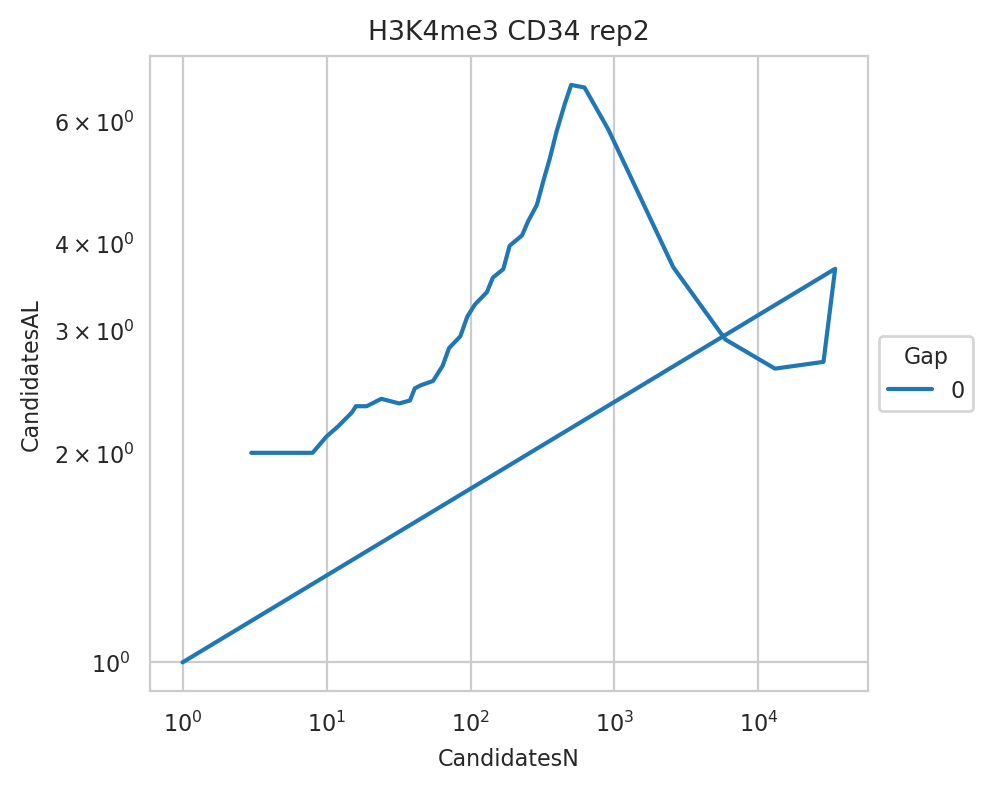

CandidatesN


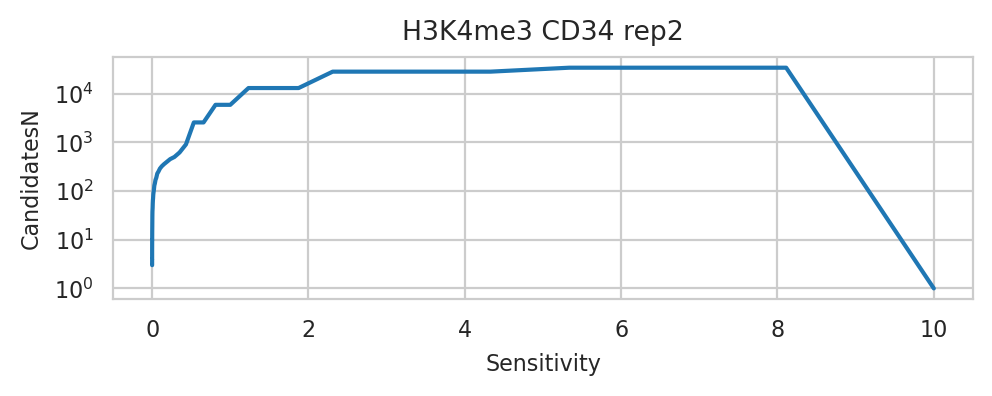

CandidatesAL


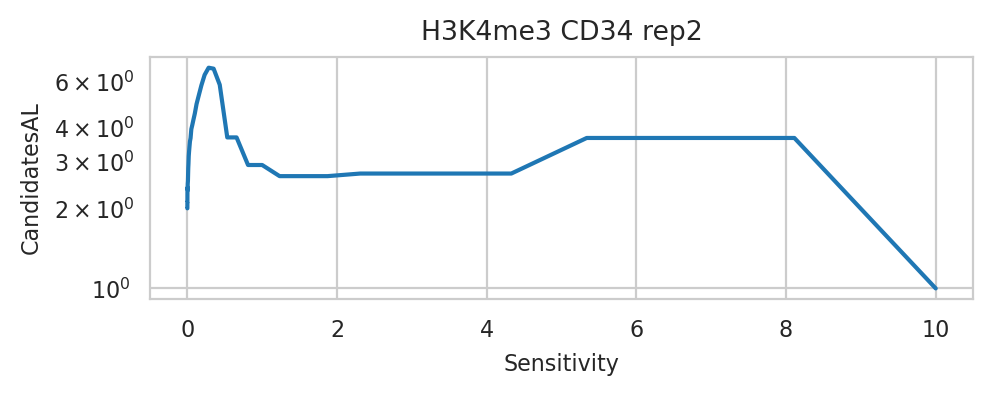

Prepare chromosome indexes
Compute coverage in regions
Processing blacklisted regions
Marked 2076 / 34470 bins as blacklist
Split by chromosomes
Collect final regions
Pick 1000 / 10000 uniform regions for computation speedup


,Sensitivity,Gap,CandidatesN,CandidatesAL
0,1.000000e-08,0,1,1.0
1,1.232847e-08,0,1,1.0
2,1.519911e-08,0,1,1.0
3,1.873817e-08,0,1,1.0
4,2.310130e-08,0,1,1.0
5,2.848036e-08,0,1,1.0
6,3.511192e-08,0,1,1.0
7,4.328761e-08,0,1,1.0
8,5.336699e-08,0,1,1.0
9,6.579332e-08,0,1,1.0


,Sensitivity,Gap,CandidatesN,CandidatesAL
80,0.187382,0,2319,1.100043
81,0.231013,0,2319,1.100043
82,0.284804,0,5037,1.134802
83,0.351119,0,5037,1.134802
84,0.432876,0,5037,1.134802
85,0.533670,0,5037,1.134802
86,0.657933,0,10267,1.200156
87,0.811131,0,10267,1.200156
88,1.000000,0,10267,1.200156
89,1.232847,0,19187,1.327566


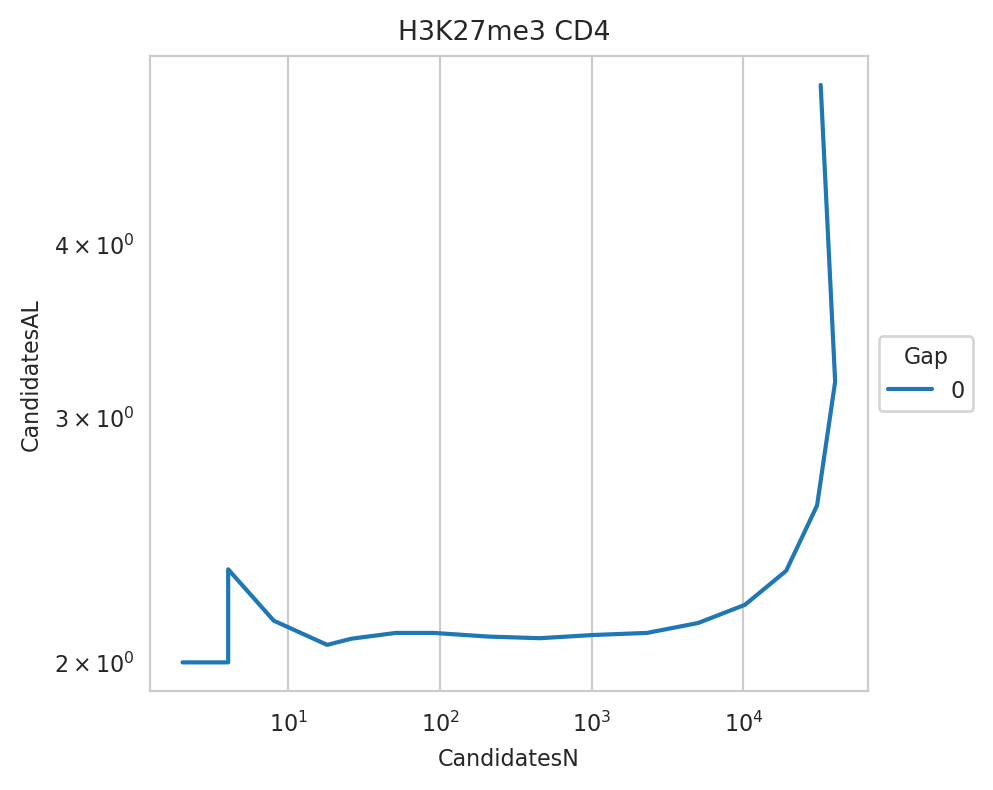

CandidatesN


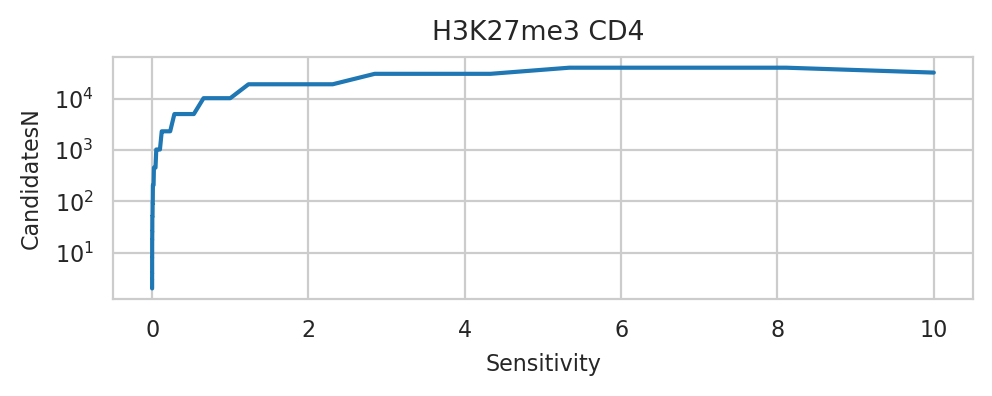

CandidatesAL


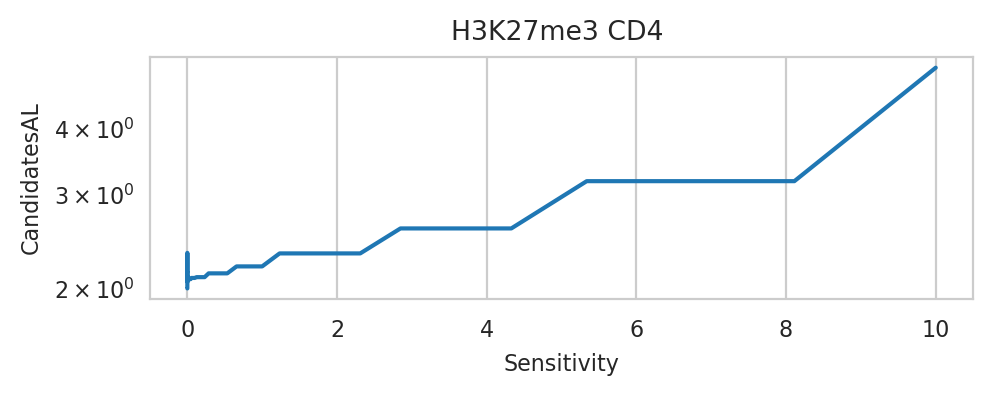

Prepare chromosome indexes
Compute coverage in regions
Processing blacklisted regions
Marked 2076 / 34470 bins as blacklist
Split by chromosomes
Collect final regions
Pick 1000 / 10000 uniform regions for computation speedup


,Sensitivity,Gap,CandidatesN,CandidatesAL
0,1.000000e-08,0,1,1.0
1,1.232847e-08,0,1,1.0
2,1.519911e-08,0,1,1.0
3,1.873817e-08,0,1,1.0
4,2.310130e-08,0,1,1.0
5,2.848036e-08,0,1,1.0
6,3.511192e-08,0,1,1.0
7,4.328761e-08,0,1,1.0
8,5.336699e-08,0,1,1.0
9,6.579332e-08,0,1,1.0


,Sensitivity,Gap,CandidatesN,CandidatesAL
80,0.187382,0,574,3.317073
81,0.231013,0,673,3.667162
82,0.284804,0,736,3.930707
83,0.351119,0,883,4.181200
84,0.432876,0,1053,4.190883
85,0.533670,0,1534,3.845502
86,0.657933,0,1815,3.656749
87,0.811131,0,2705,3.229945
88,1.000000,0,3500,2.960571
89,1.232847,0,4657,2.733305


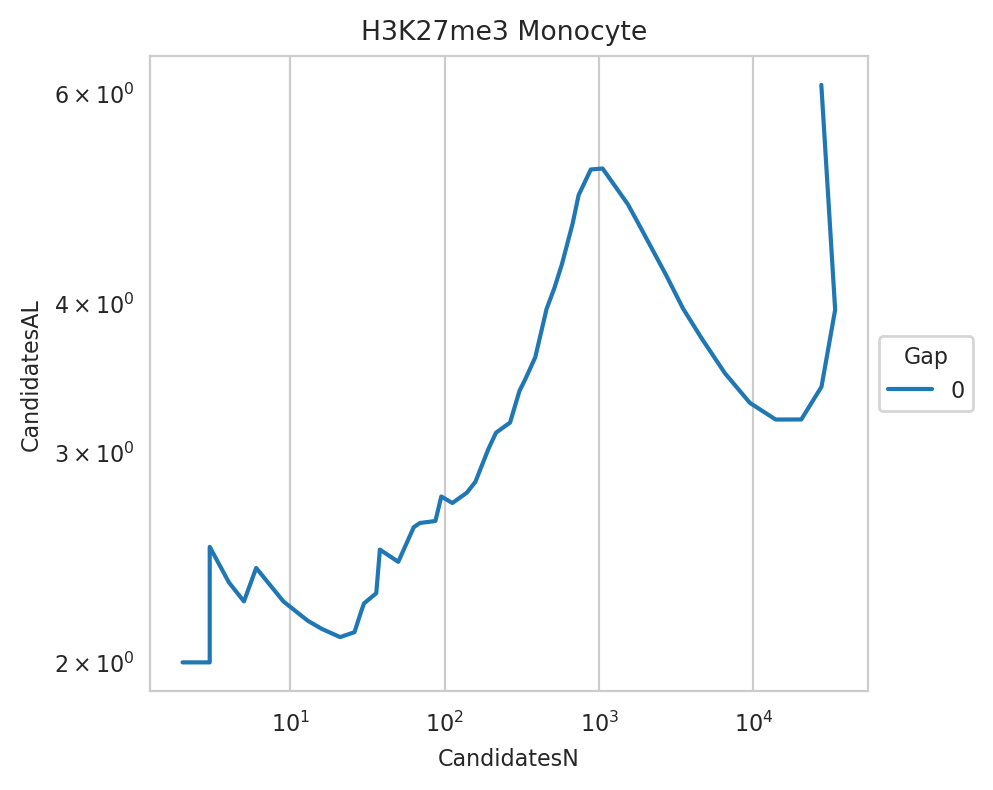

CandidatesN


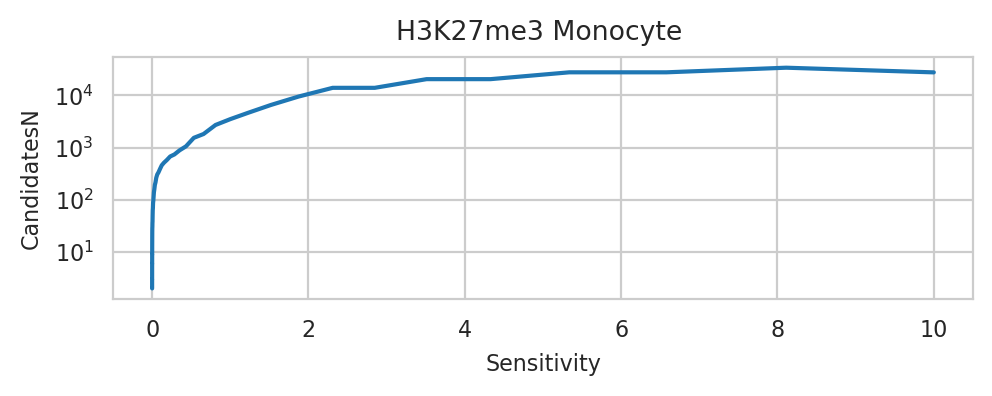

CandidatesAL


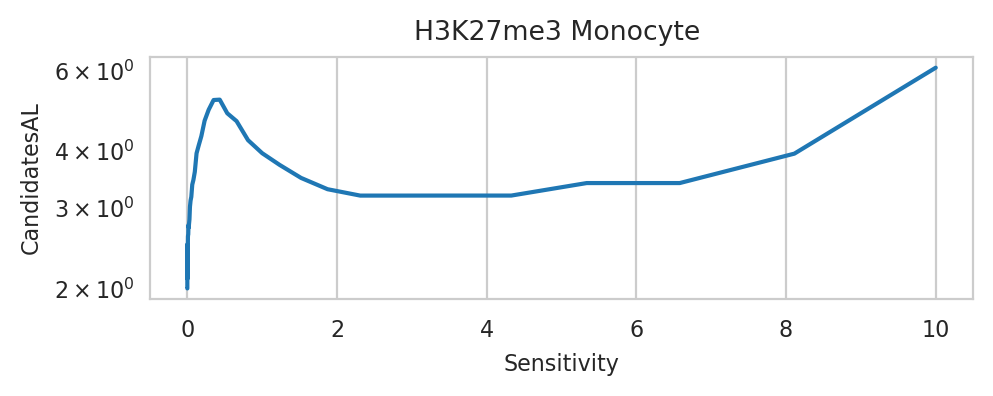

In [528]:
for (m, c, r, ds) in [
    # ('H3K4me3', 'CD34', '', 'Roadmap'),
    ('H3K4me3', 'CD34', 'rep2', 'Roadmap'),
    # ('H3K4me3', 'CD4', '', 'Roadmap'),
    # ('H3K4me1', 'H1', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep2', 'ENCODE'),
    # ('H3K27me3', 'NHLF', 'rep1', 'ENCODE'),
    # ('H3K36me3', 'CD4', '', 'Roadmap'),
    # ('H3K36me3', 'CD4', 'rep1', 'Roadmap'),
    # ('H3K36me3', 'GM12878', 'rep1', 'ENCODE'),
    ('H3K27me3', 'CD4', '', 'Roadmap'),
    # ('H3K27me3', 'CD4', 'rep2', 'Roadmap'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K27me3', 'BCell', '', 'Roadmap'),
    # ('H3K27me3', 'PBMC', '', 'Roadmap'),
    # ('H3K27me3', 'TCell', '', 'Roadmap'),
    # ('H3K27me3', 'H1', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep2', 'ENCODE'),
]:
    bw_path = all_bws[(all_bws['modification'] == m) &
                      (all_bws['cell'] == c) &
                      (all_bws['replicate'] == r) &
                      (all_bws['dataset'] == ds)]['file'].values[0]

    _, region_stats = collect_bw_stats(bw_path, chrom_sizes_part, blacklist_df, REGION_LEN, TOP_REGIONS,
                                       WORK_REGIONS, RESOLUTION)
    coverages = np.concatenate(region_stats, axis=0)
    t = analyze_candidates(coverages)
    display(t.head(10))
    display(t.tail(20))
    # For log
    t.fillna(0, inplace=True)
    t['CandidatesN'] += 1
    t['CandidatesAL'] += 1
    # break
    t.sort_values(['Sensitivity', 'Gap'], inplace=True)
    plot_candidates(t, f'{m} {c} {r}')
    plot_projections(t, f'{m} {c} {r}', None)


## Segments

Prepare chromosome indexes
Compute coverage in regions
Processing blacklisted regions
Marked 2076 / 34470 bins as blacklist
Split by chromosomes
Collect final regions
Pick 1000 / 10000 uniform regions for computation speedup


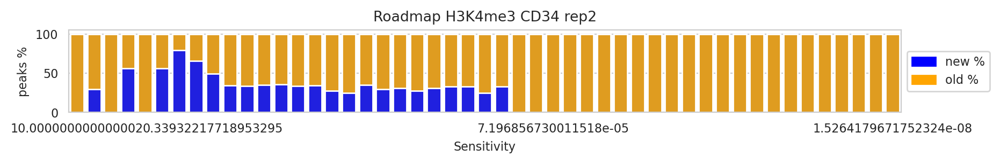

Prepare chromosome indexes
Compute coverage in regions
Processing blacklisted regions
Marked 2076 / 34470 bins as blacklist
Split by chromosomes
Collect final regions
Pick 1000 / 10000 uniform regions for computation speedup


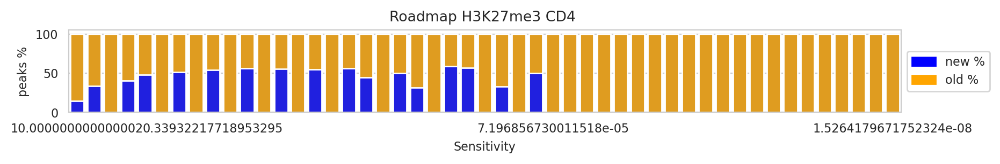

Prepare chromosome indexes
Compute coverage in regions
Processing blacklisted regions
Marked 2076 / 34470 bins as blacklist
Split by chromosomes
Collect final regions
Pick 1000 / 10000 uniform regions for computation speedup


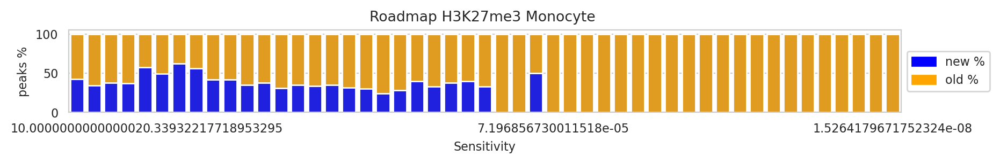

In [529]:
for (m, c, r, ds) in [
    # ('H3K4me3', 'CD34', '', 'Roadmap'),
    ('H3K4me3', 'CD34', 'rep2', 'Roadmap'),
    # ('H3K4me3', 'CD4', '', 'Roadmap'),
    # ('H3K4me1', 'H1', 'rep1', 'ENCODE'),
    # ('H3K4me1', 'H1', 'rep2', 'ENCODE'),
    # ('H3K27me3', 'NHLF', 'rep1', 'ENCODE'),
    # ('H3K36me3', 'CD4', '', 'Roadmap'),
    # ('H3K36me3', 'CD4', 'rep1', 'Roadmap'),
    # ('H3K36me3', 'GM12878', 'rep1', 'ENCODE'),
    ('H3K27me3', 'CD4', '', 'Roadmap'),
    # ('H3K27me3', 'CD4', 'rep2', 'Roadmap'),
    ('H3K27me3', 'Monocyte', '', 'Roadmap'),
    # ('H3K27me3', 'BCell', '', 'Roadmap'),
    # ('H3K27me3', 'PBMC', '', 'Roadmap'),
    # ('H3K27me3', 'TCell', '', 'Roadmap'),
    # ('H3K27me3', 'H1', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep1', 'ENCODE'),
    # ('H3K27me3', 'HepG2', 'rep2', 'ENCODE'),
]:
    bw_path = all_bws[(all_bws['modification'] == m) &
                      (all_bws['cell'] == c) &
                      (all_bws['replicate'] == r) &
                      (all_bws['dataset'] == ds)]['file'].values[0]

    _, region_stats = collect_bw_stats(bw_path, chrom_sizes_part, blacklist_df, REGION_LEN, TOP_REGIONS,
                                       WORK_REGIONS, RESOLUTION)
    coverages = np.concatenate(region_stats, axis=0)
    rows = []
    fdr = 0.05
    prev_bins = np.ndarray(len(coverages), dtype='bool')
    bins = np.ndarray(len(coverages), dtype='bool')
    for i, s in enumerate(np.exp(np.linspace(-8, 1, 50) * math.log(10))):
        cq = np.percentile(coverages, 100 * (1.0 - s * fdr))
        if i == 0:
            for j in range(len(bins)):
                prev_bins[j] = coverages[j] >= cq
            continue
        for j in range(len(bins)):
            bins[j] = coverages[j] >= cq
        if prev_bins is None:
            prev_bins = bins.copy()
            continue
        candidates = call_candidates(bins, 0)
        total = len(candidates)
        overlap_candidates = 0
        for (start, end) in candidates:
            ovlp = any(prev_bins[i] for i in range(start, end))
            if ovlp:
                overlap_candidates += 1
        rows.append((s, total, total - overlap_candidates, overlap_candidates))
        for j in range(len(bins)):
            prev_bins[j] = bins[j]

    sdf = pd.DataFrame(rows, columns=['Sensitivity', 'Total', 'New', 'Old'])
    # display(sdf)
    sdf['New %'] = [d(n, t) * 100 for n, t in zip(sdf['New'], sdf['Total'])]
    sdf['Total %'] = 100
    plt.figure(figsize=(10, 1))
    ax = plt.axes()
    # Background
    sns.barplot(sdf, x='Sensitivity', y='Total %',
                color='orange',
                ax=ax)
    # Foreground
    sns.barplot(sdf, x='Sensitivity', y='New %',
                color='blue',
                ax=ax)
    ax.set_ylabel('peaks %')
    name = f'{ds} {m} {c} {r}'
    ax.set_title(name)
    # Points
    # sp = sps[name]
    # ax.axvline(x=sp[2], ymin=0, ymax=100, color='blue', lw=2)
    # ax.axvline(x=sp[1], ymin=0, ymax=100, color='red', lw=2)
    # ax.axvline(x=sp[0], ymin=0, ymax=100, color='green', lw=2)
    # Limit ticks number
    for i, label in enumerate(ax.get_xticklabels()):
        if 0 < i < len(sdf) - 1 and i % 20 != 0:
            label.set_visible(False)
    ax.invert_xaxis()
    # add legend
    top_bar = mpatches.Patch(color='orange', label='old %')
    bottom_bar = mpatches.Patch(color='blue', label='new %')
    plt.legend(handles=[bottom_bar, top_bar])
    sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()


##  All

In [530]:
# for m in ['ATAC'] + MODIFICATIONS:
#     for ds in ['ENCODE', 'Roadmap', 'Immgen']:
#         print(ds, m)
#         dft = all_bws[(all_bws['dataset'] == ds) & (all_bws['modification'] == m)].copy().reset_index(drop=True)
#
#         n = len(dft)
#         print(n)
#         if n <= 6:
#             ncols, nrows = n, 1
#         else:
#             ncols = int(math.floor(math.sqrt(n) + 4))
#             nrows = int(math.ceil(n / ncols))
#         plt.figure(figsize=(3 * ncols + 1, 3 * nrows))
#         axs = [plt.subplot(nrows, ncols, i + 1) for i in range(n)]
#         for i, dftr in dft.iterrows():
#             c, r, bw_path = dftr['cell'], dftr['replicate'], dftr['file']
#             print(ds, m, c, r, bw_path)
#             regions_df, region_stats = collect_bw_stats(
#                 bw_path, chrom_sizes_part, blacklist_df, REGION_LEN, TOP_REGIONS, WORK_REGIONS, RESOLUTION
#             )
#             coverages = np.concatenate(region_stats, axis=0)
#             tt = analyze_candidates(coverages)
#             ax = axs[i]
#             sns.lineplot(data=tt, x="CandidatesN", y="CandidatesAL", hue='Gap', estimator=None,
#                      marker='o', markersize=3,
#                      palette='tab20',
#                     sort=False,
#                     ax=ax)
#             for x, y, s in zip(tt['CandidatesN'], tt['CandidatesAL'], tt['Sensitivity']):
#                 if s in [1e-3, 0.1]:
#                     ax.text(x, y, str(s), fontsize=5)
#             # pivot = full_sensitivity[(full_sensitivity['dataset'] == ds) &
#             #                   (full_sensitivity['modification'] == m) &
#             #                   (full_sensitivity['cell'] == c) &
#             #                   (full_sensitivity['replicate'] == r)]['pivot'].values[0]
#             # ax.set_title(f'{ds} {m} {c} {r} {"" if pivot == "null" else ""}')
#             ax.set_title(f'{ds} {m} {c} {r}')
#             ax.set(yscale='log')
#             ax.set(xscale='log')
#             if i == n - 1:
#                 sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
#             else:
#                 ax.legend().set_visible(False)
#         plt.tight_layout()
#         plt.show()

# Chips quality analysis

In [85]:
CHIPS_PATH = os.path.expanduser('~/data/2023_chips')
N = 5
MULTIPLIERS = [1.0, 0.7, 0.5, 0.2, 0.1]

In [86]:
def load_chips_sensitivity(path):
    ts = []
    for (m, n, mult) in product(
            ['H3K4me3', 'H3K27ac', 'H3K4me1', 'H3K27me3', 'H3K36me3', 'mixed'],
            range(1, N + 1),
            MULTIPLIERS):
        res = glob.glob(f'{path}/{m}*_{n}_{mult}_*.sensitivity.tsv')
        if len(res) == 0:
            print(f'Nothing found for {path}/{m}*_{n}_{mult}_*.sensitivity.tsv')
            continue
        if len(res) > 1:
            print(f'More than 1 found for {path}/{m}*_{n}_{mult}_*.sensitivity.tsv:\n{res}')
            continue
        tsv_path = res[0]
        print(tsv_path, m, n, mult)
        t = pd.read_csv(tsv_path, sep='\t')
        t['file'] = tsv_path
        t['modification'] = m
        t['n'] = n
        t['multiplier'] = mult
        ts.append(t)
    df = pd.concat(ts).reset_index(drop=True)
    return df

In [87]:
chips_sens = load_chips_sensitivity(CHIPS_PATH + '/span')
# For log
chips_sens['CandidatesN'] += 1
chips_sens['CandidatesAL'] += 1
chips_sens.sample(3)

/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_1_1.0_100_0.05.peak.sensitivity.tsv H3K4me3 1 1.0
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_1_0.7_100_0.05.peak.sensitivity.tsv H3K4me3 1 0.7
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_1_0.5_100_0.05.peak.sensitivity.tsv H3K4me3 1 0.5
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_1_0.2_100_0.05.peak.sensitivity.tsv H3K4me3 1 0.2
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_1_0.1_100_0.05.peak.sensitivity.tsv H3K4me3 1 0.1
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_2_1.0_100_0.05.peak.sensitivity.tsv H3K4me3 2 1.0
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_2_0.7_100_0.05.peak.sensitivity.tsv H3K4me3 2 0.7
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_2_0.5_100_0.05.peak.sensitivity.tsv H3K4me3 2 0.5
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_2_0.2_100_0.05.peak.sensitivity.tsv H3K4me3 2 0.2
/home/jetbrains/data/2023_chips/span/H3K4me3_chr15_2_0.1_100_0.05.peak.sensitivity.tsv H3K4

,Sensitivity,Gap,CandidatesN,CandidatesAL,CandidatesML,SignalNoiseRatio,SignalControlRatio,file,modification,n,multiplier
104406,-5.058481e+00,2,275,27.737226,12.0,0.0,0.0,/home/jetbrains/data/2023_chips/span/mixed_k4m...,mixed,5,0.1
103343,-6.877062e-04,20,966,20.622798,1.0,0.0,0.0,/home/jetbrains/data/2023_chips/span/mixed_k4m...,mixed,5,0.5
103187,-2.918487e-09,3,1450,518.465148,16.0,0.0,0.0,/home/jetbrains/data/2023_chips/span/mixed_k4m...,mixed,5,0.5


H3K4me3
25


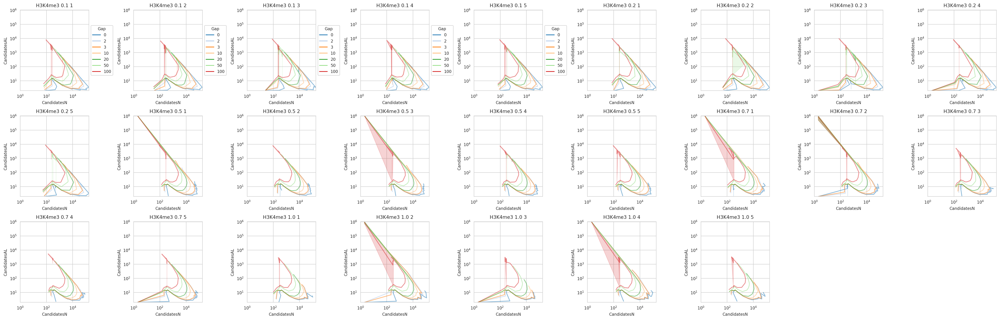

H3K27ac
25


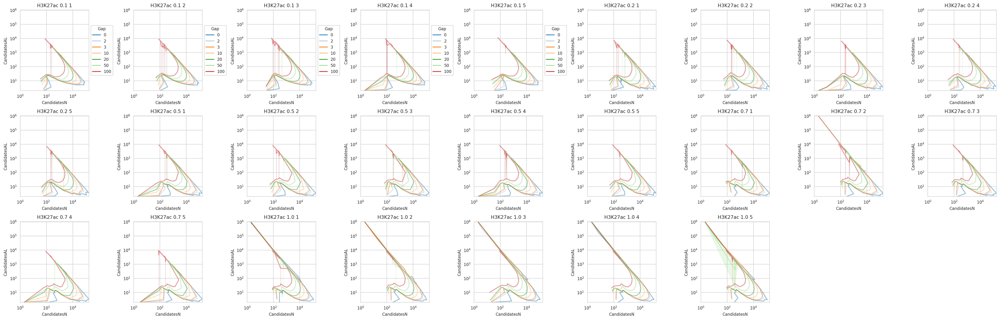

H3K4me1
25


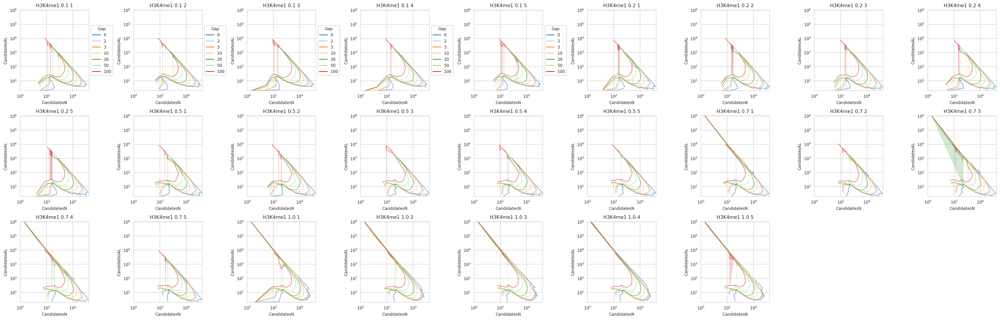

H3K27me3
25


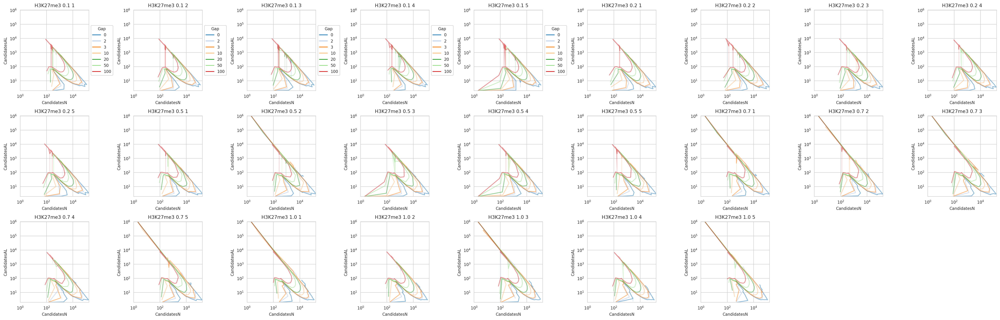

H3K36me3
25


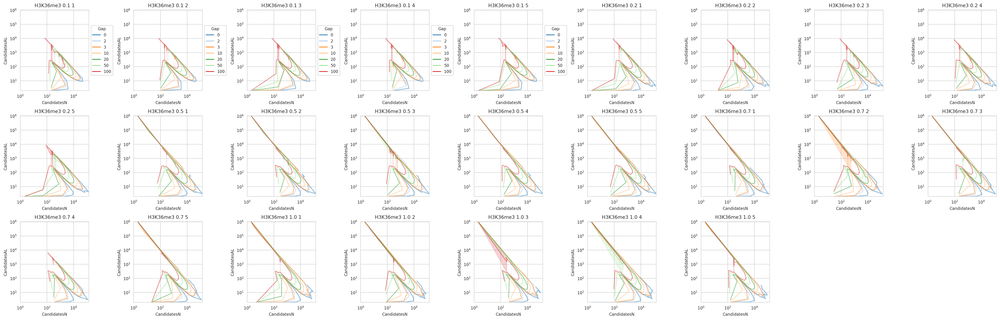

In [88]:
for m in MODIFICATIONS:
    print(m)
    dfdsm = chips_sens[chips_sens['modification'] == m].copy()
    dfdsm.sort_values(by=['multiplier', 'Sensitivity'], ascending=False, inplace=True)
    # t = dfdsm[(dfdsm['Sensitivity'] >= 1e-3) & (dfdsm['Sensitivity']<=1)]
    t = dfdsm
    minx, maxx = t['CandidatesN'].min(), t['CandidatesN'].max()
    miny, maxy = t['CandidatesAL'].min(), t['CandidatesAL'].max()
    n = len(dfdsm[['n', 'multiplier']].copy().drop_duplicates())
    print(n)
    if n <= 6:
        ncols, nrows = n, 1
    else:
        ncols = int(math.floor(math.sqrt(n) + 4))
        nrows = int(math.ceil(n / ncols))
    plt.figure(figsize=(3 * ncols + 1, 3 * nrows))
    axs = [plt.subplot(nrows, ncols, i + 1) for i in range(n)]
    for i, ((mult, n), t) in enumerate(dfdsm.groupby(['multiplier', 'n'])):
        # tt = t[(t['Sensitivity'] >= 1e-3) & (t['Sensitivity']<=1)].copy()
        tt = t
        ax = axs[i]
        sns.lineplot(data=tt, x="CandidatesN", y="CandidatesAL", hue='Gap',
                     # marker='o', markersize=2,
                     palette='tab20',
                     sort=False,
                     alpha=0.5,
                     ax=ax)
        # sns.scatterplot(data=tt,
        #                 x="CandidatesN", y="CandidatesAL", hue='Gap', s=10, palette='tab20',
        #                 legend=False, ax=ax)
        # sns.scatterplot(data=tt,
        #                 x="CandidatesN", y="CandidatesAL", hue='Gap', s=30, palette='tab20',
        #                 legend=False, ax=ax)
        # for x, y, v in zip(tt['CandidatesN'], tt['CandidatesAL'], tt['Sensitivity']):
        #     if v in [1.0, 0.001]:
        #         ax.text(x, y, str(v), fontsize=5)
        ax.set(yscale='log')
        ax.set(xscale='log')
        # pivot = tt['pivot'].unique()[0]
        # ax.set_title(f'{m} {mult} {n} {f"P {pivot}" if pivot != "null" else ""}')
        ax.set_title(f'{m} {mult} {n}')
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        if i == n - 1:
            sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
        else:
            ax.legend().set_visible(False)
    plt.tight_layout()
    plt.show()

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (61, 2.305319810217446)
Checking I 11 I1mab (-1, 0) I3mab (61, 2.3056117431491954)
Checking I 12 I1mab (-1, 0) I3mab (61, 2.323513671242787)
Checking I 13 I1mab (-1, 0) I3mab (61, 2.3256455736468595)
Checking I 14 I1mab (-1, 0) I3mab (61, 2.3369807073456954)
Checking I 15 I1mab (-1, 0) I3mab (61, 2.3527243132313043)
Checking I 16 I1mab (-1, 0) I3mab (61, 2.3610868178286717)
Checking I 17 I1mab (-1, 0) I3mab (61, 2.358467222337625)
Checking I 18 I1mab (-1, 0) I3mab (61, 2.369223785618712)
Checking I 19 I1mab (-1, 0) I3mab (61, 2.366411130875699)
Checking I 20 I1mab (-1, 0) I3mab (61, 2.3644134745099814)
Checking I 21 I1mab (-1, 0) I3mab (61, 2.369069875902607)
Checking I 22 I1mab (-1, 0) I3mab (61, 2.36730657135268)
Checking I 23 I1mab (-1, 0) I3mab (61, 2.3680686111183604)
Checking I 24 I1mab (-1, 0) I3mab (61, 2.3752397210023144)
Checking I 25 I1mab (-1, 0) I3mab (61, 2.3679873113303556)
Checking I 26 I1mab (-1, 0) I3mab (61, 2.366

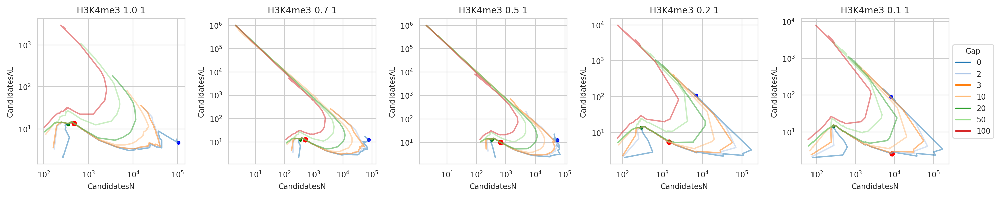

In [89]:
for (m, n) in [
    ('H3K4me3', 1),
]:
    t = chips_sens[(chips_sens['modification'] == m) &
                   (chips_sens['n'] == n)].copy()
    t.sort_values(by=['Sensitivity'], ascending=False, inplace=True)
    plt.figure(figsize=(15, 3))
    axs = [plt.subplot(1, len(MULTIPLIERS), i + 1) for i in range(len(MULTIPLIERS))]
    for i, mult in enumerate(sorted(MULTIPLIERS, reverse=True)):
        ax = axs[i]
        tt = t[t['multiplier'] == mult]
        # tt = t[(t['Sensitivity'] >= 1e-3) & (t['Sensitivity'] <= 1.0)]
        # tt = t
        sns.lineplot(data=tt, x="CandidatesN", y="CandidatesAL", hue='Gap', estimator=None,
                     # marker='o', markersize=3,
                     palette='tab20',
                     sort=False,
                     alpha=0.5,
                     ax=ax)
        ttt = tt[tt['Gap'] == 0].sort_values(by=['Sensitivity']).copy().reset_index(drop=True)
        sp = detect_sensitivity_triangle(ttt)
        sns.scatterplot(data=ttt[ttt.index == sp[0]],
                        x="CandidatesN", y="CandidatesAL", color='green', s=20,
                        legend=False, ax=ax)
        sns.scatterplot(data=ttt[ttt.index == sp[1]],
                        x="CandidatesN", y="CandidatesAL", color='red', s=40,
                        legend=False, ax=ax)
        sns.scatterplot(data=ttt[ttt.index == sp[2]],
                        x="CandidatesN", y="CandidatesAL", color='blue', s=20,
                        legend=False, ax=ax)

        # sns.scatterplot(data=tt[tt['Sensitivity'].isin([1.0, 0.001])],
        #                 x="CandidatesN", y="CandidatesAL", hue='Gap', s=10, palette='tab20',
        #                 legend=False, ax=ax)
        # sns.scatterplot(data=tt[tt['Sensitivity'].isin([0.1])],
        #                 x="CandidatesN", y="CandidatesAL", hue='Gap', s=30, palette='tab20',
        #                 legend=False, ax=ax)
        # for x, y, v in zip(tt['CandidatesN'], tt['CandidatesAL'], tt['Sensitivity']):
        #     if v in [1.0, 0.001]:
        #         ax.text(x, y, str(v), fontsize=5)
        ax.set(yscale='log')
        ax.set(xscale='log')
        # pivot = tt['pivot'].values[0]
        # ax.set_title(f'{m} {mult} {n} {f"P {pivot}" if pivot != "null" else ""}')
        ax.set_title(f'{m} {mult} {n}')
        if i == len(MULTIPLIERS) - 1:
            sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
        else:
            ax.legend().set_visible(False)

    plt.tight_layout()
    plt.show()

# Mix control

In [90]:
MIX_PATH = os.path.expanduser('~/data/2023_mix_chr1')
MIX_SIGNAL_FRACTIONS = [0.7, 0.5, 0.2, 0.1]

In [91]:
def load_mix_sensitivity(path):
    ts = []
    for (m, c, r, f) in product(
            ['H3K4me3', 'H3K27ac', 'H3K4me1', 'H3K27me3', 'H3K36me3'],
            IMMUNE_CELLS,
            IMMUNE_REPS,
            MIX_SIGNAL_FRACTIONS,
    ):
        res = glob.glob(f'{path}/{m}_{c}_{r}*_{f}_*.sensitivity.tsv')
        if r == '':
            res = [f for f in res if len([ro for ro in IMMUNE_REPS if ro != r and ro in f]) == 0]
        if len(res) == 0:
            print(f'Nothing found for {path}/{m}_{c}_{r}*_{f}_*.sensitivity.tsv')
            continue
        if len(res) > 1:
            print(f'More than 1 found for {path}/{m}_{c}_{r}*_{f}_*.sensitivity.tsv:\n{res}')
            continue
        tsv_path = res[0]
        print(tsv_path, m, f)
        t = pd.read_csv(tsv_path, sep='\t')
        t['file'] = tsv_path
        t['modification'] = m
        t['cell'] = c
        t['replicate'] = r
        t['fraction'] = f
        t['SensitivityN'] = range(len(t))
        ts.append(t)
    df = pd.concat(ts).reset_index(drop=True)
    return df

In [92]:
mix_sens = load_mix_sensitivity(MIX_PATH + '/span')
# For log
mix_sens.fillna(0, inplace=True)
mix_sens['CandidatesN'] += 1
mix_sens['CandidatesAL'] += 1
mix_sens.sample(3)

/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep1_0.7_100_0.05.peak.sensitivity.tsv H3K4me3 0.7
/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep1_0.5_100_0.05.peak.sensitivity.tsv H3K4me3 0.5
/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep1_0.2_100_0.05.peak.sensitivity.tsv H3K4me3 0.2
/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep1_0.1_100_0.05.peak.sensitivity.tsv H3K4me3 0.1
/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep2_0.7_100_0.05.peak.sensitivity.tsv H3K4me3 0.7
/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep2_0.5_100_0.05.peak.sensitivity.tsv H3K4me3 0.5
/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep2_0.2_100_0.05.peak.sensitivity.tsv H3K4me3 0.2
/home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep2_0.1_100_0.05.peak.sensitivity.tsv H3K4me3 0.1
Nothing found for /home/jetbrains/data/2023_mix_chr1/span/H3K4me3_CD4ABT_rep3*_0.7_*.sensitivity.tsv
Nothing found for /home/jetbrains/data/2023_mix_chr

,Sensitivity,Gap,CandidatesN,CandidatesAL,CandidatesML,SignalNoiseRatio,SignalControlRatio,file,modification,cell,replicate,fraction,SensitivityN
101157,-0.000012,10,10324,203.146857,61.0,0.000000,0.0,/home/jetbrains/data/2023_mix_chr1/span/H3K36m...,H3K36me3,TCell,,0.7,357
107552,-0.000030,20,1746,1249.289398,41.0,0.000000,0.0,/home/jetbrains/data/2023_mix_chr1/span/H3K36m...,H3K36me3,PBMC,,0.5,452
89664,-0.000002,0,2814,793.985425,50.0,10487.806737,1.0,/home/jetbrains/data/2023_mix_chr1/span/H3K27m...,H3K27me3,CD34,,0.7,64


In [93]:
# for m in MODIFICATIONS:
#     print(m)
#     dfdsm = mix_sens[mix_sens['modification'] == m].copy()
#     dfdsm.sort_values(by=['cell', 'replicate', 'fraction', 'fraction', 'Sensitivity'], ascending=False, inplace=True)
#     # t = dfdsm[(dfdsm['Sensitivity'] >= 1e-3) & (dfdsm['Sensitivity']<=1)]
#     t = dfdsm
#     minx, maxx = t['CandidatesN'].min(), t['CandidatesN'].max()
#     miny, maxy = t['CandidatesAL'].min(), t['CandidatesAL'].max()
#     n = len(dfdsm[['cell', 'replicate', 'fraction']].copy().drop_duplicates())
#     print(n)
#     if n <= 6:
#         ncols, nrows = n, 1
#     else:
#         ncols = int(math.floor(math.sqrt(n) + 4))
#         nrows = int(math.ceil(n / ncols))
#     plt.figure(figsize=(3 * ncols + 1, 3 * nrows))
#     axs = [plt.subplot(nrows, ncols, i + 1) for i in range(n)]
#     for i, ((c, r, f), t) in enumerate(dfdsm.groupby(['cell', 'replicate', 'fraction'])):
#         # tt = t[(t['Sensitivity'] >= 1e-3) & (t['Sensitivity']<=1)].copy()
#         tt = t
#         ax = axs[i]
#         sns.lineplot(data=tt, x="CandidatesN", y="CandidatesAL", hue='Gap',
#                      # marker='o', markersize=2,
#                      palette='tab20',
#                      sort=False,
#                      alpha=0.5,
#                      ax=ax)
#
#         sns.scatterplot(data=tt[tt['Sensitivity'].isin([1.0, 0.001])],
#                         x="CandidatesN", y="CandidatesAL", hue='Gap', s=10, palette='tab20',
#                         legend=False, ax=ax)
#         sns.scatterplot(data=tt[tt['Sensitivity'].isin([0.1])],
#                         x="CandidatesN", y="CandidatesAL", hue='Gap', s=30, palette='tab20',
#                         legend=False, ax=ax)
#         ax.set(yscale='log')
#         ax.set(xscale='log')
#         ax.set_title(f'{m} {c} {r} {f}')
#         ax.set_xlim(minx, maxx)
#         ax.set_ylim(miny, maxy)
#         if i == n - 1:
#             sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
#         else:
#             ax.legend().set_visible(False)
#     plt.tight_layout()
#     plt.show()

Limit Im1 10 Im2 90
Checking I 10 I1mab (3, 1.4368435227615002) I3mab (58, 25.319907448262484)
Checking I 11 I1mab (3, 1.6259388462513835) I3mab (58, 24.751725681205734)
Checking I 12 I1mab (3, 1.9233057827319788) I3mab (58, 24.313470370096724)
Checking I 13 I1mab (3, 2.2269986860478355) I3mab (58, 23.956468464970108)
Checking I 14 I1mab (3, 2.6246537596325514) I3mab (58, 23.732617709197477)
Checking I 15 I1mab (3, 3.181092510681967) I3mab (58, 23.63034353225735)
Checking I 16 I1mab (3, 3.481710507107158) I3mab (58, 23.439060341196267)
Checking I 17 I1mab (3, 3.624453040260101) I3mab (58, 23.282778077685528)
Checking I 18 I1mab (3, 3.731337338567009) I3mab (58, 23.12518158303996)
Checking I 19 I1mab (3, 3.7694127822664965) I3mab (58, 22.98878969996663)
Checking I 20 I1mab (3, 3.838908859152022) I3mab (58, 22.83472820556895)
Checking I 21 I1mab (3, 3.8790799501823177) I3mab (58, 22.72049559744712)
Checking I 22 I1mab (3, 3.9399567924396397) I3mab (58, 22.598769762323357)
Checking I 23 I

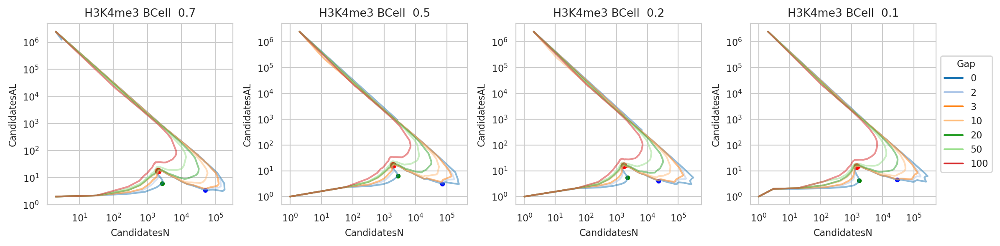

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (53, 28.639115616929722)
Checking I 11 I1mab (10, 0.2949820366525808) I3mab (53, 26.276342849304406)
Checking I 12 I1mab (10, 0.04076855274040703) I3mab (55, 24.127434390792722)
Checking I 13 I1mab (12, 0.6578938689752882) I3mab (55, 22.47289667846575)
Checking I 14 I1mab (12, 2.7778507737554774) I3mab (55, 21.956927607682715)
Checking I 15 I1mab (12, 4.3448713395236425) I3mab (55, 21.36324552689586)
Checking I 16 I1mab (12, 5.100789639542999) I3mab (55, 20.797388020759534)
Checking I 17 I1mab (12, 5.435258739837421) I3mab (55, 20.296295059849484)
Checking I 18 I1mab (12, 5.642303568765979) I3mab (55, 19.864168283432583)
Checking I 19 I1mab (12, 5.7705227460410216) I3mab (55, 19.47071571502972)
Checking I 20 I1mab (12, 5.87232051322632) I3mab (55, 19.122191636791598)
Checking I 21 I1mab (12, 5.985961095417562) I3mab (55, 18.78702627371151)
Checking I 22 I1mab (12, 6.05839938327845) I3mab (55, 18.457476806955896)
Checking I 23 I1mab 

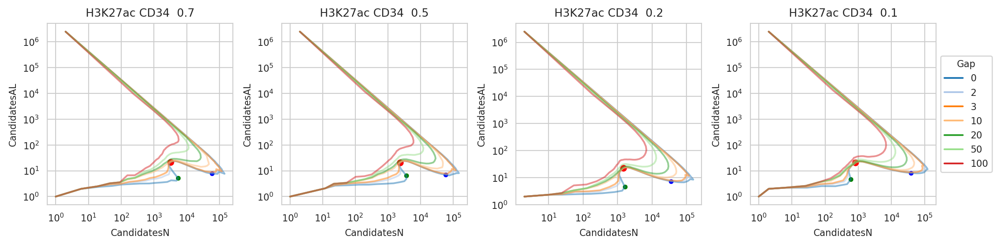

Limit Im1 10 Im2 90
Checking I 10 I1mab (7, 5.806458073231444) I3mab (50, 18.0449640315873)
Checking I 11 I1mab (7, 6.769044643760878) I3mab (50, 17.4995689229764)
Checking I 12 I1mab (7, 7.339074491064526) I3mab (50, 17.055329196603807)
Checking I 13 I1mab (7, 7.716800402342307) I3mab (50, 16.67310372583367)
Checking I 14 I1mab (7, 7.9647713830686335) I3mab (50, 16.35061309438565)
Checking I 15 I1mab (7, 8.13267747113994) I3mab (50, 16.050106468131915)
Checking I 16 I1mab (7, 8.284059658701993) I3mab (50, 15.775185350352658)
Checking I 17 I1mab (7, 8.427228843891957) I3mab (50, 15.533620540530613)
Checking I 18 I1mab (7, 8.522156880680773) I3mab (50, 15.303405834153764)
Checking I 19 I1mab (7, 8.60872514808144) I3mab (50, 15.084318130163922)
Checking I 20 I1mab (7, 8.647091040076313) I3mab (50, 14.86131313766738)
Checking I 21 I1mab (7, 8.71685809712544) I3mab (50, 14.654321513601204)
Checking I 22 I1mab (7, 8.746819443395383) I3mab (50, 14.44389981566178)
Checking I 23 I1mab (7, 8.71

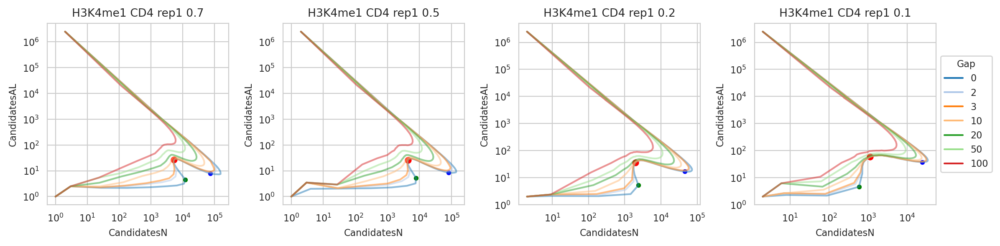

Limit Im1 10 Im2 90
Checking I 10 I1mab (5, 9.483837958540326) I3mab (41, 8.861379082654437)
Checking I 11 I1mab (5, 10.154817076861464) I3mab (41, 8.316025213835076)
Checking I 12 I1mab (5, 10.629973761389582) I3mab (41, 7.87244099942653)
Checking I 13 I1mab (5, 11.002215874191743) I3mab (42, 7.504442356464509)
Checking I 14 I1mab (5, 11.274719957936014) I3mab (42, 7.182536225211223)
Checking I 15 I1mab (5, 11.461013830584198) I3mab (42, 6.884531978940487)
Checking I 16 I1mab (5, 11.59523175038164) I3mab (42, 6.6146723985515194)
Checking I 17 I1mab (5, 11.718480377314624) I3mab (42, 6.361255841431358)
Checking I 18 I1mab (5, 11.793008075080737) I3mab (42, 6.126223084213734)
Checking I 19 I1mab (5, 11.860775774393364) I3mab (42, 5.904822936341063)
Checking I 20 I1mab (5, 11.91483840017849) I3mab (42, 5.692730630495149)
Checking I 21 I1mab (5, 11.89715451540199) I3mab (42, 5.482385371053127)
Checking I 22 I1mab (5, 11.847205252491595) I3mab (42, 5.27183802428172)
Checking I 23 I1mab (5,

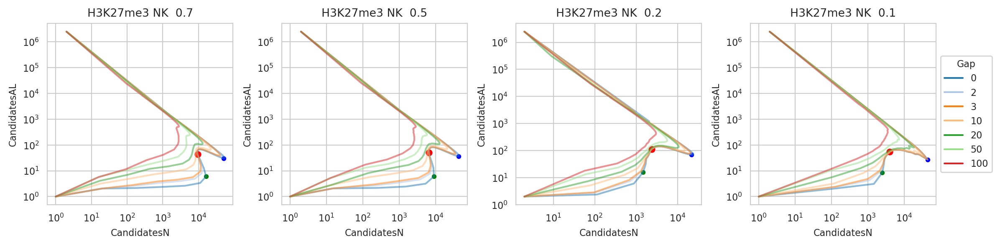

Limit Im1 10 Im2 90
Checking I 10 I1mab (5, 13.346348981091815) I3mab (56, 12.182177148940724)
Checking I 11 I1mab (6, 14.317584417279614) I3mab (56, 12.029419433753596)
Checking I 12 I1mab (6, 14.885165774133462) I3mab (56, 11.883304643300157)
Checking I 13 I1mab (6, 15.246480178612941) I3mab (56, 11.758601715006165)
Checking I 14 I1mab (6, 15.533350419816474) I3mab (56, 11.65118514528411)
Checking I 15 I1mab (6, 15.676903588885121) I3mab (56, 11.538272318594707)
Checking I 16 I1mab (6, 15.854145351188535) I3mab (56, 11.443208603617428)
Checking I 17 I1mab (6, 15.97184785974077) I3mab (56, 11.350133200644606)
Checking I 18 I1mab (6, 16.032518480581988) I3mab (56, 11.259025160291166)
Checking I 19 I1mab (6, 16.055062735227402) I3mab (56, 11.164779117766649)
Checking I 20 I1mab (6, 16.095146180878295) I3mab (56, 11.079847800178442)
Checking I 21 I1mab (6, 16.076594751103354) I3mab (56, 10.98966405702113)
Checking I 22 I1mab (6, 15.9824680172694) I3mab (56, 10.889644305695263)
Checking I

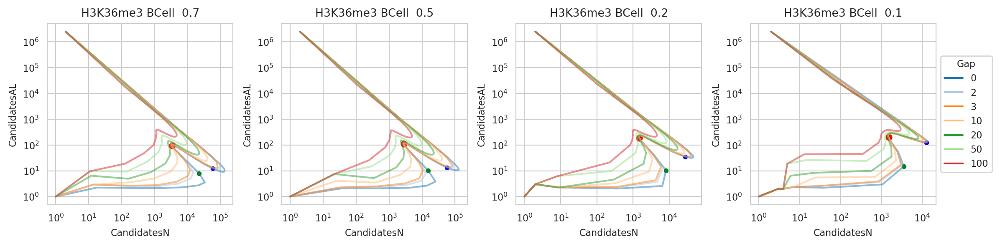

In [94]:
# Examples
sps_mix = {}
for (m, c, r) in [
    ('H3K4me3', 'BCell', ''),
    # ('H3K4me3', 'CD4', ''),
    ('H3K27ac', 'CD34', ''),
    ('H3K4me1', 'CD4', 'rep1'),
    ('H3K27me3', 'NK', ''),
    ('H3K36me3', 'BCell', ''),
]:
    t = mix_sens[(mix_sens['modification'] == m) &
                 (mix_sens['cell'] == c) &
                 (mix_sens['replicate'] == r)].copy()
    t.sort_values(by=['fraction', 'Sensitivity'], ascending=False, inplace=True)
    plt.figure(figsize=(12, 3))
    axs = [plt.subplot(1, 4, i + 1) for i in range(4)]
    for i, f in enumerate(sorted(MIX_SIGNAL_FRACTIONS, reverse=True)):
        ax = axs[i]
        tt = t[t['fraction'] == f]
        assert len(tt['file'].unique()) == 1
        sns.lineplot(data=tt, x="CandidatesN", y="CandidatesAL", hue='Gap', estimator=None,
                     palette='tab20',
                     sort=False,
                     alpha=0.5,
                     ax=ax)
        ttt = tt[tt['Gap'] == 0].sort_values(by=['Sensitivity']).copy().reset_index(drop=True)
        sp = detect_sensitivity_triangle(ttt)
        sps_mix[(m, c, r, i)] = (tt['file'].values[0], ttt, sp)
        sns.scatterplot(data=ttt[ttt.index == sp[0]],
                        x="CandidatesN", y="CandidatesAL", color='green', s=20,
                        legend=False, ax=ax)
        sns.scatterplot(data=ttt[ttt.index == sp[1]],
                        x="CandidatesN", y="CandidatesAL", color='red', s=40,
                        legend=False, ax=ax)
        sns.scatterplot(data=ttt[ttt.index == sp[2]],
                        x="CandidatesN", y="CandidatesAL", color='blue', s=20,
                        legend=False, ax=ax)
        ax.set(yscale='log')
        ax.set(xscale='log')
        # pivot = tt['pivot'].unique()[0]
        # ax.set_title(f'{m} {c} {r} {f} {f"P {pivot}" if pivot != "null" else ""}')
        ax.set_title(f'{m} {c} {r} {f}')
        if i == len(axs) - 1:
            sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
        else:
            ax.legend().set_visible(False)
    plt.tight_layout()
    plt.show()

In [95]:
mfs = list(sorted(MIX_SIGNAL_FRACTIONS, reverse=True))
ts = []
for (m, c, r, i), (file, df, sp) in sps_mix.items():
    print(m, c, r, mfs[i])
    df['modification'] = m
    df['cell'] = c
    df['replicate'] = r
    ts.append(df)
sps_mix_df = pd.concat(ts).reset_index(drop=True)
del ts

H3K4me3 BCell  0.7
H3K4me3 BCell  0.5
H3K4me3 BCell  0.2
H3K4me3 BCell  0.1
H3K27ac CD34  0.7
H3K27ac CD34  0.5
H3K27ac CD34  0.2
H3K27ac CD34  0.1
H3K4me1 CD4 rep1 0.7
H3K4me1 CD4 rep1 0.5
H3K4me1 CD4 rep1 0.2
H3K4me1 CD4 rep1 0.1
H3K27me3 NK  0.7
H3K27me3 NK  0.5
H3K27me3 NK  0.2
H3K27me3 NK  0.1
H3K36me3 BCell  0.7
H3K36me3 BCell  0.5
H3K36me3 BCell  0.2
H3K36me3 BCell  0.1


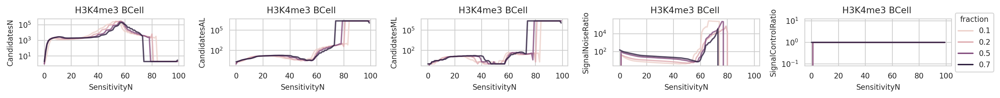

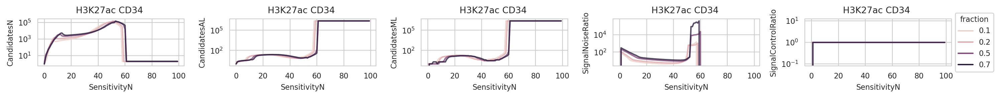

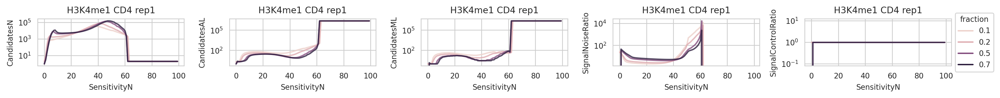

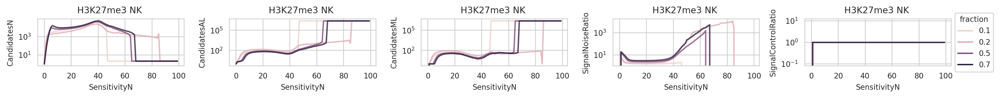

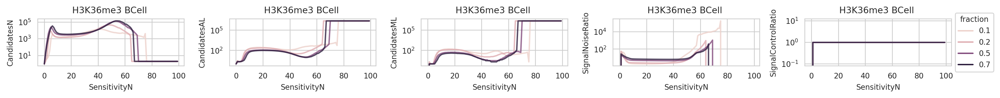

In [96]:
# Examples
for (m, c, r) in [
    ('H3K4me3', 'BCell', ''),
    # ('H3K4me3', 'CD4', ''),
    ('H3K27ac', 'CD34', ''),
    ('H3K4me1', 'CD4', 'rep1'),
    ('H3K27me3', 'NK', ''),
    ('H3K36me3', 'BCell', ''),
]:
    plt.figure(figsize=(15, 1.5))
    axs = [plt.subplot(1, 5, i + 1) for i in range(5)]
    t = sps_mix_df[(sps_mix_df['modification'] == m) & (sps_mix_df['cell'] == c) & (sps_mix_df['replicate'] == r)]
    for i, y in enumerate(['CandidatesN', 'CandidatesAL', 'CandidatesML', 'SignalNoiseRatio', 'SignalControlRatio']):
        ax = axs[i]
        sns.lineplot(data=t, x='SensitivityN', y=y, estimator=None,
                     hue='fraction',
                     hue_order=[0.7, 0.5, 0.2, 0.1],
                     # palette='tab20',
                     alpha=0.8,
                     sort=False,
                     ax=ax)
        # ax.set(xscale='log')
        ax.set(yscale='log')
        # ax.invert_xaxis()
        ax.set_title(f'{m} {c} {r}')
        if i == len(axs) - 1:
            sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
        else:
            ax.legend().set_visible(False)
    plt.tight_layout()
    plt.show()

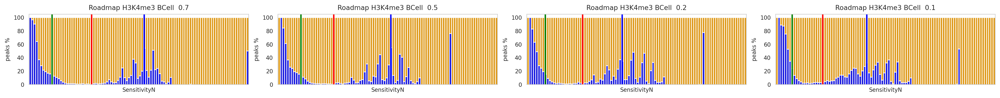

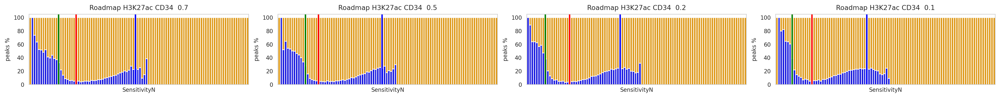

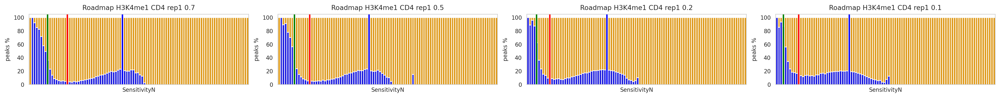

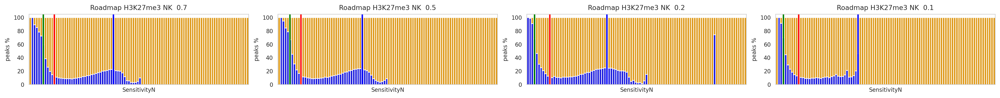

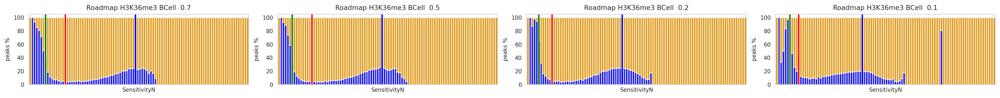

In [97]:
for (m, c, r) in [
    ('H3K4me3', 'BCell', ''),
    ('H3K27ac', 'CD34', ''),
    ('H3K4me1', 'CD4', 'rep1'),
    ('H3K27me3', 'NK', ''),
    ('H3K36me3', 'BCell', ''),
]:
    plt.figure(figsize=(20, 2))
    axs = [plt.subplot(1, 4, i + 1) for i in range(4)]
    for i, f in enumerate(sorted(MIX_SIGNAL_FRACTIONS, reverse=True)):
        ax = axs[i]
        file, _, sp = sps_mix[(m, c, r, i)]
        segments = file.replace('.sensitivity.tsv', '.segments.tsv')
        sdf = pd.read_csv(segments, sep='\t')
        sdf['New %'] = [d(n, t) * 100 for n, t in zip(sdf['New'], sdf['CandidatesN'])]
        sdf['Total %'] = 100
        sdf['SensitivityN'] = range(len(sdf))
        # Background
        sns.barplot(sdf, x='SensitivityN', y='Total %',
                    color='orange',
                    ax=ax)
        # Foreground
        sns.barplot(sdf, x='SensitivityN', y='New %',
                    color='blue',
                    ax=ax)
        ax.set_ylabel('peaks %')
        name = f'{ds} {m} {c} {r} {f}'
        ax.set_title(name)
        # Points
        ax.axvline(x=sp[2], ymin=0, ymax=100, color='blue', lw=2)
        ax.axvline(x=sp[1], ymin=0, ymax=100, color='red', lw=2)
        ax.axvline(x=sp[0], ymin=0, ymax=100, color='green', lw=2)
        # Limit ticks number
        for i, label in enumerate(ax.get_xticklabels()):
            label.set_visible(False)
        # add legend
        if i == len(axs) - 1:
            top_bar = mpatches.Patch(color='orange', label='old %')
            bottom_bar = mpatches.Patch(color='blue', label='new %')
            plt.legend(handles=[bottom_bar, top_bar])
            sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
        new_value = 1
        for patch in ax.patches:
            current_width = patch.get_width()
            diff = current_width - new_value
            # we change the bar width
            patch.set_width(new_value)
            # we recenter the bar
            patch.set_x(patch.get_x() + diff * .5)
    plt.tight_layout()
    plt.show()

# Wiggle extreme

In [98]:
WIGGLE_EXTREME_PATH = os.path.expanduser('~/data/2024_wiggle')
WIGGLE_EXTREME_TYPES = ['20_1000', '80_1000', '20_10000', '80_10000']
wiggle_ext_sens = load_peaks_sensitivity(WIGGLE_EXTREME_PATH + '/span', MODIFICATIONS,
                                         GSE26320_CELLS + IMMUNE_CELLS, GSE26320_REPS + IMMUNE_REPS)
# for logs
wiggle_ext_sens['CandidatesN'] += 1
wiggle_ext_sens['CandidatesAL'] += 1

  0%|          | 0/225 [00:00<?, ?it/s]

/home/jetbrains/data/2024_wiggle/span/H3K27ac_K562_rep1_80_10000_100_0.05.peak.sensitivity.tsv H3K27ac K562 rep1
/home/jetbrains/data/2024_wiggle/span/H3K4me3_CD4__20_1000_100_0.05.peak.sensitivity.tsv H3K4me3 CD4 
/home/jetbrains/data/2024_wiggle/span/H3K27me3_Monocyte__80_10000_100_0.05.peak.sensitivity.tsv H3K27me3 Monocyte 
/home/jetbrains/data/2024_wiggle/span/H3K36me3_CD4__20_10000_100_0.05.peak.sensitivity.tsv H3K36me3 CD4 
/home/jetbrains/data/2024_wiggle/span/H3K27ac_K562_rep1_20_10000_100_0.05.peak.sensitivity.tsv H3K27ac K562 rep1
/home/jetbrains/data/2024_wiggle/span/H3K27me3_Monocyte__20_1000_100_0.05.peak.sensitivity.tsv H3K27me3 Monocyte 
/home/jetbrains/data/2024_wiggle/span/H3K4me3_CD4__80_10000_100_0.05.peak.sensitivity.tsv H3K4me3 CD4 
/home/jetbrains/data/2024_wiggle/span/H3K36me3_CD4__80_10000_100_0.05.peak.sensitivity.tsv H3K36me3 CD4 
/home/jetbrains/data/2024_wiggle/span/H3K4me3_CD4__20_10000_100_0.05.peak.sensitivity.tsv H3K4me3 CD4 
/home/jetbrains/data/2024_w

In [99]:
list(wiggle_ext_sens['file'].unique())

['/home/jetbrains/data/2024_wiggle/span/H3K27ac_K562_rep1_80_10000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K4me3_CD4__20_1000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K27me3_Monocyte__80_10000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K36me3_CD4__20_10000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K27ac_K562_rep1_20_10000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K27me3_Monocyte__20_1000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K4me3_CD4__80_10000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K36me3_CD4__80_10000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K4me3_CD4__20_10000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span/H3K4me3_CD4__80_1000_100_0.05.peak.sensitivity.tsv',
 '/home/jetbrains/data/2024_wiggle/span

In [100]:
wiggle_ext_sens['type'] = [next((ty for ty in WIGGLE_EXTREME_TYPES if f'_{ty}_' in f), None) for f in
                           wiggle_ext_sens['file']]

In [101]:
t = full_sensitivity.copy()
t['type'] = 'original'
wiggle_ext_sens_original = pd.concat([wiggle_ext_sens, t]).reset_index(drop=True)
wiggle_ext_sens_original.sample(3)

,Sensitivity,Gap,CandidatesN,CandidatesAL,CandidatesML,SignalNoiseRatio,SignalControlRatio,file,modification,cell,replicate,SensitivityN,type,dataset
32441,-0.001334,3,536949,11.135022,3.0,0.0,0.0,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K4me1,NHEK,rep1,41,original,ENCODE
24144,-0.136807,10,20327,229.132097,110.0,0.0,0.0,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K36me3,HepG2,rep1,44,original,ENCODE
64024,-4.496617,10,47761,54.909527,28.0,0.0,0.0,/home/jetbrains/data/2023_GSE26320/span/GSM646...,H3K27me3,K562,rep2,24,original,ENCODE


Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (86, 35.05734356924206)
Checking I 11 I1mab (10, 0.015881699105418756) I3mab (86, 33.08954772221328)
Checking I 12 I1mab (10, 0.045090666602294605) I3mab (86, 31.70630891310519)
Checking I 13 I1mab (10, 0.07407955852573367) I3mab (86, 30.23190222876653)
Checking I 14 I1mab (10, 0.12002926575275752) I3mab (86, 28.6487380017642)
Checking I 15 I1mab (10, 0.1577338995060119) I3mab (86, 27.382360015853493)
Checking I 16 I1mab (10, 0.2473336607279284) I3mab (86, 26.133842530534963)
Checking I 17 I1mab (10, 0.29122618190072314) I3mab (86, 25.081738393584473)
Checking I 18 I1mab (10, 0.3824053702867627) I3mab (86, 24.05999379572478)
Checking I 19 I1mab (10, 0.37634917984280114) I3mab (92, 23.340708687985924)
Checking I 20 I1mab (11, 0.5611772022986958) I3mab (92, 22.384170040283408)
Checking I 21 I1mab (11, 0.6175366396427815) I3mab (92, 21.65509611235524)
Checking I 22 I1mab (11, 0.7387949844722984) I3mab (92, 20.99143813784447)
Checking I

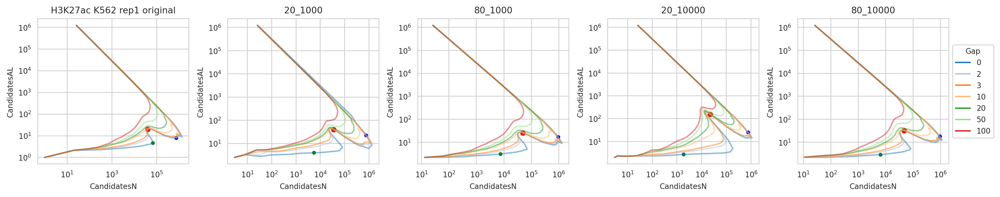

Limit Im1 10 Im2 90
Checking I 10 I1mab (6, 1.1088301805503984) I3mab (84, 25.075726617915592)
Checking I 11 I1mab (6, 1.3079981467342843) I3mab (84, 23.88659368636202)
Checking I 12 I1mab (6, 1.3904915922141705) I3mab (84, 22.576585791983163)
Checking I 13 I1mab (6, 1.3138781809601587) I3mab (84, 21.019474057405517)
Checking I 14 I1mab (6, 1.3327401232982208) I3mab (84, 19.4207426398373)
Checking I 15 I1mab (6, 1.124894511839208) I3mab (84, 18.045326458233248)
Checking I 16 I1mab (6, 2.0933812134833523) I3mab (84, 16.954576783248157)
Checking I 17 I1mab (7, 3.3729006276737445) I3mab (84, 16.08379645333838)
Checking I 18 I1mab (15, 5.962384281723331) I3mab (84, 15.489120395574673)
Checking I 19 I1mab (15, 7.973868479832835) I3mab (84, 14.936529021203299)
Checking I 20 I1mab (15, 9.321588637863565) I3mab (84, 14.482895928977271)
Checking I 21 I1mab (15, 10.207441894070683) I3mab (84, 14.11074813266346)
Checking I 22 I1mab (15, 10.809903429305798) I3mab (84, 13.80026857412605)
Checking I

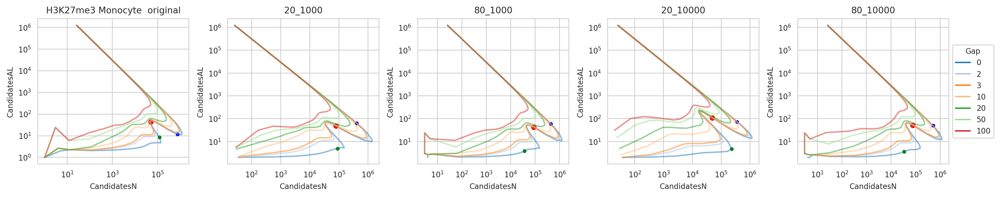

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (72, 34.91726351873544)
Checking I 11 I1mab (-1, 0) I3mab (72, 29.16722096063731)
Checking I 12 I1mab (11, 0.16944576041286924) I3mab (72, 22.694759504549992)
Checking I 13 I1mab (11, 0.5726533719488942) I3mab (72, 18.953596392910455)
Checking I 14 I1mab (11, 1.7250627893183839) I3mab (72, 16.541343651385702)
Checking I 15 I1mab (12, 4.828233685930492) I3mab (72, 15.431467682882086)
Checking I 16 I1mab (12, 8.552113037823073) I3mab (72, 14.728712573685627)
Checking I 17 I1mab (13, 11.223626528379672) I3mab (72, 14.163969572293766)
Checking I 18 I1mab (13, 12.980497937253627) I3mab (72, 13.740747397905764)
Checking I 19 I1mab (13, 14.147110496441382) I3mab (72, 13.410739784454634)
Checking I 20 I1mab (13, 14.932348368755486) I3mab (72, 13.14908552370406)
Checking I 21 I1mab (13, 15.480287991730268) I3mab (72, 12.931809699822665)
Checking I 22 I1mab (13, 15.863346475289928) I3mab (72, 12.743927913329628)
Checking I 23 I1mab (13, 16.14

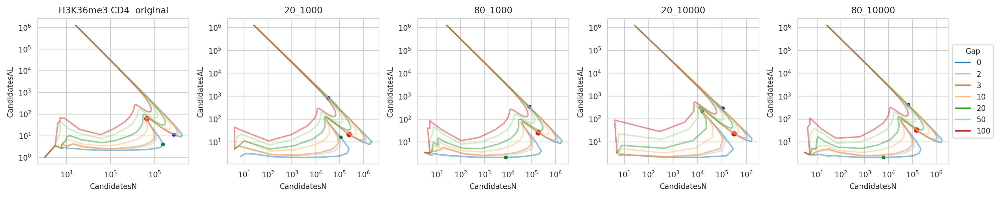

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (80, 67.07705792401022)
Checking I 11 I1mab (-1, 0) I3mab (80, 64.45745793114851)
Checking I 12 I1mab (-1, 0) I3mab (80, 60.99163204047089)
Checking I 13 I1mab (-1, 0) I3mab (80, 53.52792970159926)
Checking I 14 I1mab (-1, 0) I3mab (80, 48.20907920508748)
Checking I 15 I1mab (-1, 0) I3mab (80, 40.74980359428657)
Checking I 16 I1mab (-1, 0) I3mab (80, 35.70449178588295)
Checking I 17 I1mab (-1, 0) I3mab (80, 31.355553877332326)
Checking I 18 I1mab (17, 0.06916451333452783) I3mab (80, 27.622546711691285)
Checking I 19 I1mab (17, 0.33758243230583773) I3mab (83, 24.651128477512245)
Checking I 20 I1mab (17, 0.9523837597219953) I3mab (83, 22.40424667135956)
Checking I 21 I1mab (18, 2.2461305360280988) I3mab (83, 20.793189983566748)
Checking I 22 I1mab (18, 3.7347200306271806) I3mab (83, 19.500759072258887)
Checking I 23 I1mab (18, 4.9228196734612295) I3mab (83, 18.41983674909308)
Checking I 24 I1mab (18, 5.817442898105311) I3mab (86, 17.5

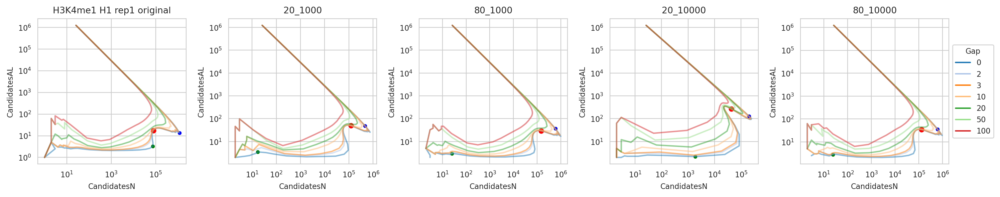

Limit Im1 10 Im2 90
Checking I 10 I1mab (-1, 0) I3mab (70, 38.82523136647679)
Checking I 11 I1mab (10, 0.10972431793415405) I3mab (70, 34.61997804472301)
Checking I 12 I1mab (10, 0.41489141524236267) I3mab (70, 31.231682749591798)
Checking I 13 I1mab (10, 0.687926447538561) I3mab (70, 29.053574905665712)
Checking I 14 I1mab (10, 1.1849998349361364) I3mab (70, 27.299710585803766)
Checking I 15 I1mab (11, 2.141531973451352) I3mab (70, 26.12484596044756)
Checking I 16 I1mab (11, 3.3973923500740306) I3mab (70, 25.312069653996673)
Checking I 17 I1mab (11, 4.939501963364485) I3mab (70, 24.728998788154456)
Checking I 18 I1mab (11, 5.903288886910558) I3mab (70, 24.20282507602944)
Checking I 19 I1mab (12, 6.48105974859253) I3mab (70, 23.745726757877705)
Checking I 20 I1mab (12, 6.859603892414059) I3mab (70, 23.341622038738635)
Checking I 21 I1mab (12, 7.0974754969411125) I3mab (70, 22.99310964630787)
Checking I 22 I1mab (12, 7.276275490654012) I3mab (70, 22.67332332045204)
Checking I 23 I1mab (

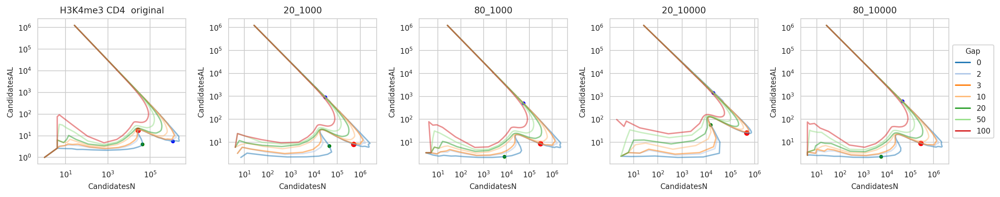

In [102]:
# Examples
for (m, c, r), t in wiggle_ext_sens_original.groupby(['modification', 'cell', 'replicate']):
    if len(t['type'].unique()) != 5:
        continue
    t.sort_values(by=['type', 'Sensitivity'], ascending=False, inplace=True)
    plt.figure(figsize=(15, 3))
    axs = [plt.subplot(1, 5, i + 1) for i in range(5)]
    for i, ty in enumerate(['original', '20_1000', '80_1000', '20_10000', '80_10000']):
        ax = axs[i]
        tt = t[t['type'] == ty]
        if len(tt) == 0:
            continue
        # tt = t[(t['Sensitivity'] >= 1e-3) & (t['Sensitivity'] <= 1.0)]
        sns.lineplot(data=tt, x="CandidatesN", y="CandidatesAL", hue='Gap', estimator=None,
                     # marker='o', markersize=3,
                     palette='tab20',
                     sort=False,
                     alpha=0.5,
                     ax=ax)
        ttt = tt[tt['Gap'] == 0].sort_values(by=['Sensitivity']).copy().reset_index(drop=True)
        sp = detect_sensitivity_triangle(ttt)
        sns.scatterplot(data=ttt[ttt.index == sp[0]],
                        x="CandidatesN", y="CandidatesAL", color='green', s=20,
                        legend=False, ax=ax)
        sns.scatterplot(data=ttt[ttt.index == sp[1]],
                        x="CandidatesN", y="CandidatesAL", color='red', s=40,
                        legend=False, ax=ax)
        sns.scatterplot(data=ttt[ttt.index == sp[2]],
                        x="CandidatesN", y="CandidatesAL", color='blue', s=20,
                        legend=False, ax=ax)
        ax.set(yscale='log')
        ax.set(xscale='log')
        if i == 0:
            ax.set_title(f'{m} {c} {r} {ty}')
        else:
            ax.set_title(f'{ty}')
        if i == len(axs) - 1:
            sns.move_legend(ax, loc='center left', bbox_to_anchor=(1, 0.5))
        else:
            ax.legend().set_visible(False)
    plt.tight_layout()
    plt.show()